## 2 - Export Data Assessment (Questionnaire Data)

##### Imports

In [1]:
import os
import pandas as pd
import numpy as np
import scipy as su
import ast
# from typing import Dict
# from scipy.signal import
# from scikit-learn import

import matplotlib.pyplot as plt
import seaborn as sns

import dask.dataframe as dd

##### Data Loading

In [2]:
# Load ddfs into dictionary (exception for 'all_surf_pos', df)
root_dir = './aggregated_data'
def load_data(root_dir, exception=False):    # Get csv file reads into one dictionary
    data = {}
    for subdir, _, files in os.walk(root_dir):
        for file in files:
            file_path = os.path.join(subdir, file)
            file_name = os.path.splitext(file)[0]   #file name without '.csv'
            if file.endswith('.csv') and file != 'all_surf_positions_HiDrive_Studie2.csv':
                data[file_name] = dd.read_csv(file_path)    #read and attach to dict
            elif exception and file == 'all_surf_positions_HiDrive_Studie2.csv':
                data [file_name] = pd.read_csv(file_path, converters=converters)    #read as normal and attach to dict
    return data
def parse(filedata): # Manually read the column
    output = []
    for line in filedata.split('\n'): # split into lines
        line = line.strip().rstrip(']').lstrip('[') #remove whitespace and brackets
        if not line:  
            continue    #skip empty lines
        line = line.split() #split into cell
        row = []
        for cell in line:
            cell = cell.strip()     #remove whitespace
            if not cell.strip():
                continue    #skip empty cells
            row.append(float(cell)) #convert to float and add
        output.append(row)
    return output
converters = {
    "img_to_surf_trans": parse,
    "surf_to_img_trans": parse,
    "dist_img_to_surf_trans": parse,
    "surf_to_dist_img_trans": parse,
}

data = load_data(root_dir)

In [3]:
participant_ids = [1,2,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]
ddf = data['all_quest_data']
df = ddf.iloc[:, 1:].compute()

### 1. Basic statistics
- Workload score ranges between 5 and 55

In [4]:
display(df.describe())

,participant_id,block_id,block_type,NASA_TLX_01,NASA_TLX_02,NASA_TLX_03,NASA_TLX_04,NASA_TLX_05,NASA_TLX_Score
count,152.000000,152.000000,152.000000,152.000000,152.000000,152.000000,152.000000,64.000000,152.000000
mean,10.894737,4.500000,4.500000,9.605263,17.828947,7.914474,4.223684,4.281250,42.085526
std,5.665228,2.298862,2.298862,3.886056,3.209622,3.866898,4.033301,3.169641,9.982522
min,1.000000,1.000000,1.000000,2.000000,3.000000,2.000000,1.000000,1.000000,21.000000
25%,6.000000,2.750000,2.750000,6.000000,17.000000,5.000000,1.000000,2.000000,34.750000
50%,11.000000,4.500000,4.500000,10.000000,19.000000,8.000000,3.000000,3.000000,41.250000
75%,16.000000,6.250000,6.250000,12.250000,20.000000,11.000000,6.000000,6.000000,49.250000
max,20.000000,8.000000,8.000000,18.000000,21.000000,16.000000,20.000000,13.000000,65.000000


### 2. Quality Assessment
Overall workload, Mental demands, Performance, Effort, Frustration, Temporal demands, Flow Requirements  boxplots +correlations

##### Overall Workload boxplot
- Good

In [4]:
df_dim = ddf.iloc[:, 1:9].compute()
df_dim_corrected = df_dim.copy()
df_dim_corrected['NASA_TLX_02'] = 22 - df_dim['NASA_TLX_02']
df_dim['NASA_TLX_Score'] = df_dim_corrected.iloc[:, 3:8].apply(func='mean', axis=1)
display(df_dim.describe())

,participant_id,block_id,block_type,NASA_TLX_01,NASA_TLX_02,NASA_TLX_03,NASA_TLX_04,NASA_TLX_05,NASA_TLX_Score
count,152.000000,152.000000,152.000000,152.000000,152.000000,152.000000,152.000000,64.000000,152.000000
mean,10.894737,4.500000,4.500000,9.605263,17.828947,7.914474,4.223684,4.281250,6.313158
std,5.665228,2.298862,2.298862,3.886056,3.209622,3.866898,4.033301,3.169641,2.660377
min,1.000000,1.000000,1.000000,2.000000,3.000000,2.000000,1.000000,1.000000,2.000000
25%,6.000000,2.750000,2.750000,6.000000,17.000000,5.000000,1.000000,2.000000,4.237500
50%,11.000000,4.500000,4.500000,10.000000,19.000000,8.000000,3.000000,3.000000,5.800000
75%,16.000000,6.250000,6.250000,12.250000,20.000000,11.000000,6.000000,6.000000,8.050000
max,20.000000,8.000000,8.000000,18.000000,21.000000,16.000000,20.000000,13.000000,13.000000


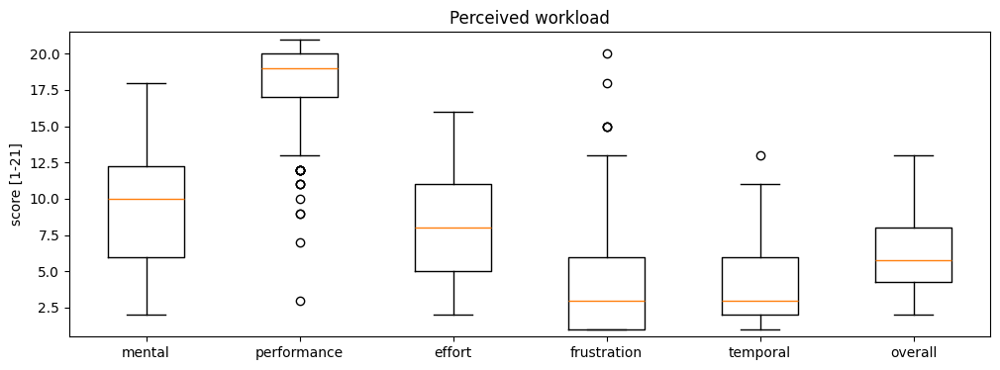

In [6]:
plt.figure(figsize=(12, 4))
plt.boxplot([df_dim[col].dropna() for col in df_dim.iloc[:, 3:9].columns], whis=1.5)
plt.title('Perceived workload')
plt.ylabel('score [1-21]')
plt.ylim(.5, 21.5)
plt.xticks(ticks=range(1, 7), labels=['mental', 'performance', 'effort', 'frustration', 'temporal', 'overall'])
plt.show()

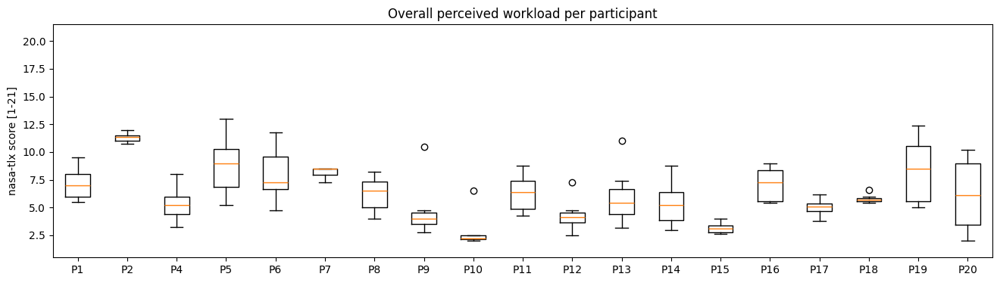

In [9]:
grouped_ids = [participant_ids[i:i+19] for i in range(0, len(participant_ids), 19)] #group ids
for group in grouped_ids: #iterate groups
    participants_df = [df_dim.query(f"participant_id == {pid}")['NASA_TLX_Score'] for pid in group] #get group's sub-ddfs
    plt.figure(figsize=(16, 4))
    plt.boxplot(participants_df, whis = 1.5)
    plt.title(f'Overall perceived workload per participant')
    plt.ylabel('nasa-tlx score [1-21]')
    plt.ylim(.5, 21.5)
    plt.xticks(range(1, len(group) + 1), [f'P{pid}' for pid in group]) #single boxplots labels
    plt.show()

##### Mental Demands boxplot
- Good

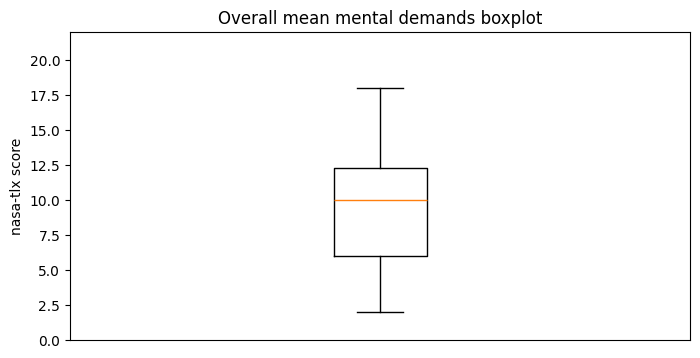

In [10]:
plt.figure(figsize=(8, 4))
plt.boxplot(ddf['NASA_TLX_01'], whis = 1.5)
plt.title(f'Overall mean mental demands boxplot')
plt.ylabel('nasa-tlx score')
plt.ylim(0, 22)
plt.xticks([])
plt.show()

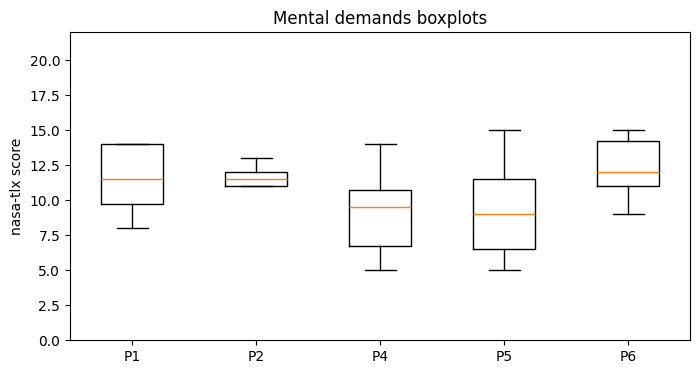

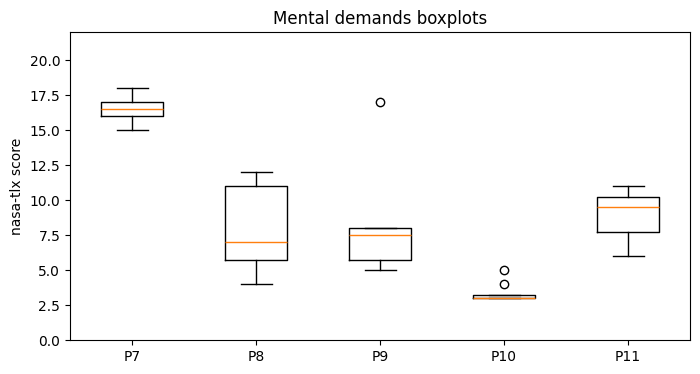

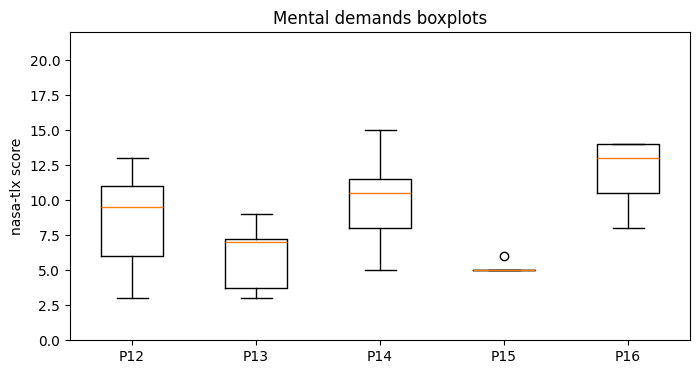

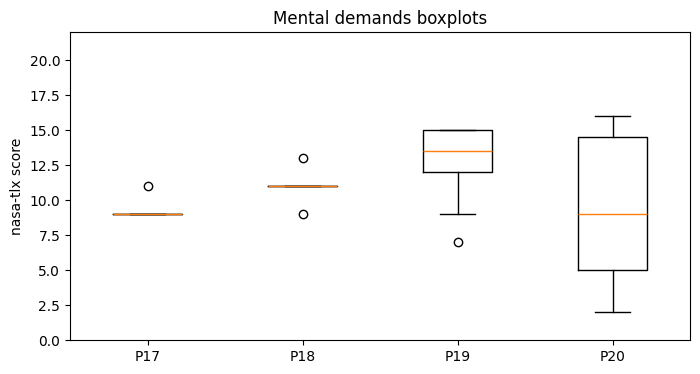

In [11]:
grouped_ids = [participant_ids[i:i+5] for i in range(0, len(participant_ids), 5)] #group ids
for group in grouped_ids: #iterate groups
    participants_ddf = [ddf.query(f"participant_id == {pid}")['NASA_TLX_01'] for pid in group] #get group's sub-ddfs
    plt.figure(figsize=(8, 4))
    plt.boxplot(participants_ddf, whis = 1.5)
    plt.title(f'Mental demands boxplots')
    plt.ylabel('nasa-tlx score')
    plt.ylim(0, 22)
    plt.xticks(range(1, len(group) + 1), [f'P{pid}' for pid in group]) #single boxplots labels
    plt.show()

##### Performance boxplot
- Generally high
- Must be reversed?

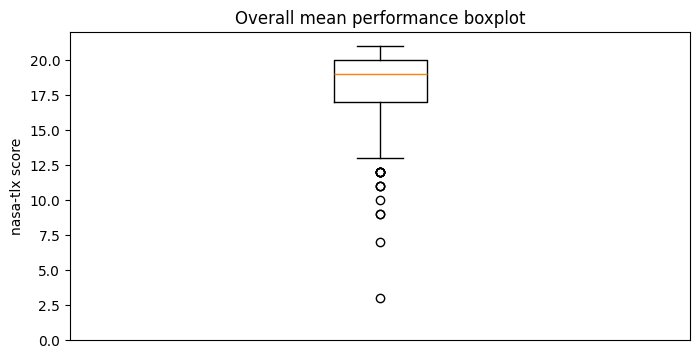

In [12]:
plt.figure(figsize=(8, 4))
plt.boxplot(ddf['NASA_TLX_02'], whis = 1.5)
plt.title(f'Overall mean performance boxplot')
plt.ylabel('nasa-tlx score')
plt.ylim(0, 22)
plt.xticks([])
plt.show()

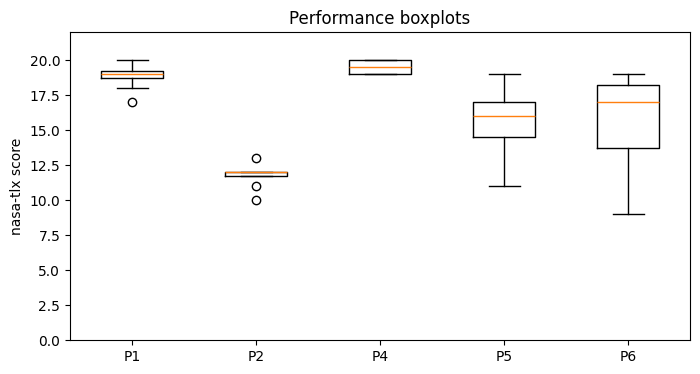

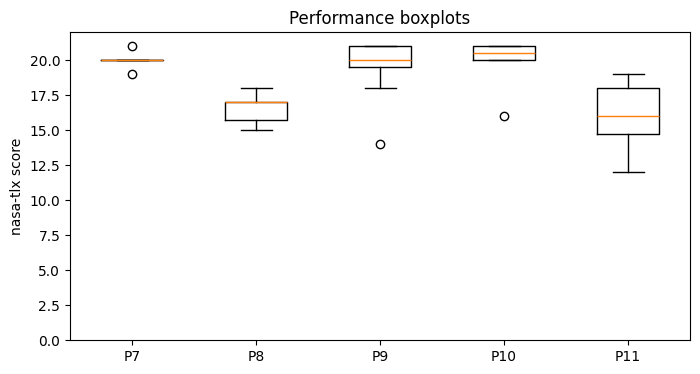

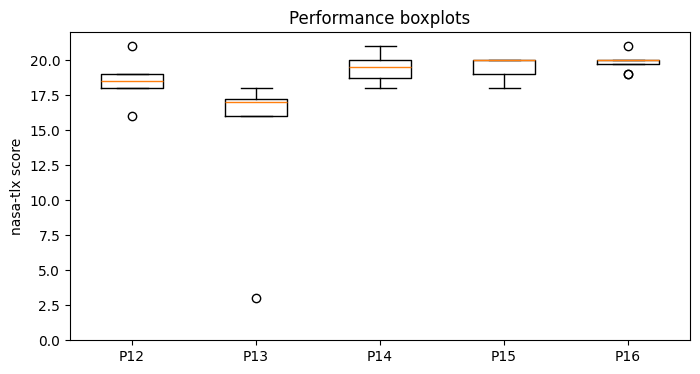

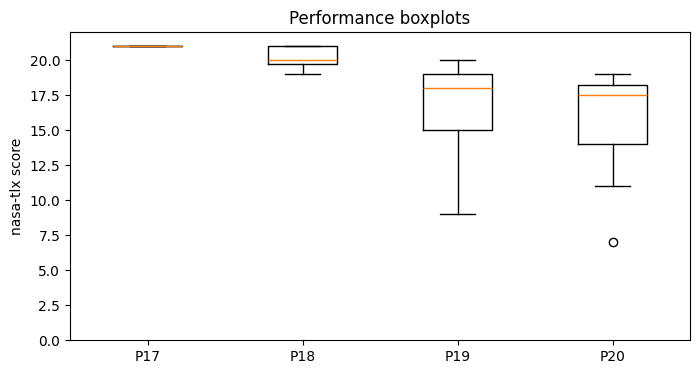

In [13]:
grouped_ids = [participant_ids[i:i+5] for i in range(0, len(participant_ids), 5)] #group ids
for group in grouped_ids: #iterate groups
    participants_ddf = [ddf.query(f"participant_id == {pid}")['NASA_TLX_02'] for pid in group] #get group's sub-ddfs
    plt.figure(figsize=(8, 4))
    plt.boxplot(participants_ddf, whis = 1.5)
    plt.title(f'Performance boxplots')
    plt.ylabel('nasa-tlx score')
    plt.ylim(0, 22)
    plt.xticks(range(1, len(group) + 1), [f'P{pid}' for pid in group]) #single boxplots labels
    plt.show()

##### Effort boxplot
- Good

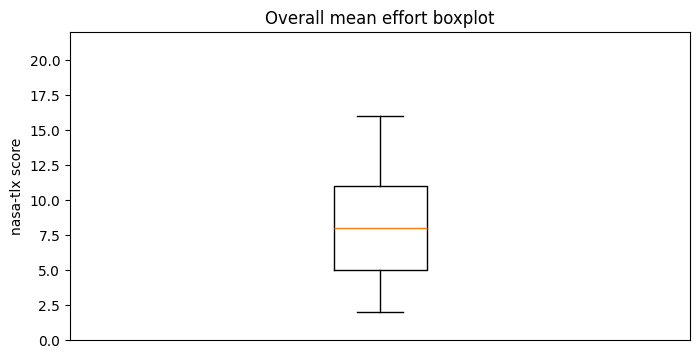

In [14]:
plt.figure(figsize=(8, 4))
plt.boxplot(ddf['NASA_TLX_03'], whis = 1.5)
plt.title(f'Overall mean effort boxplot')
plt.ylabel('nasa-tlx score')
plt.ylim(0, 22)
plt.xticks([])
plt.show()

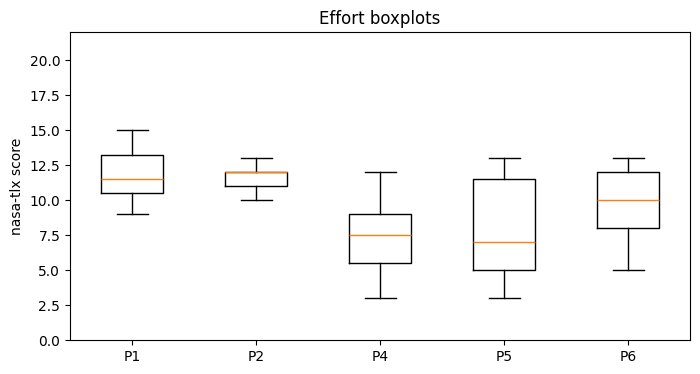

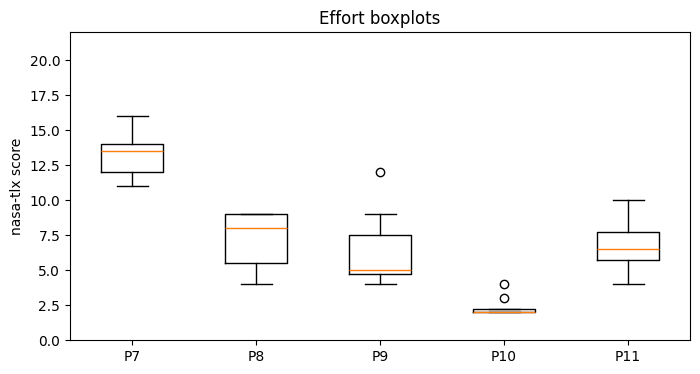

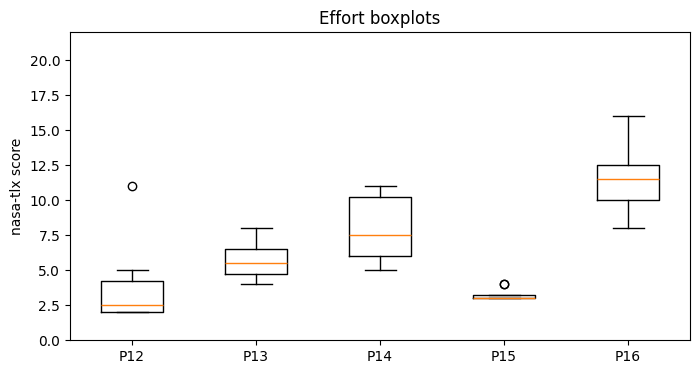

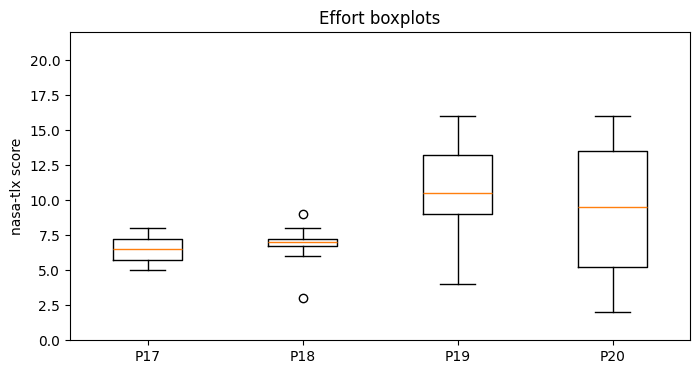

In [15]:
grouped_ids = [participant_ids[i:i+5] for i in range(0, len(participant_ids), 5)] #group ids
for group in grouped_ids: #iterate groups
    participants_ddf = [ddf.query(f"participant_id == {pid}")['NASA_TLX_03'] for pid in group] #get group's sub-ddfs
    plt.figure(figsize=(8, 4))
    plt.boxplot(participants_ddf, whis = 1.5)
    plt.title(f'Effort boxplots')
    plt.ylabel('nasa-tlx score')
    plt.ylim(0, 22)
    plt.xticks(range(1, len(group) + 1), [f'P{pid}' for pid in group]) #single boxplots labels
    plt.show()

##### Frustration boxplot
- Generally low

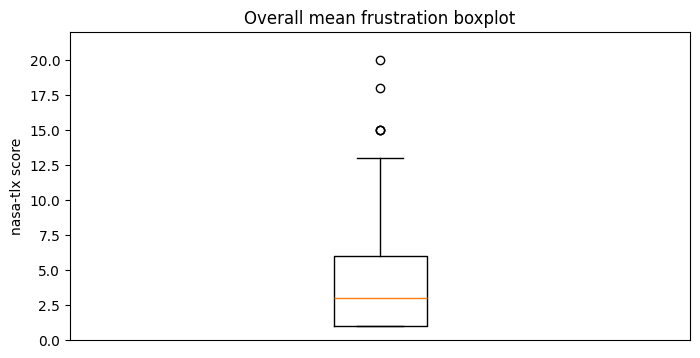

In [16]:
plt.figure(figsize=(8, 4))
plt.boxplot(ddf['NASA_TLX_04'], whis = 1.5)
plt.title(f'Overall mean frustration boxplot')
plt.ylabel('nasa-tlx score')
plt.ylim(0, 22)
plt.xticks([])
plt.show()

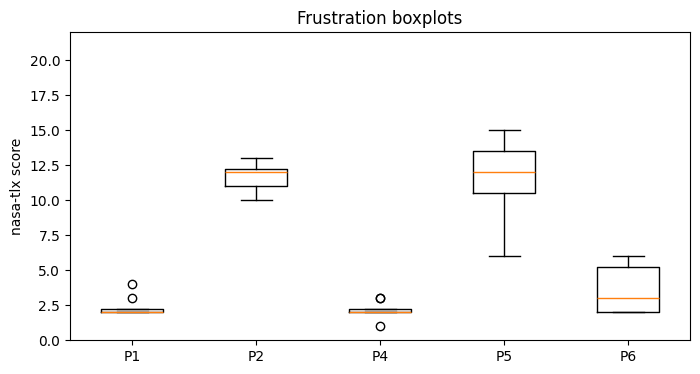

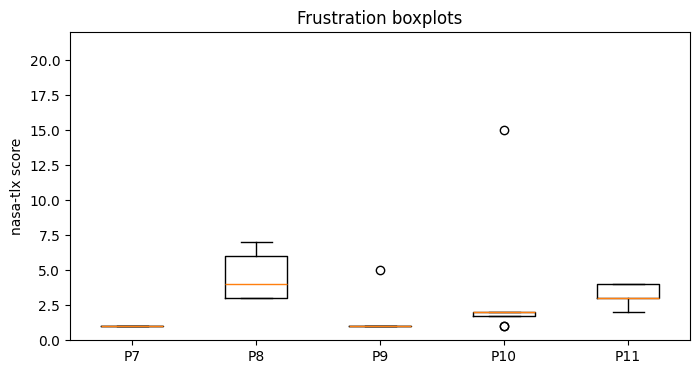

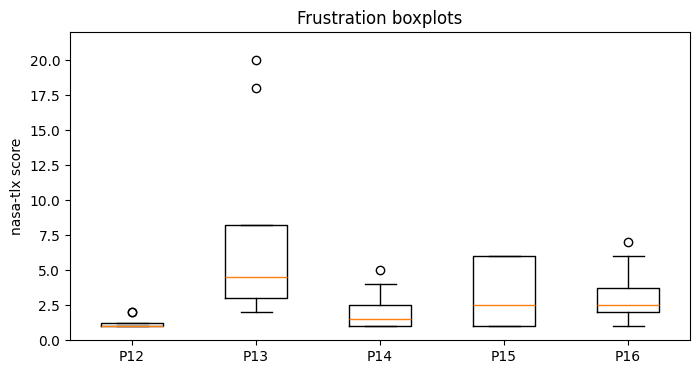

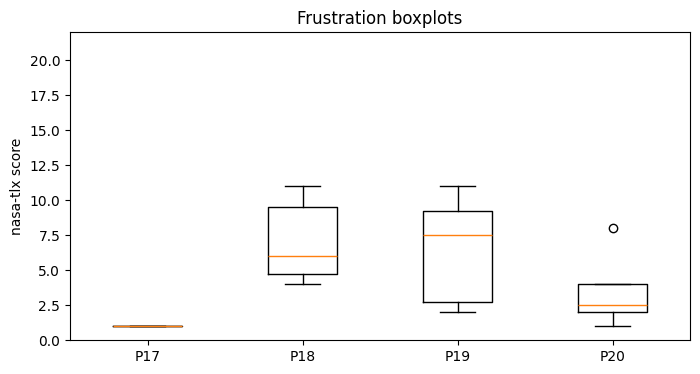

In [17]:
grouped_ids = [participant_ids[i:i+5] for i in range(0, len(participant_ids), 5)] #group ids
for group in grouped_ids: #iterate groups
    participants_ddf = [ddf.query(f"participant_id == {pid}")['NASA_TLX_04'] for pid in group] #get group's sub-ddfs
    plt.figure(figsize=(8, 4))
    plt.boxplot(participants_ddf, whis = 1.5)
    plt.title(f'Frustration boxplots')
    plt.ylabel('nasa-tlx score')
    plt.ylim(0, 22)
    plt.xticks(range(1, len(group) + 1), [f'P{pid}' for pid in group]) #single boxplots labels
    plt.show()

##### Temporal Demands boxplot
- Generally low

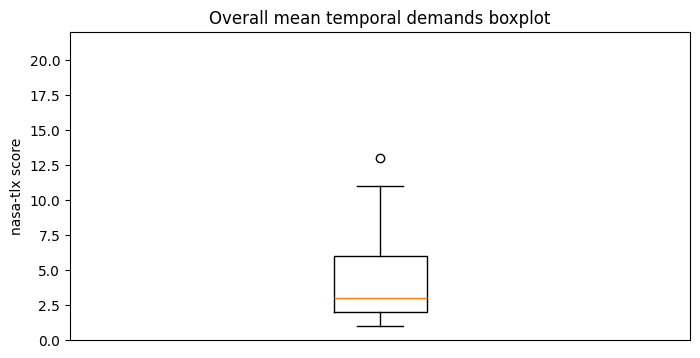

In [18]:
plt.figure(figsize=(8, 4))
plt.boxplot(ddf.query(f"participant_id > 12")['NASA_TLX_05'], whis = 1.5)
plt.title(f'Overall mean temporal demands boxplot')
plt.ylabel('nasa-tlx score')
plt.ylim(0, 22)
plt.xticks([])
plt.show()

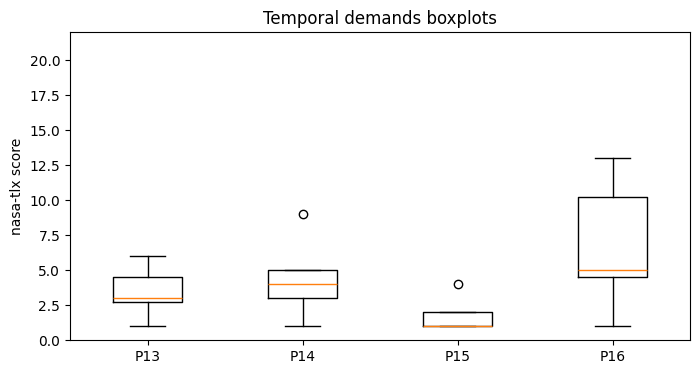

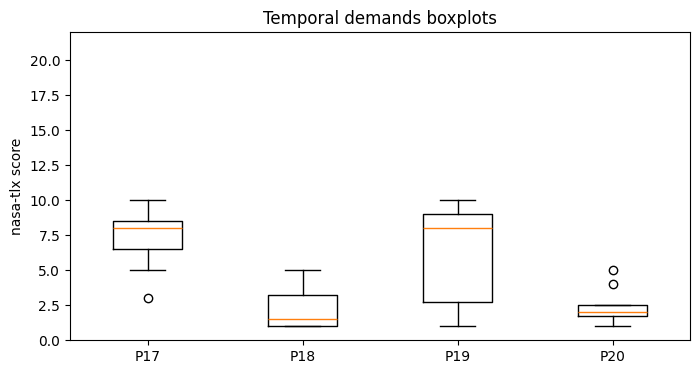

In [19]:
grouped_ids = [participant_ids[i:i+4] for i in range(11, len(participant_ids), 4)] #group ids
for group in grouped_ids: #iterate groups
    participants_ddf = [ddf.query(f"participant_id == {pid}")['NASA_TLX_05'] for pid in group] #get group's sub-ddfs
    plt.figure(figsize=(8, 4))
    plt.boxplot(participants_ddf, whis = 1.5)
    plt.title(f'Temporal demands boxplots')
    plt.ylabel('nasa-tlx score')
    plt.ylim(0, 22)
    plt.xticks(range(1, len(group) + 1), [f'P{pid}' for pid in group]) #single boxplots labels
    plt.show()

##### Flow Requirements boxplot
- Generally around mid-low level

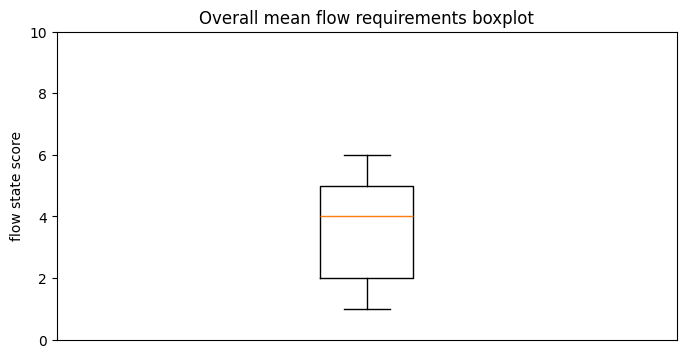

In [20]:
plt.figure(figsize=(8, 4))
plt.boxplot(ddf.query(f"participant_id > 1")['FL_Score'], whis = 1.5)
plt.title(f'Overall mean flow requirements boxplot')
plt.ylabel('flow state score')
plt.ylim(0, 10)
plt.xticks([])
plt.show()

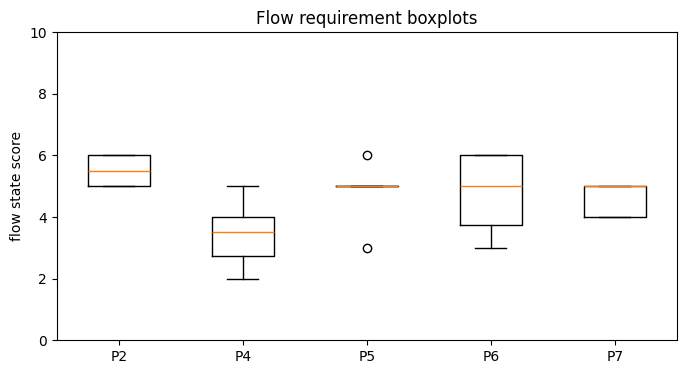

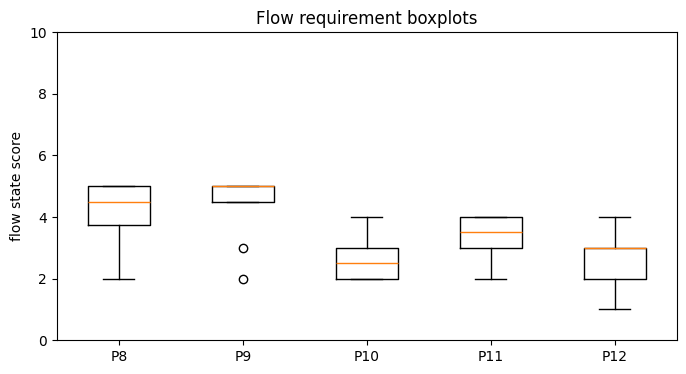

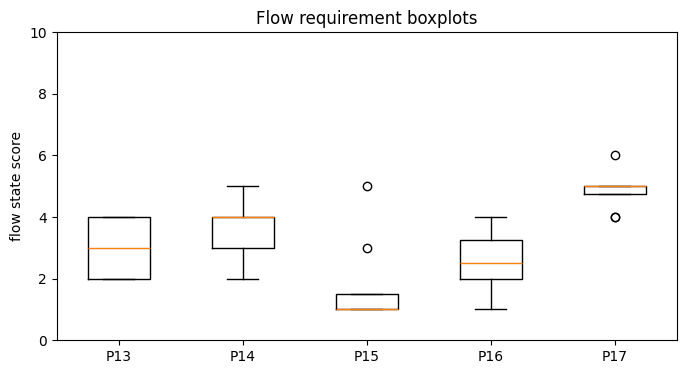

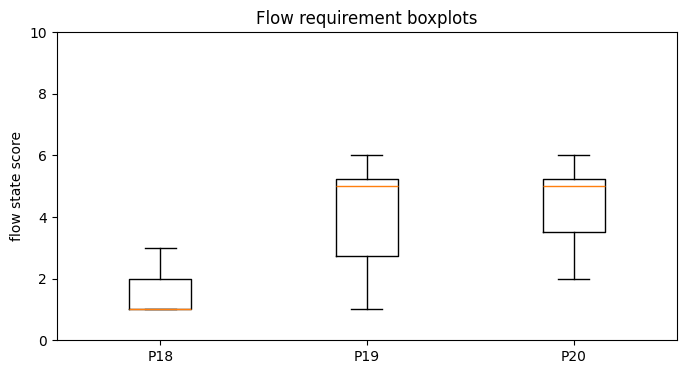

In [21]:
grouped_ids = [participant_ids[i:i+5] for i in range(1, len(participant_ids), 5)] #group ids
for group in grouped_ids: #iterate groups
    participants_ddf = [ddf.query(f"participant_id == {pid}")['FL_Score'] for pid in group] #get group's sub-ddfs
    plt.figure(figsize=(8, 4))
    plt.boxplot(participants_ddf, whis = 1.5)
    plt.title(f'Flow requirement boxplots')
    plt.ylabel('flow state score')
    plt.ylim(0, 10)
    plt.xticks(range(1, len(group) + 1), [f'P{pid}' for pid in group]) #single boxplots labels
    plt.show()

##### Mental-temporal demands correlation
- Possible positive (weak) correlation

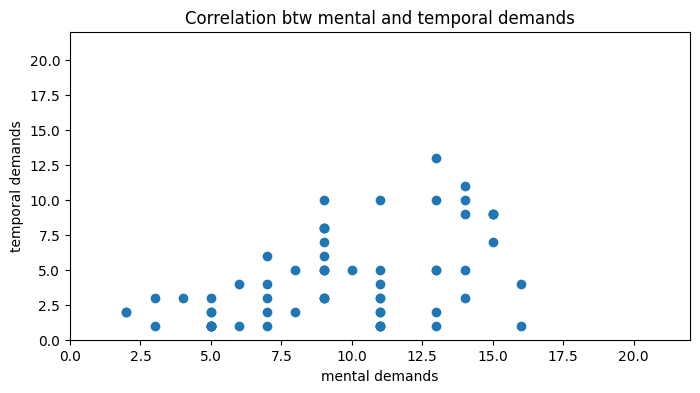

In [22]:
short_ddf = ddf.query(f"participant_id > 12")
plt.figure(figsize=(8, 4))
plt.scatter(short_ddf['NASA_TLX_01'], short_ddf['NASA_TLX_05'])
plt.title(f'Correlation btw mental and temporal demands')
plt.xlabel('mental demands')
plt.ylabel('temporal demands')
plt.xlim(0,22)
plt.ylim(0,22)
plt.show()

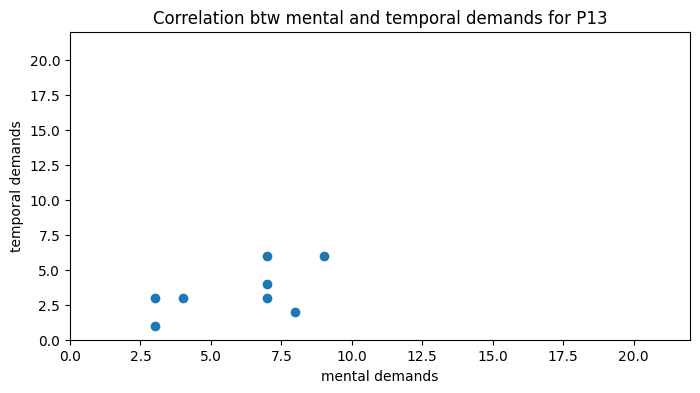

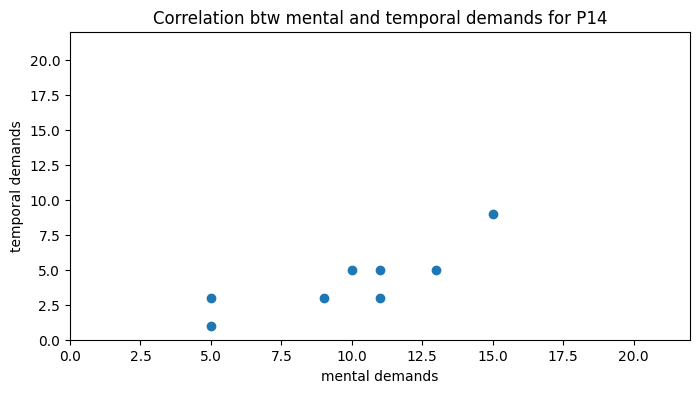

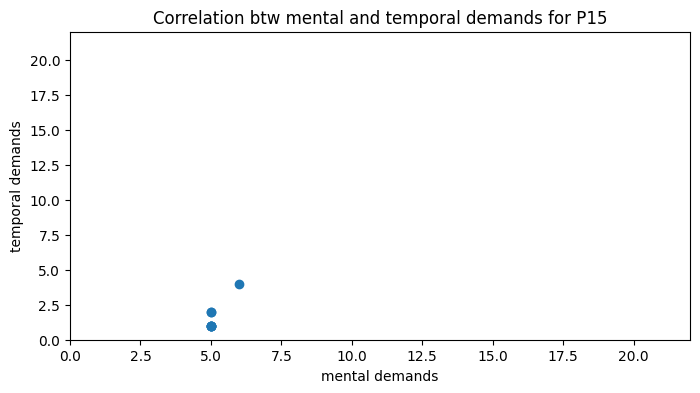

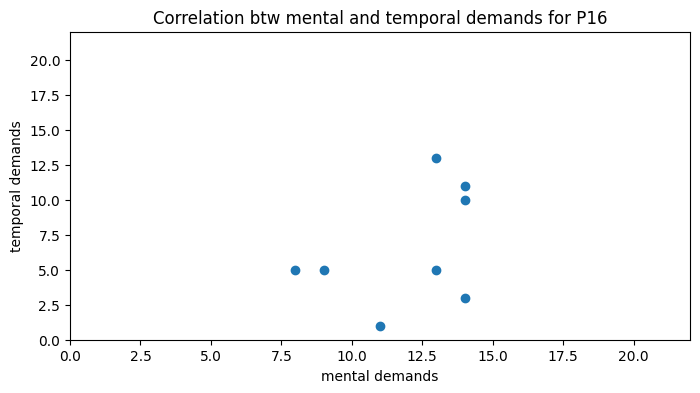

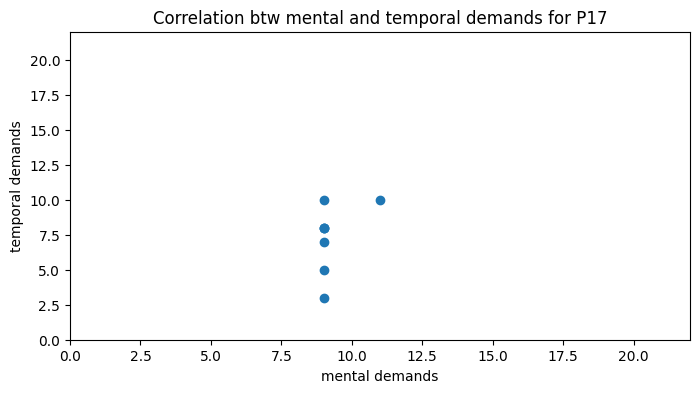

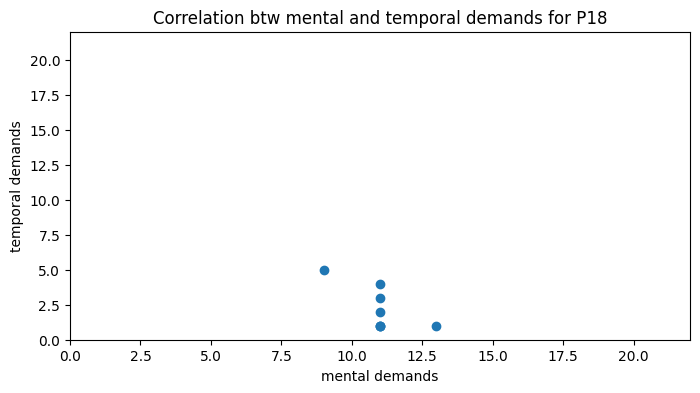

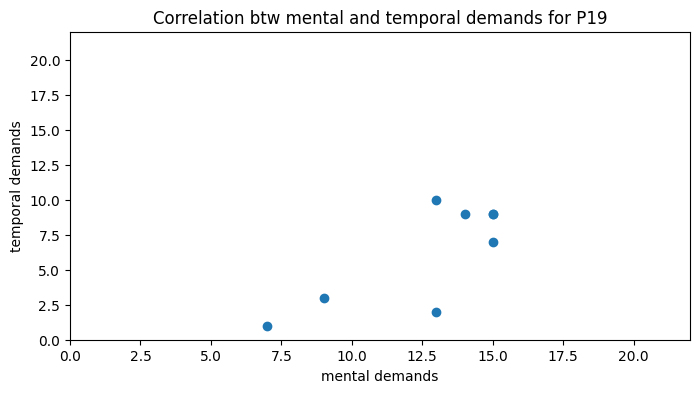

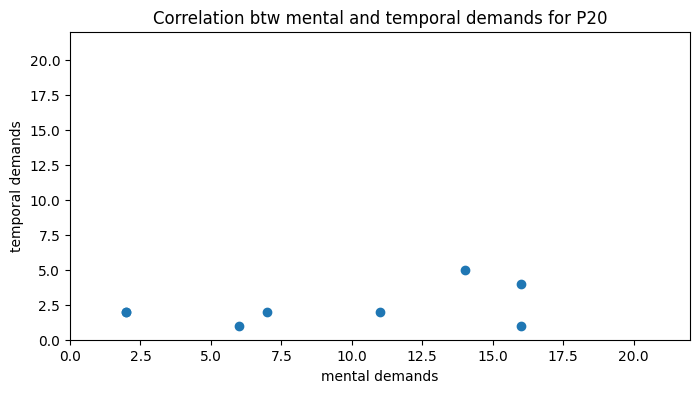

In [23]:
for pid in participant_ids:
    if pid > 12:
        participant_ddf = ddf.query(f"participant_id == {pid}")
    else:
        continue
    plt.figure(figsize=(8, 4))
    plt.scatter(participant_ddf['NASA_TLX_01'], participant_ddf['NASA_TLX_05'])
    plt.title(f'Correlation btw mental and temporal demands for P{pid}')
    plt.xlabel('mental demands')
    plt.ylabel('temporal demands')
    plt.xlim(0,22)
    plt.ylim(0,22)
    plt.show()

### 3. Time-Series Assessment
Overall workload, Mental demands, Performance, Effort, Frustration, Temporal demands, Flow Requirements

##### Overall workload overtime
- Good

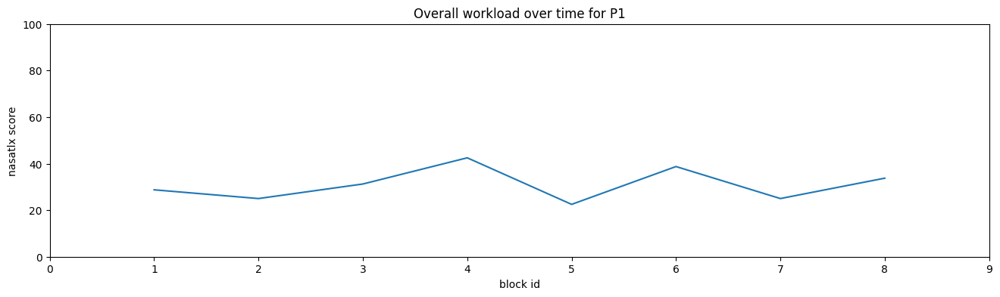

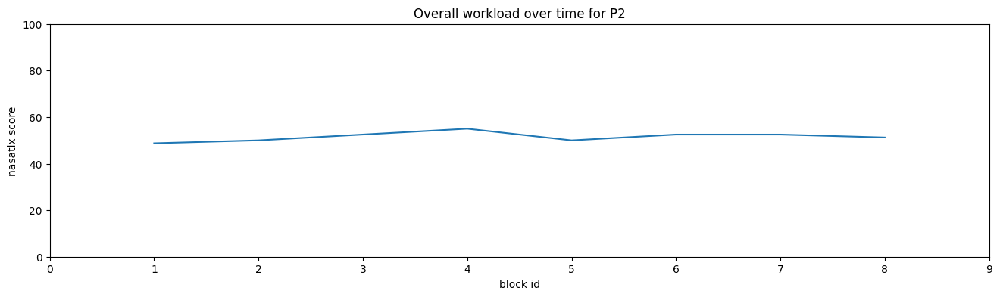

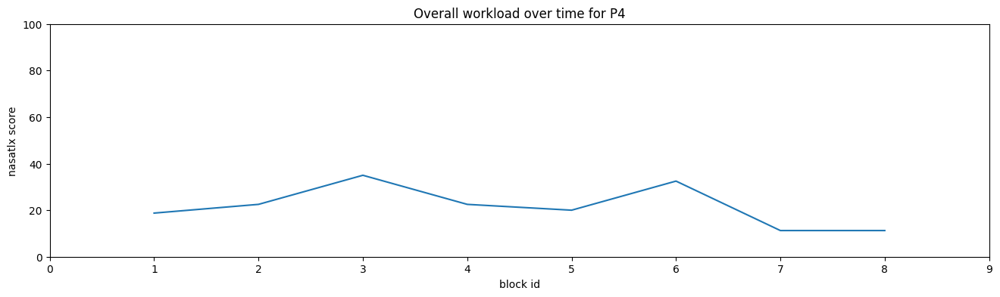

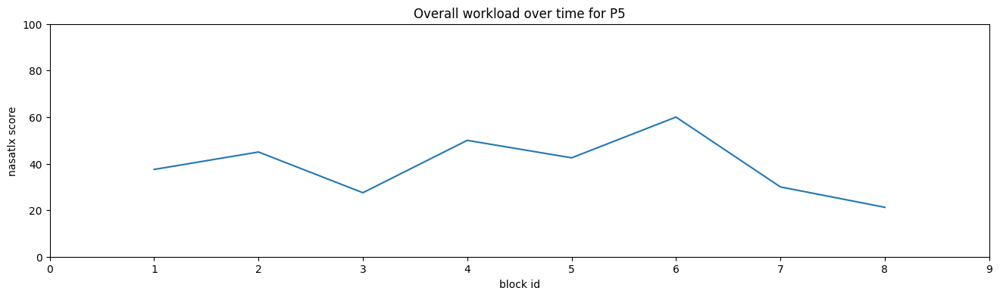

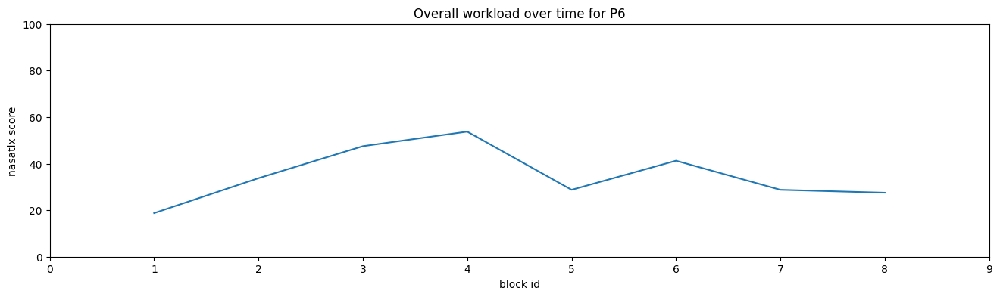

...

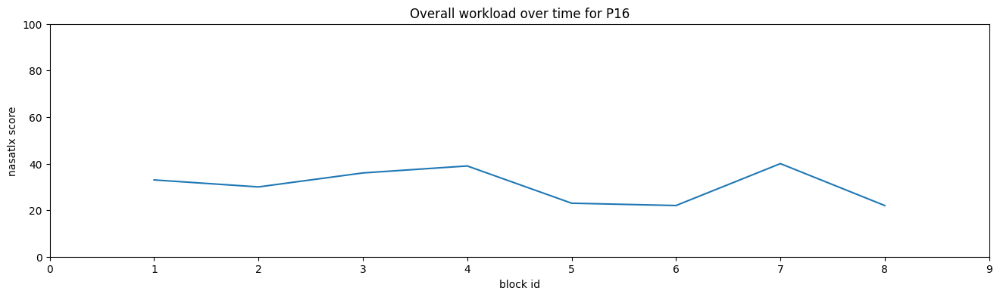

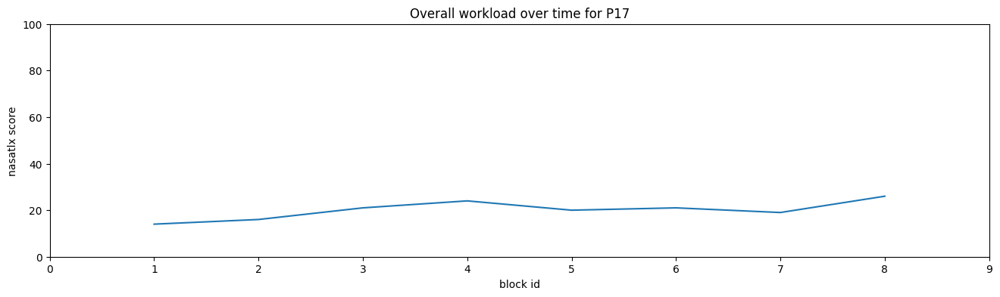

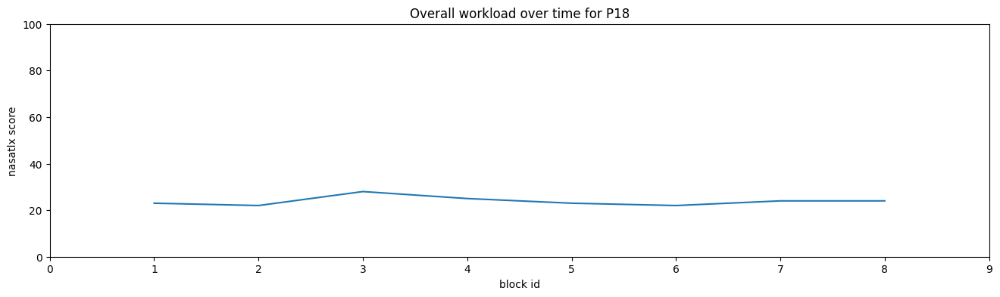

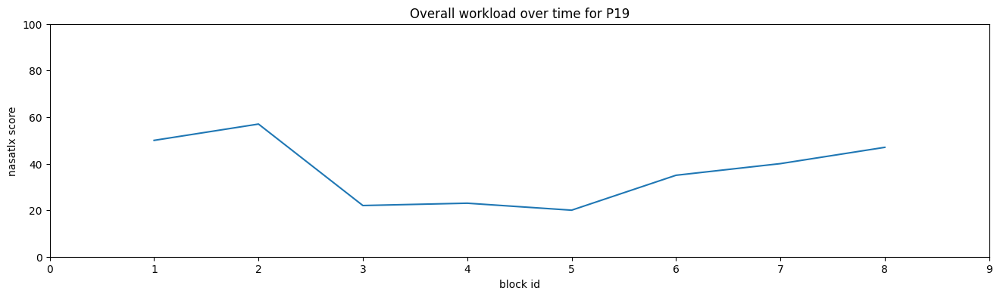

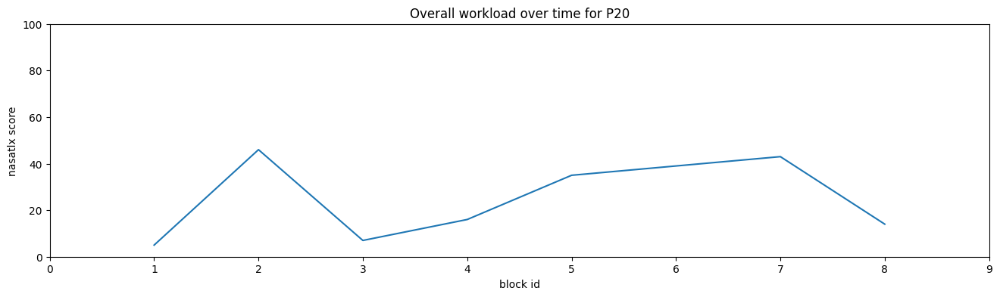

In [24]:
for pid in participant_ids:
    participant_df = df.query(f"participant_id == {pid}")
    plt.figure(figsize=(16, 4))
    plt.plot(participant_df['block_id'], participant_df['NASA_TLX_Score'])
    plt.title(f'Overall workload over time for P{pid}')
    plt.xlabel('block id')
    plt.ylabel('nasatlx score')
    plt.xlim(0, 9)
    plt.ylim(0, 100)
    plt.show()

##### Mental demands overtime
- Good

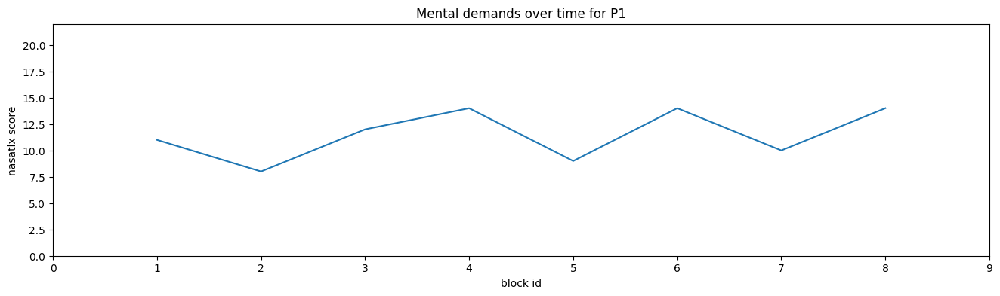

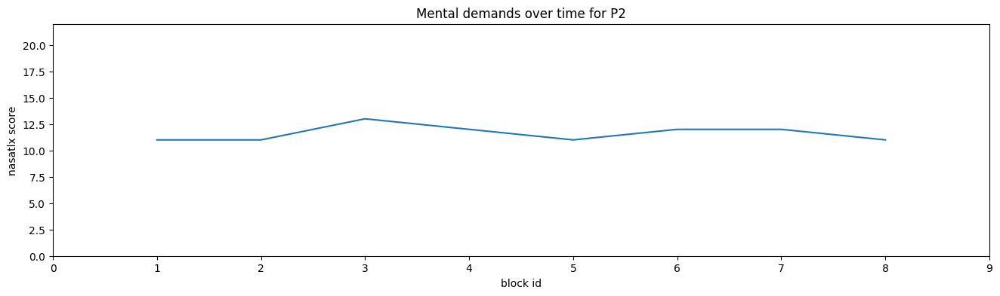

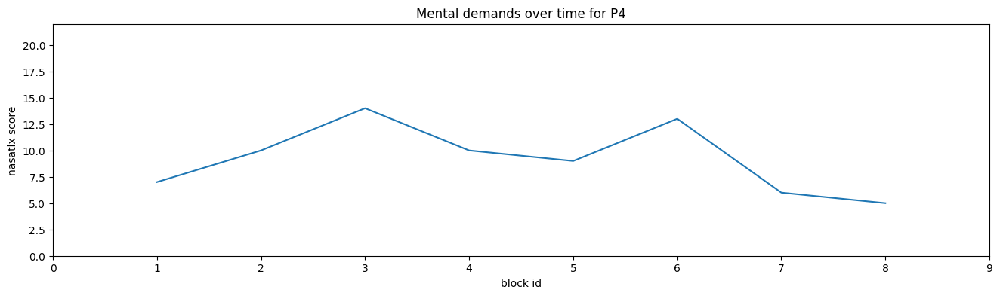

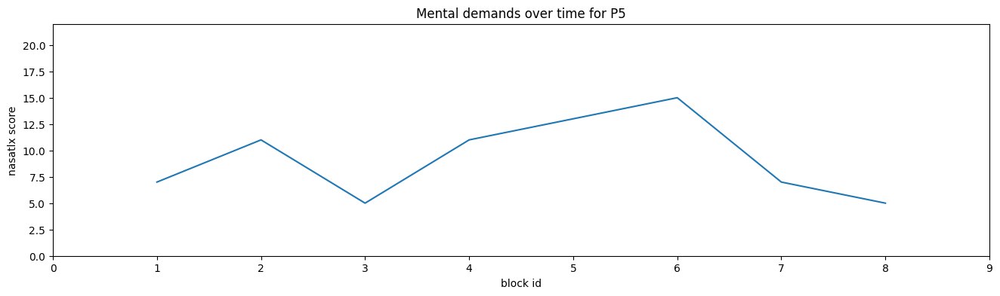

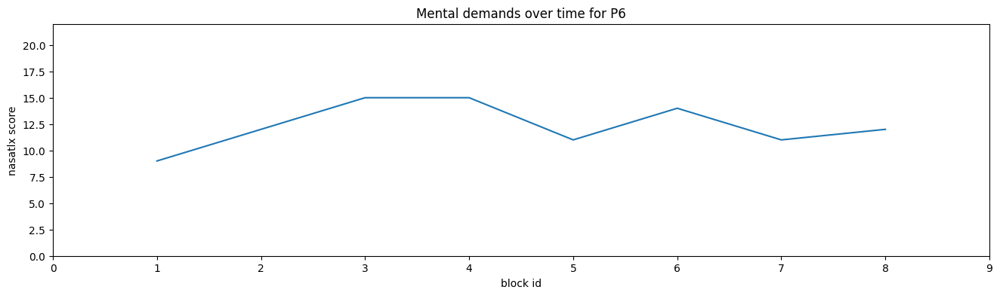

...

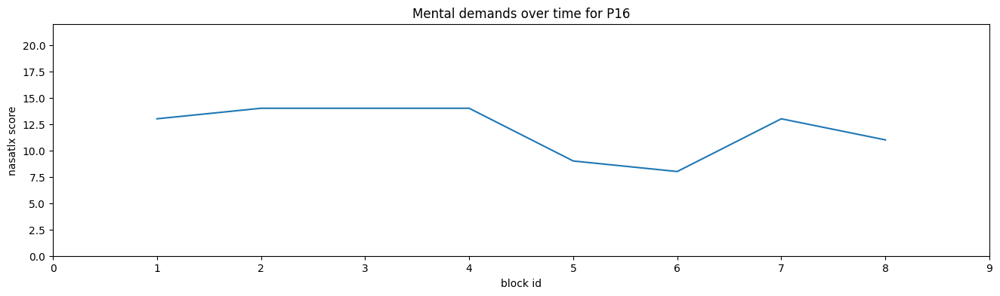

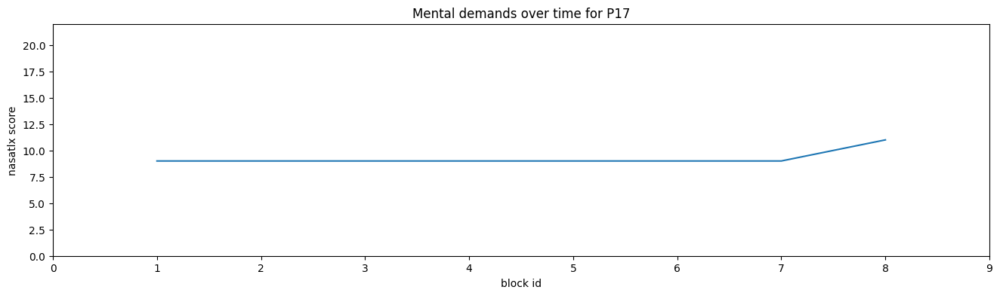

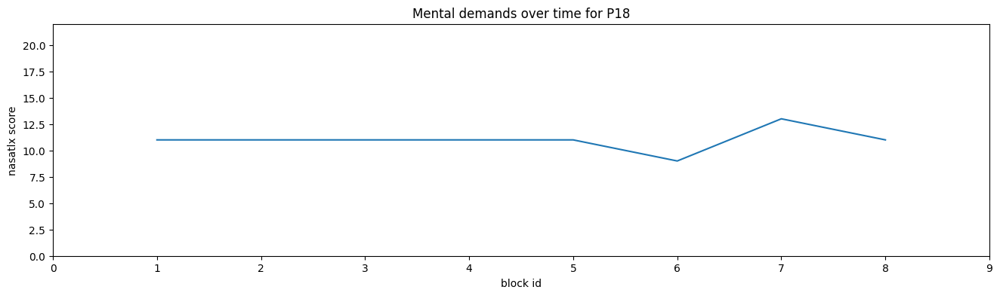

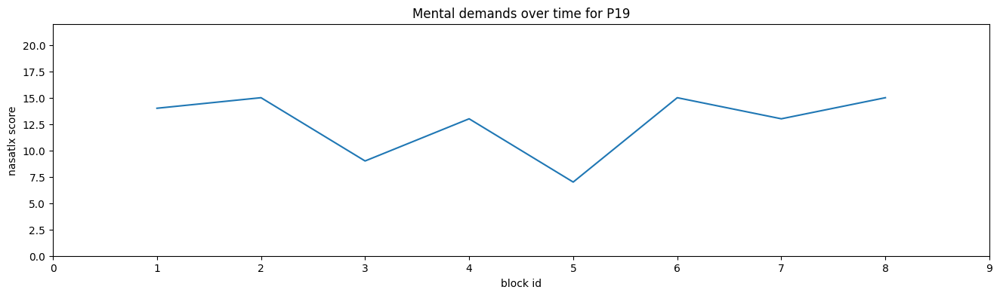

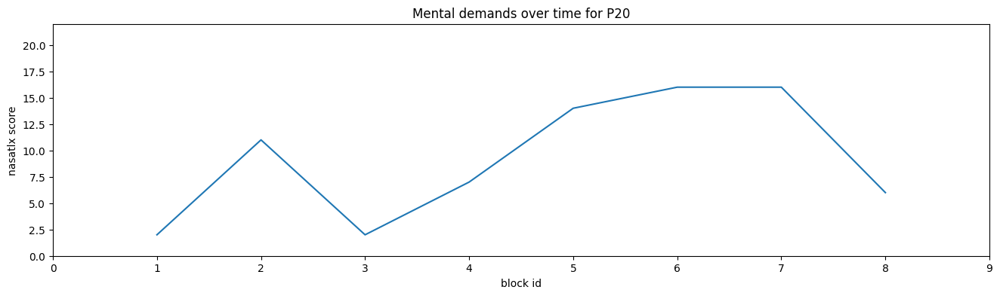

In [25]:
for pid in participant_ids:
    participant_df = df.query(f"participant_id == {pid}")
    plt.figure(figsize=(16, 4))
    plt.plot(participant_df['block_id'], participant_df['NASA_TLX_01'])
    plt.title(f'Mental demands over time for P{pid}')
    plt.xlabel('block id')
    plt.ylabel('nasatlx score')
    plt.xlim(0, 9)
    plt.ylim(0, 22)
    plt.show()

##### Performance overtime
- Good

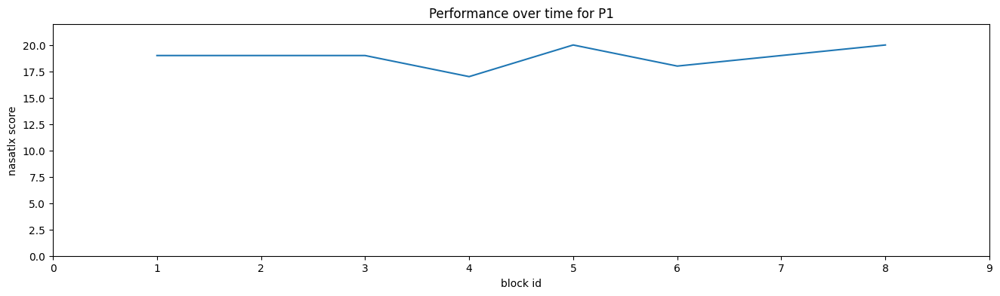

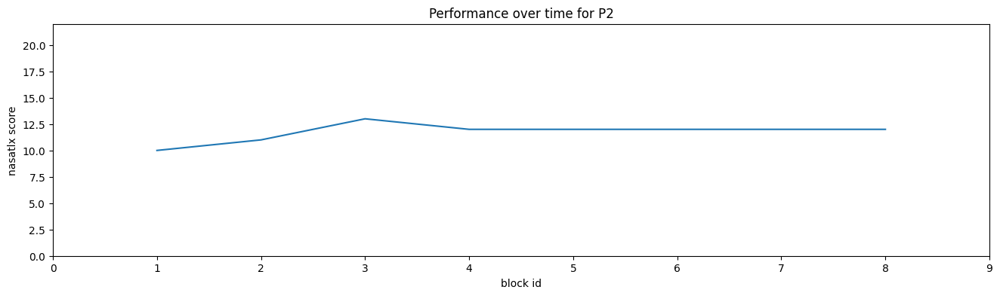

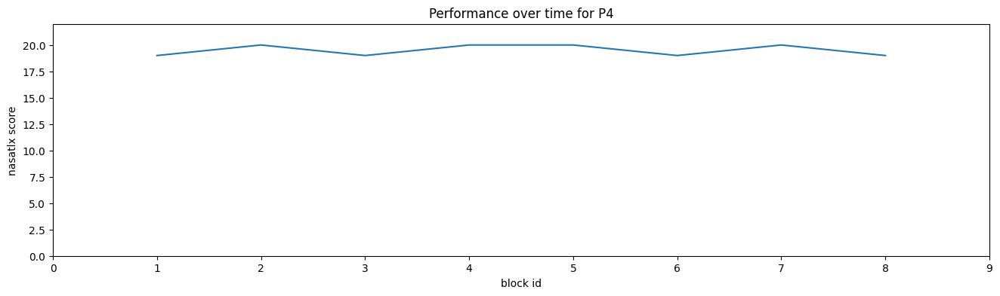

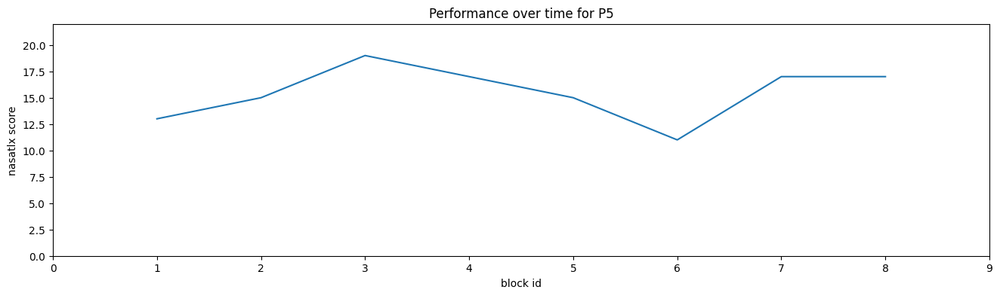

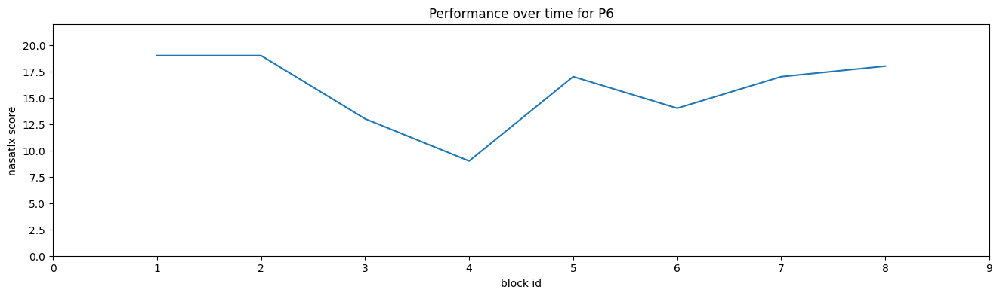

...

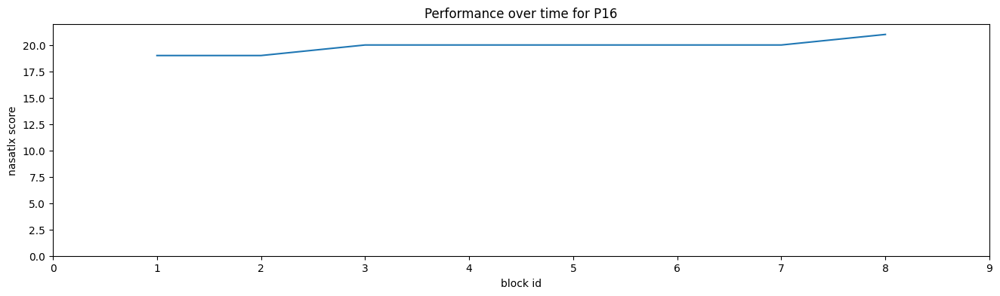

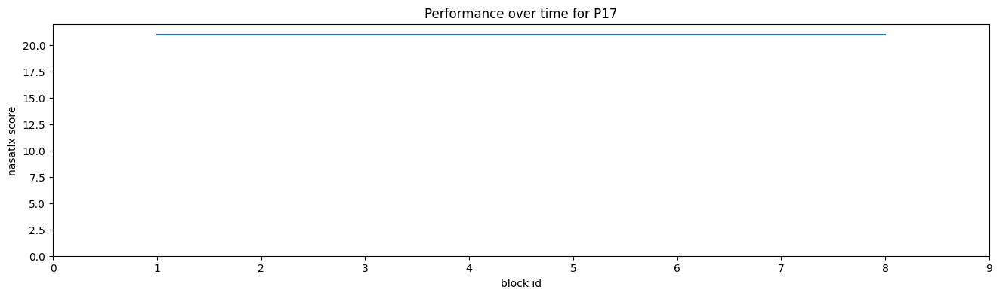

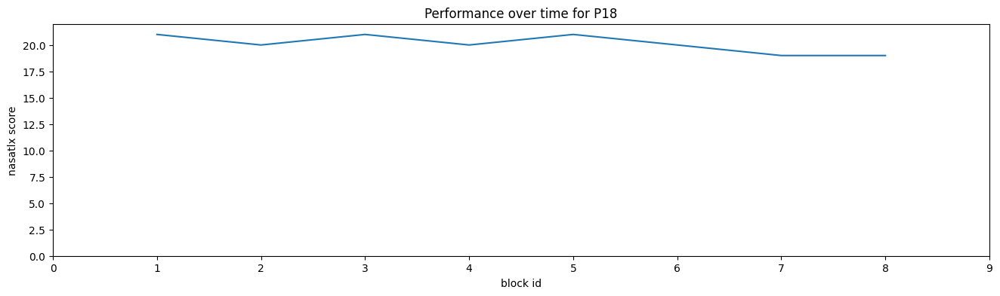

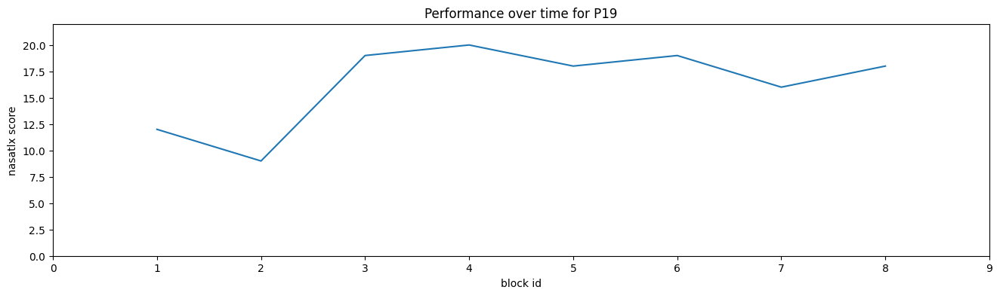

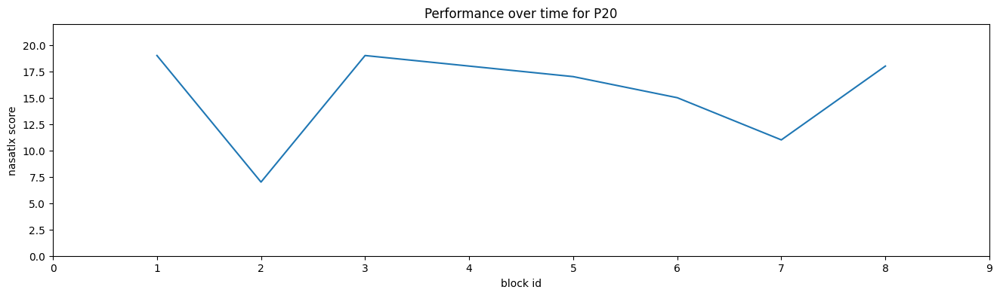

In [26]:
for pid in participant_ids:
    participant_df = df.query(f"participant_id == {pid}")
    plt.figure(figsize=(16, 4))
    plt.plot(participant_df['block_id'], participant_df['NASA_TLX_02'])
    plt.title(f'Performance over time for P{pid}')
    plt.xlabel('block id')
    plt.ylabel('nasatlx score')
    plt.xlim(0, 9)
    plt.ylim(0, 22)
    plt.show()

##### Effort overtime
- Good

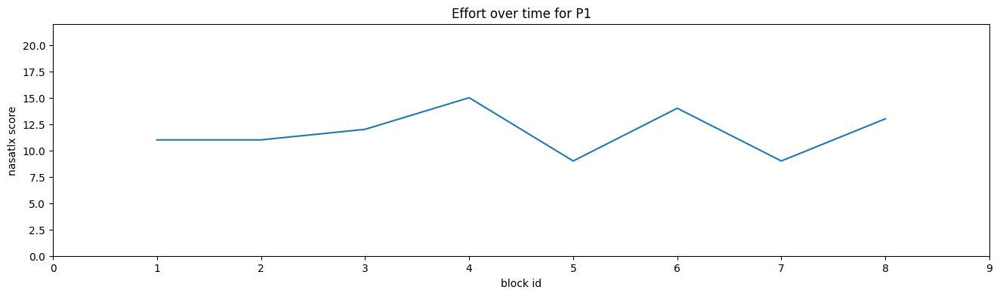

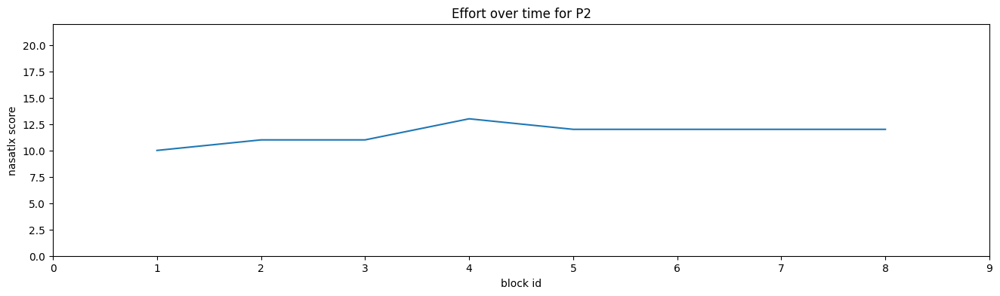

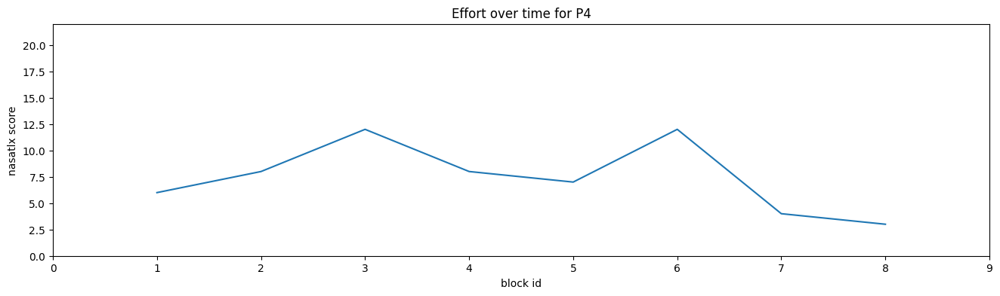

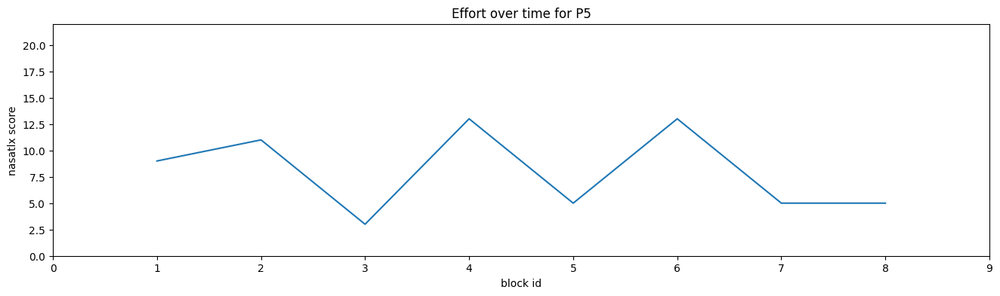

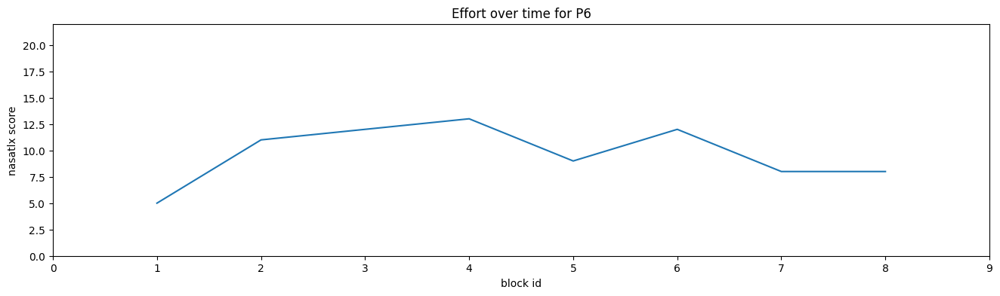

...

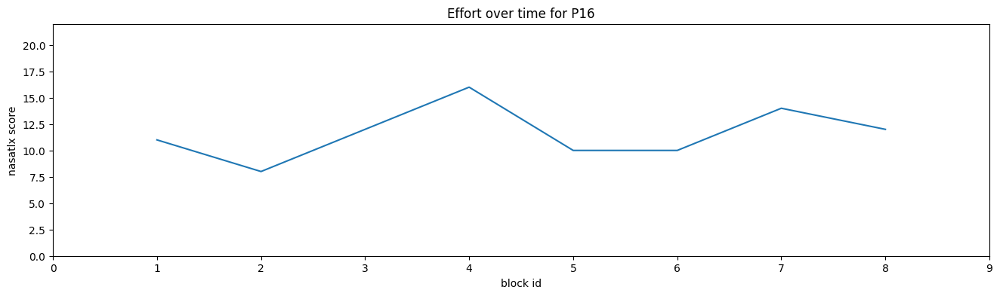

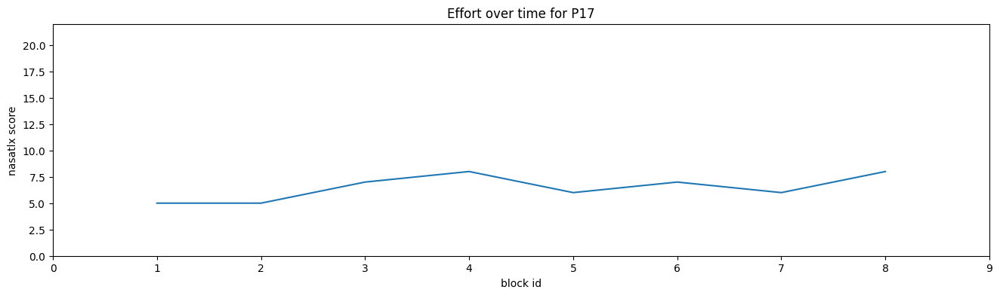

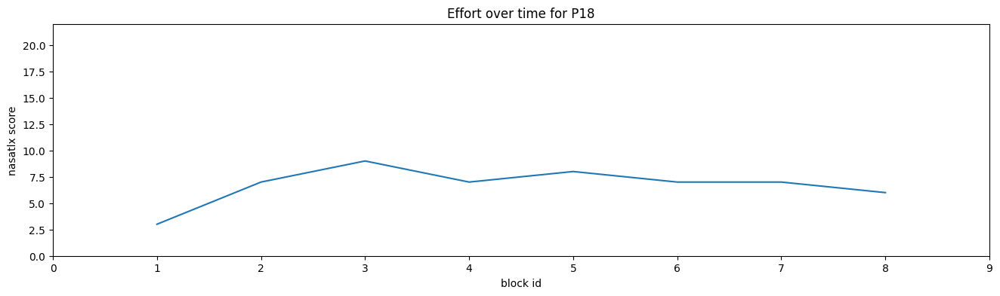

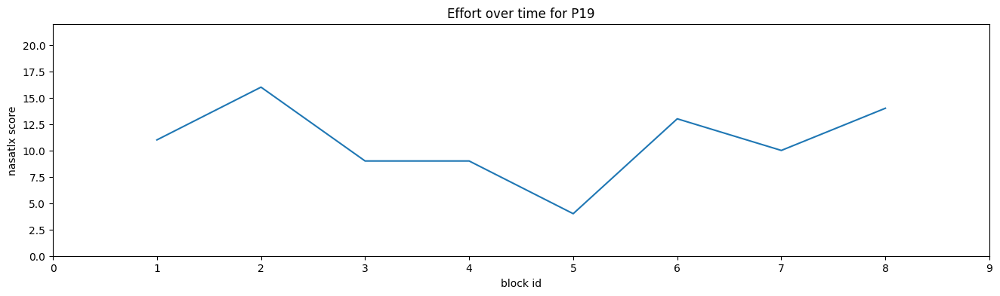

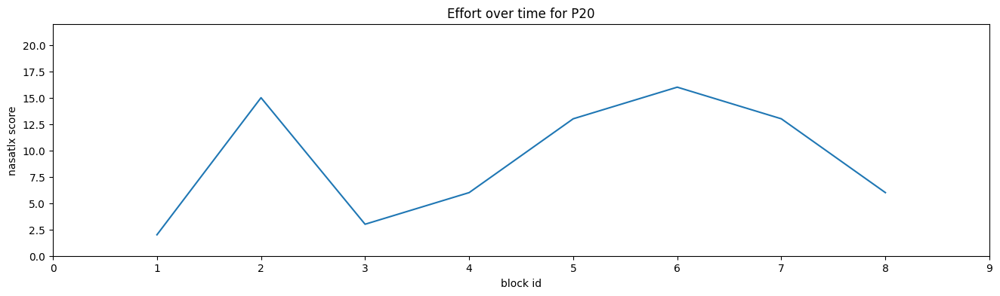

In [27]:
for pid in participant_ids:
    participant_df = df.query(f"participant_id == {pid}")
    plt.figure(figsize=(16, 4))
    plt.plot(participant_df['block_id'], participant_df['NASA_TLX_03'])
    plt.title(f'Effort over time for P{pid}')
    plt.xlabel('block id')
    plt.ylabel('nasatlx score')
    plt.xlim(0, 9)
    plt.ylim(0, 22)
    plt.show()

##### Frustration overtime
- Good

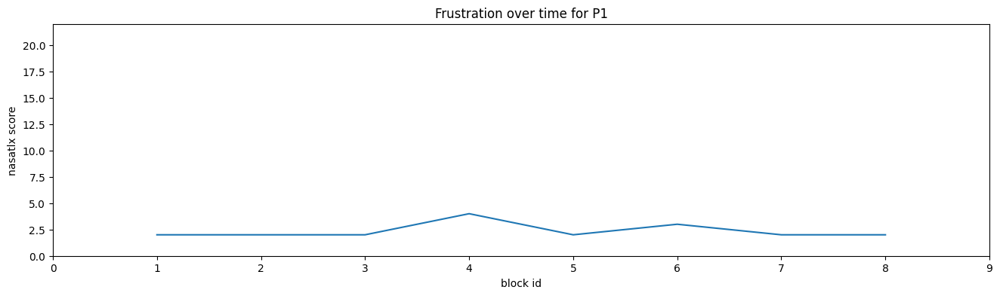

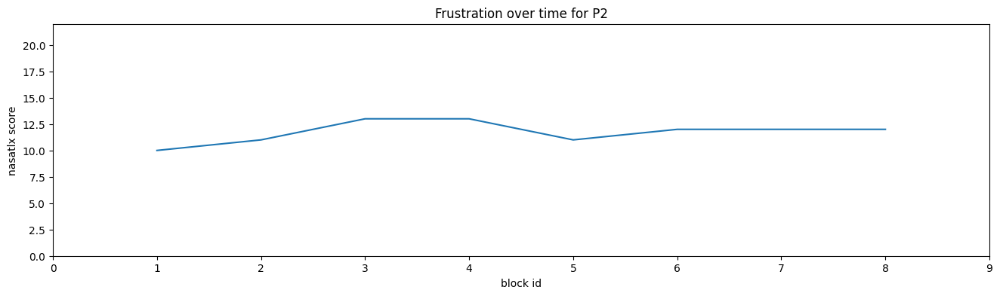

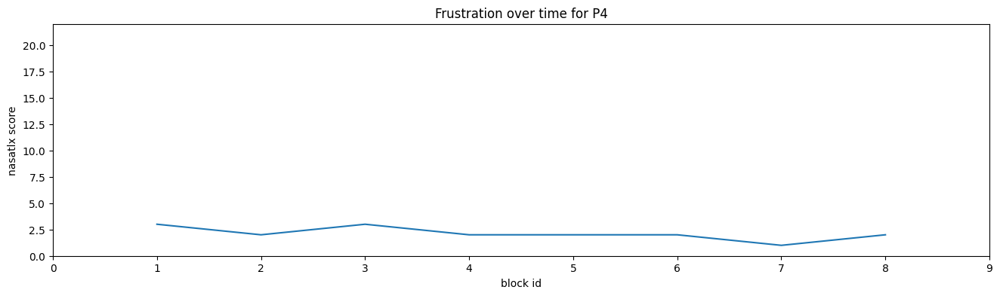

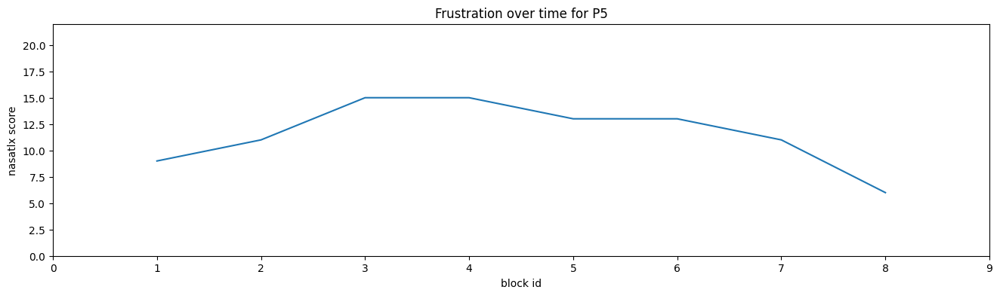

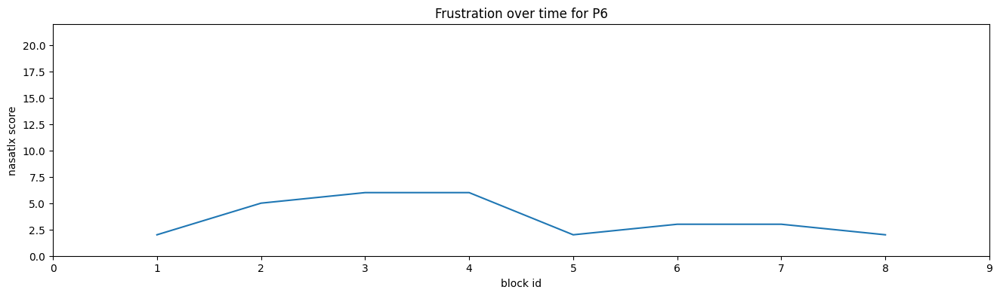

...

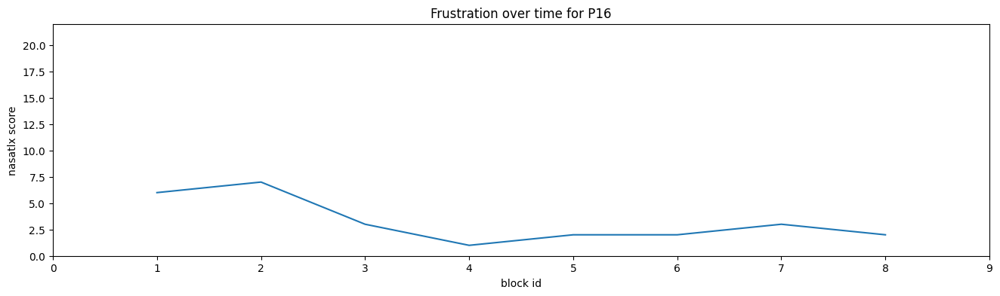

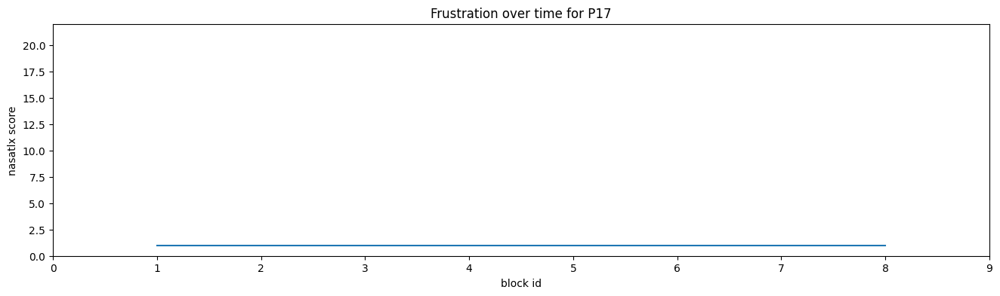

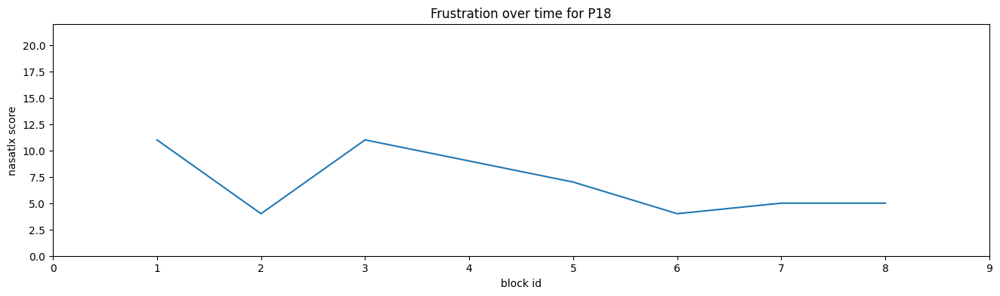

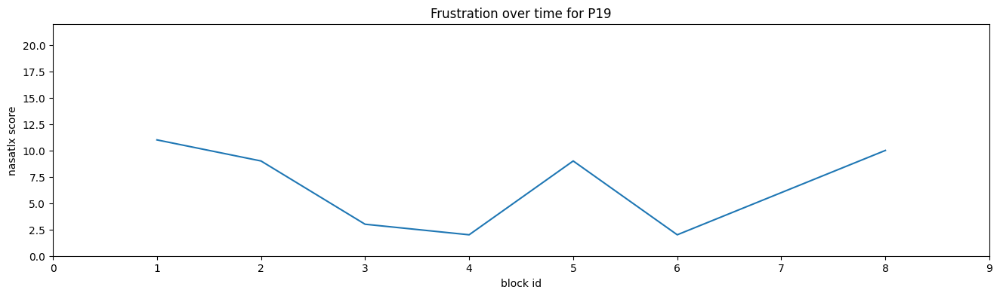

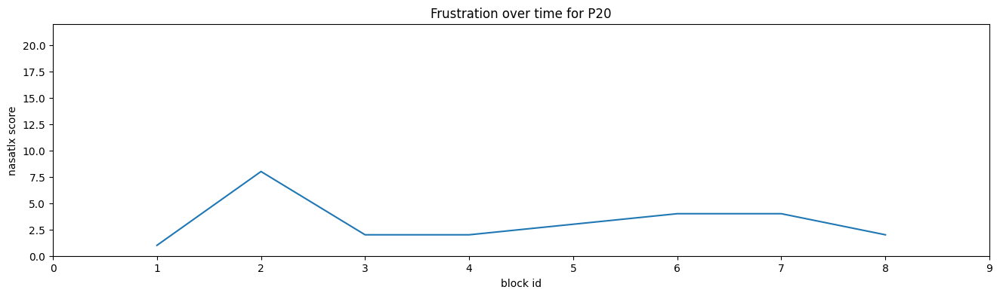

In [28]:
for pid in participant_ids:
    participant_df = df.query(f"participant_id == {pid}")
    plt.figure(figsize=(16, 4))
    plt.plot(participant_df['block_id'], participant_df['NASA_TLX_04'])
    plt.title(f'Frustration over time for P{pid}')
    plt.xlabel('block id')
    plt.ylabel('nasatlx score')
    plt.xlim(0, 9)
    plt.ylim(0, 22)
    plt.show()

##### Temporal demands overtime
- Good

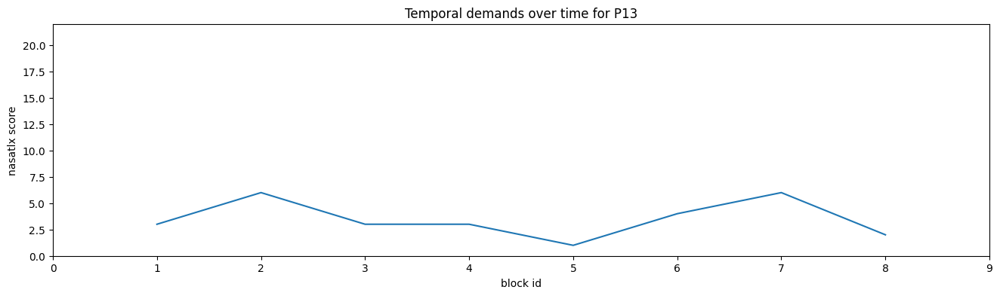

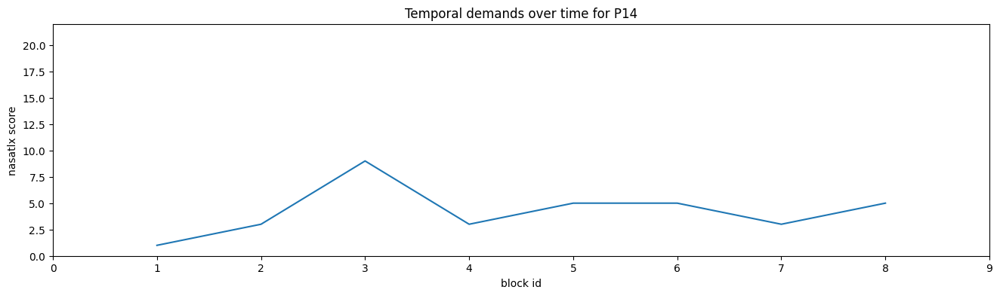

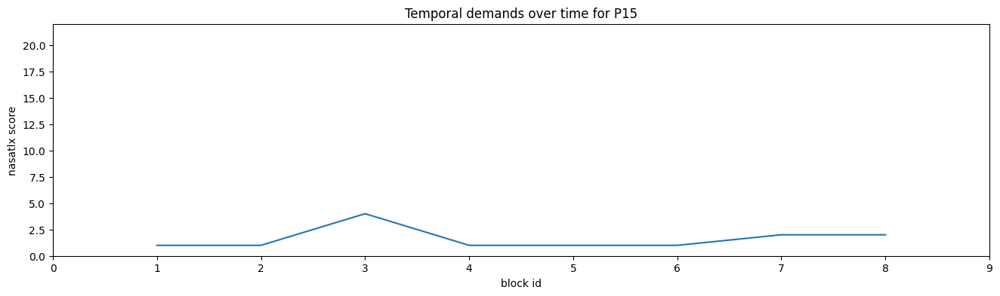

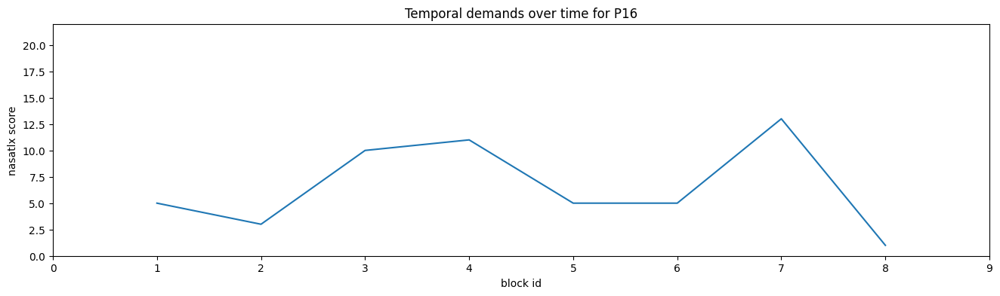

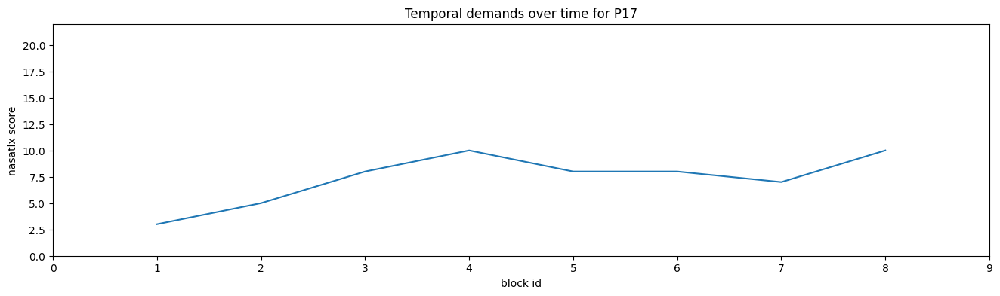

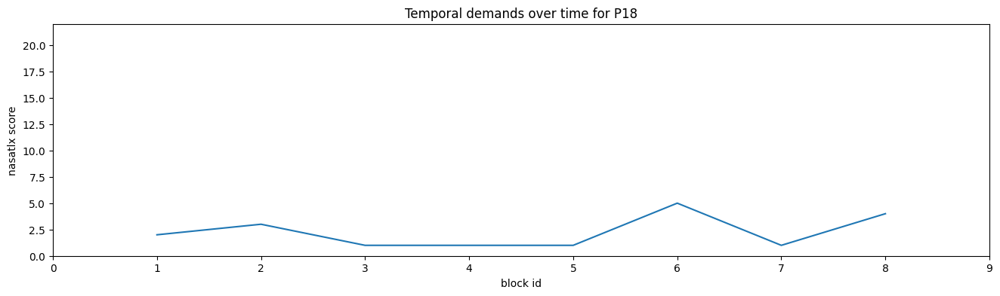

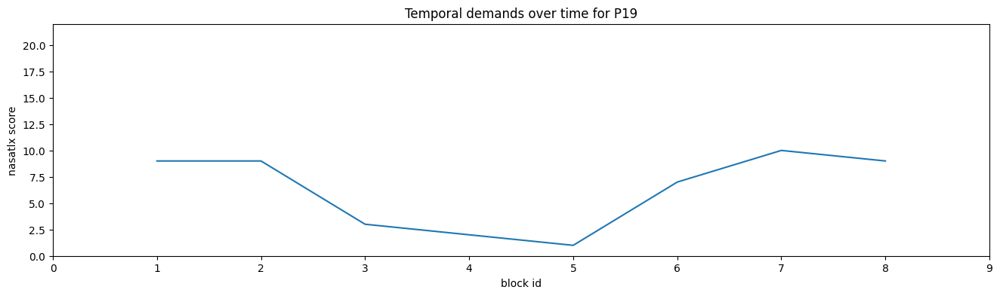

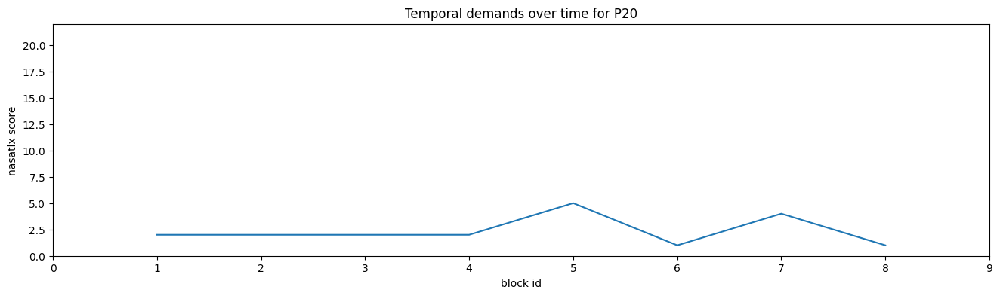

In [29]:
for pid in participant_ids:
    if pid > 12:
        participant_df = df.query(f"participant_id == {pid}")
    else:
        continue
    plt.figure(figsize=(16, 4))
    plt.plot(participant_df['block_id'], participant_df['NASA_TLX_05'])
    plt.title(f'Temporal demands over time for P{pid}')
    plt.xlabel('block id')
    plt.ylabel('nasatlx score')
    plt.xlim(0, 9)
    plt.ylim(0, 22)
    plt.show()

##### Flow requirements overtime
- Good

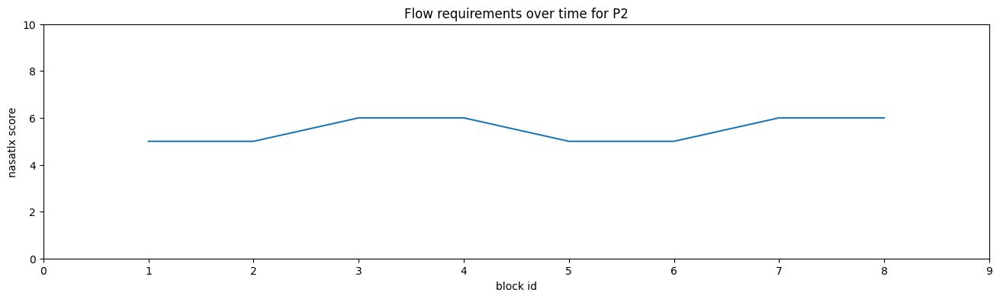

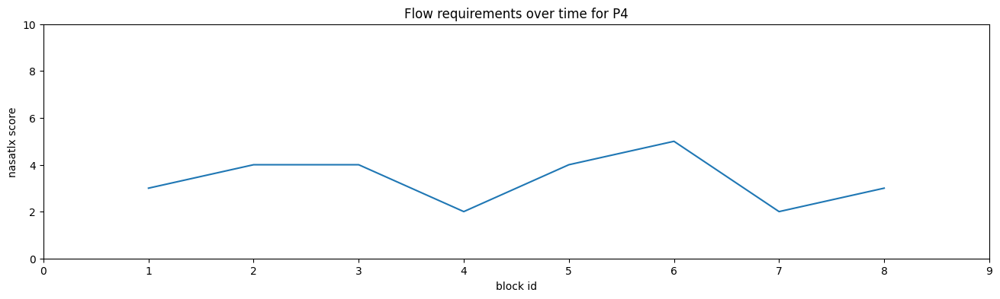

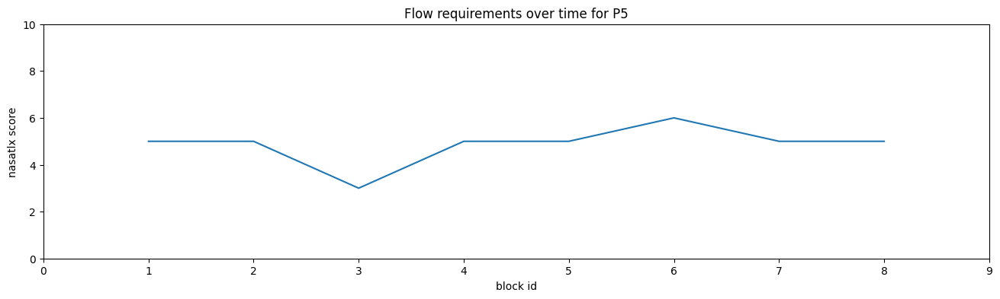

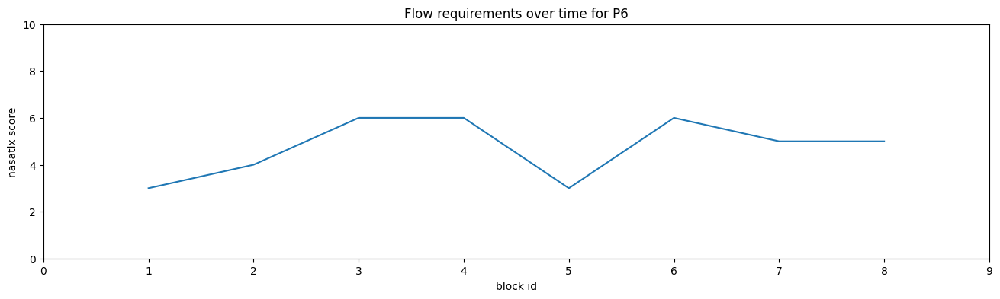

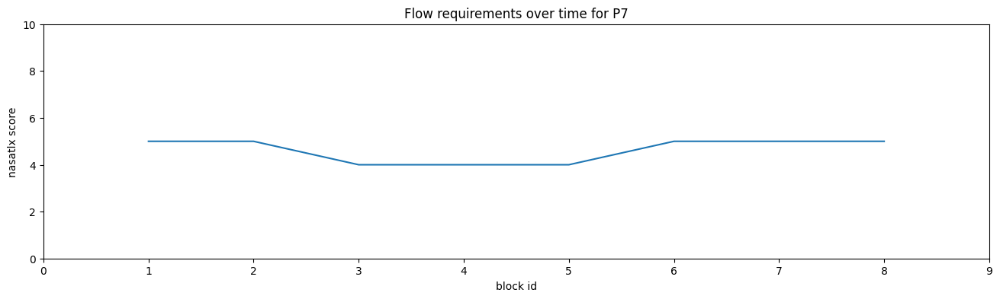

...

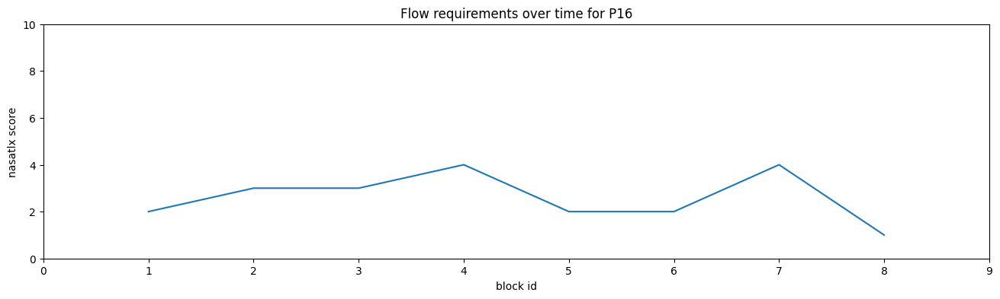

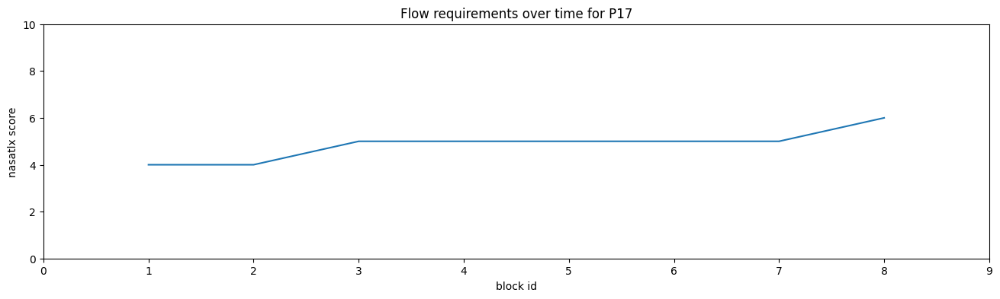

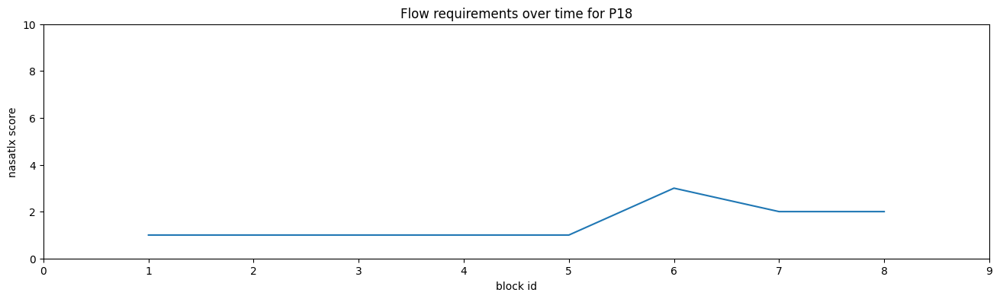

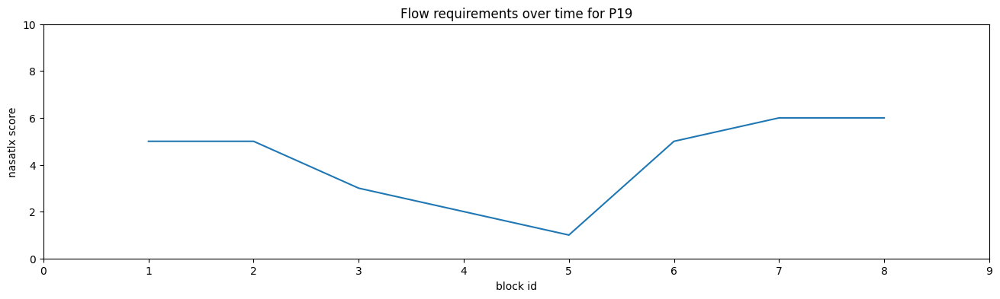

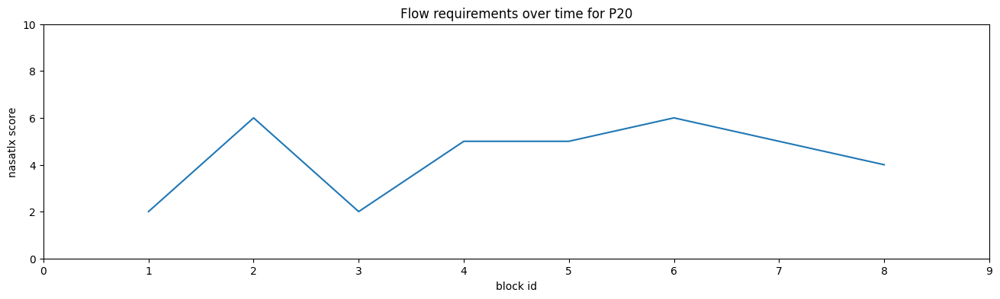

In [30]:
for pid in participant_ids:
    if pid > 1:
        participant_df = df.query(f"participant_id == {pid}")
    else:
        continue
    plt.figure(figsize=(16, 4))
    plt.plot(participant_df['block_id'], participant_df['FL_Score'])
    plt.title(f'Flow requirements over time for P{pid}')
    plt.xlabel('block id')
    plt.ylabel('nasatlx score')
    plt.xlim(0, 9)
    plt.ylim(0, 10)
    plt.show()

### 4. IV Analysis

In [10]:
# Define variables
# Difficulty
easy_block = [1, 2, 5, 6]
hard_block = [3, 4, 7, 8]

# Frequency
slow_block = [1, 3, 5, 7]
fast_block = [2, 4, 6, 8]

# Difficulty+Frequency
easy_slow_block = [1, 5]
easy_fast_block = [2, 6]
hard_slow_block = [3, 7]
hard_fast_block = [4, 8]

In [17]:
# Z-score Normalization
NASA_TLX_norm_Score = []

for pid in participant_ids:
    p_df = df.query(f"participant_id == {pid}")
    
    mean_score = p_df['NASA_TLX_Score'].mean()
    std_score = p_df['NASA_TLX_Score'].std()
    
    z_scores = (p_df['NASA_TLX_Score'] - mean_score) / std_score
    NASA_TLX_norm_Score.extend(z_scores)

df['NASA_TLX_norm_Score'] = NASA_TLX_norm_Score

In [ ]:
# MinMax Normalization (2)
NASA_TLX_minmax_Score = []

for pid in participant_ids:
    p_df = df.query(f"participant_id == {pid}")
    
    min_score = p_df['NASA_TLX_Score'].min()
    max_score = p_df['NASA_TLX_Score'].max()
    
    minmax_scores = (p_df['NASA_TLX_Score'] - min_score) / (max_score - min_score)
    NASA_TLX_minmax_Score.extend(minmax_scores)

df['NASA_TLX_minmax_Score'] = NASA_TLX_norm_Score

In [8]:
# Define dfs
df_easy = df[df['block_type'].isin(easy_block)]
df_hard = df[df['block_type'].isin(hard_block)]

df_slow = df[df['block_type'].isin(slow_block)]
df_fast = df[df['block_type'].isin(fast_block)]

df_easy_slow = df[df['block_type'].isin(easy_slow_block)]
df_easy_fast = df[df['block_type'].isin(easy_fast_block)]
df_hard_slow = df[df['block_type'].isin(hard_slow_block)]
df_hard_fast = df[df['block_type'].isin(hard_fast_block)]

##### Distribution comparison
- (...)

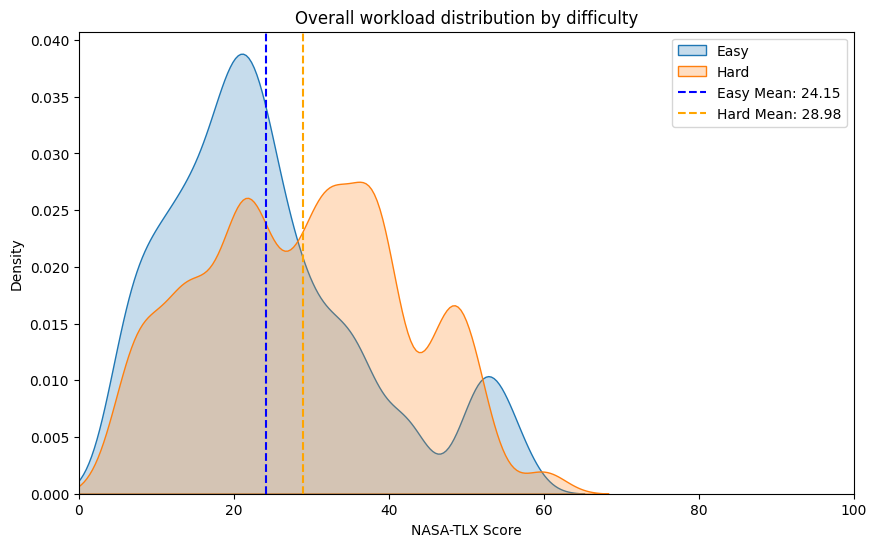

In [35]:
# Difficulty
plt.figure(figsize=(10, 6))
sns.kdeplot(df_easy['NASA_TLX_Score'], fill=True, label='Easy', bw_adjust=0.5)
sns.kdeplot(df_hard['NASA_TLX_Score'], fill=True, label='Hard', bw_adjust=0.5)

mean_easy = df_easy['NASA_TLX_Score'].mean()
plt.axvline(mean_easy, color='blue', linestyle='--', label=f'Easy Mean: {mean_easy:.2f}')
mean_hard = df_hard['NASA_TLX_Score'].mean()
plt.axvline(mean_hard, color='orange', linestyle='--', label=f'Hard Mean: {mean_hard:.2f}')

plt.title('Overall workload distribution by difficulty')
plt.xlabel('NASA-TLX Score')
plt.ylabel('Density')
plt.xlim(0, 100)
plt.legend()
plt.show()

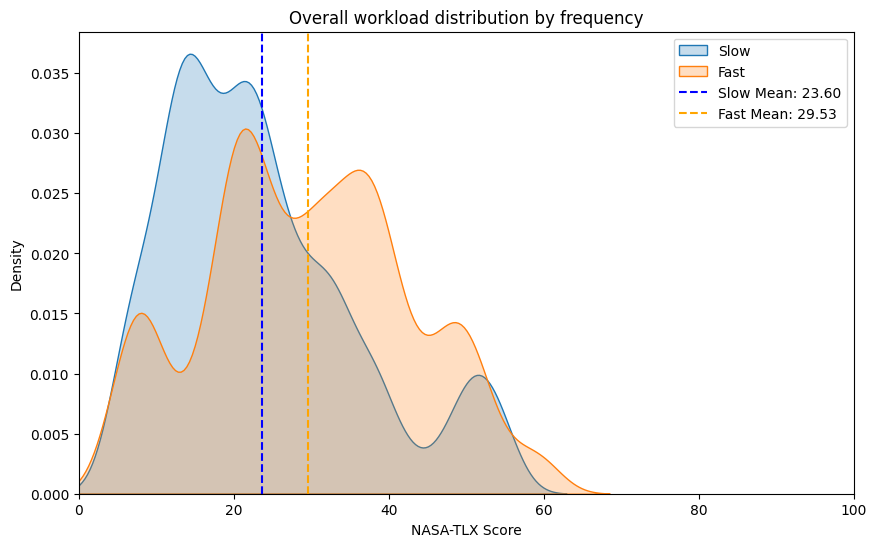

In [36]:
# Frequency
plt.figure(figsize=(10, 6))
sns.kdeplot(df_slow['NASA_TLX_Score'], fill=True, label='Slow', bw_adjust=0.5)
sns.kdeplot(df_fast['NASA_TLX_Score'], fill=True, label='Fast', bw_adjust=0.5)

mean_slow = df_slow['NASA_TLX_Score'].mean()
plt.axvline(mean_slow, color='blue', linestyle='--', label=f'Slow Mean: {mean_slow:.2f}')
mean_fast = df_fast['NASA_TLX_Score'].mean()
plt.axvline(mean_fast, color='orange', linestyle='--', label=f'Fast Mean: {mean_fast:.2f}')

plt.title('Overall workload distribution by frequency')
plt.xlabel('NASA-TLX Score')
plt.ylabel('Density')
plt.xlim(0, 100)
plt.legend()
plt.show()

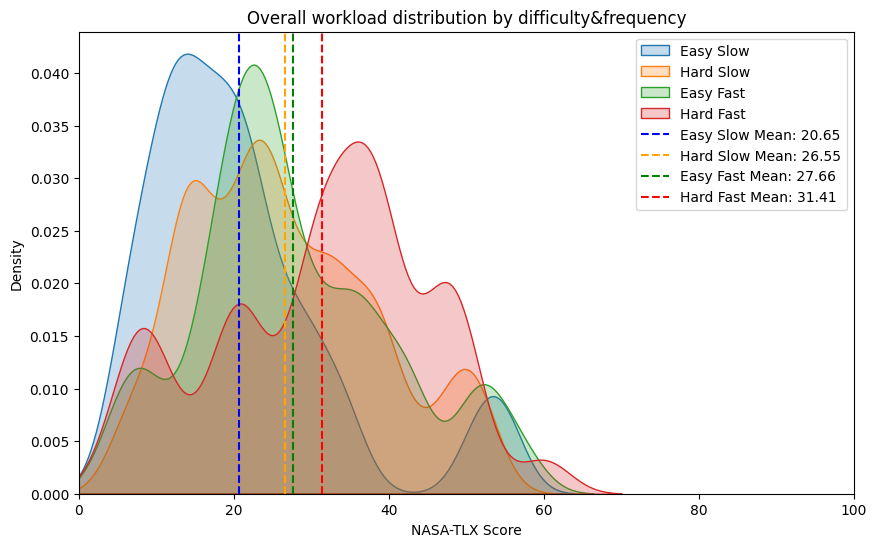

In [37]:
# Difficulty+frequency
plt.figure(figsize=(10, 6))
sns.kdeplot(df_easy_slow['NASA_TLX_Score'], fill=True, label='Easy Slow', bw_adjust=0.5)
sns.kdeplot(df_hard_slow['NASA_TLX_Score'], fill=True, label='Hard Slow', bw_adjust=0.5)
sns.kdeplot(df_easy_fast['NASA_TLX_Score'], fill=True, label='Easy Fast', bw_adjust=0.5)
sns.kdeplot(df_hard_fast['NASA_TLX_Score'], fill=True, label='Hard Fast', bw_adjust=0.5)

mean_easy_slow = df_easy_slow['NASA_TLX_Score'].mean()
plt.axvline(mean_easy_slow, color='blue', linestyle='--', label=f'Easy Slow Mean: {mean_easy_slow:.2f}')
mean_hard_slow = df_hard_slow['NASA_TLX_Score'].mean()
plt.axvline(mean_hard_slow, color='orange', linestyle='--', label=f'Hard Slow Mean: {mean_hard_slow:.2f}')
mean_easy_fast = df_easy_fast['NASA_TLX_Score'].mean()
plt.axvline(mean_easy_fast, color='green', linestyle='--', label=f'Easy Fast Mean: {mean_easy_fast:.2f}')
mean_hard_fast = df_hard_fast['NASA_TLX_Score'].mean()
plt.axvline(mean_hard_fast, color='red', linestyle='--', label=f'Hard Fast Mean: {mean_hard_fast:.2f}')

plt.title('Overall workload distribution by difficulty&frequency')
plt.xlabel('NASA-TLX Score')
plt.ylabel('Density')
plt.xlim(0, 100)
plt.legend()
plt.show()

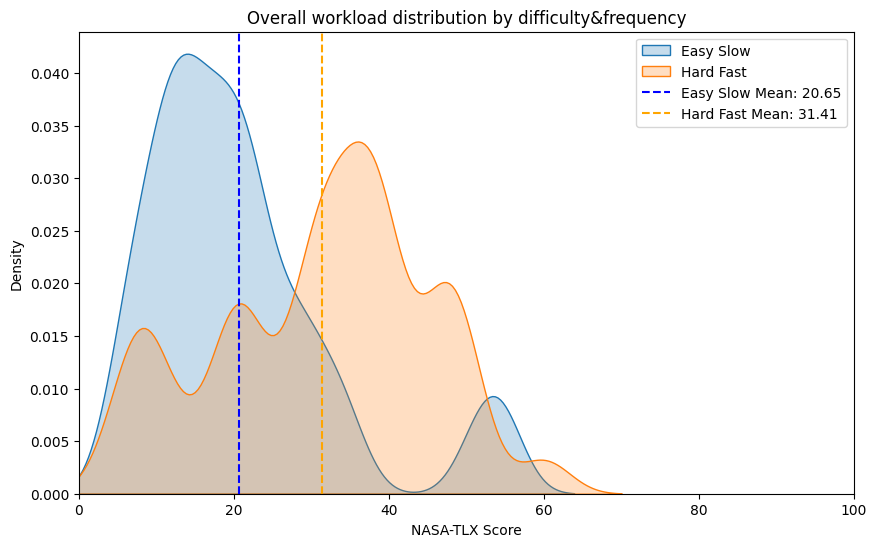

In [38]:
# Extreme conditions
plt.figure(figsize=(10, 6))
sns.kdeplot(df_easy_slow['NASA_TLX_Score'], fill=True, label='Easy Slow', bw_adjust=0.5)
sns.kdeplot(df_hard_fast['NASA_TLX_Score'], fill=True, label='Hard Fast', bw_adjust=0.5)

mean_easy_slow = df_easy_slow['NASA_TLX_Score'].mean()
plt.axvline(mean_easy_slow, color='blue', linestyle='--', label=f'Easy Slow Mean: {mean_easy_slow:.2f}')
mean_hard_fast = df_hard_fast['NASA_TLX_Score'].mean()
plt.axvline(mean_hard_fast, color='orange', linestyle='--', label=f'Hard Fast Mean: {mean_hard_fast:.2f}')

plt.title('Overall workload distribution by difficulty&frequency')
plt.xlabel('NASA-TLX Score')
plt.ylabel('Density')
plt.xlim(0, 100)
plt.legend()
plt.show()

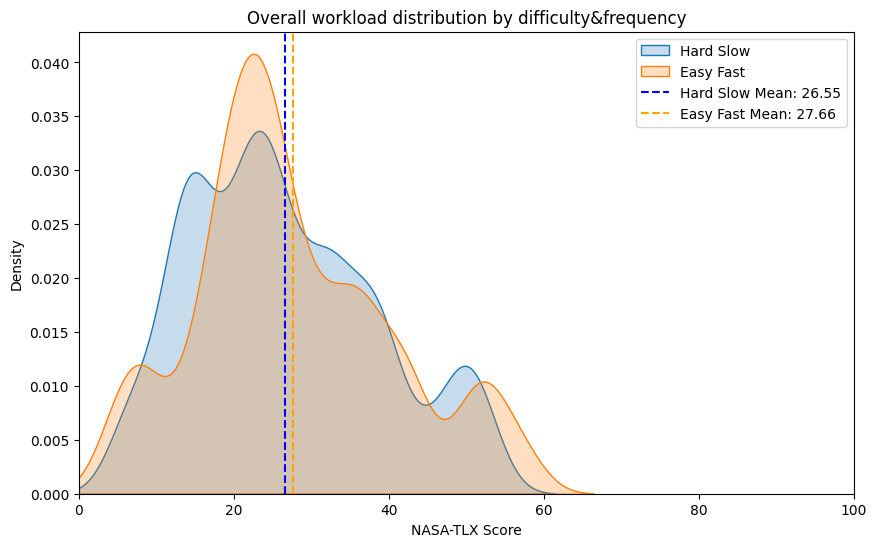

In [39]:
# Mid conditions
plt.figure(figsize=(10, 6))
sns.kdeplot(df_hard_slow['NASA_TLX_Score'], fill=True, label='Hard Slow', bw_adjust=0.5)
sns.kdeplot(df_easy_fast['NASA_TLX_Score'], fill=True, label='Easy Fast', bw_adjust=0.5)

mean_hard_slow = df_hard_slow['NASA_TLX_Score'].mean()
plt.axvline(mean_hard_slow, color='blue', linestyle='--', label=f'Hard Slow Mean: {mean_hard_slow:.2f}')
mean_easy_fast = df_easy_fast['NASA_TLX_Score'].mean()
plt.axvline(mean_easy_fast, color='orange', linestyle='--', label=f'Easy Fast Mean: {mean_easy_fast:.2f}')

plt.title('Overall workload distribution by difficulty&frequency')
plt.xlabel('NASA-TLX Score')
plt.ylabel('Density')
plt.xlim(0, 100)
plt.legend()
plt.show()

##### Distribution comparison (normalized)
- (...)

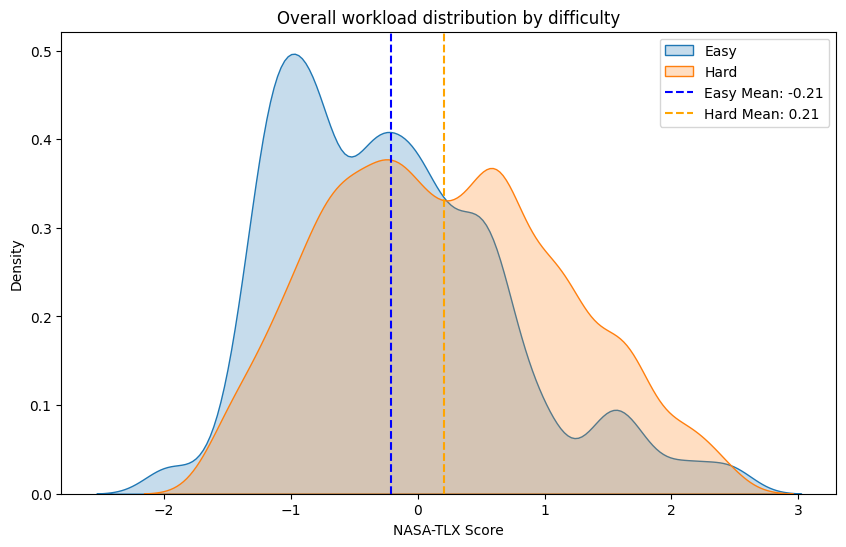

In [40]:
# Difficulty
plt.figure(figsize=(10, 6))
sns.kdeplot(df_easy['NASA_TLX_norm_Score'], fill=True, label='Easy', bw_adjust=0.5)
sns.kdeplot(df_hard['NASA_TLX_norm_Score'], fill=True, label='Hard', bw_adjust=0.5)

mean_easy = df_easy['NASA_TLX_norm_Score'].mean()
plt.axvline(mean_easy, color='blue', linestyle='--', label=f'Easy Mean: {mean_easy:.2f}')
mean_hard = df_hard['NASA_TLX_norm_Score'].mean()
plt.axvline(mean_hard, color='orange', linestyle='--', label=f'Hard Mean: {mean_hard:.2f}')

plt.title('Overall workload distribution by difficulty')
plt.xlabel('NASA-TLX Score')
plt.ylabel('Density')
# plt.xlim(0, 100)
plt.legend()
plt.show()

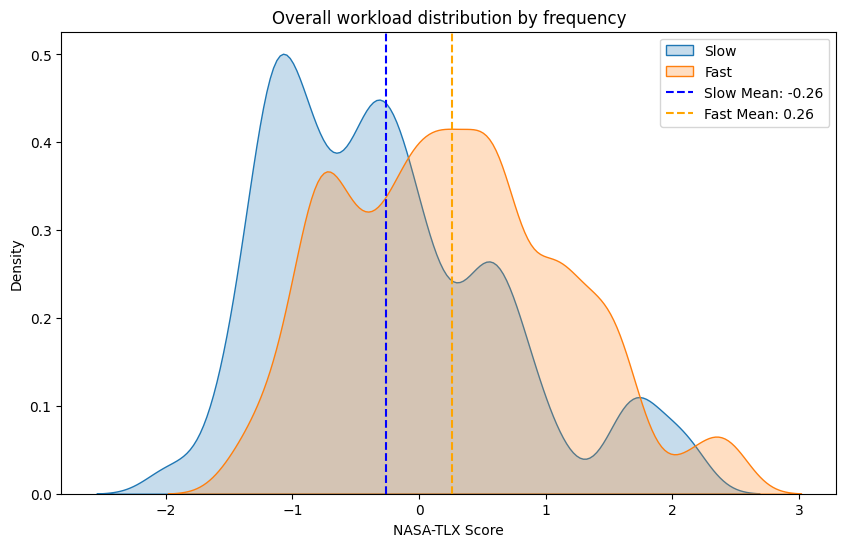

In [41]:
# Frequency
plt.figure(figsize=(10, 6))
sns.kdeplot(df_slow['NASA_TLX_norm_Score'], fill=True, label='Slow', bw_adjust=0.5)
sns.kdeplot(df_fast['NASA_TLX_norm_Score'], fill=True, label='Fast', bw_adjust=0.5)

mean_slow = df_slow['NASA_TLX_norm_Score'].mean()
plt.axvline(mean_slow, color='blue', linestyle='--', label=f'Slow Mean: {mean_slow:.2f}')
mean_fast = df_fast['NASA_TLX_norm_Score'].mean()
plt.axvline(mean_fast, color='orange', linestyle='--', label=f'Fast Mean: {mean_fast:.2f}')

plt.title('Overall workload distribution by frequency')
plt.xlabel('NASA-TLX Score')
plt.ylabel('Density')
# plt.xlim(0, 100)
plt.legend()
plt.show()

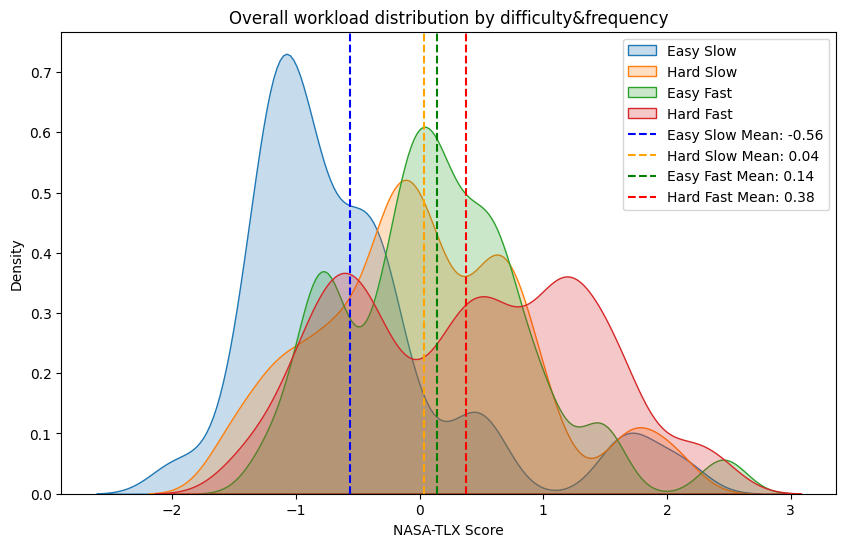

In [42]:
# Difficulty+frequency
plt.figure(figsize=(10, 6))
sns.kdeplot(df_easy_slow['NASA_TLX_norm_Score'], fill=True, label='Easy Slow', bw_adjust=0.5)
sns.kdeplot(df_hard_slow['NASA_TLX_norm_Score'], fill=True, label='Hard Slow', bw_adjust=0.5)
sns.kdeplot(df_easy_fast['NASA_TLX_norm_Score'], fill=True, label='Easy Fast', bw_adjust=0.5)
sns.kdeplot(df_hard_fast['NASA_TLX_norm_Score'], fill=True, label='Hard Fast', bw_adjust=0.5)

mean_easy_slow = df_easy_slow['NASA_TLX_norm_Score'].mean()
plt.axvline(mean_easy_slow, color='blue', linestyle='--', label=f'Easy Slow Mean: {mean_easy_slow:.2f}')
mean_hard_slow = df_hard_slow['NASA_TLX_norm_Score'].mean()
plt.axvline(mean_hard_slow, color='orange', linestyle='--', label=f'Hard Slow Mean: {mean_hard_slow:.2f}')
mean_easy_fast = df_easy_fast['NASA_TLX_norm_Score'].mean()
plt.axvline(mean_easy_fast, color='green', linestyle='--', label=f'Easy Fast Mean: {mean_easy_fast:.2f}')
mean_hard_fast = df_hard_fast['NASA_TLX_norm_Score'].mean()
plt.axvline(mean_hard_fast, color='red', linestyle='--', label=f'Hard Fast Mean: {mean_hard_fast:.2f}')

plt.title('Overall workload distribution by difficulty&frequency')
plt.xlabel('NASA-TLX Score')
plt.ylabel('Density')
# plt.xlim(0, 100)
plt.legend()
plt.show()

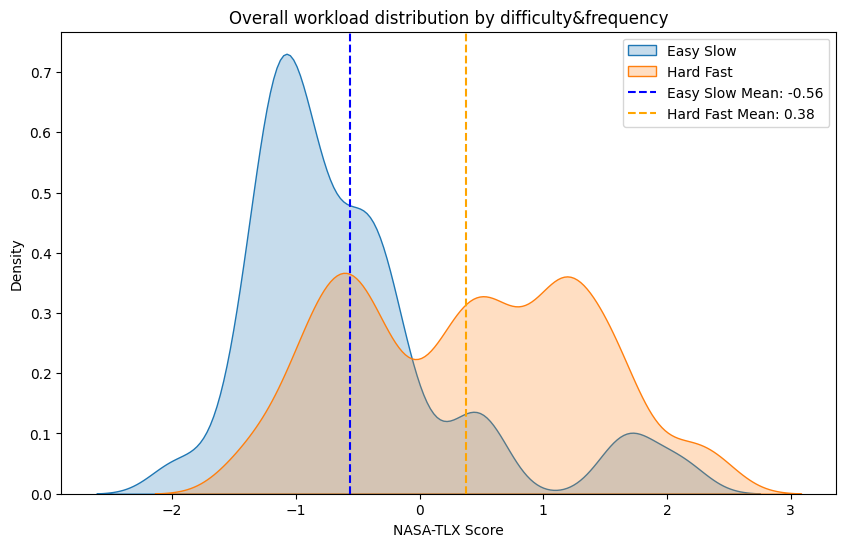

In [43]:
# Extreme conditions
plt.figure(figsize=(10, 6))
sns.kdeplot(df_easy_slow['NASA_TLX_norm_Score'], fill=True, label='Easy Slow', bw_adjust=0.5)
sns.kdeplot(df_hard_fast['NASA_TLX_norm_Score'], fill=True, label='Hard Fast', bw_adjust=0.5)

mean_easy_slow = df_easy_slow['NASA_TLX_norm_Score'].mean()
plt.axvline(mean_easy_slow, color='blue', linestyle='--', label=f'Easy Slow Mean: {mean_easy_slow:.2f}')
mean_hard_fast = df_hard_fast['NASA_TLX_norm_Score'].mean()
plt.axvline(mean_hard_fast, color='orange', linestyle='--', label=f'Hard Fast Mean: {mean_hard_fast:.2f}')

plt.title('Overall workload distribution by difficulty&frequency')
plt.xlabel('NASA-TLX Score')
plt.ylabel('Density')
# plt.xlim(0, 100)
plt.legend()
plt.show()

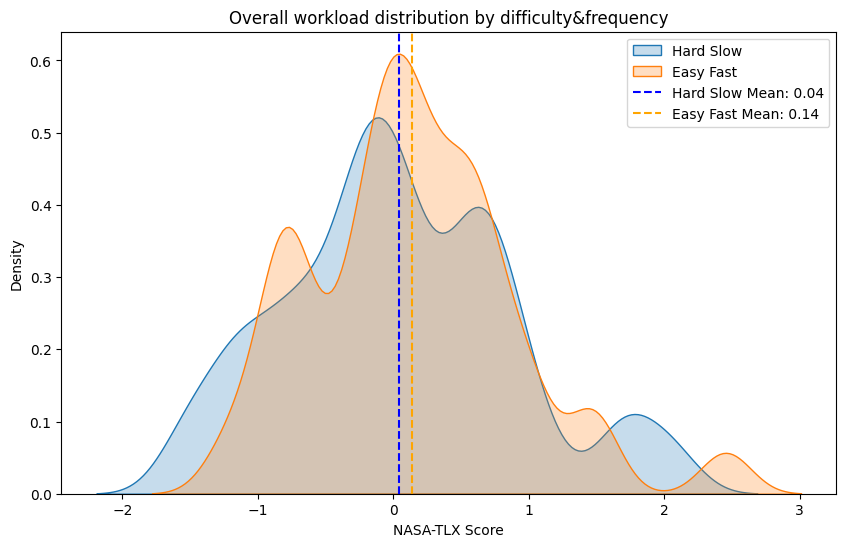

In [44]:
# Mid conditions
plt.figure(figsize=(10, 6))
sns.kdeplot(df_hard_slow['NASA_TLX_norm_Score'], fill=True, label='Hard Slow', bw_adjust=0.5)
sns.kdeplot(df_easy_fast['NASA_TLX_norm_Score'], fill=True, label='Easy Fast', bw_adjust=0.5)

mean_hard_slow = df_hard_slow['NASA_TLX_norm_Score'].mean()
plt.axvline(mean_hard_slow, color='blue', linestyle='--', label=f'Hard Slow Mean: {mean_hard_slow:.2f}')
mean_easy_fast = df_easy_fast['NASA_TLX_norm_Score'].mean()
plt.axvline(mean_easy_fast, color='orange', linestyle='--', label=f'Easy Fast Mean: {mean_easy_fast:.2f}')

plt.title('Overall workload distribution by difficulty&frequency')
plt.xlabel('NASA-TLX Score')
plt.ylabel('Density')
# plt.xlim(0, 100)
plt.legend()
plt.show()

##### Distribution comparison (normalized2)
- (...)

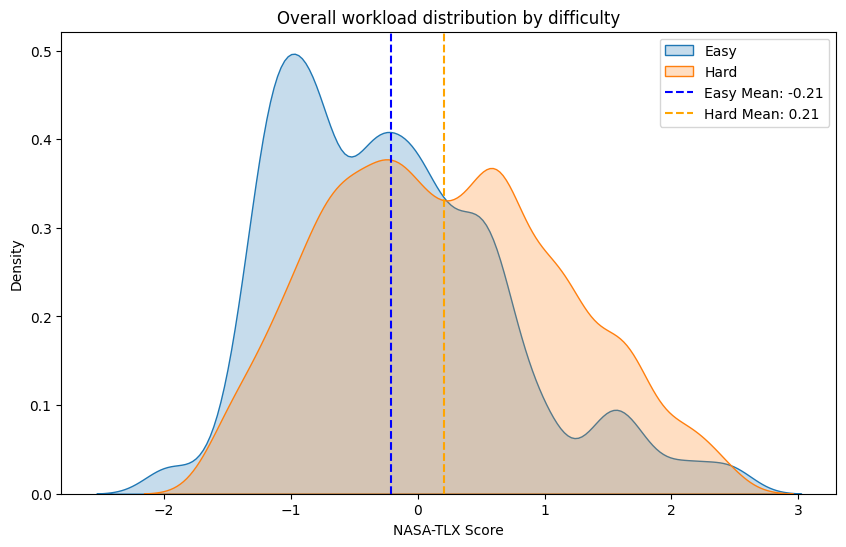

In [45]:
# Difficulty
plt.figure(figsize=(10, 6))
sns.kdeplot(df_easy['NASA_TLX_minmax_Score'], fill=True, label='Easy', bw_adjust=0.5)
sns.kdeplot(df_hard['NASA_TLX_minmax_Score'], fill=True, label='Hard', bw_adjust=0.5)

mean_easy = df_easy['NASA_TLX_minmax_Score'].mean()
plt.axvline(mean_easy, color='blue', linestyle='--', label=f'Easy Mean: {mean_easy:.2f}')
mean_hard = df_hard['NASA_TLX_minmax_Score'].mean()
plt.axvline(mean_hard, color='orange', linestyle='--', label=f'Hard Mean: {mean_hard:.2f}')

plt.title('Overall workload distribution by difficulty')
plt.xlabel('NASA-TLX Score')
plt.ylabel('Density')
plt.legend()
plt.show()

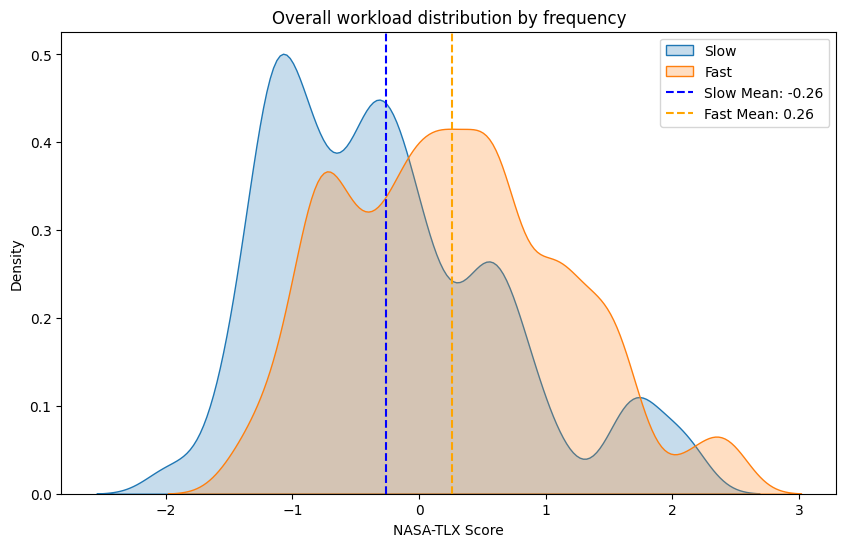

In [46]:
# Frequency
plt.figure(figsize=(10, 6))
sns.kdeplot(df_slow['NASA_TLX_minmax_Score'], fill=True, label='Slow', bw_adjust=0.5)
sns.kdeplot(df_fast['NASA_TLX_minmax_Score'], fill=True, label='Fast', bw_adjust=0.5)

mean_slow = df_slow['NASA_TLX_minmax_Score'].mean()
plt.axvline(mean_slow, color='blue', linestyle='--', label=f'Slow Mean: {mean_slow:.2f}')
mean_fast = df_fast['NASA_TLX_minmax_Score'].mean()
plt.axvline(mean_fast, color='orange', linestyle='--', label=f'Fast Mean: {mean_fast:.2f}')

plt.title('Overall workload distribution by frequency')
plt.xlabel('NASA-TLX Score')
plt.ylabel('Density')
plt.legend()
plt.show()

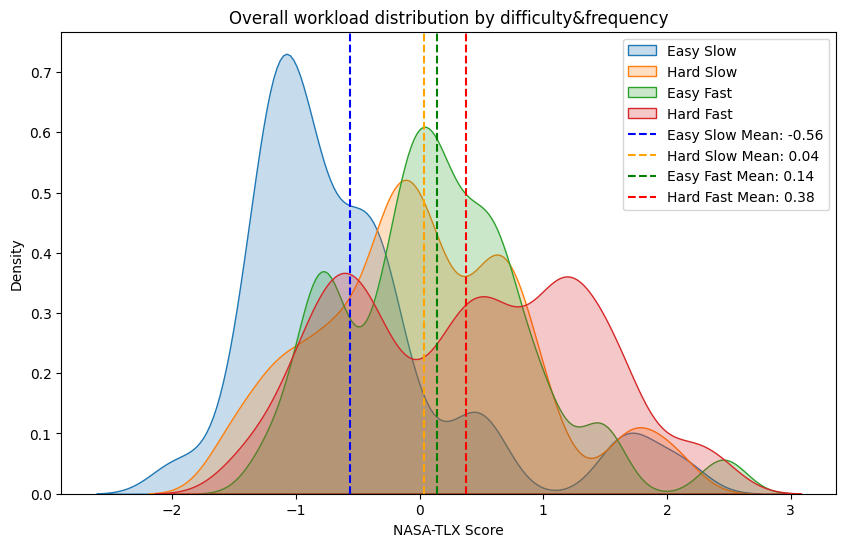

In [47]:
# Difficulty+frequency
plt.figure(figsize=(10, 6))
sns.kdeplot(df_easy_slow['NASA_TLX_minmax_Score'], fill=True, label='Easy Slow', bw_adjust=0.5)
sns.kdeplot(df_hard_slow['NASA_TLX_minmax_Score'], fill=True, label='Hard Slow', bw_adjust=0.5)
sns.kdeplot(df_easy_fast['NASA_TLX_minmax_Score'], fill=True, label='Easy Fast', bw_adjust=0.5)
sns.kdeplot(df_hard_fast['NASA_TLX_minmax_Score'], fill=True, label='Hard Fast', bw_adjust=0.5)

mean_easy_slow = df_easy_slow['NASA_TLX_minmax_Score'].mean()
plt.axvline(mean_easy_slow, color='blue', linestyle='--', label=f'Easy Slow Mean: {mean_easy_slow:.2f}')
mean_hard_slow = df_hard_slow['NASA_TLX_minmax_Score'].mean()
plt.axvline(mean_hard_slow, color='orange', linestyle='--', label=f'Hard Slow Mean: {mean_hard_slow:.2f}')
mean_easy_fast = df_easy_fast['NASA_TLX_minmax_Score'].mean()
plt.axvline(mean_easy_fast, color='green', linestyle='--', label=f'Easy Fast Mean: {mean_easy_fast:.2f}')
mean_hard_fast = df_hard_fast['NASA_TLX_minmax_Score'].mean()
plt.axvline(mean_hard_fast, color='red', linestyle='--', label=f'Hard Fast Mean: {mean_hard_fast:.2f}')

plt.title('Overall workload distribution by difficulty&frequency')
plt.xlabel('NASA-TLX Score')
plt.ylabel('Density')
plt.legend()
plt.show()

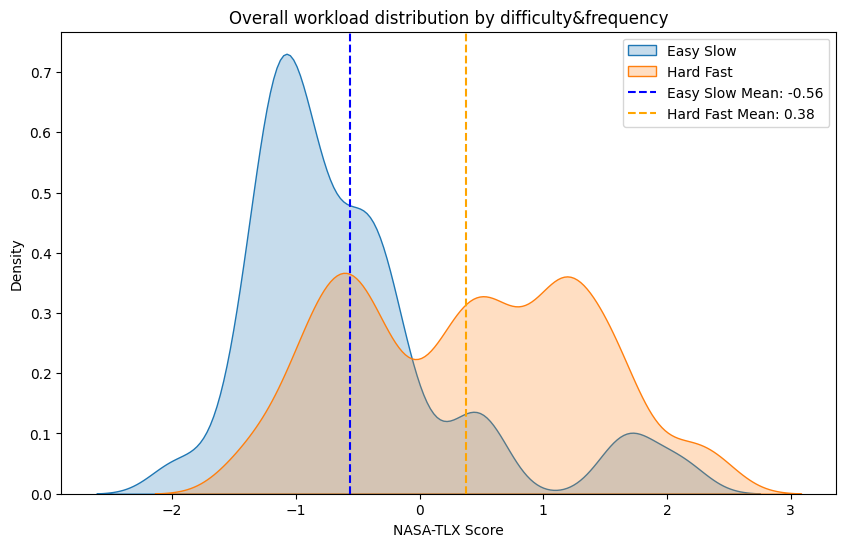

In [48]:
# Extreme conditions
plt.figure(figsize=(10, 6))
sns.kdeplot(df_easy_slow['NASA_TLX_minmax_Score'], fill=True, label='Easy Slow', bw_adjust=0.5)
sns.kdeplot(df_hard_fast['NASA_TLX_minmax_Score'], fill=True, label='Hard Fast', bw_adjust=0.5)

mean_easy_slow = df_easy_slow['NASA_TLX_minmax_Score'].mean()
plt.axvline(mean_easy_slow, color='blue', linestyle='--', label=f'Easy Slow Mean: {mean_easy_slow:.2f}')
mean_hard_fast = df_hard_fast['NASA_TLX_minmax_Score'].mean()
plt.axvline(mean_hard_fast, color='orange', linestyle='--', label=f'Hard Fast Mean: {mean_hard_fast:.2f}')

plt.title('Overall workload distribution by difficulty&frequency')
plt.xlabel('NASA-TLX Score')
plt.ylabel('Density')
plt.legend()
plt.show()

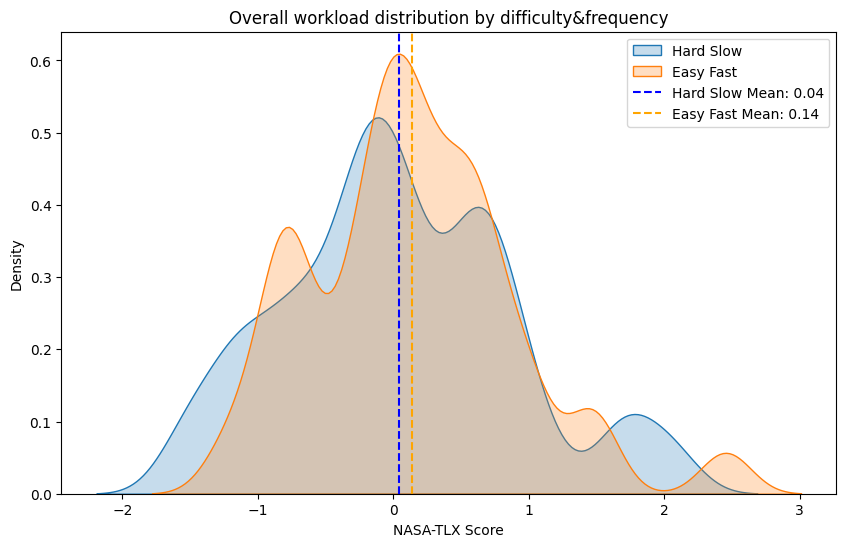

In [49]:
# Mid conditions
plt.figure(figsize=(10, 6))
sns.kdeplot(df_hard_slow['NASA_TLX_norm_Score'], fill=True, label='Hard Slow', bw_adjust=0.5)
sns.kdeplot(df_easy_fast['NASA_TLX_norm_Score'], fill=True, label='Easy Fast', bw_adjust=0.5)

mean_hard_slow = df_hard_slow['NASA_TLX_norm_Score'].mean()
plt.axvline(mean_hard_slow, color='blue', linestyle='--', label=f'Hard Slow Mean: {mean_hard_slow:.2f}')
mean_easy_fast = df_easy_fast['NASA_TLX_norm_Score'].mean()
plt.axvline(mean_easy_fast, color='orange', linestyle='--', label=f'Easy Fast Mean: {mean_easy_fast:.2f}')

plt.title('Overall workload distribution by difficulty&frequency')
plt.xlabel('NASA-TLX Score')
plt.ylabel('Density')
# plt.xlim(0, 100)
plt.legend()
plt.show()

##### Distribution comparison (per participant)
- (...)

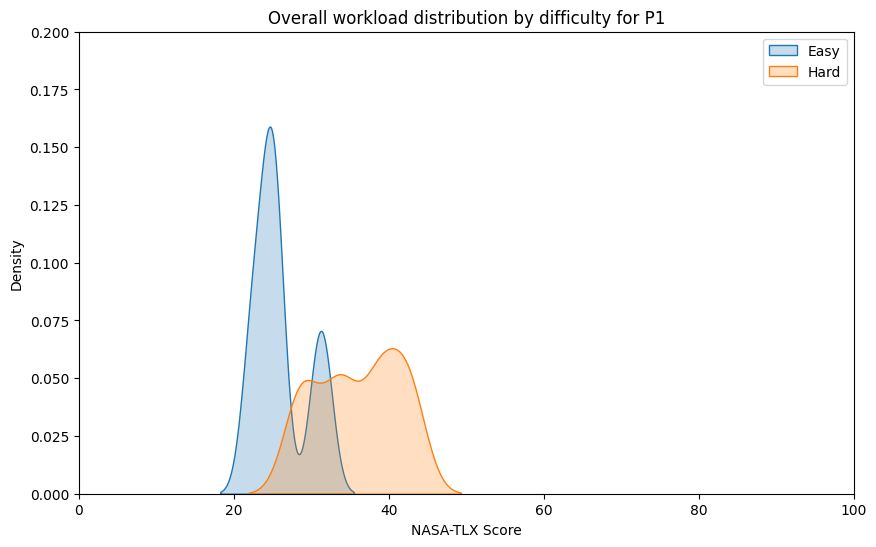

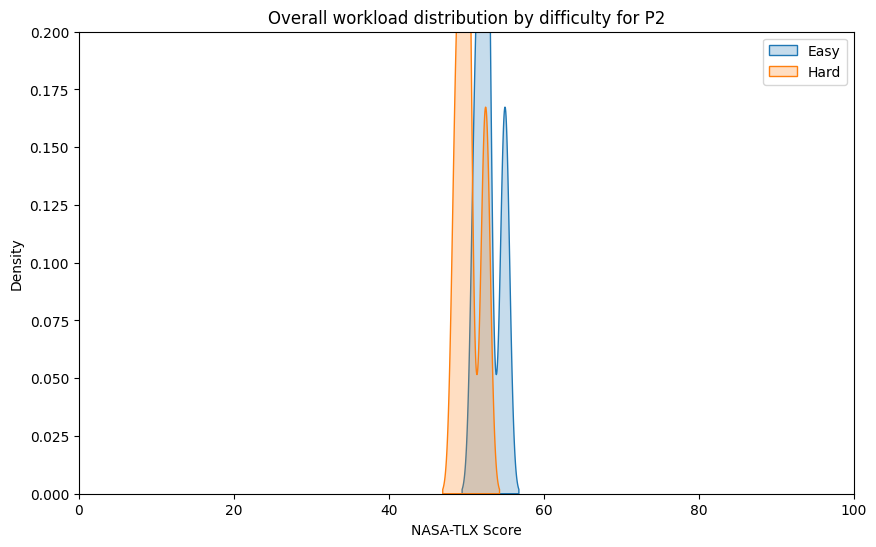

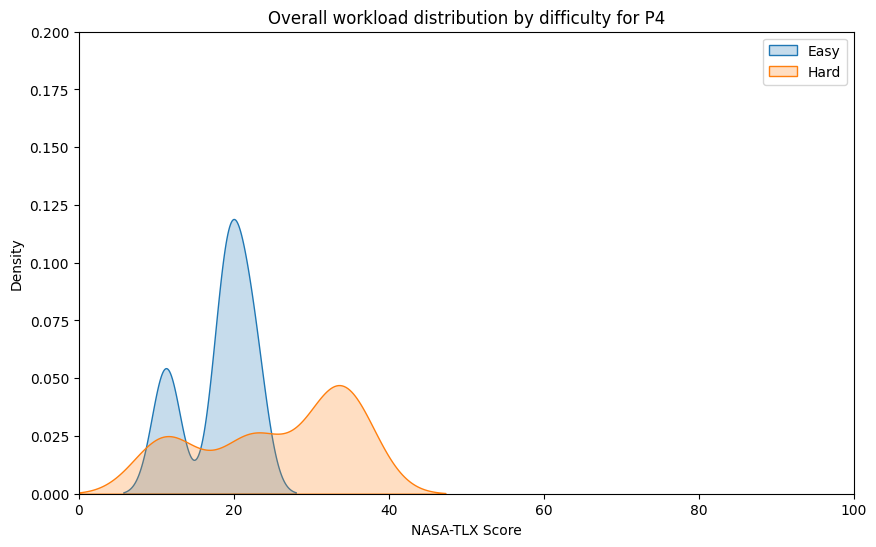

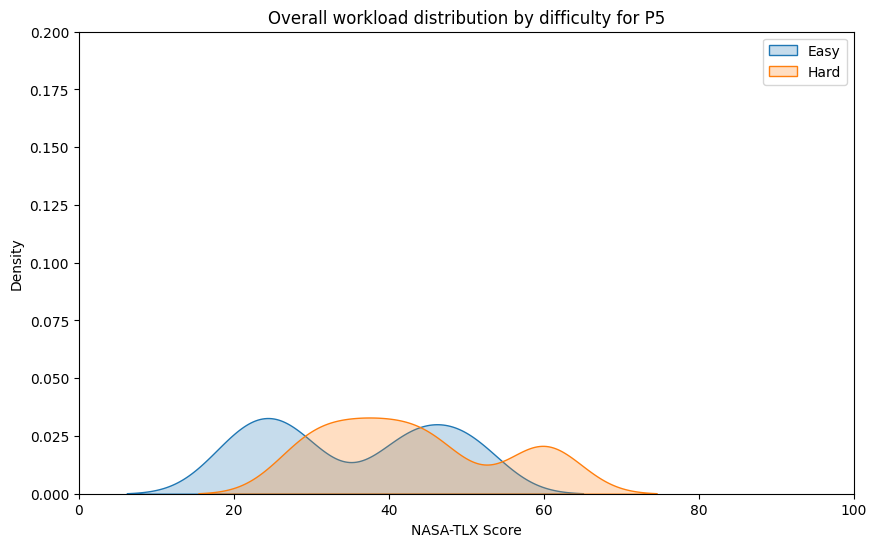

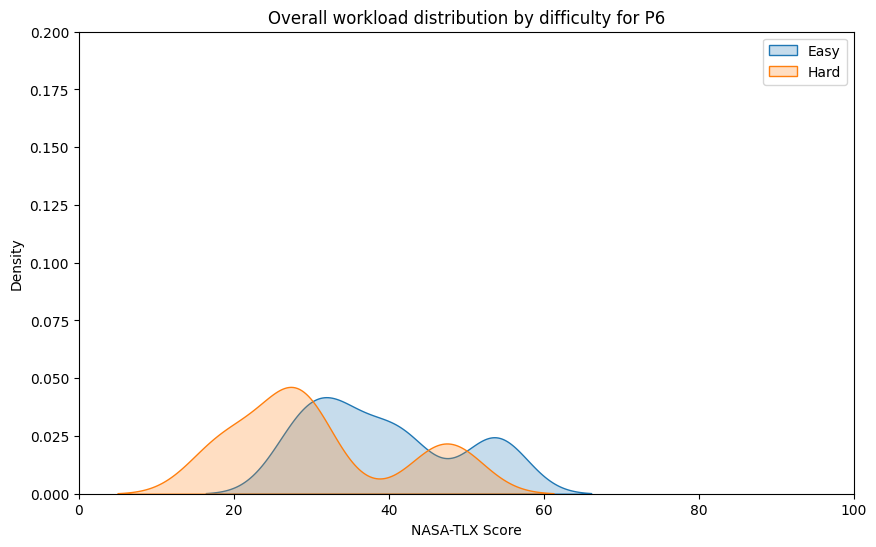

...

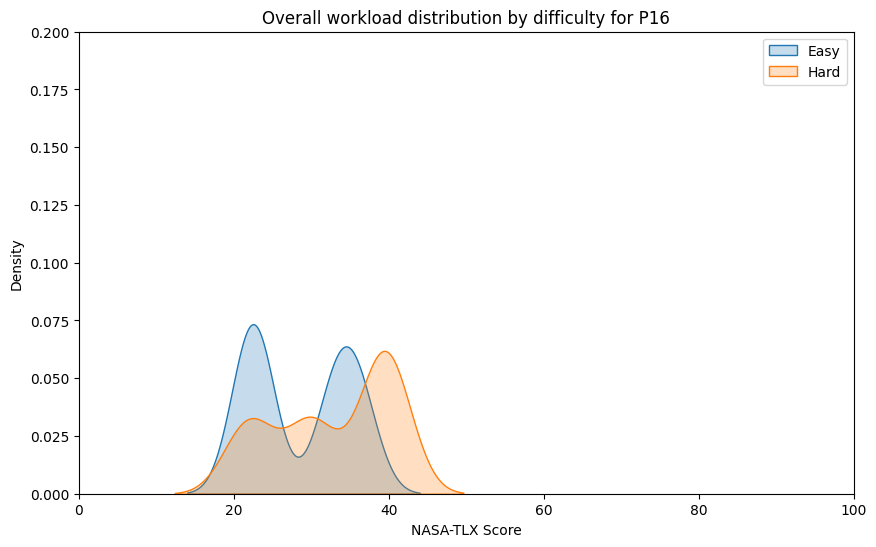

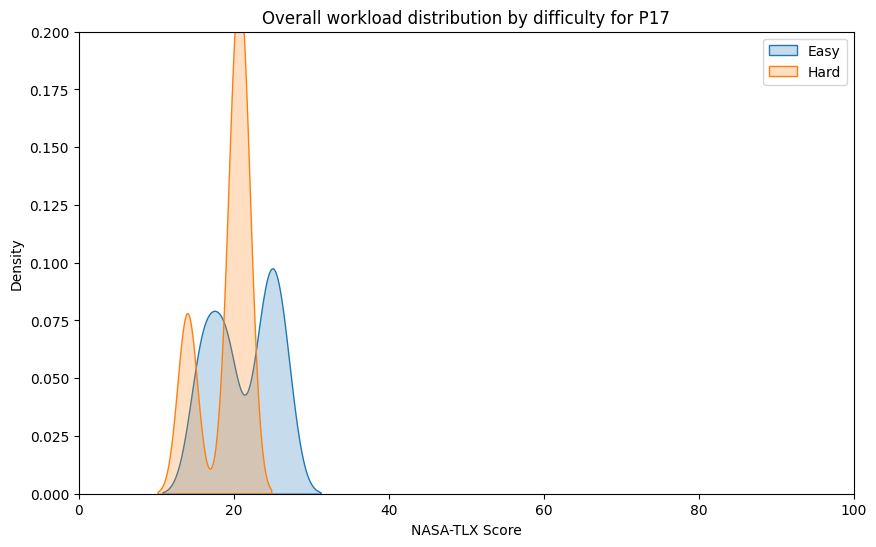

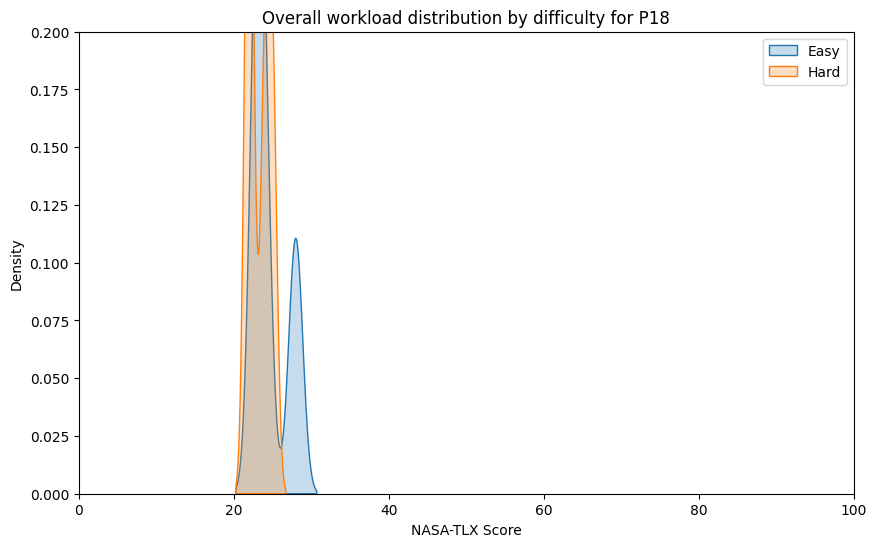

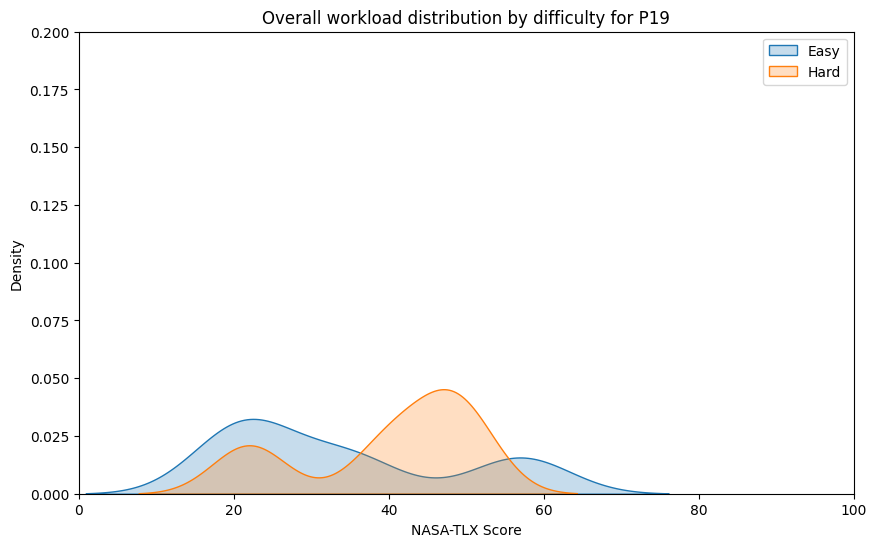

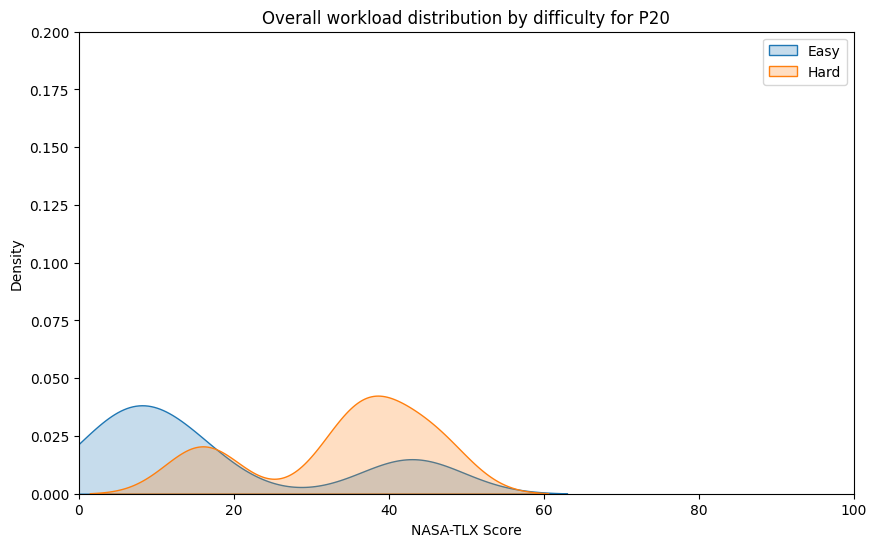

In [50]:
# Difficulty
for pid in participant_ids:
    p_df_easy = df_easy.query(f"participant_id == {pid}")
    p_df_hard = df_hard.query(f"participant_id == {pid}")

    plt.figure(figsize=(10, 6))
    sns.kdeplot(p_df_easy['NASA_TLX_Score'], fill=True, label='Easy', bw_adjust=0.5)
    sns.kdeplot(p_df_hard['NASA_TLX_Score'], fill=True, label='Hard', bw_adjust=0.5)
    plt.title(f'Overall workload distribution by difficulty for P{pid}')
    plt.xlabel('NASA-TLX Score')
    plt.ylabel('Density')
    plt.xlim(0, 100)
    plt.ylim(0, 0.2)
    plt.legend()
    plt.show()

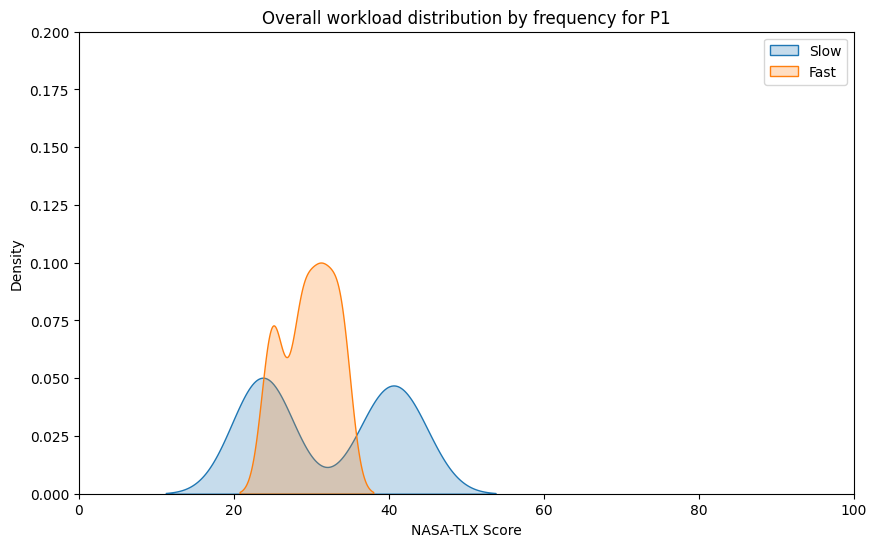

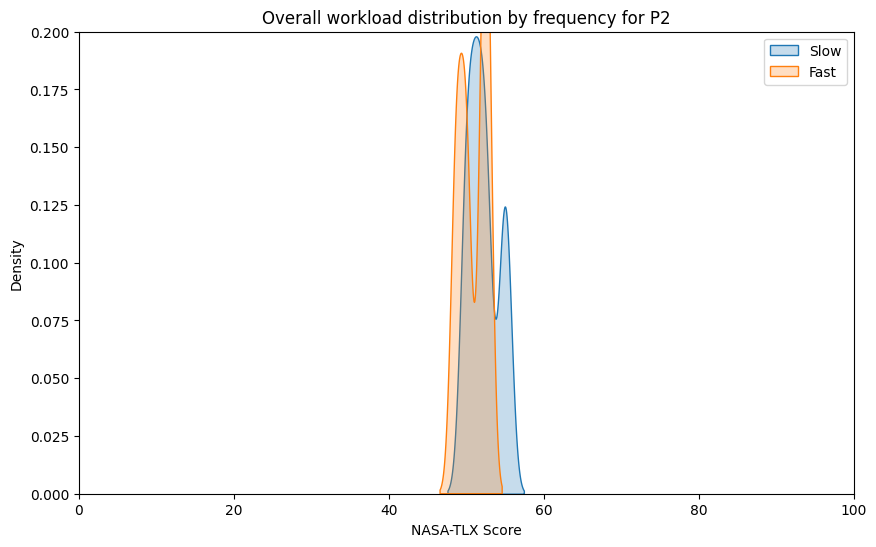

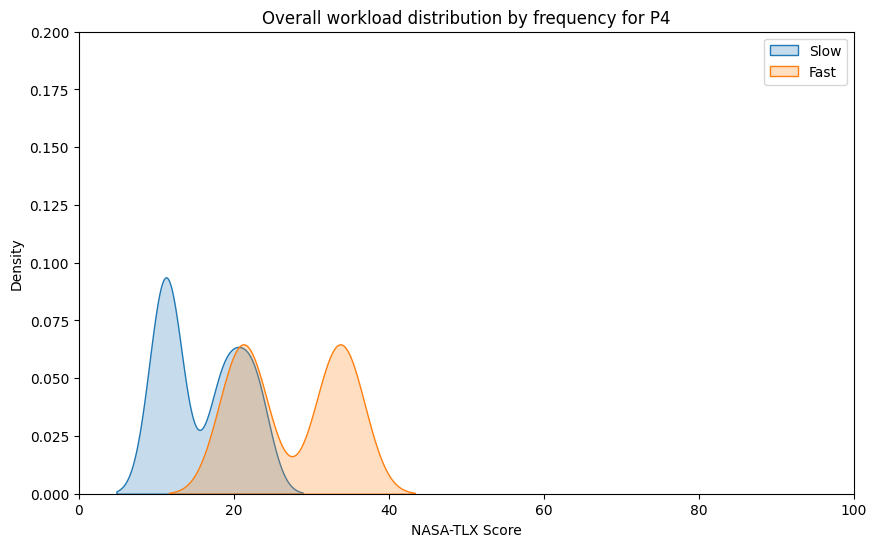

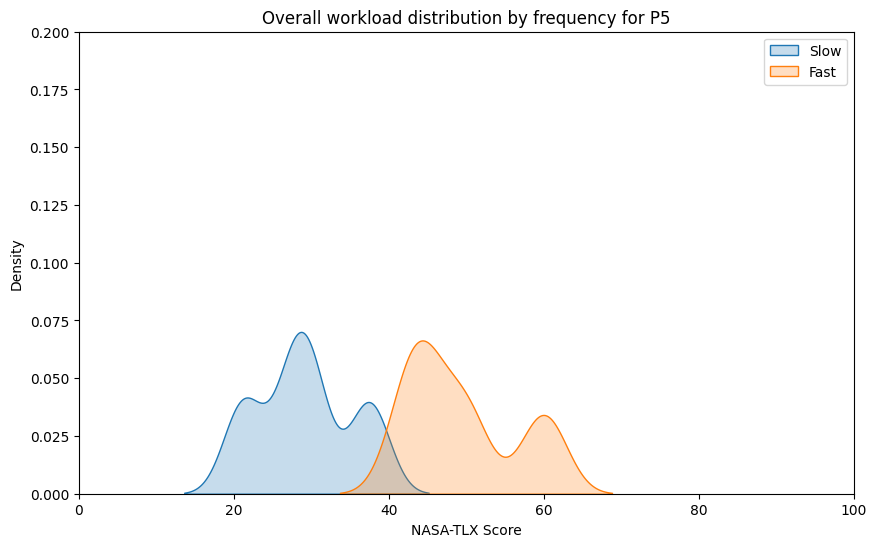

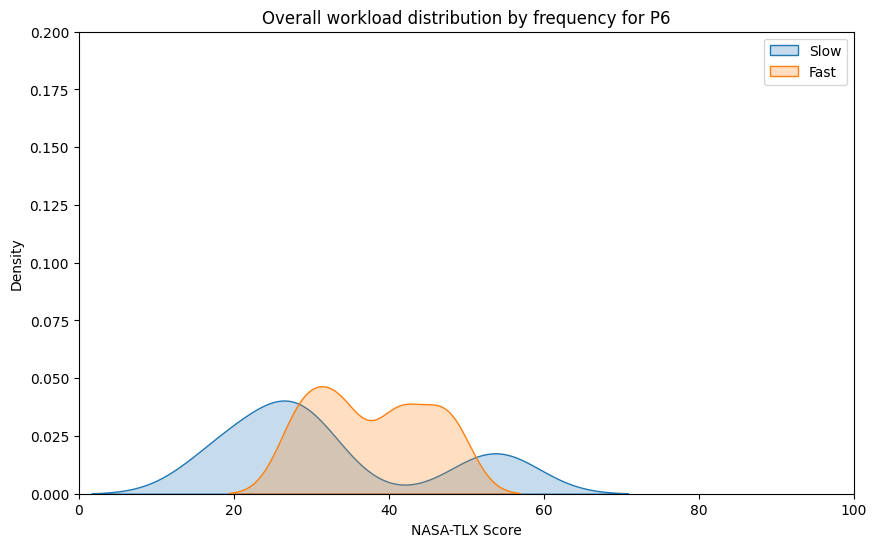

C:\Users\vale_ad\AppData\Local\Temp\ipykernel_11552\2122146074.py:8: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(p_df_fast['NASA_TLX_Score'], fill=True, label='Fast', bw_adjust=0.5)


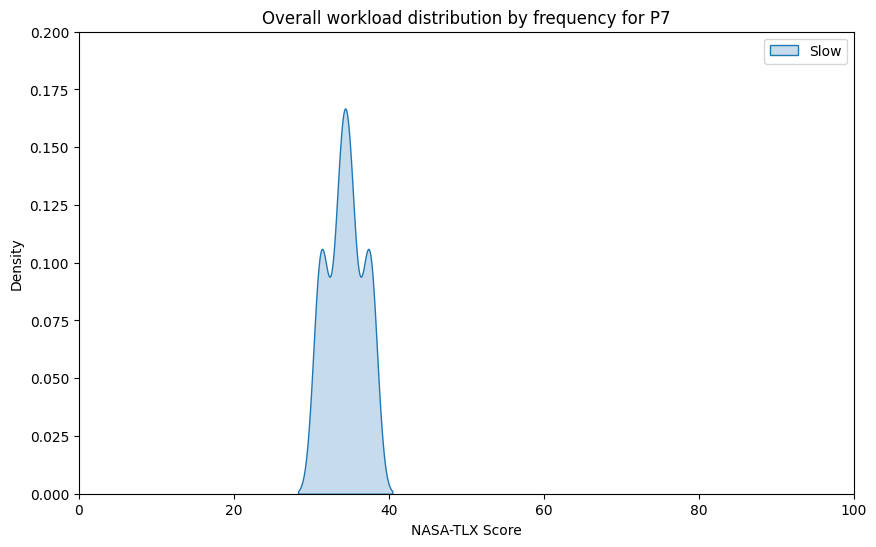

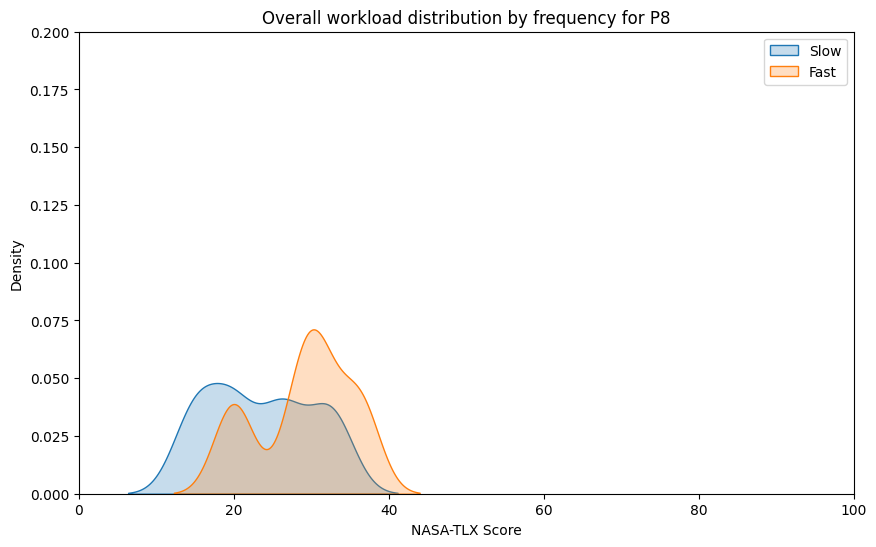

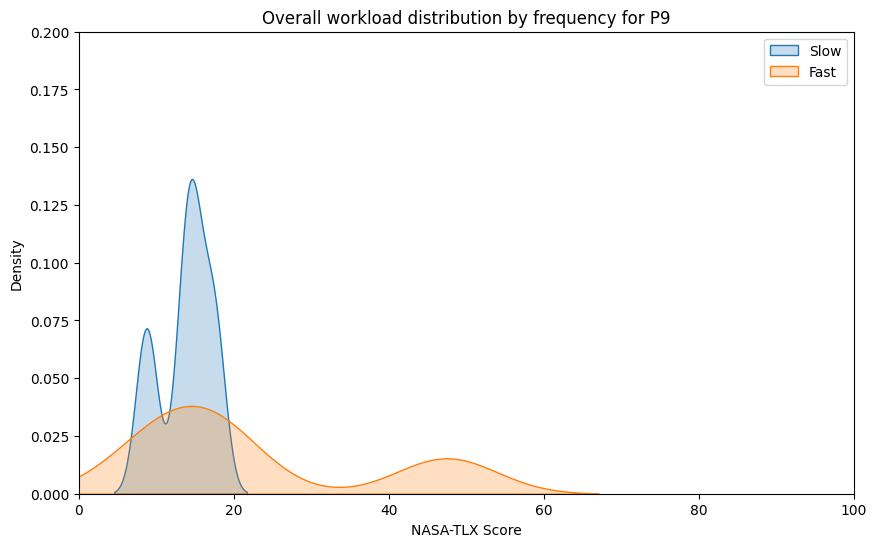

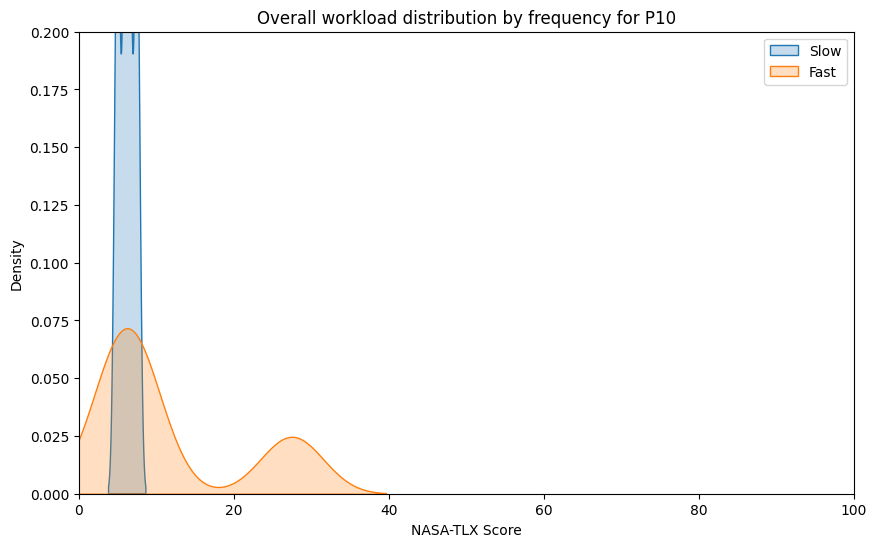

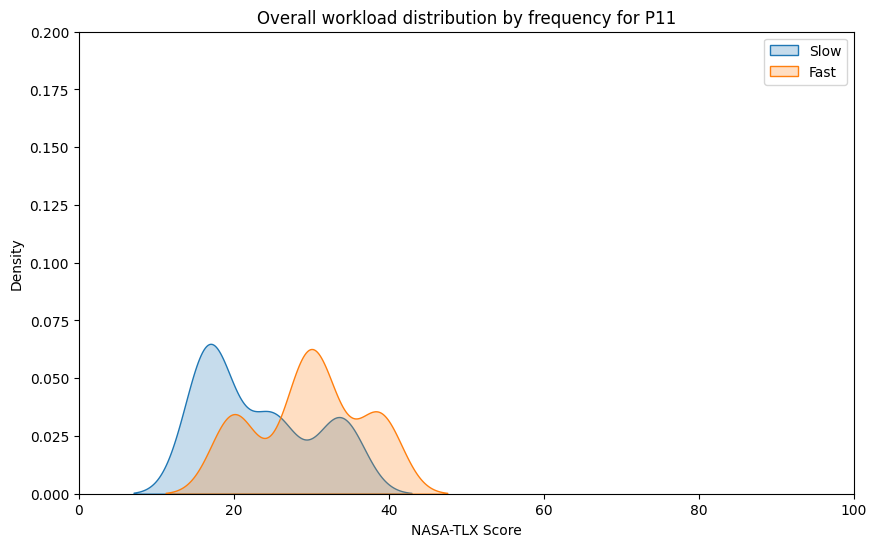

...

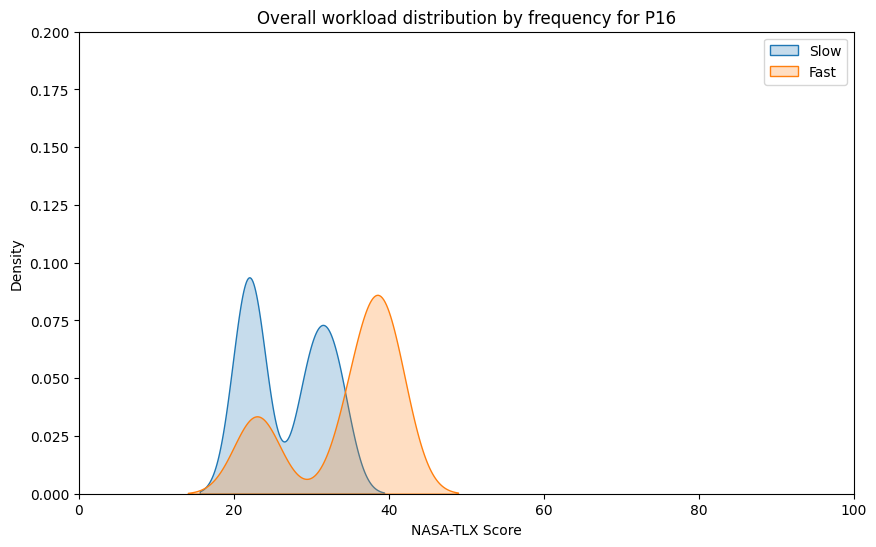

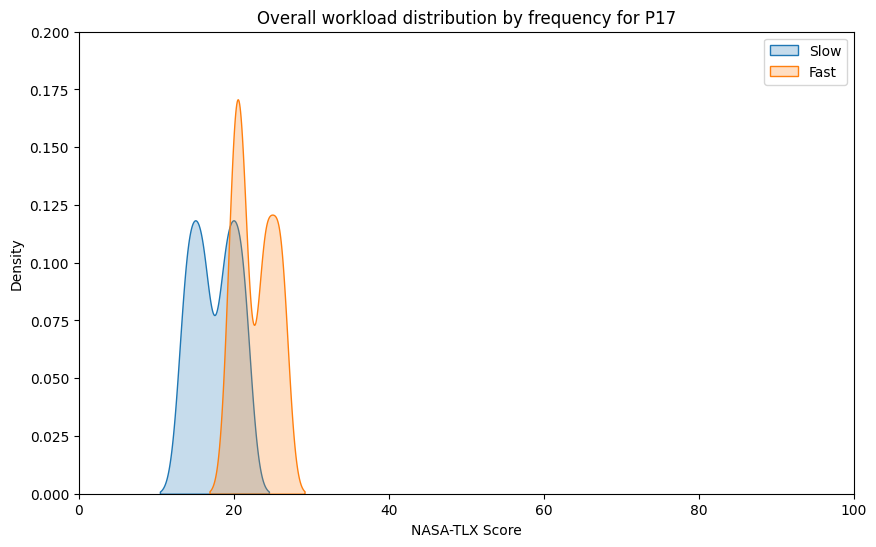

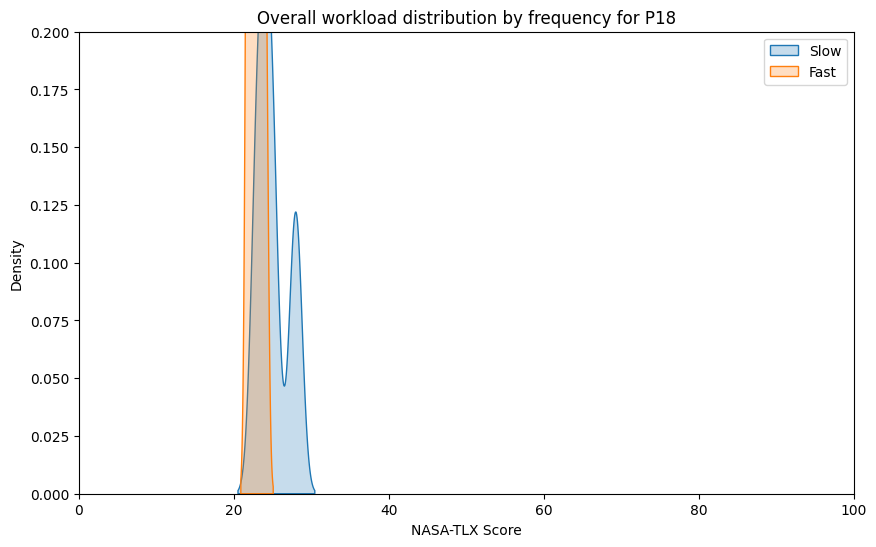

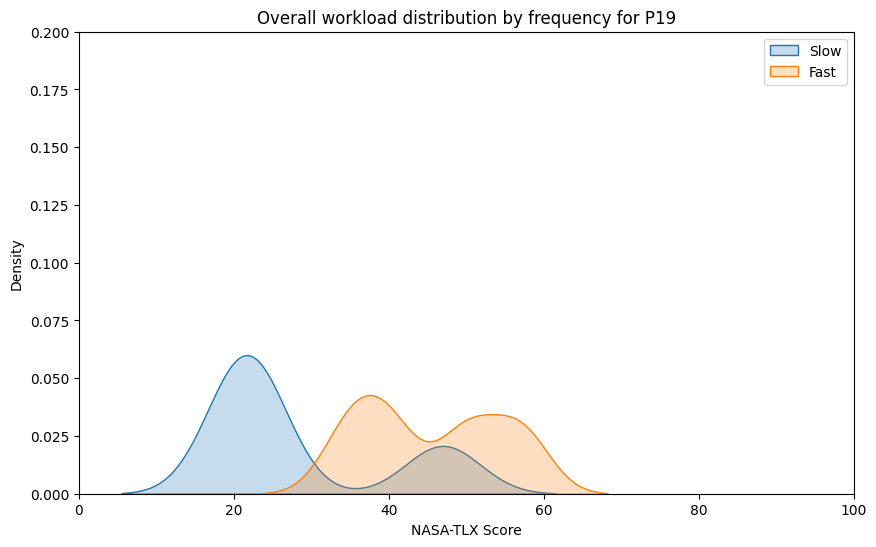

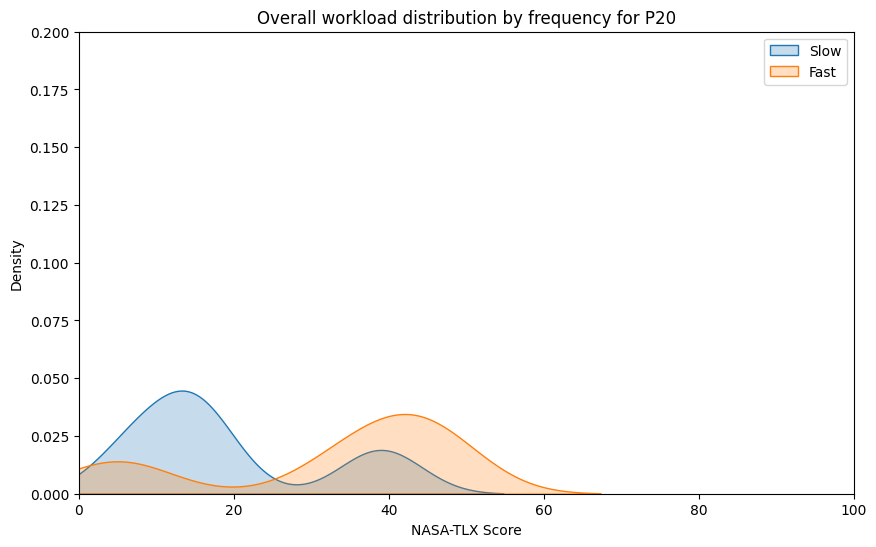

In [51]:
# Frequency
for pid in participant_ids:
    p_df_slow = df_slow.query(f"participant_id == {pid}")
    p_df_fast = df_fast.query(f"participant_id == {pid}")
    
    plt.figure(figsize=(10, 6))
    sns.kdeplot(p_df_slow['NASA_TLX_Score'], fill=True, label='Slow', bw_adjust=0.5)
    sns.kdeplot(p_df_fast['NASA_TLX_Score'], fill=True, label='Fast', bw_adjust=0.5)
    plt.title(f'Overall workload distribution by frequency for P{pid}')
    plt.xlabel('NASA-TLX Score')
    plt.ylabel('Density')
    plt.xlim(0, 100)
    plt.ylim(0, 0.2)
    plt.legend()
    plt.show()

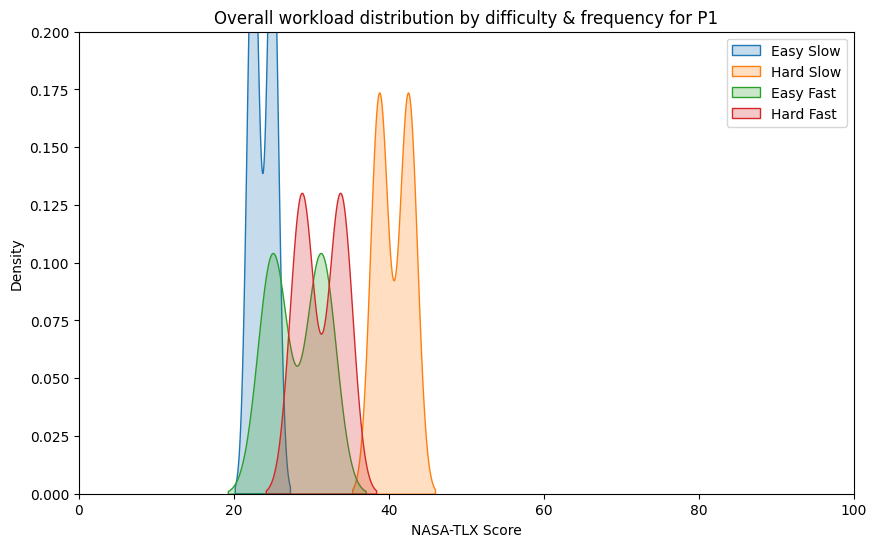

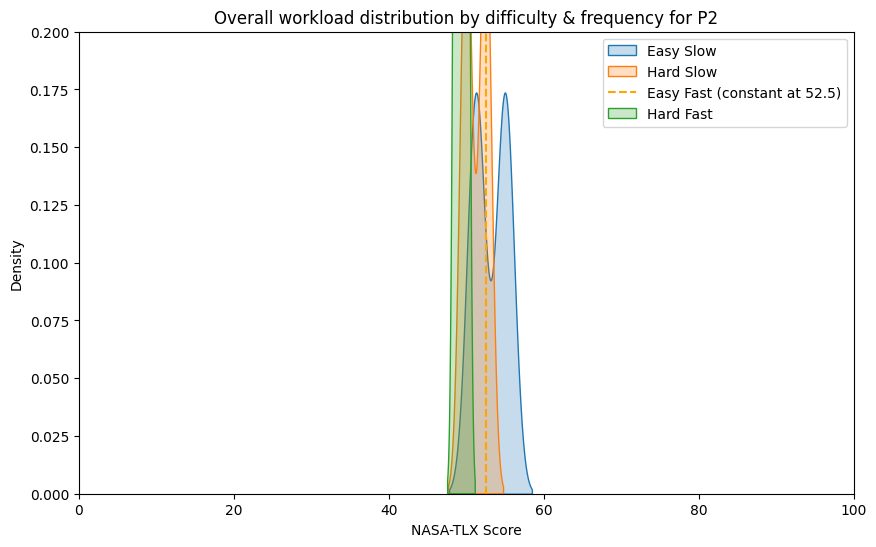

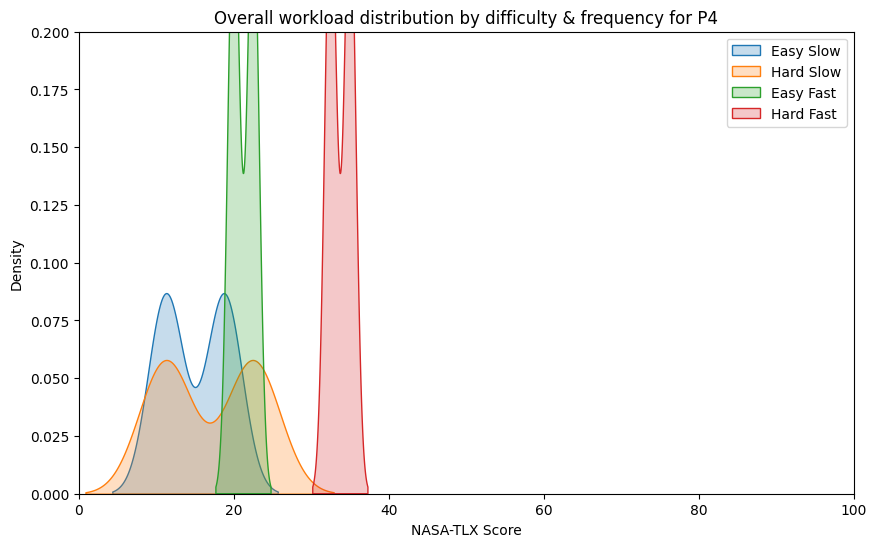

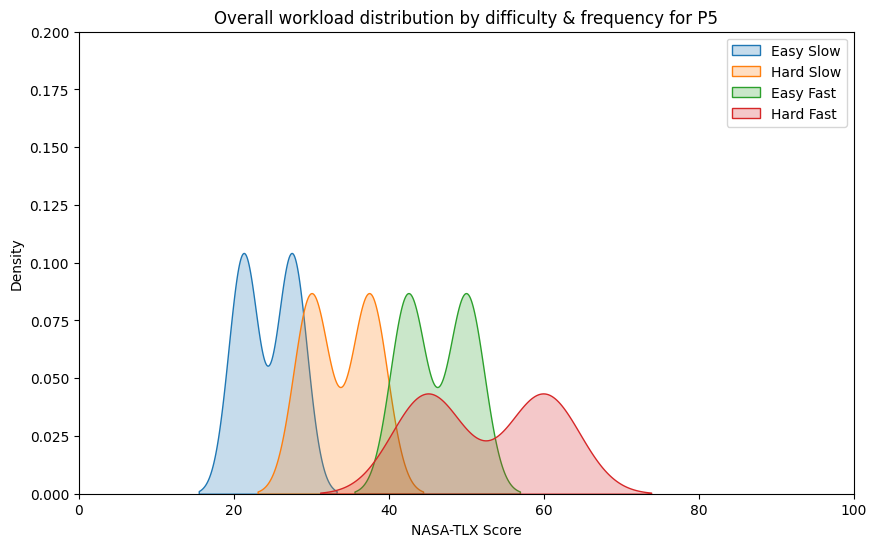

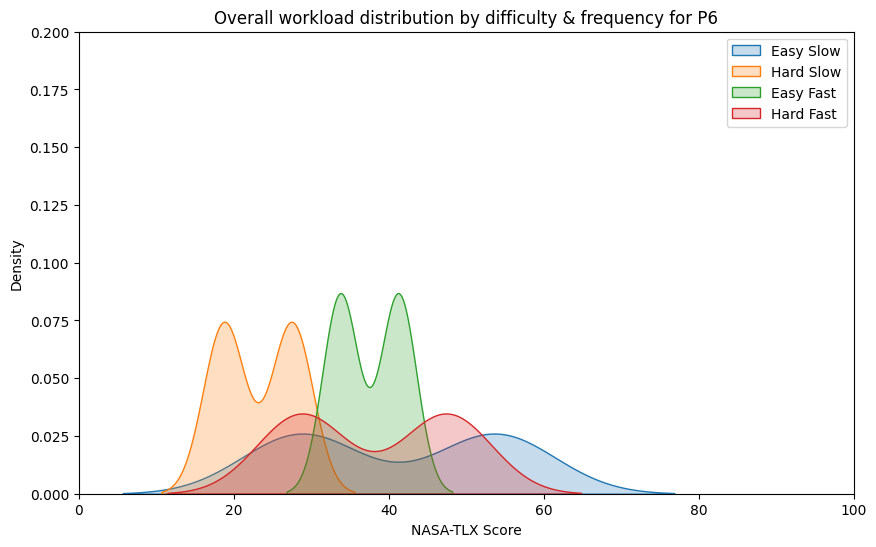

...

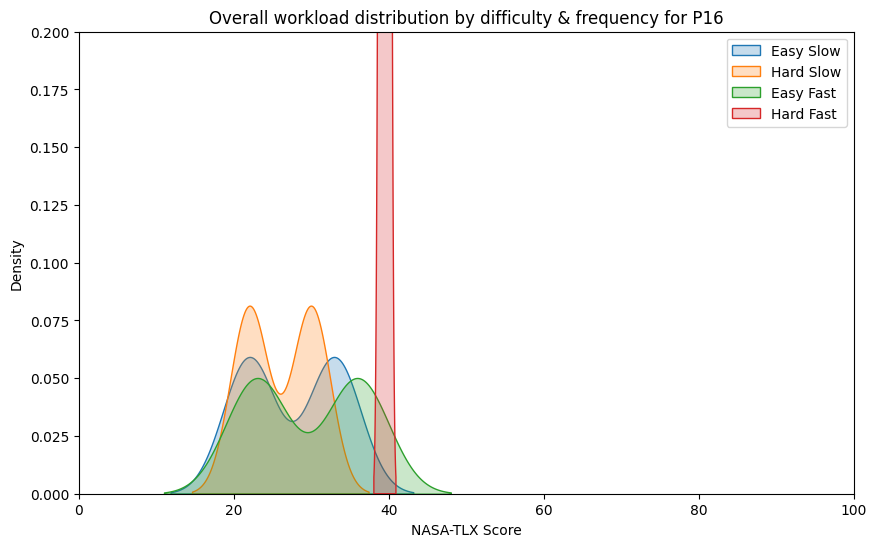

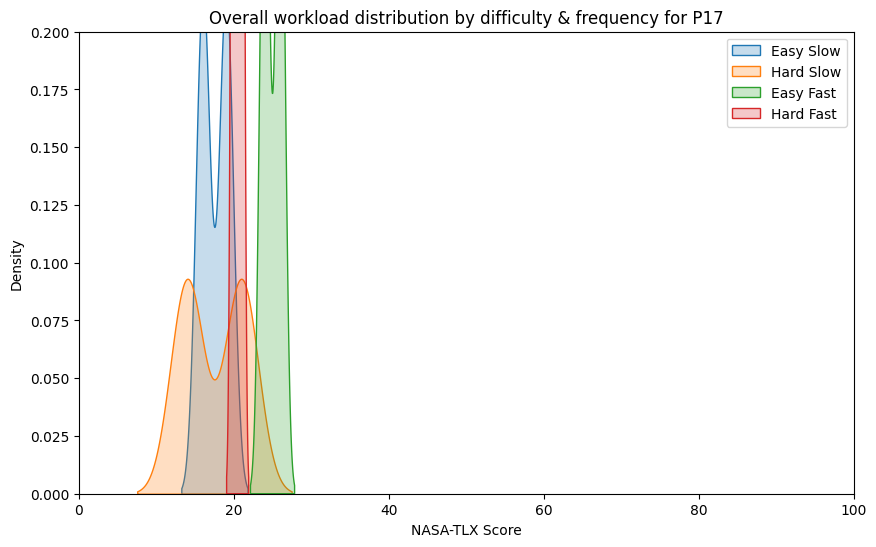

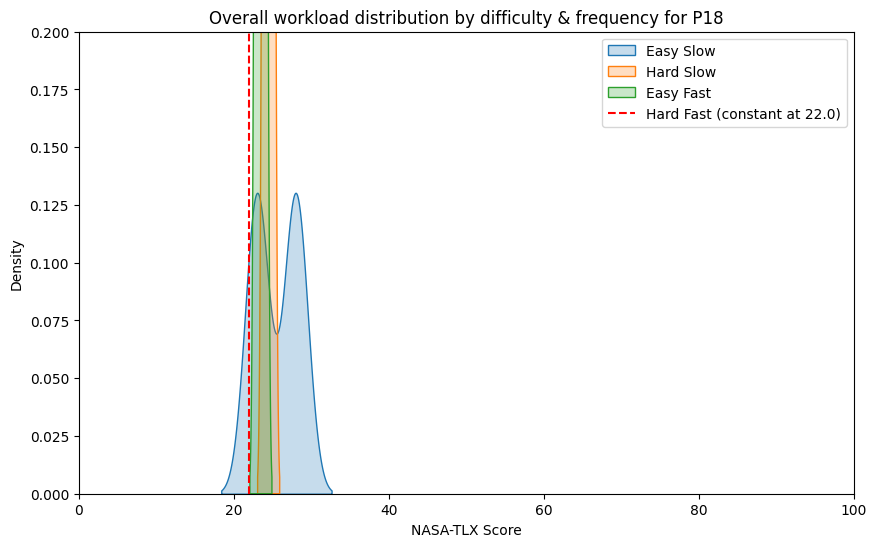

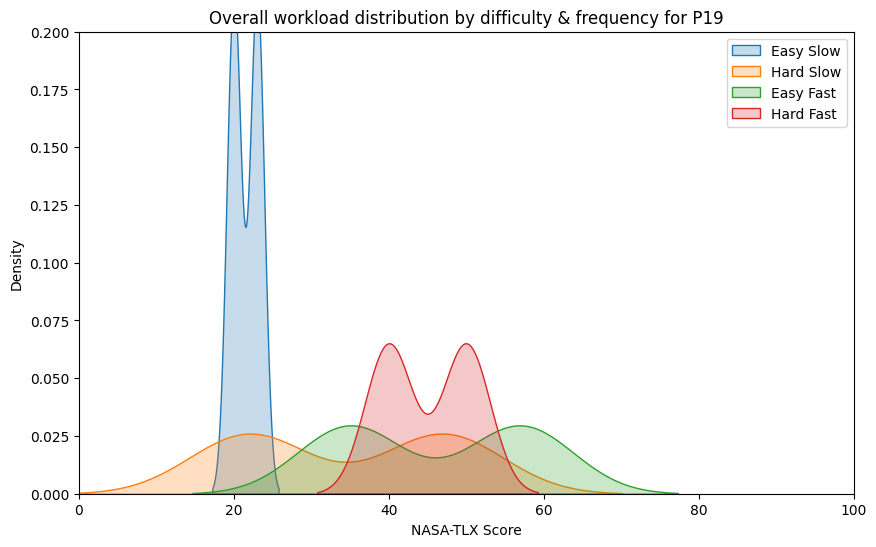

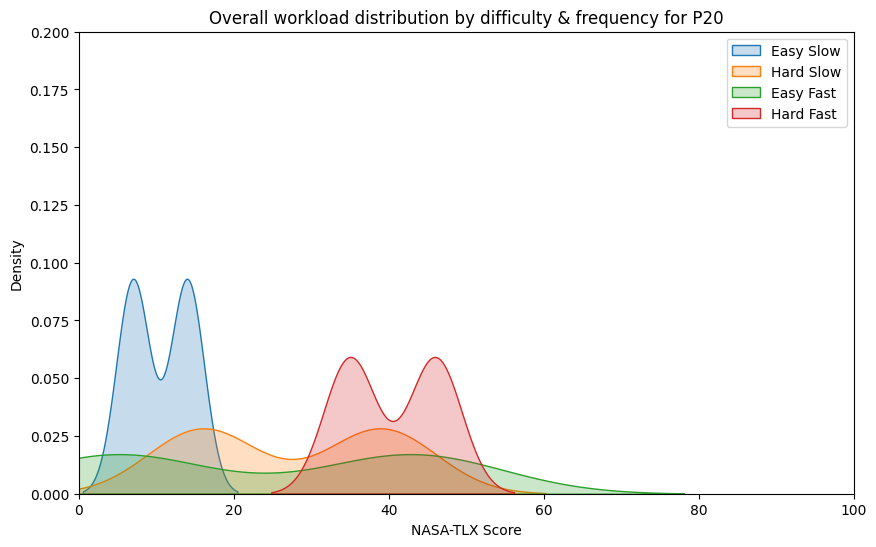

In [52]:
# Difficulty+frequency
for pid in participant_ids:
    p_df_easy_slow = df_easy_slow.query(f"participant_id == {pid}")
    p_df_hard_slow = df_hard_slow.query(f"participant_id == {pid}")
    p_df_easy_fast = df_easy_fast.query(f"participant_id == {pid}")
    p_df_hard_fast = df_hard_fast.query(f"participant_id == {pid}")

    plt.figure(figsize=(10, 6))

    # Easy Slow
    if p_df_easy_slow['NASA_TLX_Score'].var() == 0:
        unique_value_easy_slow = p_df_easy_slow['NASA_TLX_Score'].iloc[0]
        plt.axvline(unique_value_easy_slow, color='blue', linestyle='--', label=f'Easy Slow (constant at {unique_value_easy_slow})')
    else:
        sns.kdeplot(p_df_easy_slow['NASA_TLX_Score'], fill=True, label='Easy Slow', bw_adjust=0.5)

    # Hard Slow
    if p_df_hard_slow['NASA_TLX_Score'].var() == 0:
        unique_value_hard_slow = p_df_hard_slow['NASA_TLX_Score'].iloc[0]
        plt.axvline(unique_value_hard_slow, color='green', linestyle='--', label=f'Hard Slow (constant at {unique_value_hard_slow})')
    else:
        sns.kdeplot(p_df_hard_slow['NASA_TLX_Score'], fill=True, label='Hard Slow', bw_adjust=0.5)

    # Easy Fast
    if p_df_easy_fast['NASA_TLX_Score'].var() == 0:
        unique_value_easy_fast = p_df_easy_fast['NASA_TLX_Score'].iloc[0]
        plt.axvline(unique_value_easy_fast, color='orange', linestyle='--', label=f'Easy Fast (constant at {unique_value_easy_fast})')
    else:
        sns.kdeplot(p_df_easy_fast['NASA_TLX_Score'], fill=True, label='Easy Fast', bw_adjust=0.5)

    # Hard Fast
    if p_df_hard_fast['NASA_TLX_Score'].var() == 0:
        unique_value_hard_fast = p_df_hard_fast['NASA_TLX_Score'].iloc[0]
        plt.axvline(unique_value_hard_fast, color='red', linestyle='--', label=f'Hard Fast (constant at {unique_value_hard_fast})')
    else:
        sns.kdeplot(p_df_hard_fast['NASA_TLX_Score'], fill=True, label='Hard Fast', bw_adjust=0.5)

    plt.title(f'Overall workload distribution by difficulty & frequency for P{pid}')
    plt.xlabel('NASA-TLX Score')
    plt.ylabel('Density')
    plt.xlim(0, 100)
    plt.ylim(0, 0.2)
    plt.legend()
    plt.show()


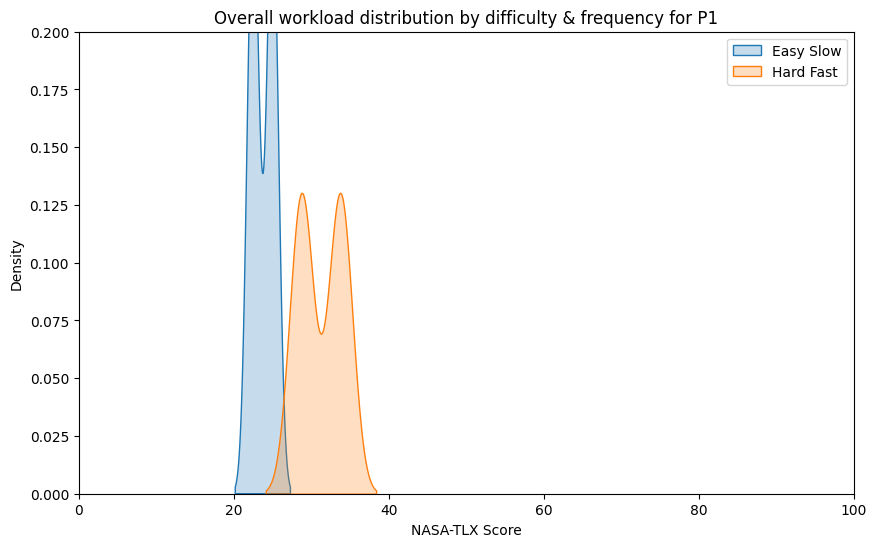

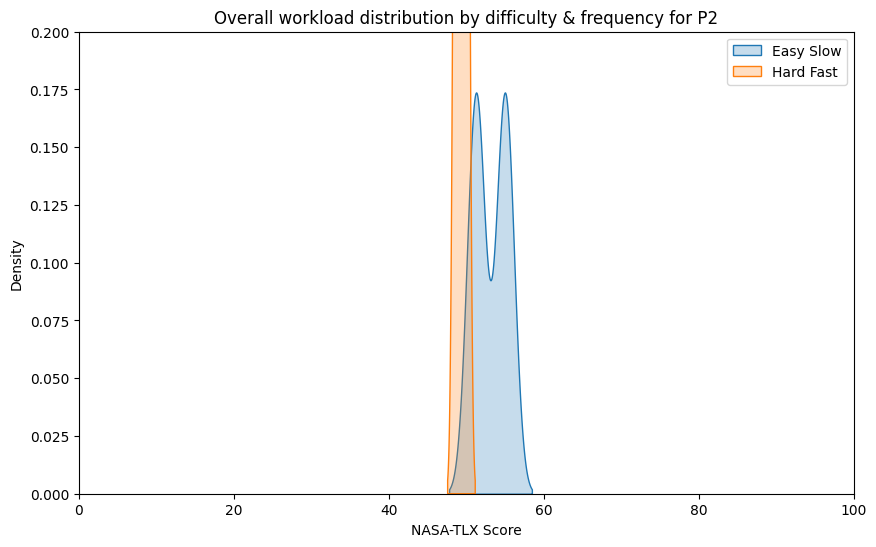

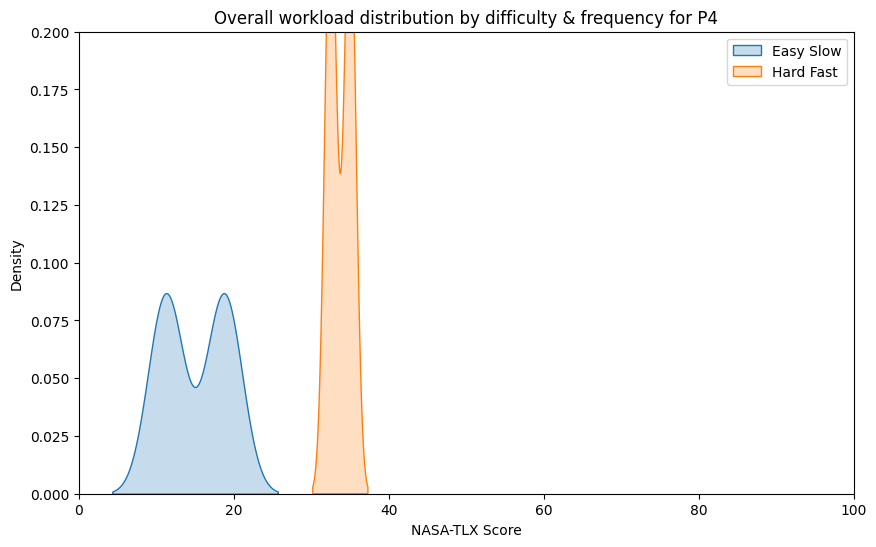

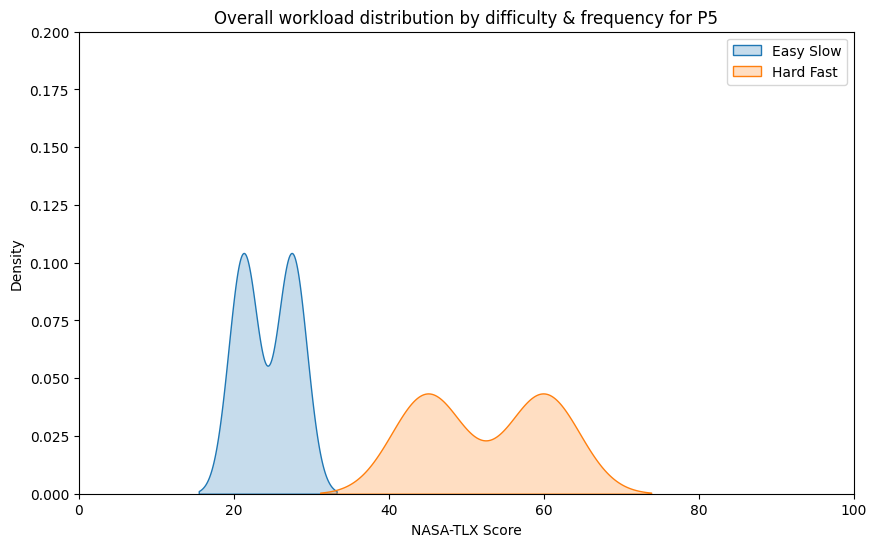

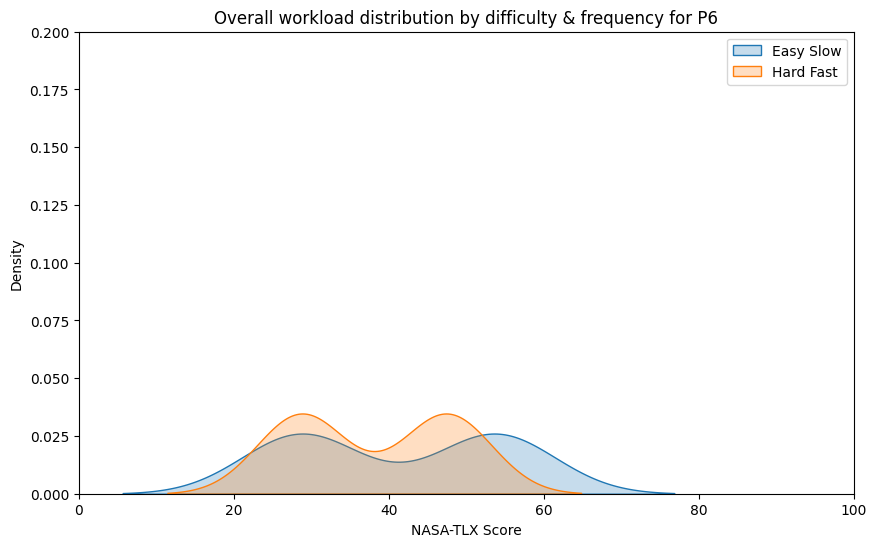

...

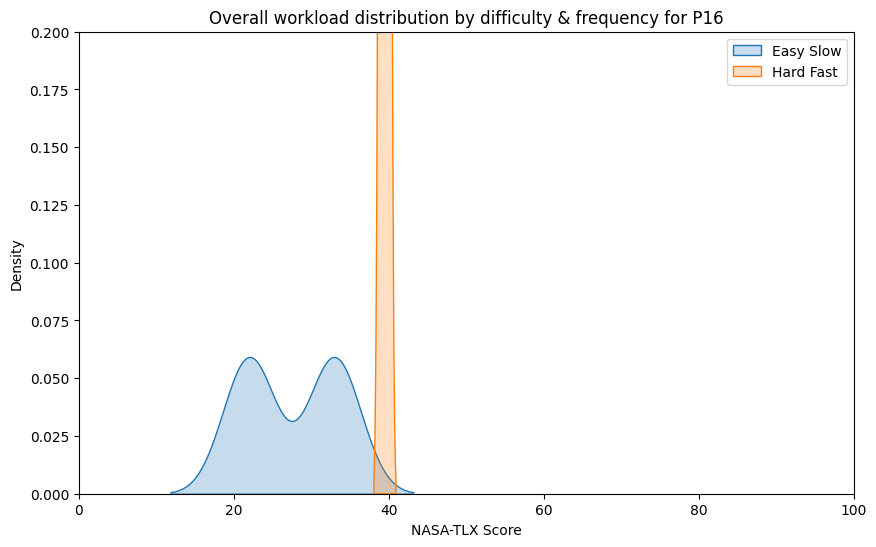

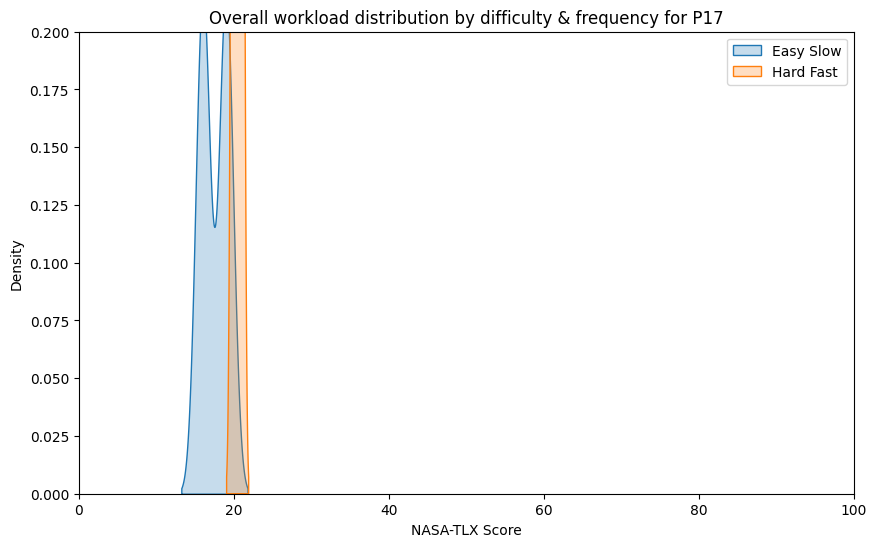

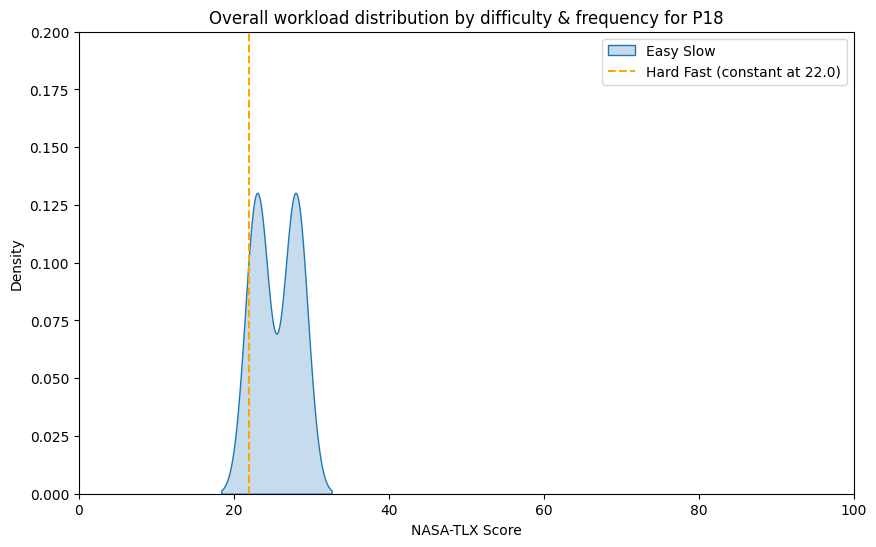

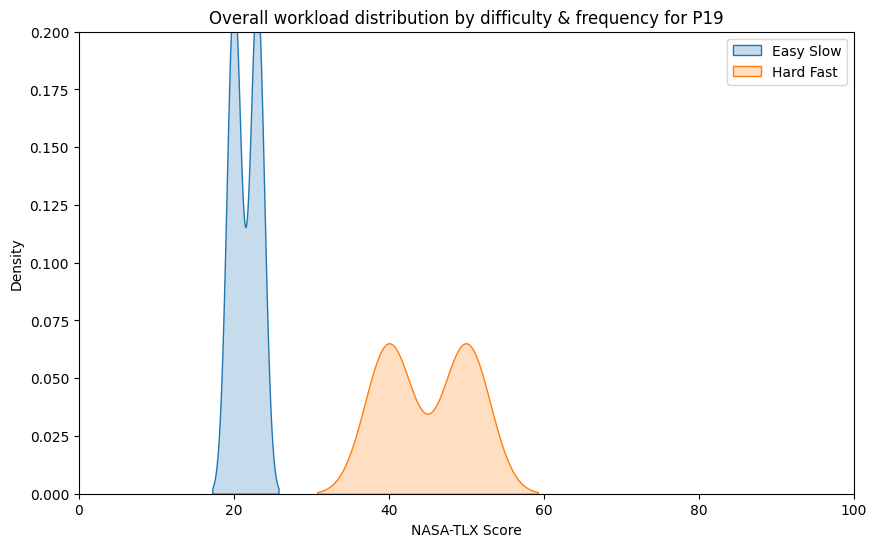

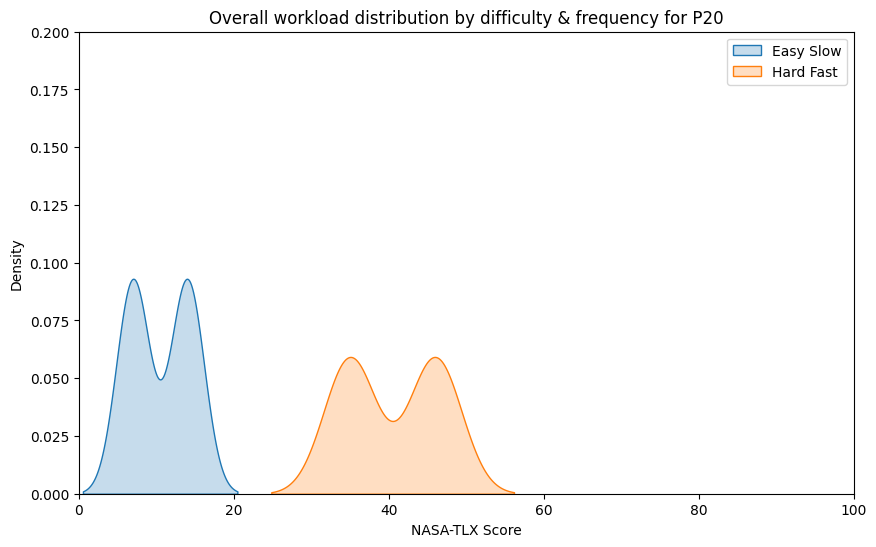

In [53]:
# Extreme conditions
for pid in participant_ids:
    p_df_easy_slow = df_easy_slow.query(f"participant_id == {pid}")
    p_df_hard_fast = df_hard_fast.query(f"participant_id == {pid}")

    plt.figure(figsize=(10, 6))

    # Check variance for Easy Slow condition
    if p_df_easy_slow['NASA_TLX_Score'].var() == 0:
        unique_value_easy_slow = p_df_easy_slow['NASA_TLX_Score'].iloc[0]
        plt.axvline(unique_value_easy_slow, color='blue', linestyle='--', label=f'Easy Slow (constant at {unique_value_easy_slow})')
    else:
        sns.kdeplot(p_df_easy_slow['NASA_TLX_Score'], fill=True, label='Easy Slow', bw_adjust=0.5)
    
    # Check variance for Hard Fast condition
    if p_df_hard_fast['NASA_TLX_Score'].var() == 0:
        unique_value_hard_fast = p_df_hard_fast['NASA_TLX_Score'].iloc[0]
        plt.axvline(unique_value_hard_fast, color='orange', linestyle='--', label=f'Hard Fast (constant at {unique_value_hard_fast})')
    else:
        sns.kdeplot(p_df_hard_fast['NASA_TLX_Score'], fill=True, label='Hard Fast', bw_adjust=0.5)

    plt.title(f'Overall workload distribution by difficulty & frequency for P{pid}')
    plt.xlabel('NASA-TLX Score')
    plt.ylabel('Density')
    plt.xlim(0, 100)
    plt.ylim(0, .2)
    plt.legend()
    plt.show()

##### Distribution comparison (per participant) (normalized)
- (...)

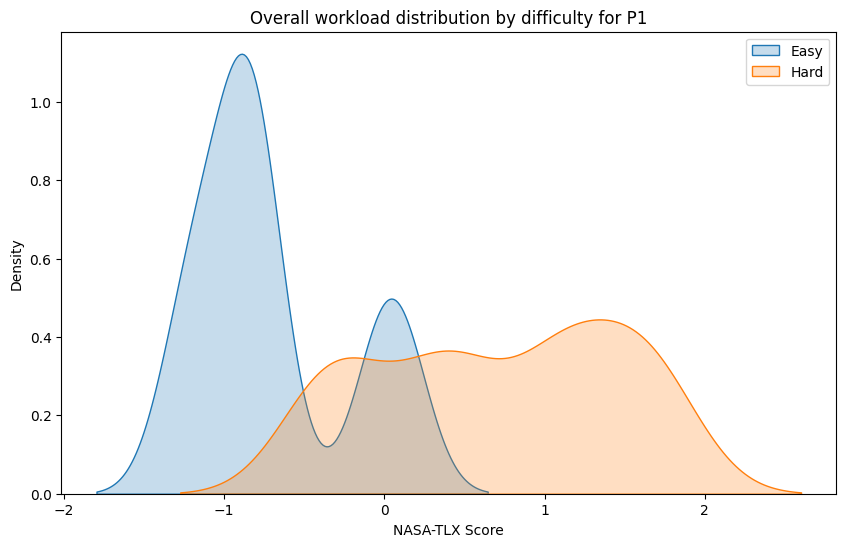

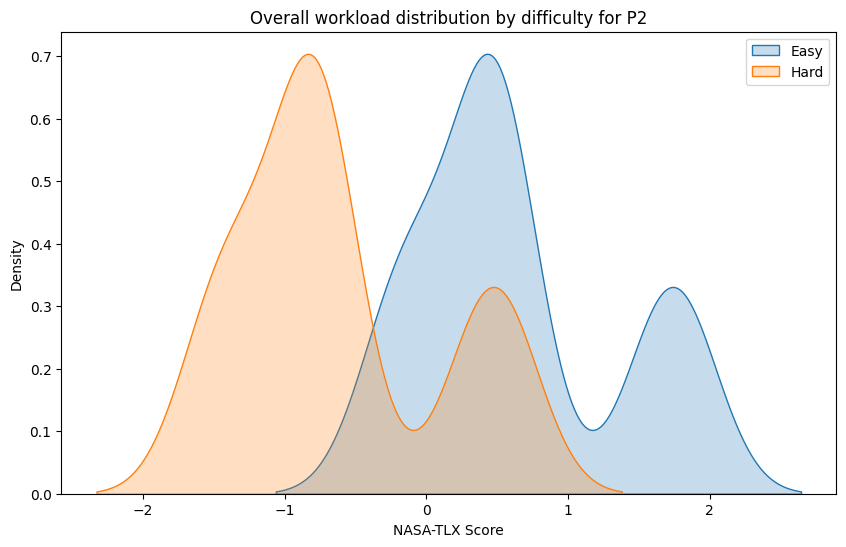

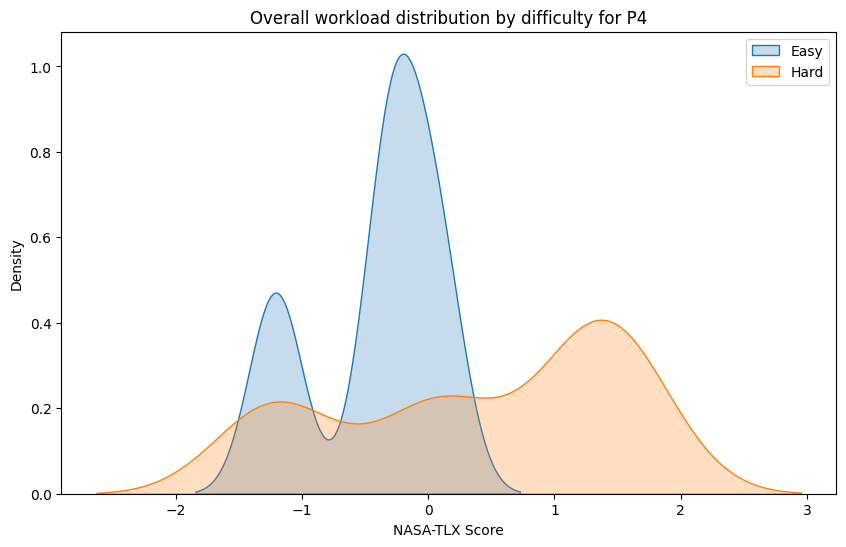

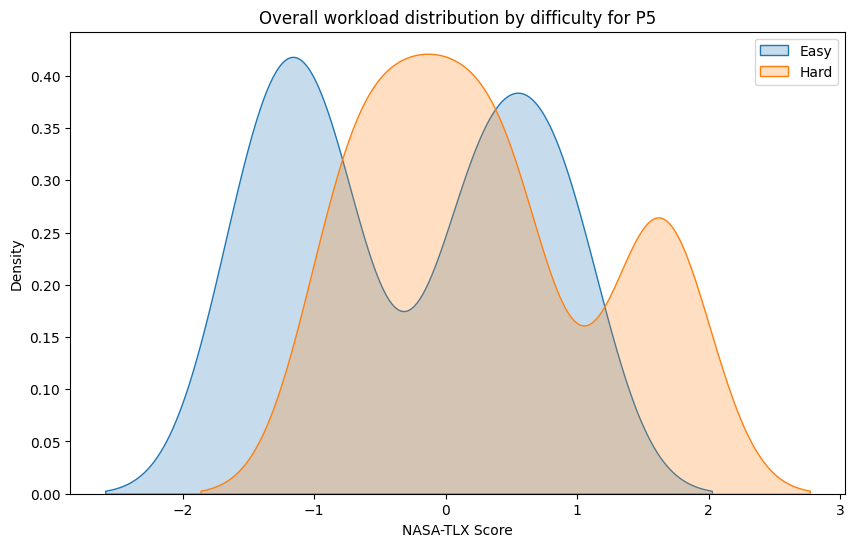

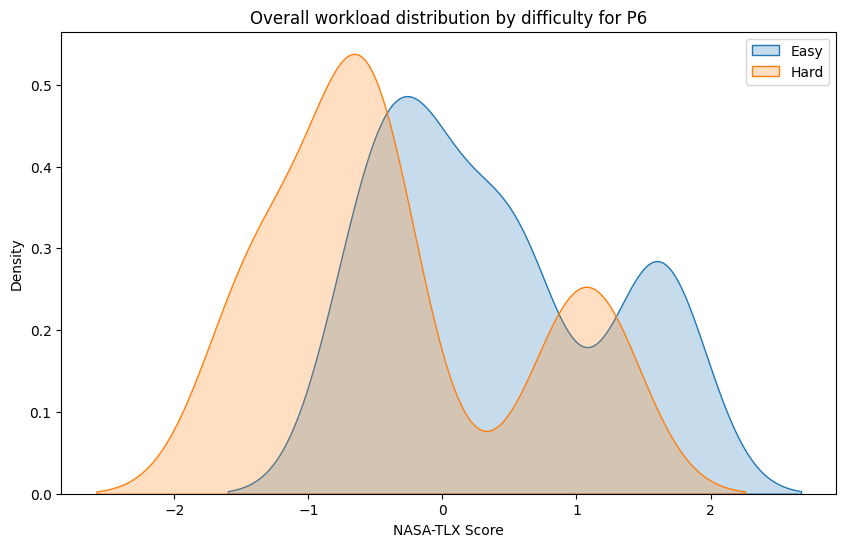

...

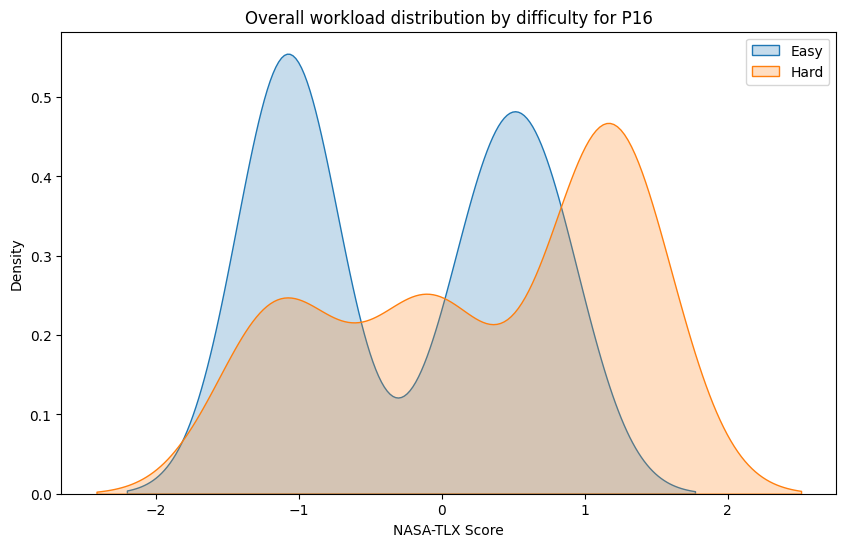

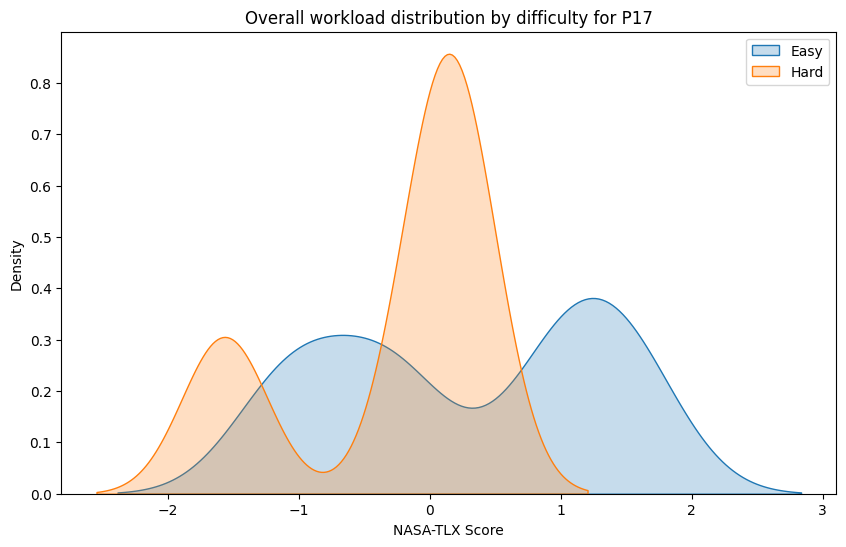

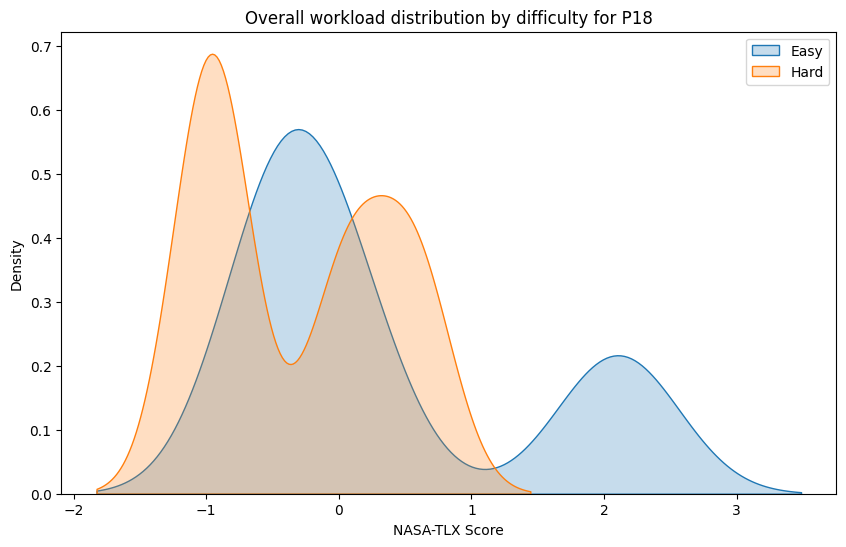

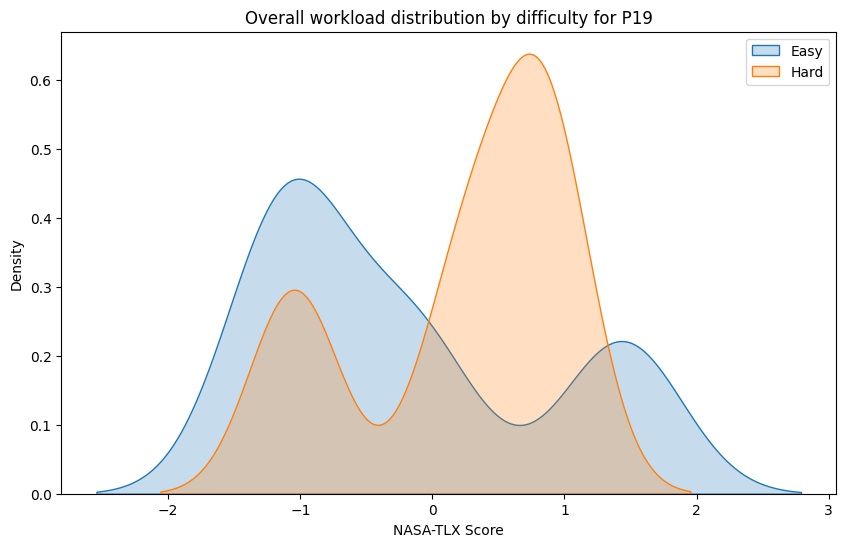

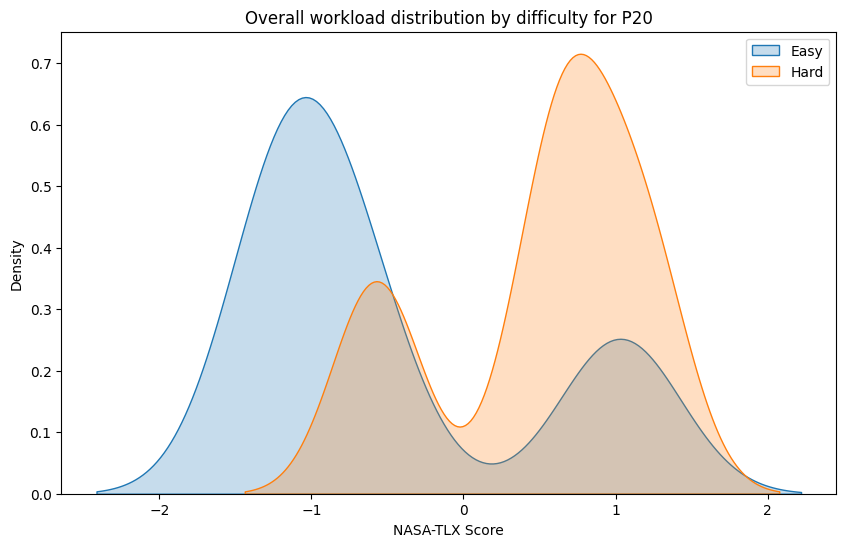

In [54]:
# Difficulty
for pid in participant_ids:
    p_df_easy = df_easy.query(f"participant_id == {pid}")
    p_df_hard = df_hard.query(f"participant_id == {pid}")

    plt.figure(figsize=(10, 6))
    sns.kdeplot(p_df_easy['NASA_TLX_norm_Score'], fill=True, label='Easy', bw_adjust=0.5)
    sns.kdeplot(p_df_hard['NASA_TLX_norm_Score'], fill=True, label='Hard', bw_adjust=0.5)
    plt.title(f'Overall workload distribution by difficulty for P{pid}')
    plt.xlabel('NASA-TLX Score')
    plt.ylabel('Density')
    plt.legend()
    plt.show()

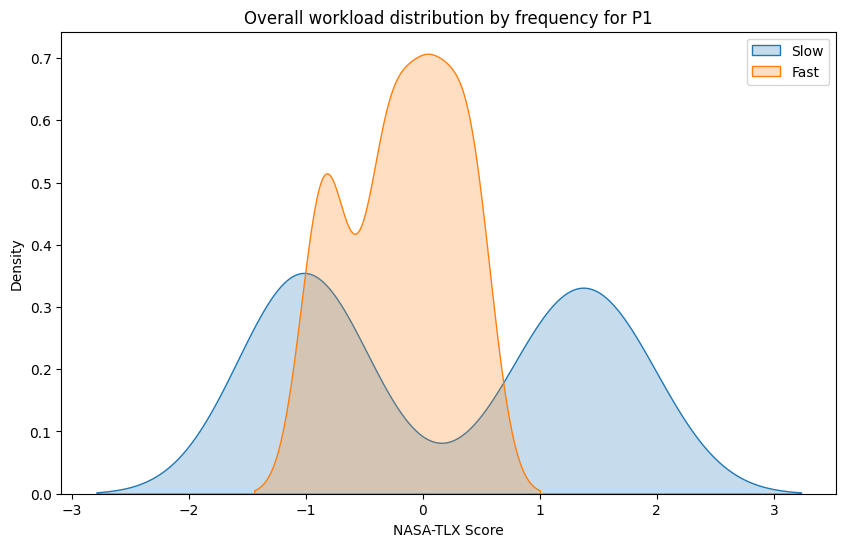

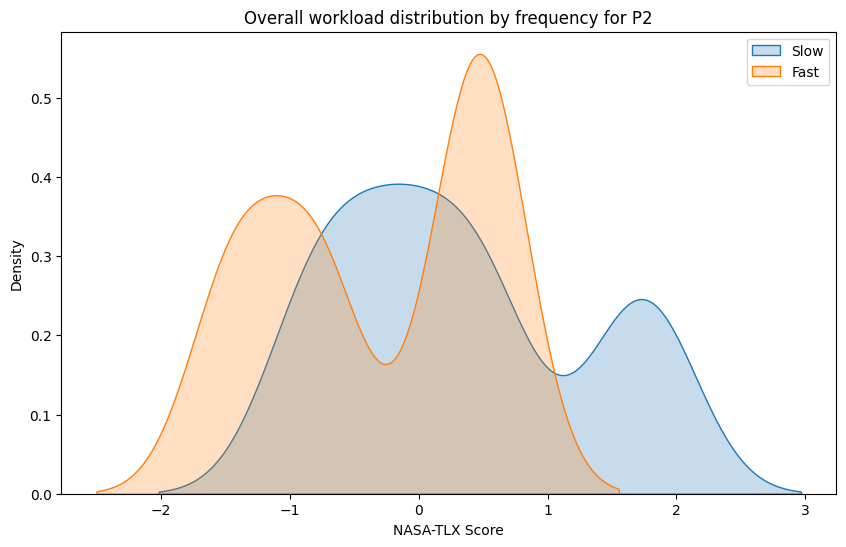

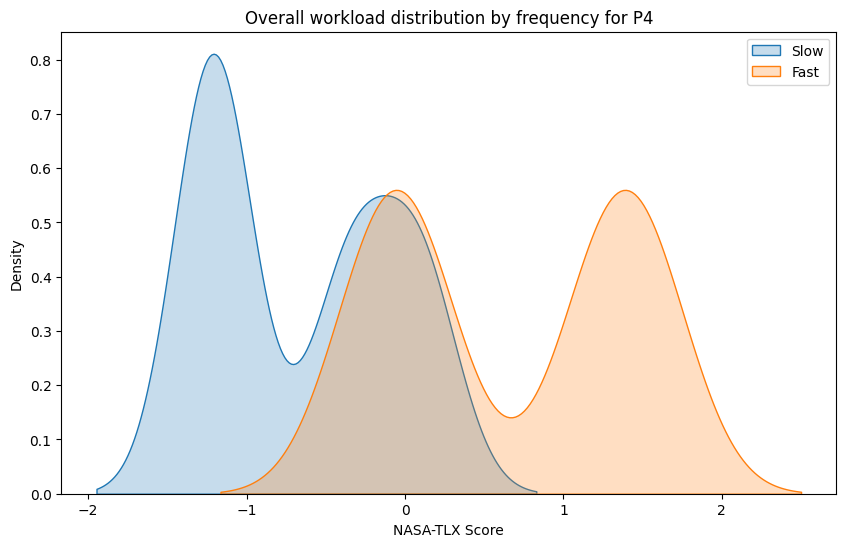

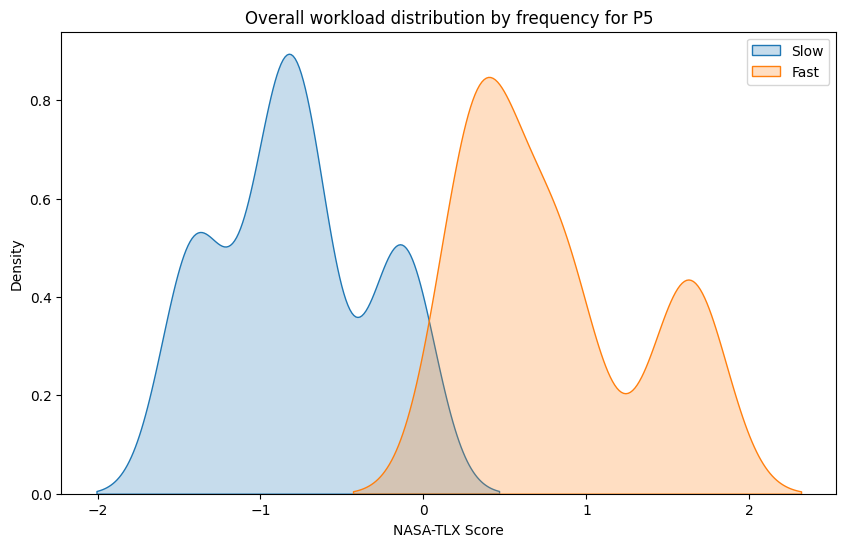

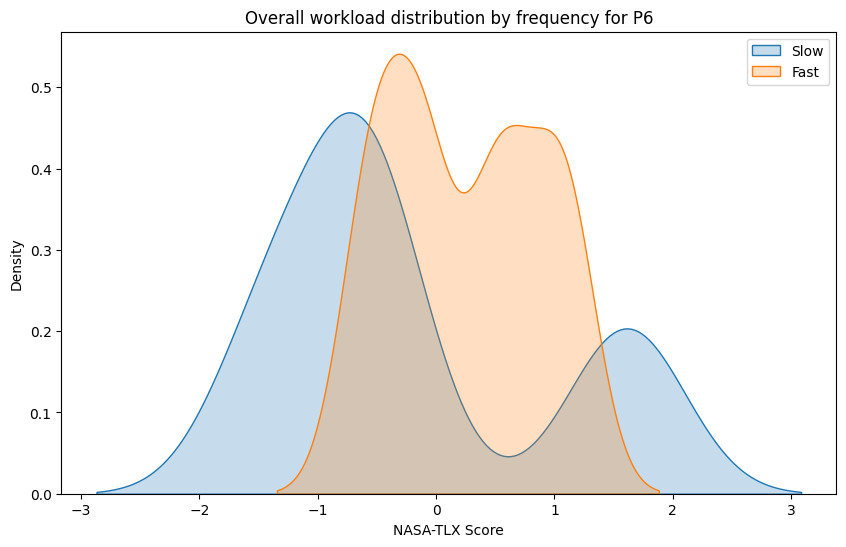

C:\Users\vale_ad\AppData\Local\Temp\ipykernel_11552\2042362312.py:8: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(p_df_fast['NASA_TLX_norm_Score'], fill=True, label='Fast', bw_adjust=0.5)


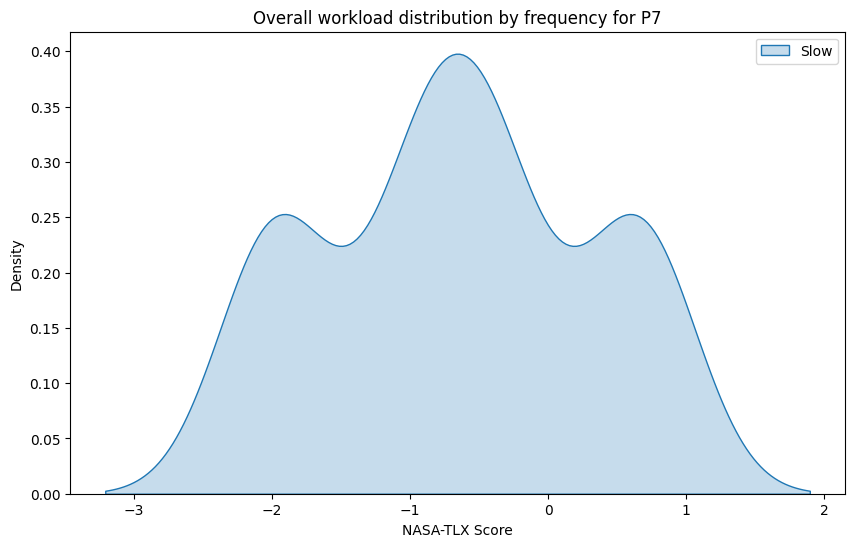

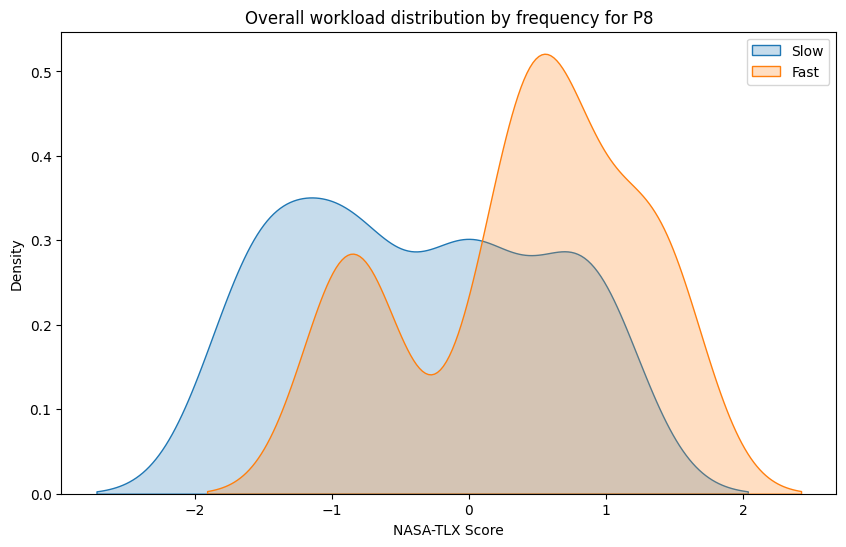

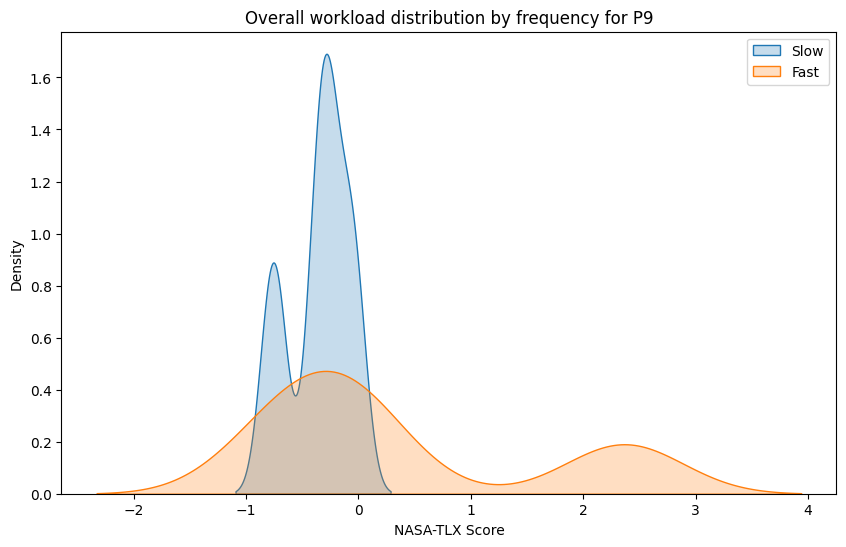

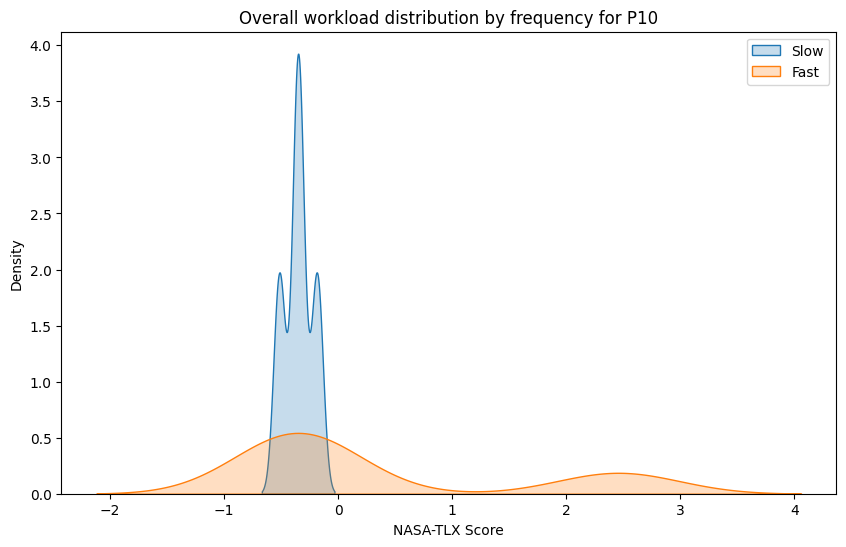

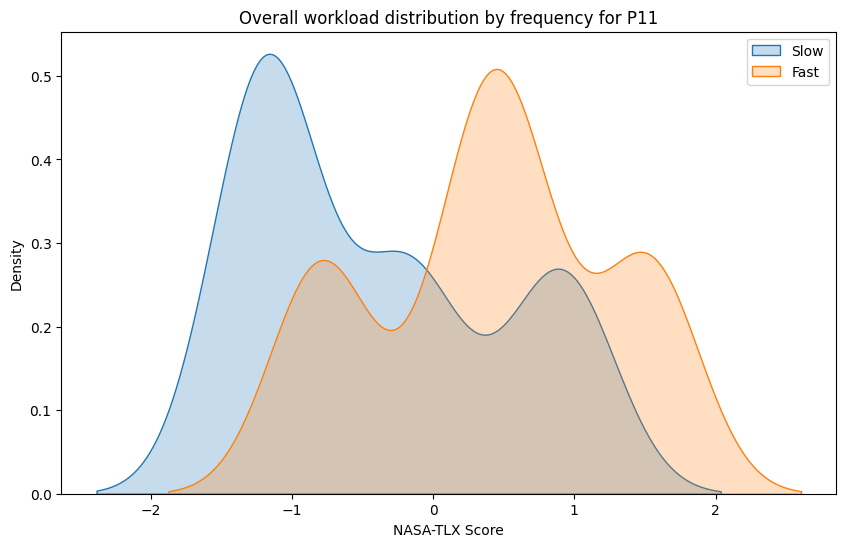

...

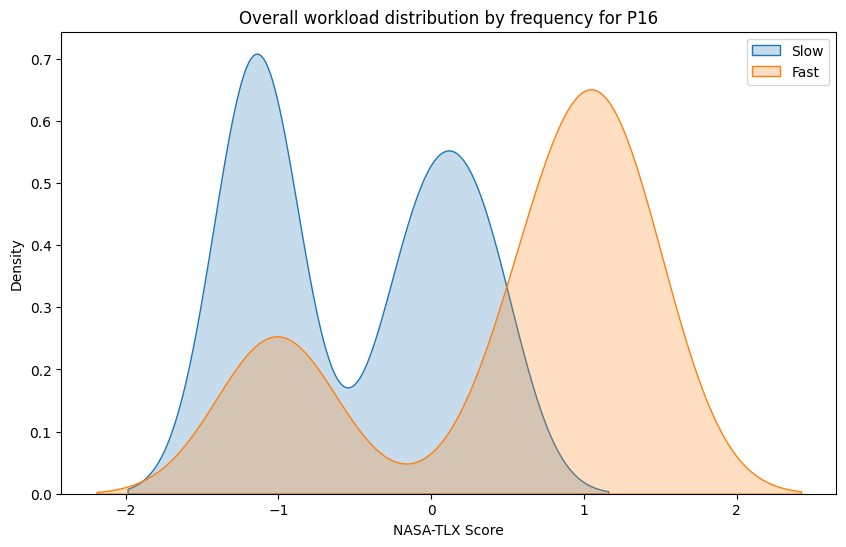

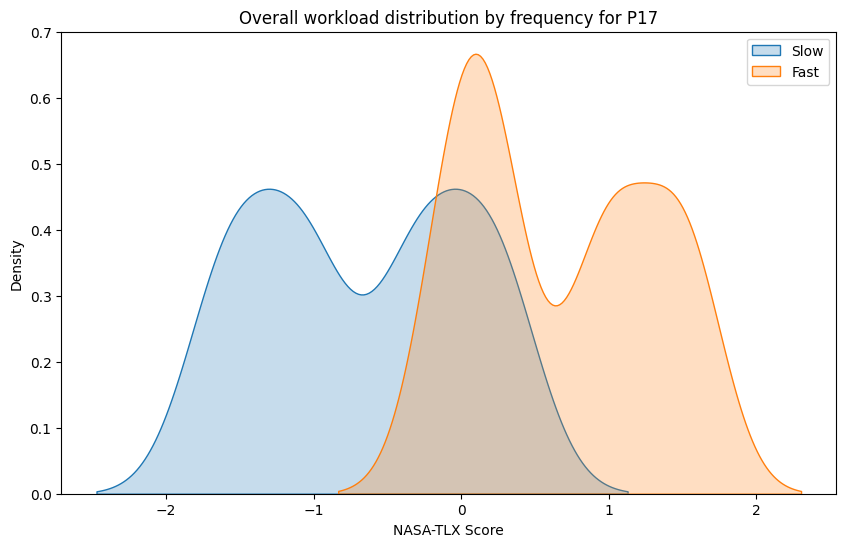

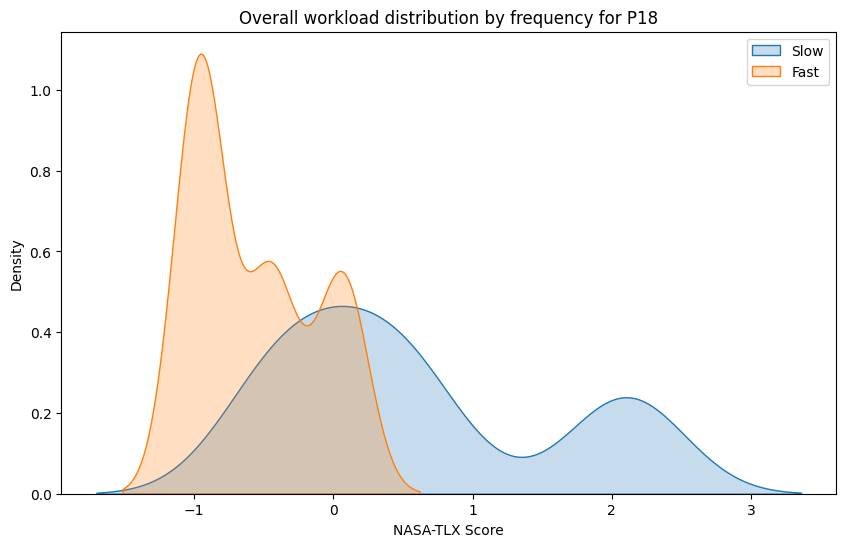

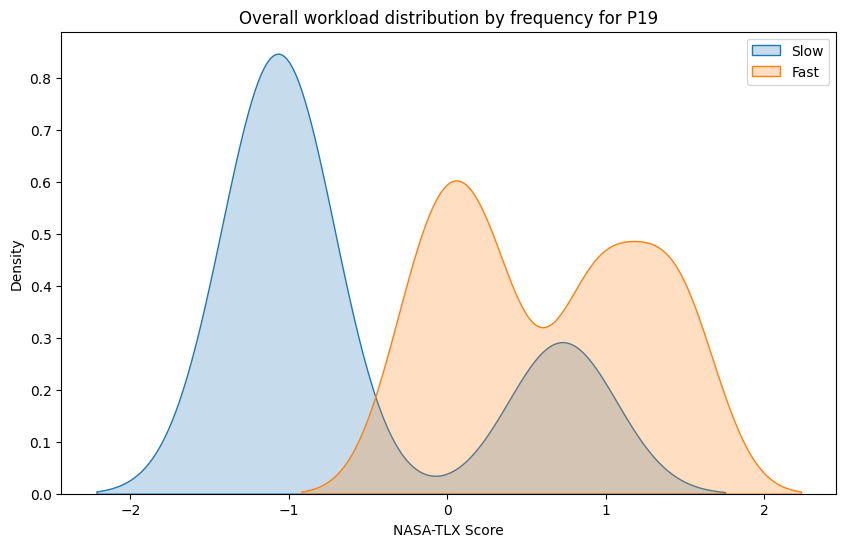

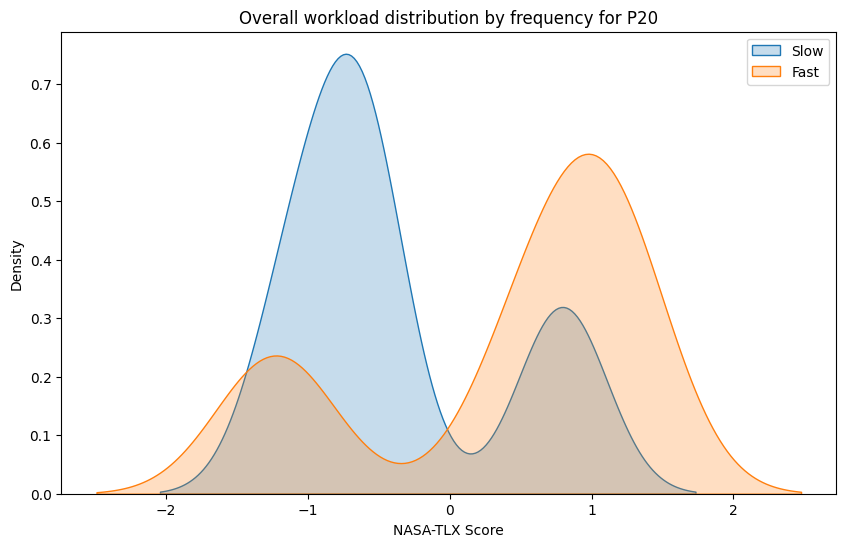

In [55]:
# Frequency
for pid in participant_ids:
    p_df_slow = df_slow.query(f"participant_id == {pid}")
    p_df_fast = df_fast.query(f"participant_id == {pid}")
    
    plt.figure(figsize=(10, 6))
    sns.kdeplot(p_df_slow['NASA_TLX_norm_Score'], fill=True, label='Slow', bw_adjust=0.5)
    sns.kdeplot(p_df_fast['NASA_TLX_norm_Score'], fill=True, label='Fast', bw_adjust=0.5)
    plt.title(f'Overall workload distribution by frequency for P{pid}')
    plt.xlabel('NASA-TLX Score')
    plt.ylabel('Density')
    plt.legend()
    plt.show()

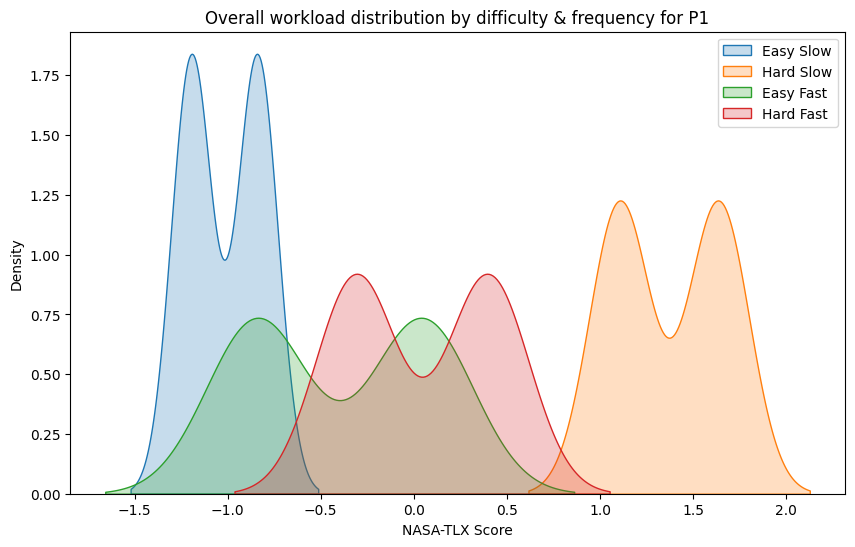

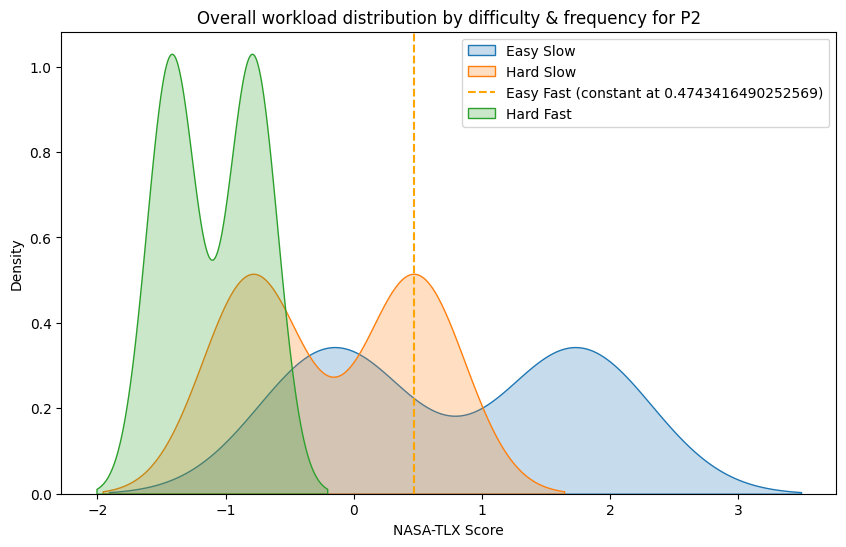

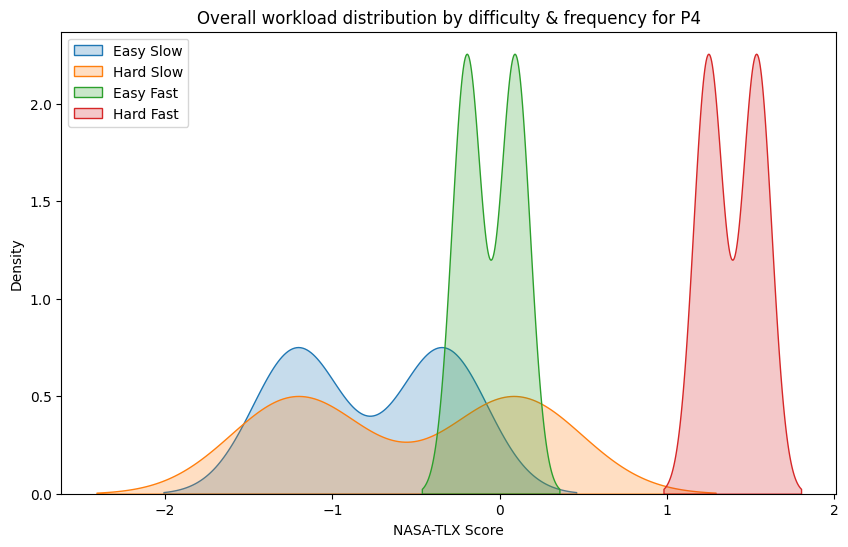

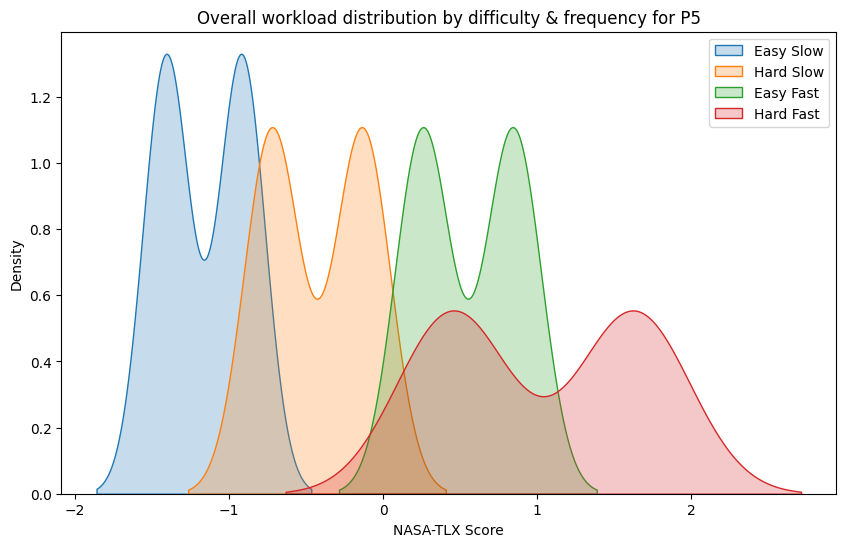

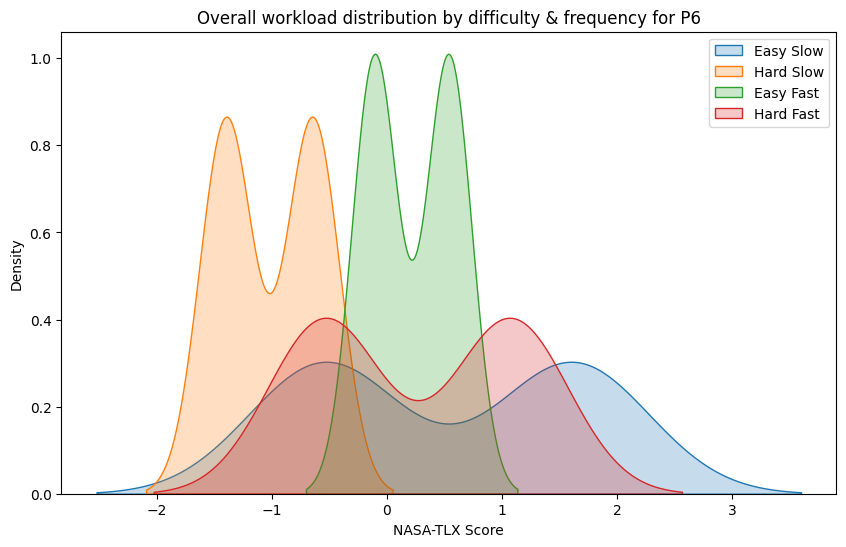

...

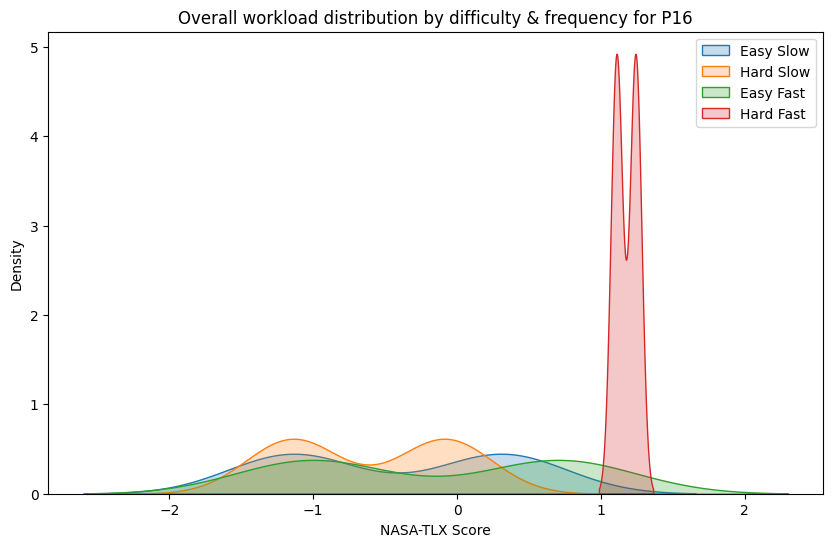

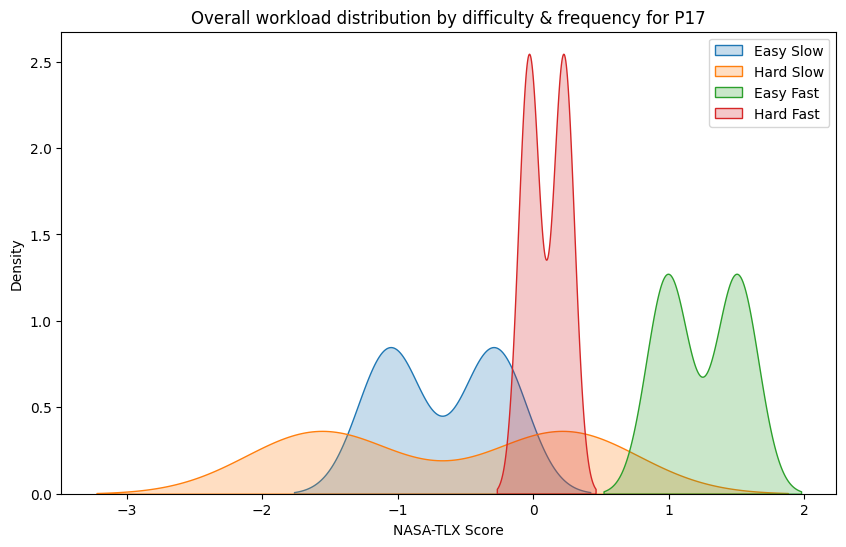

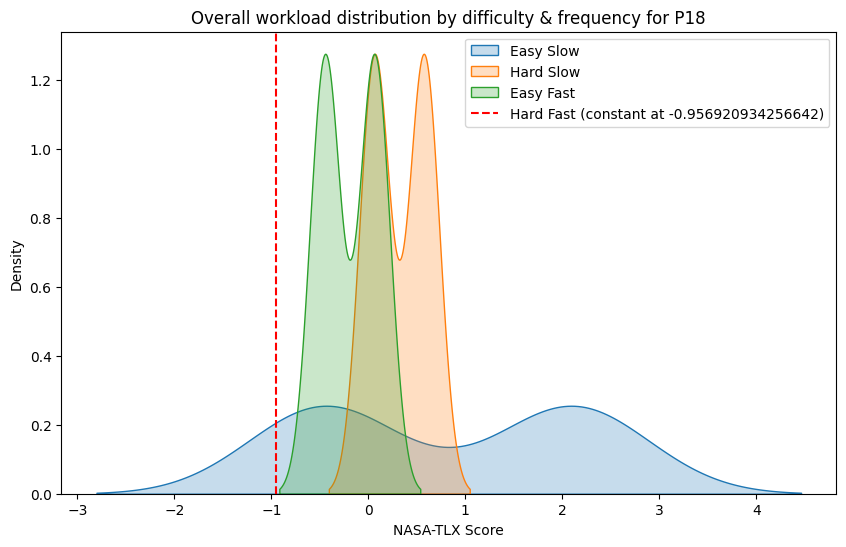

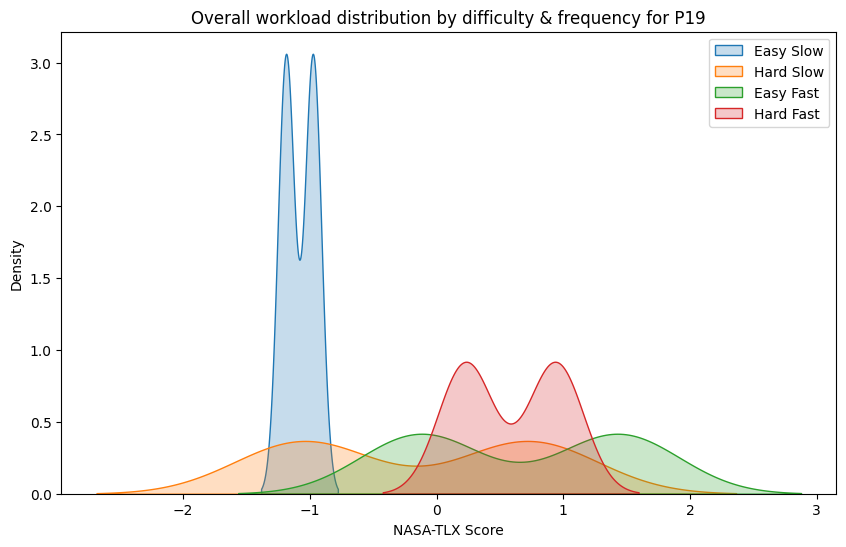

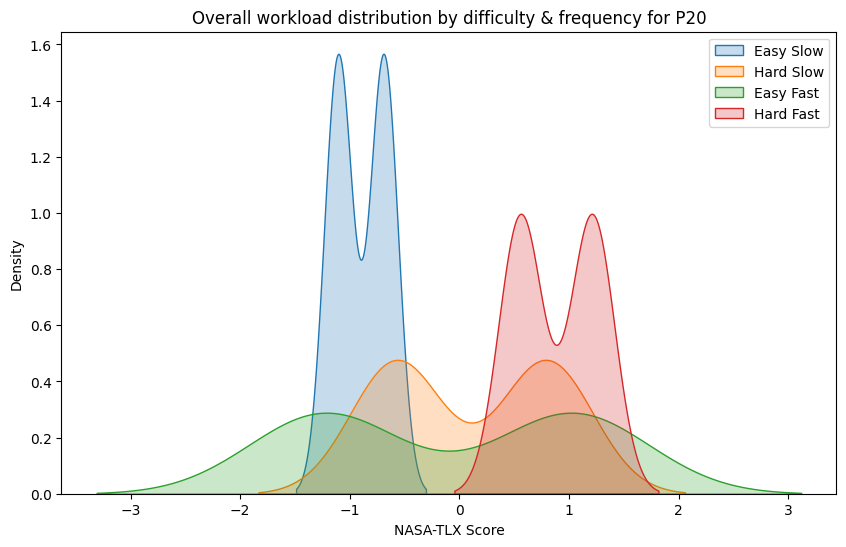

In [56]:
# Difficulty+frequency
for pid in participant_ids:
    p_df_easy_slow = df_easy_slow.query(f"participant_id == {pid}")
    p_df_hard_slow = df_hard_slow.query(f"participant_id == {pid}")
    p_df_easy_fast = df_easy_fast.query(f"participant_id == {pid}")
    p_df_hard_fast = df_hard_fast.query(f"participant_id == {pid}")

    plt.figure(figsize=(10, 6))

    # Easy Slow
    if p_df_easy_slow['NASA_TLX_norm_Score'].var() == 0:
        unique_value_easy_slow = p_df_easy_slow['NASA_TLX_norm_Score'].iloc[0]
        plt.axvline(unique_value_easy_slow, color='blue', linestyle='--', label=f'Easy Slow (constant at {unique_value_easy_slow})')
    else:
        sns.kdeplot(p_df_easy_slow['NASA_TLX_norm_Score'], fill=True, label='Easy Slow', bw_adjust=0.5)

    # Hard Slow
    if p_df_hard_slow['NASA_TLX_norm_Score'].var() == 0:
        unique_value_hard_slow = p_df_hard_slow['NASA_TLX_norm_Score'].iloc[0]
        plt.axvline(unique_value_hard_slow, color='green', linestyle='--', label=f'Hard Slow (constant at {unique_value_hard_slow})')
    else:
        sns.kdeplot(p_df_hard_slow['NASA_TLX_norm_Score'], fill=True, label='Hard Slow', bw_adjust=0.5)

    # Easy Fast
    if p_df_easy_fast['NASA_TLX_norm_Score'].var() == 0:
        unique_value_easy_fast = p_df_easy_fast['NASA_TLX_norm_Score'].iloc[0]
        plt.axvline(unique_value_easy_fast, color='orange', linestyle='--', label=f'Easy Fast (constant at {unique_value_easy_fast})')
    else:
        sns.kdeplot(p_df_easy_fast['NASA_TLX_norm_Score'], fill=True, label='Easy Fast', bw_adjust=0.5)

    # Hard Fast
    if p_df_hard_fast['NASA_TLX_norm_Score'].var() == 0:
        unique_value_hard_fast = p_df_hard_fast['NASA_TLX_norm_Score'].iloc[0]
        plt.axvline(unique_value_hard_fast, color='red', linestyle='--', label=f'Hard Fast (constant at {unique_value_hard_fast})')
    else:
        sns.kdeplot(p_df_hard_fast['NASA_TLX_norm_Score'], fill=True, label='Hard Fast', bw_adjust=0.5)

    plt.title(f'Overall workload distribution by difficulty & frequency for P{pid}')
    plt.xlabel('NASA-TLX Score')
    plt.ylabel('Density')
    plt.legend()
    plt.show()


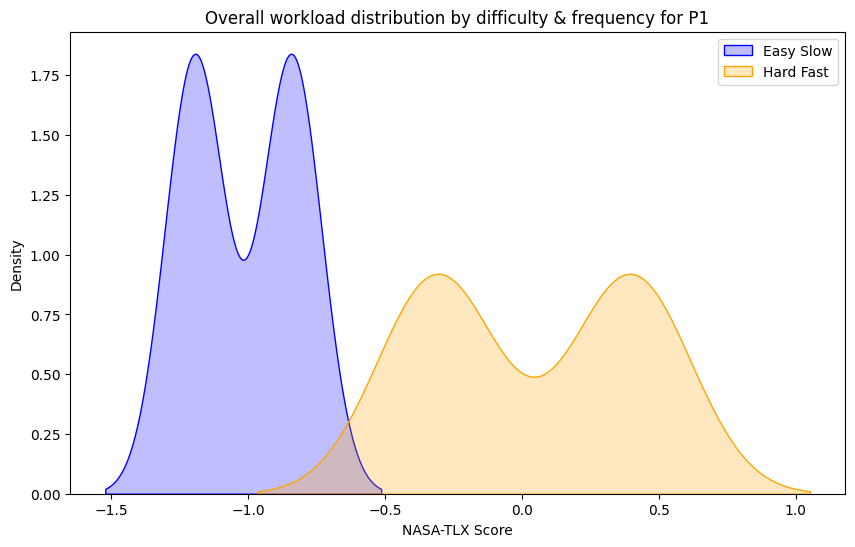

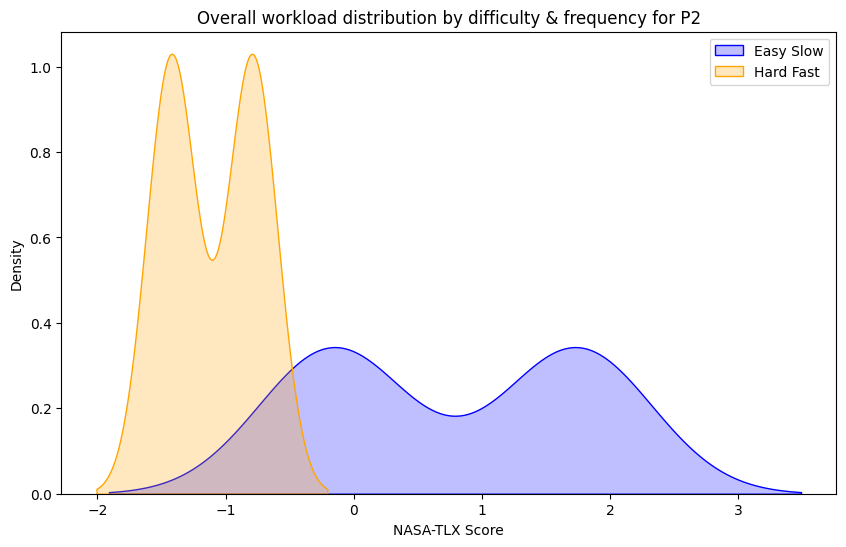

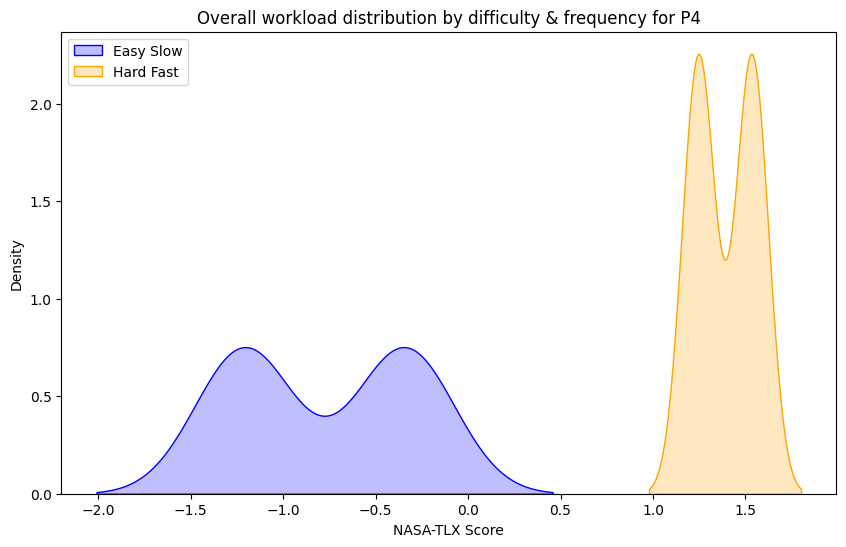

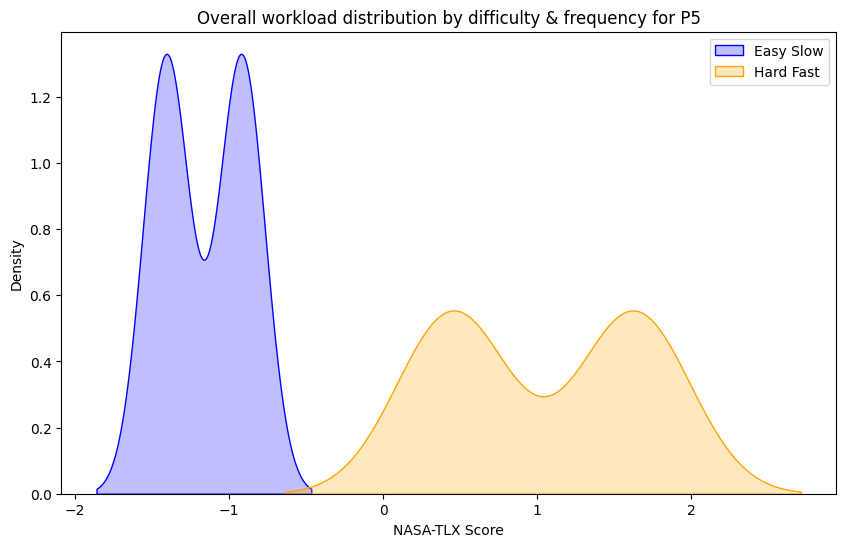

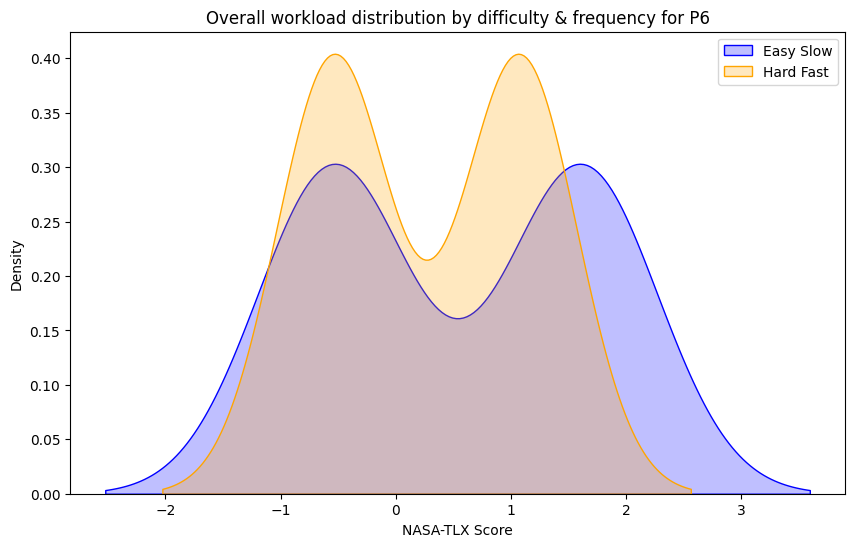

...

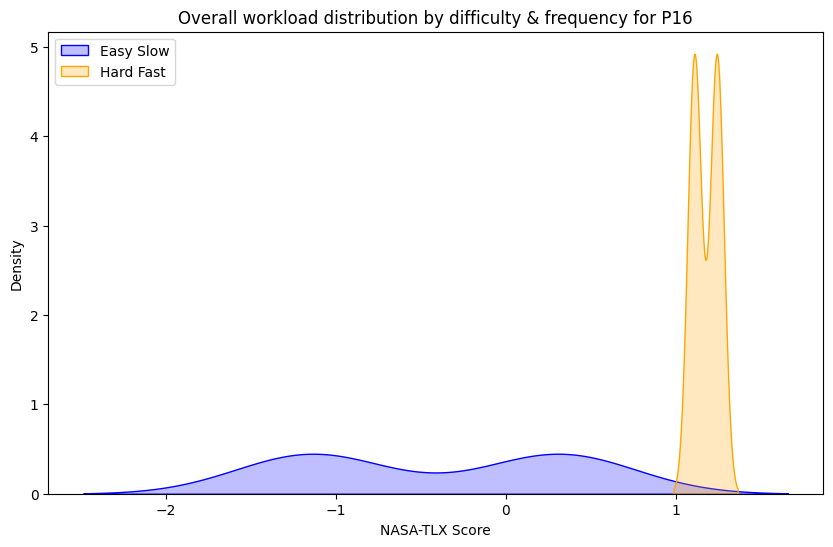

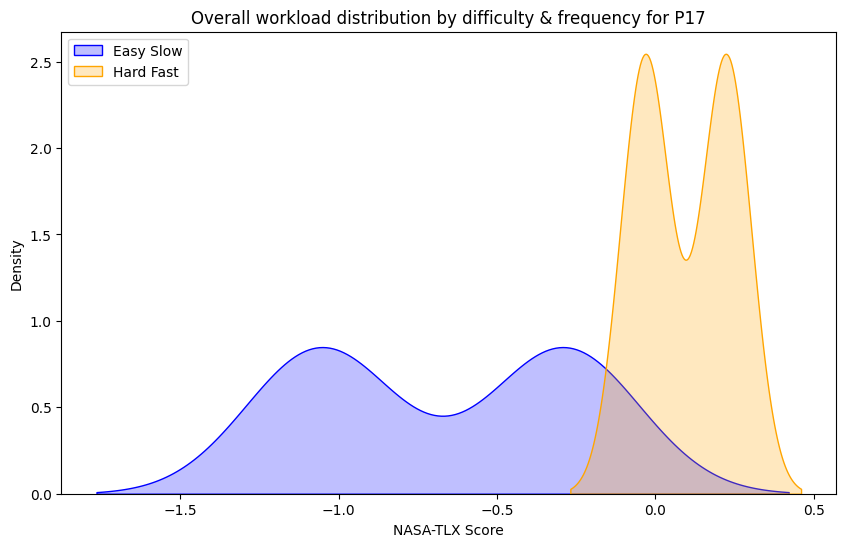

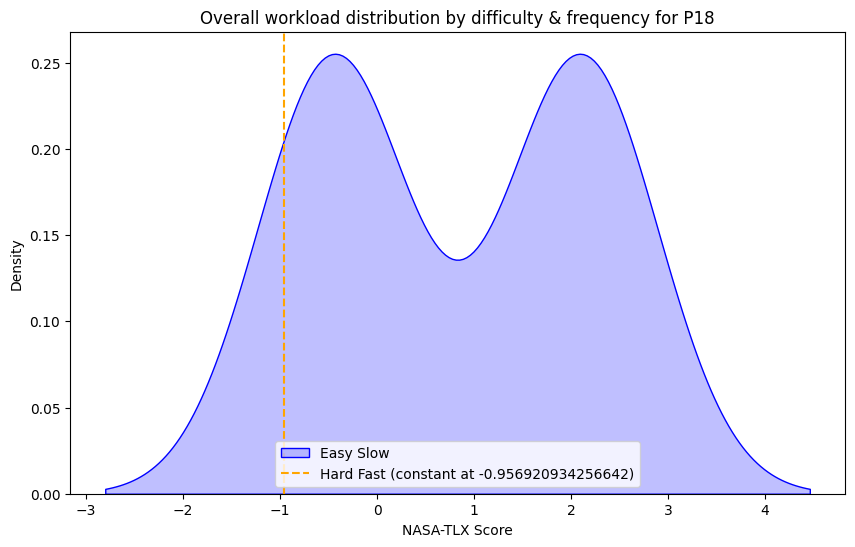

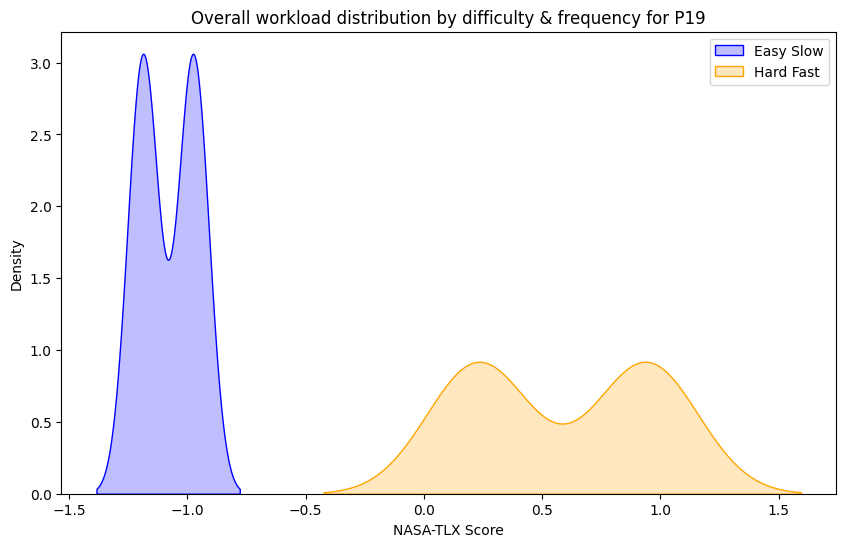

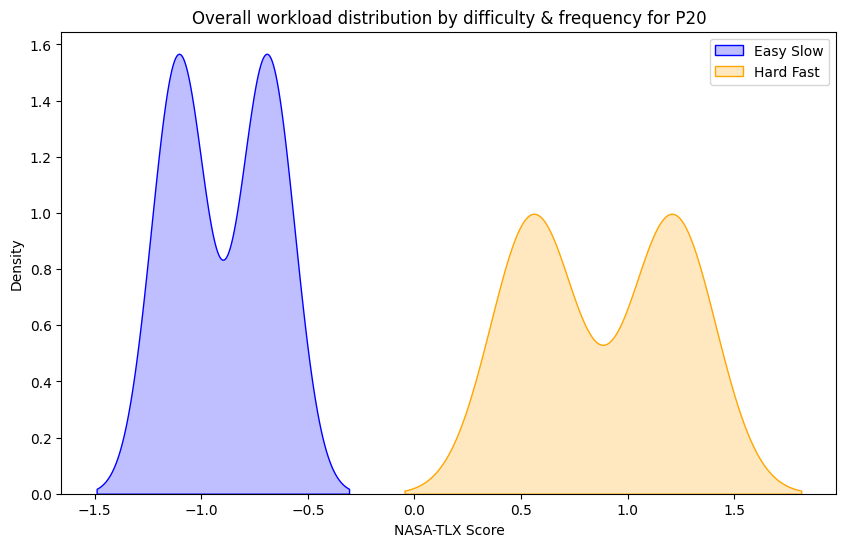

In [57]:
# Extreme conditions
for pid in participant_ids:
    p_df_easy_slow = df_easy_slow.query(f"participant_id == {pid}")
    p_df_hard_fast = df_hard_fast.query(f"participant_id == {pid}")

    plt.figure(figsize=(10, 6))

    # Check variance for Easy Slow condition
    if p_df_easy_slow['NASA_TLX_norm_Score'].var() == 0:
        unique_value_easy_slow = p_df_easy_slow['NASA_TLX_norm_Score'].iloc[0]
        plt.axvline(unique_value_easy_slow, color='blue', linestyle='--', label=f'Easy Slow (constant at {unique_value_easy_slow})')
    else:
        sns.kdeplot(p_df_easy_slow['NASA_TLX_norm_Score'], color='blue', fill=True, label='Easy Slow', bw_adjust=0.5)
    
    # Check variance for Hard Fast condition
    if p_df_hard_fast['NASA_TLX_norm_Score'].var() == 0:
        unique_value_hard_fast = p_df_hard_fast['NASA_TLX_norm_Score'].iloc[0]
        plt.axvline(unique_value_hard_fast, color='orange', linestyle='--', label=f'Hard Fast (constant at {unique_value_hard_fast})')
    else:
        sns.kdeplot(p_df_hard_fast['NASA_TLX_norm_Score'], color='orange', fill=True, label='Hard Fast', bw_adjust=0.5)

    plt.title(f'Overall workload distribution by difficulty & frequency for P{pid}')
    plt.xlabel('NASA-TLX Score')
    plt.ylabel('Density')
    plt.legend()
    plt.show()

##### Distribution comparison (per participant) (normalized2)
- (...)

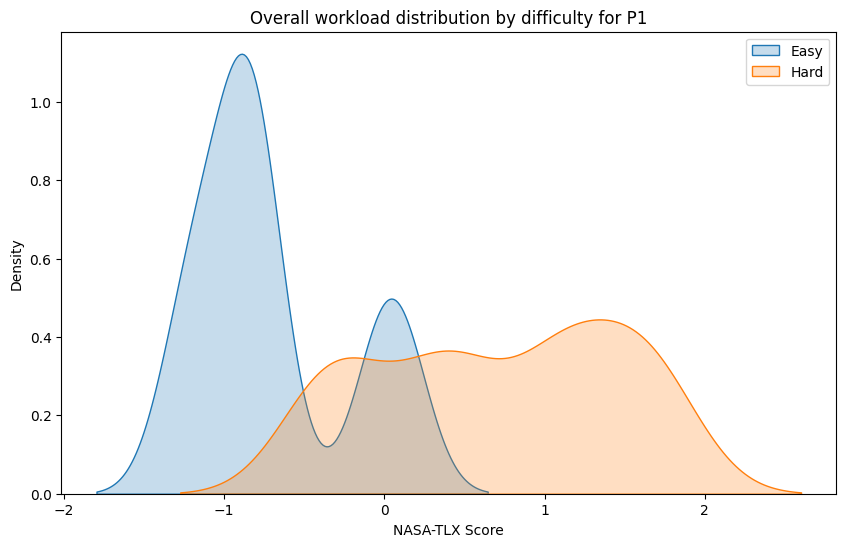

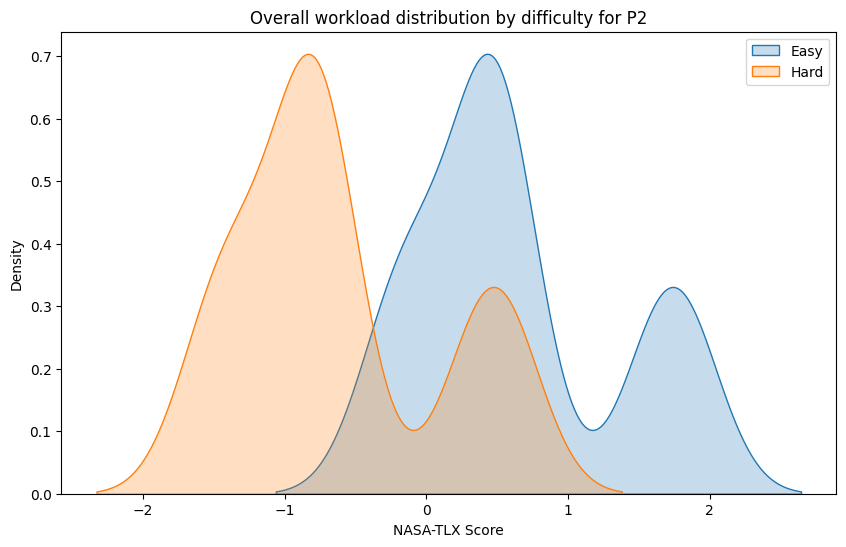

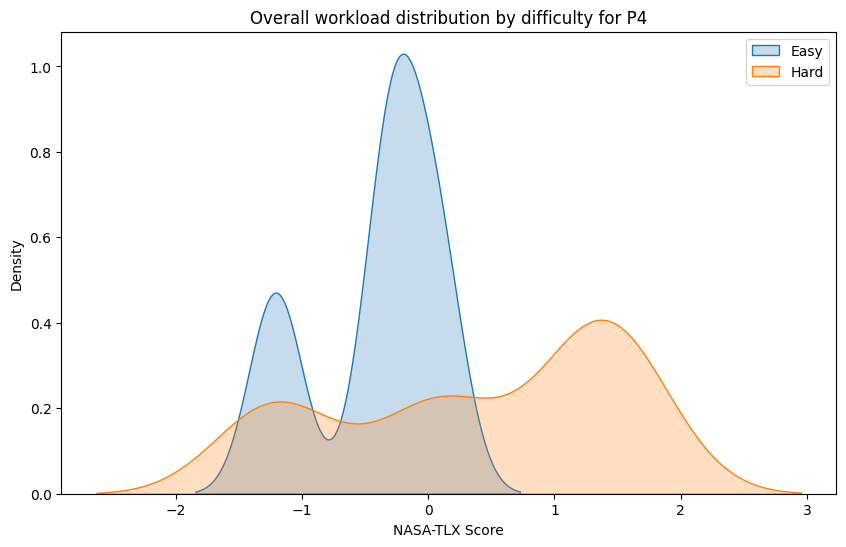

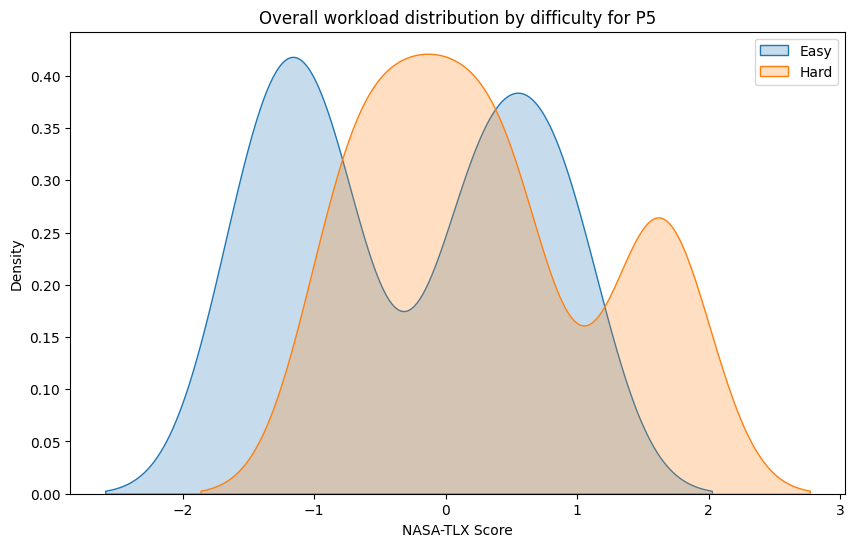

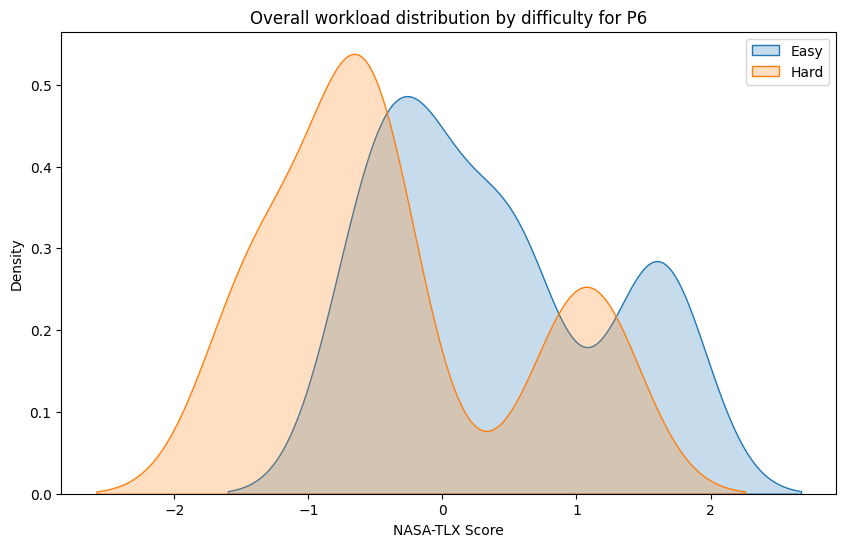

...

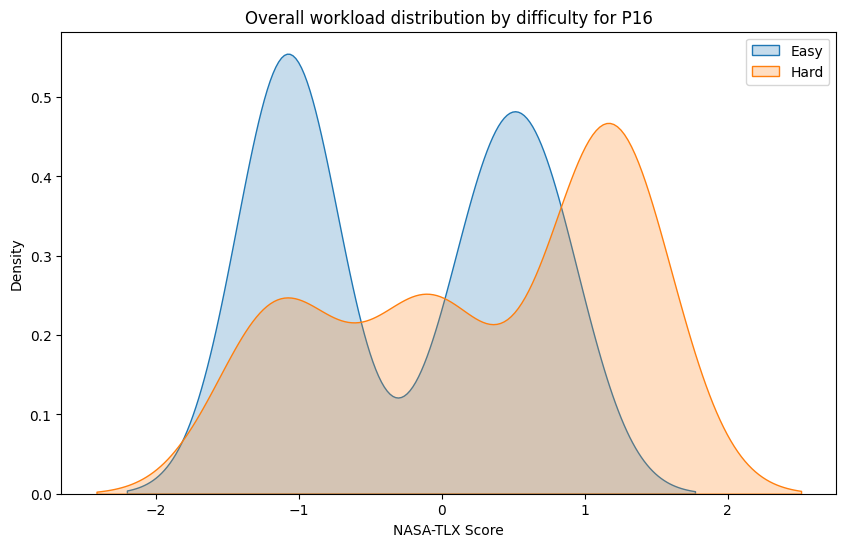

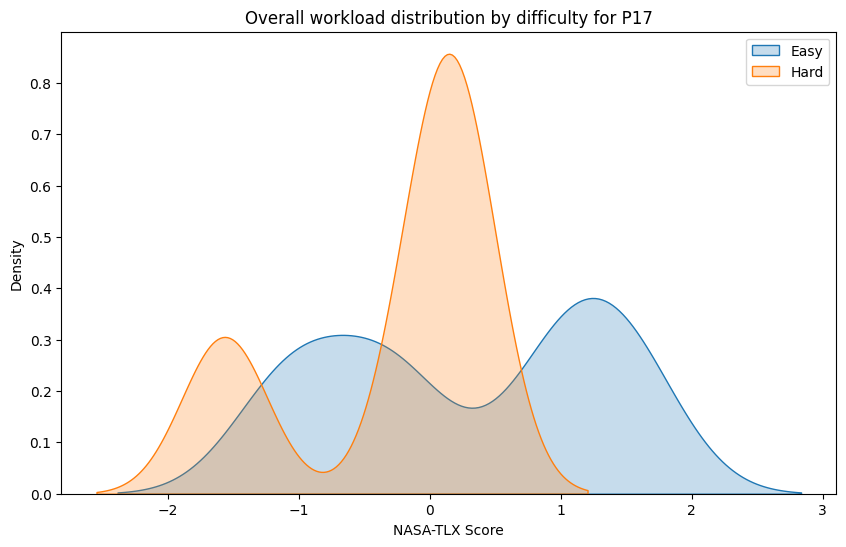

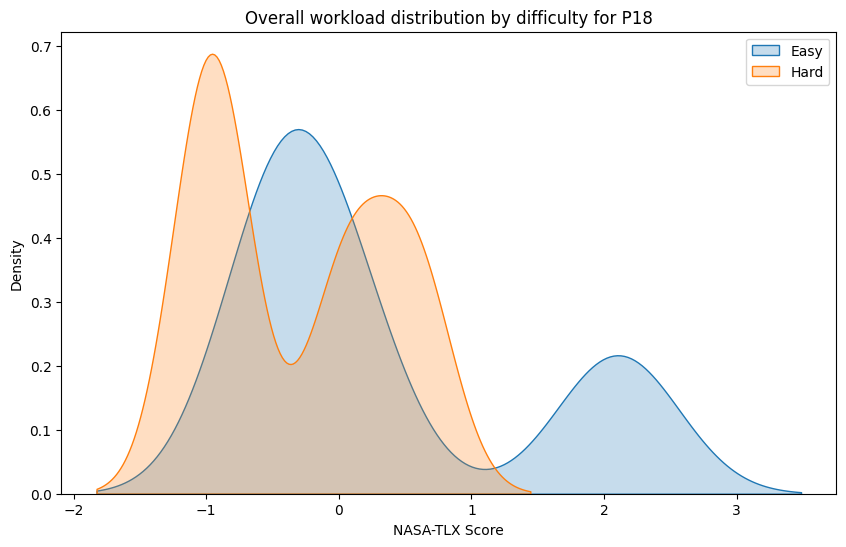

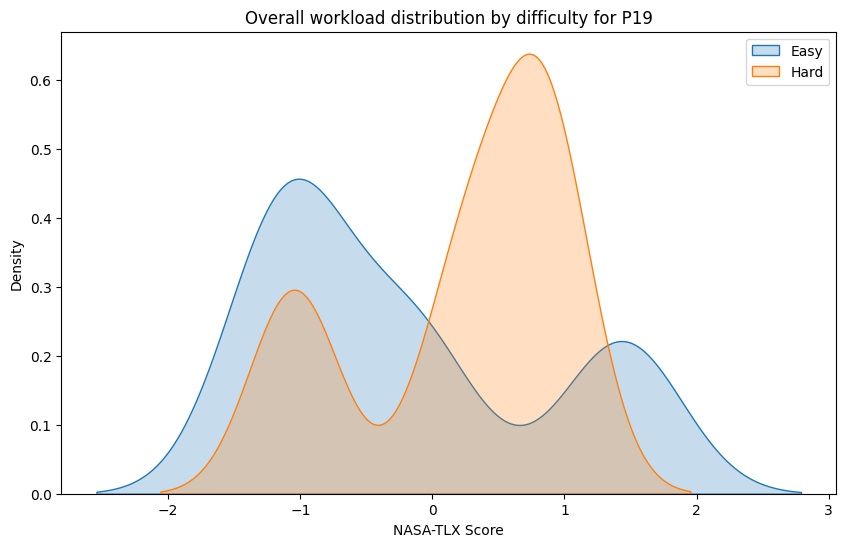

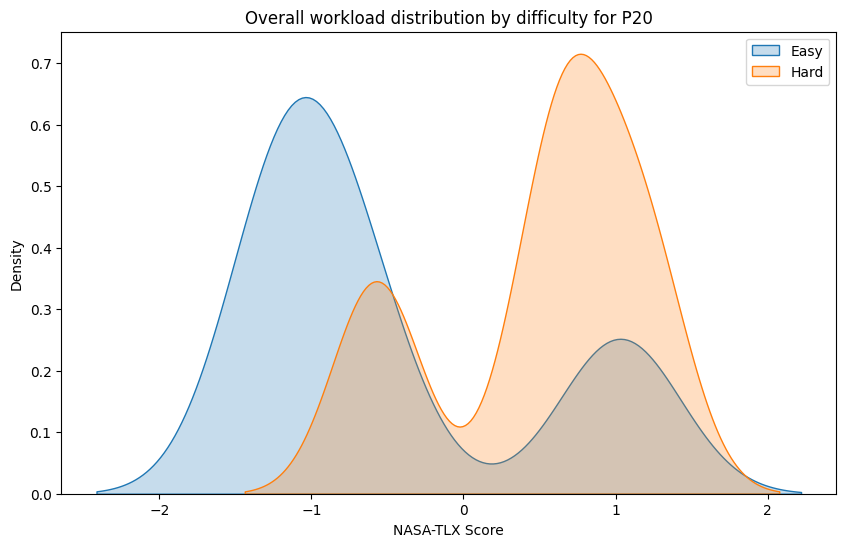

In [58]:
# Difficulty
for pid in participant_ids:
    p_df_easy = df_easy.query(f"participant_id == {pid}")
    p_df_hard = df_hard.query(f"participant_id == {pid}")

    plt.figure(figsize=(10, 6))
    sns.kdeplot(p_df_easy['NASA_TLX_minmax_Score'], fill=True, label='Easy', bw_adjust=0.5)
    sns.kdeplot(p_df_hard['NASA_TLX_minmax_Score'], fill=True, label='Hard', bw_adjust=0.5)
    plt.title(f'Overall workload distribution by difficulty for P{pid}')
    plt.xlabel('NASA-TLX Score')
    plt.ylabel('Density')
    plt.legend()
    plt.show()

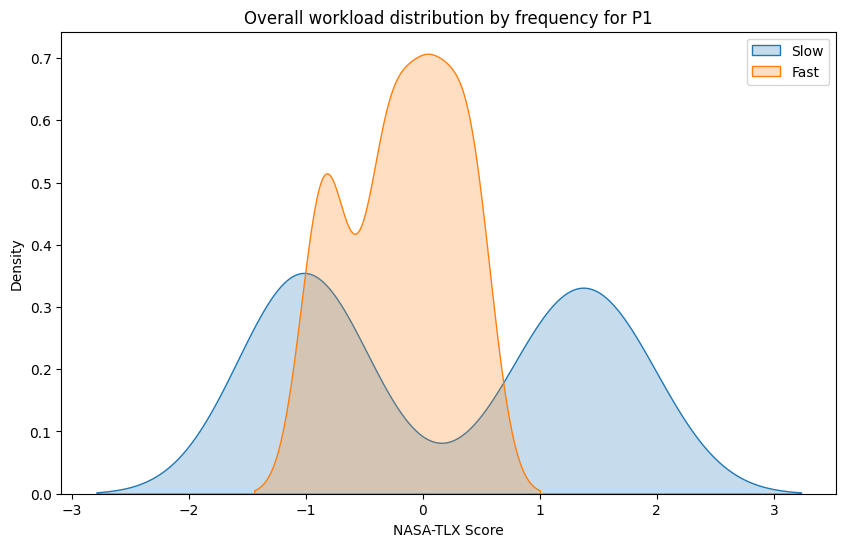

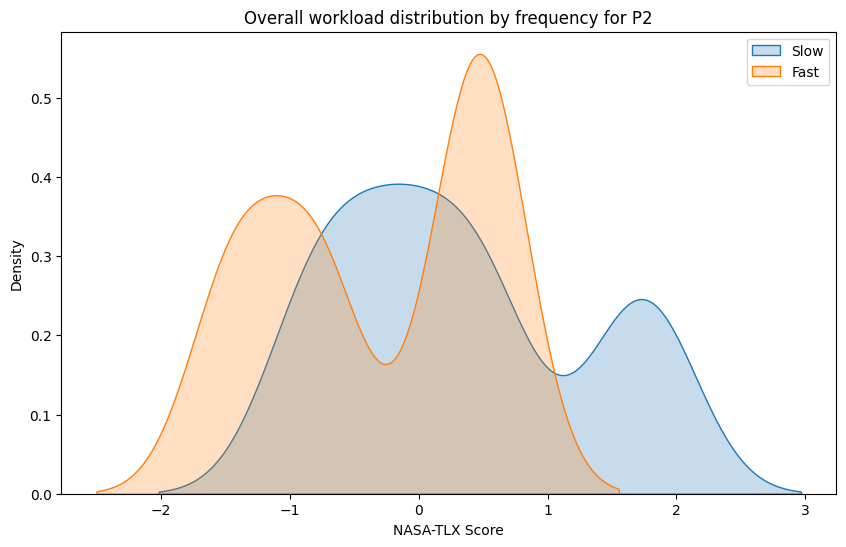

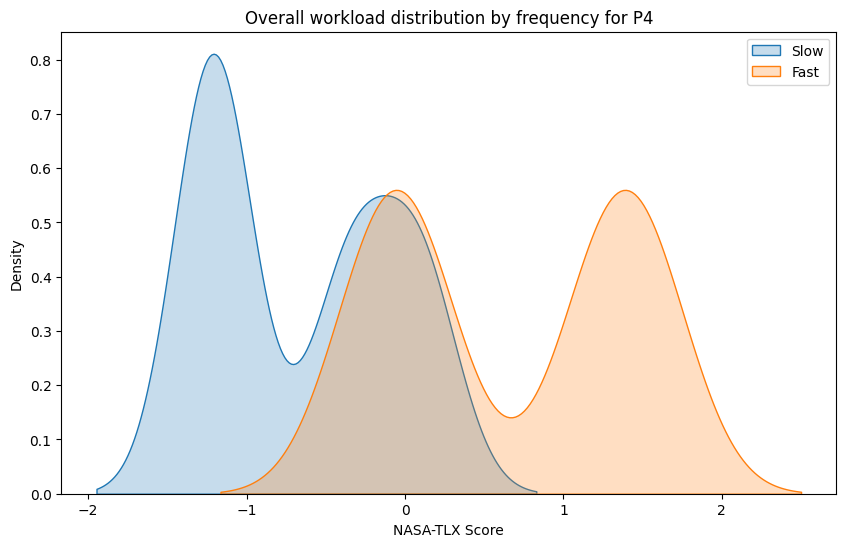

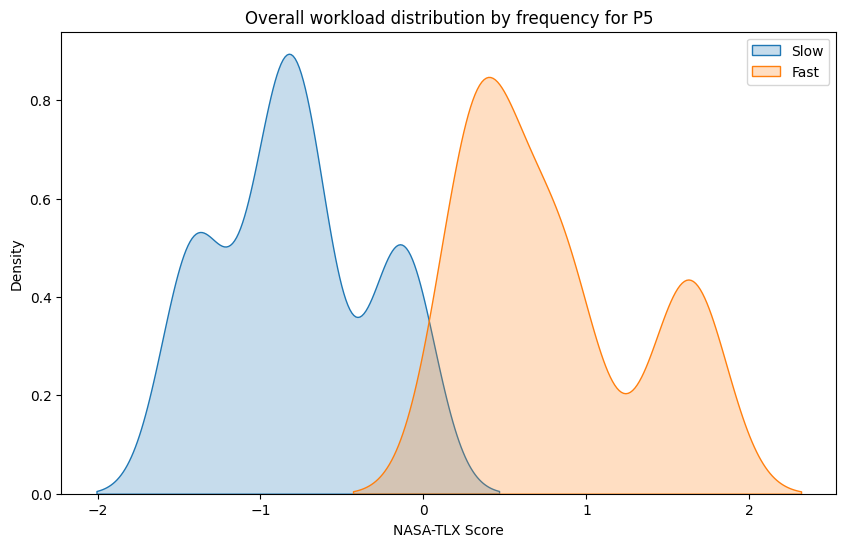

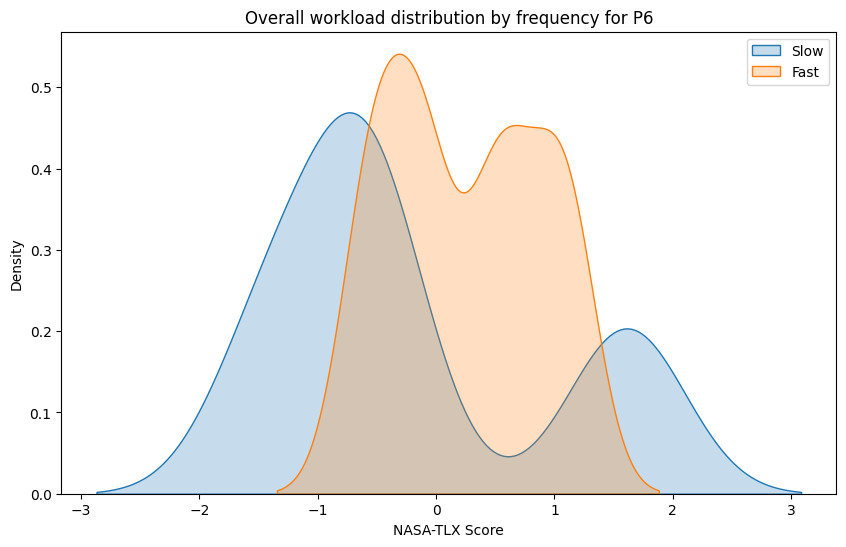

C:\Users\vale_ad\AppData\Local\Temp\ipykernel_11552\3191126652.py:8: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(p_df_fast['NASA_TLX_minmax_Score'], fill=True, label='Fast', bw_adjust=0.5)


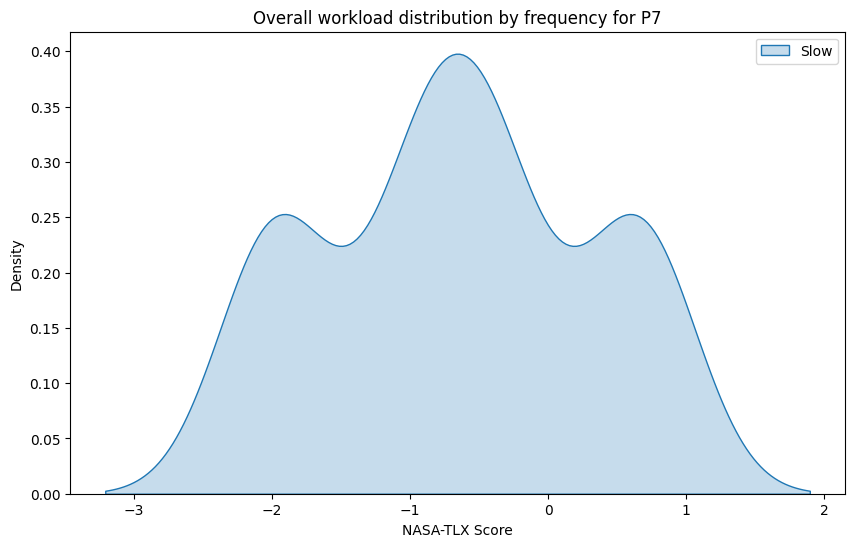

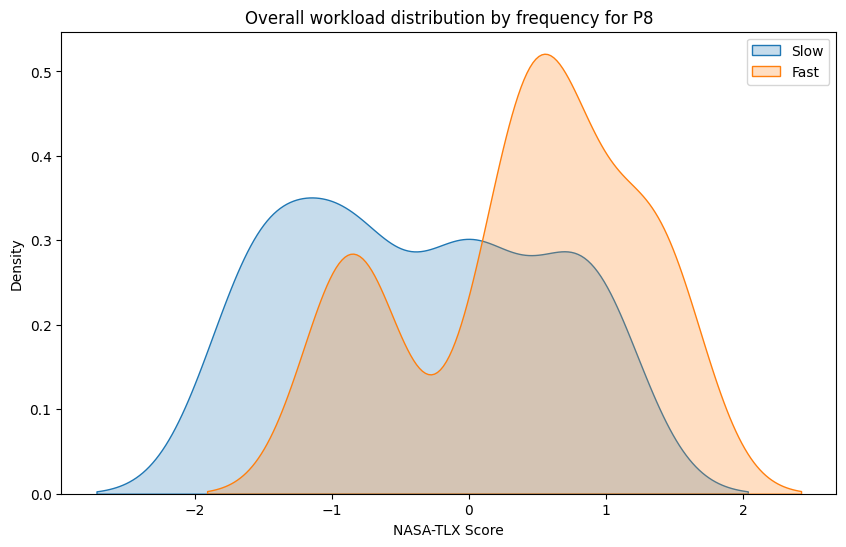

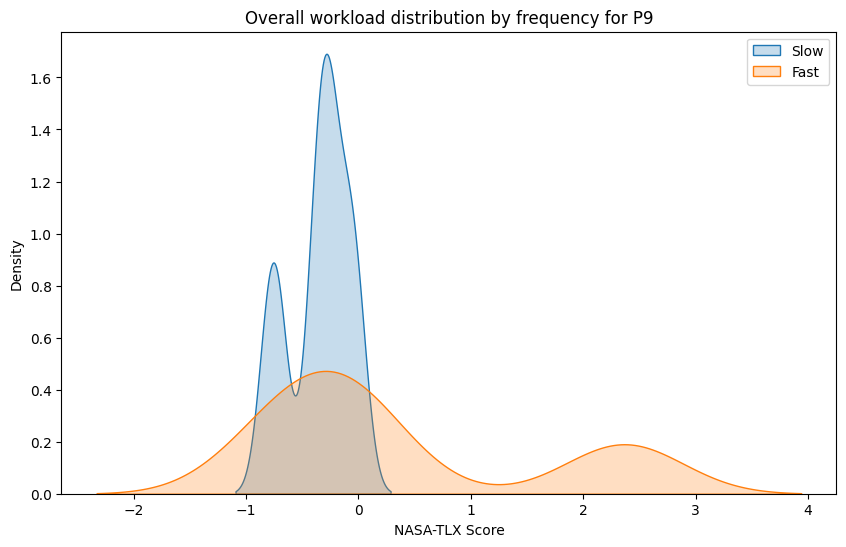

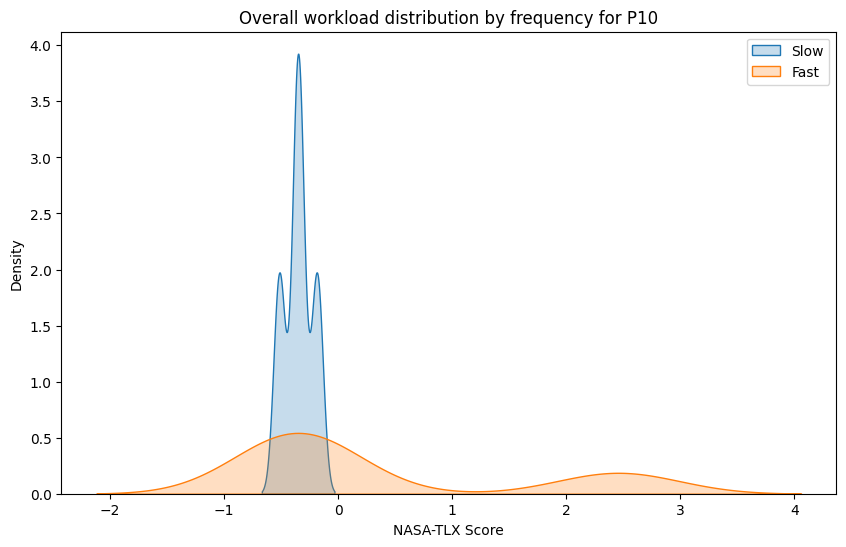

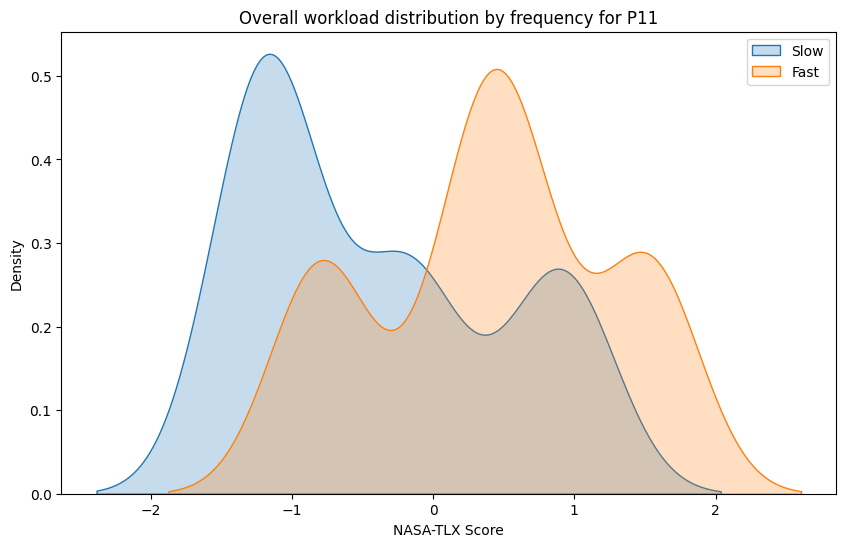

...

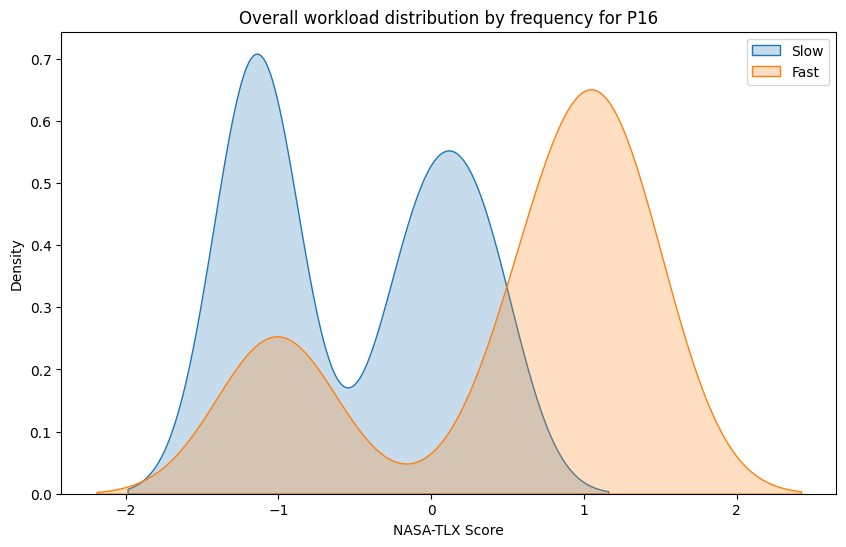

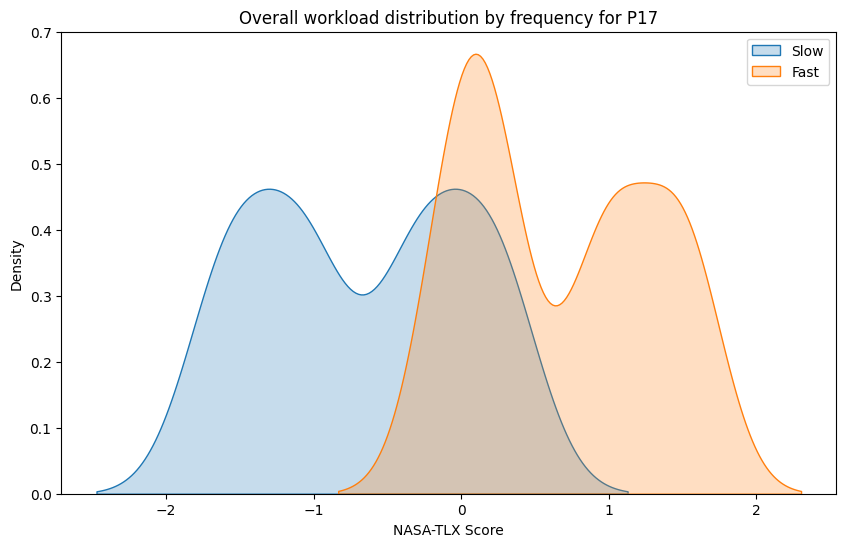

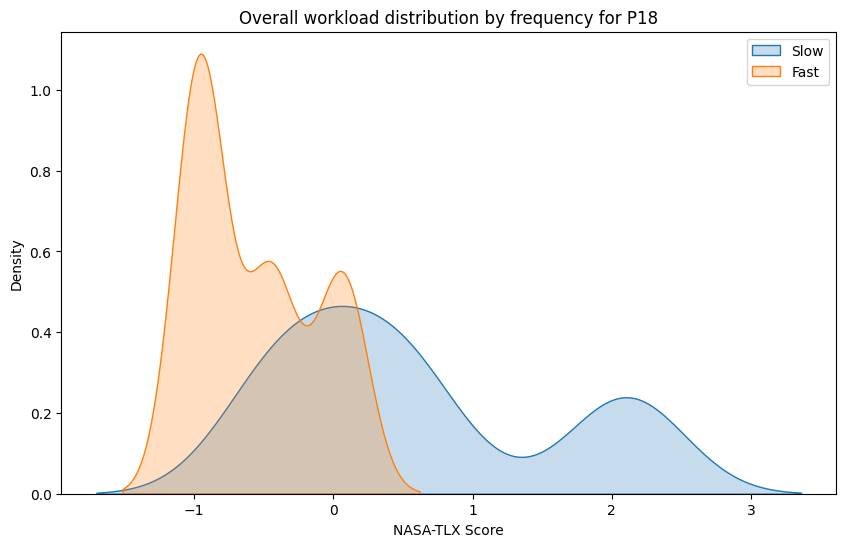

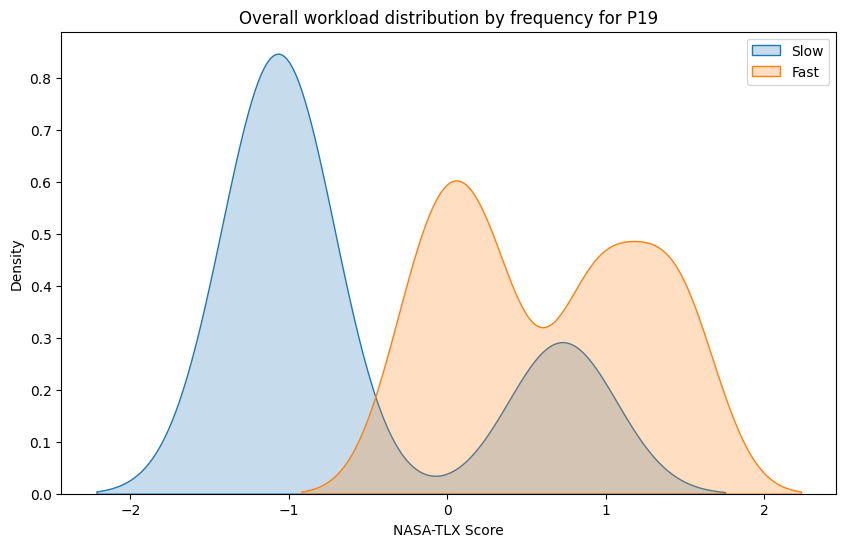

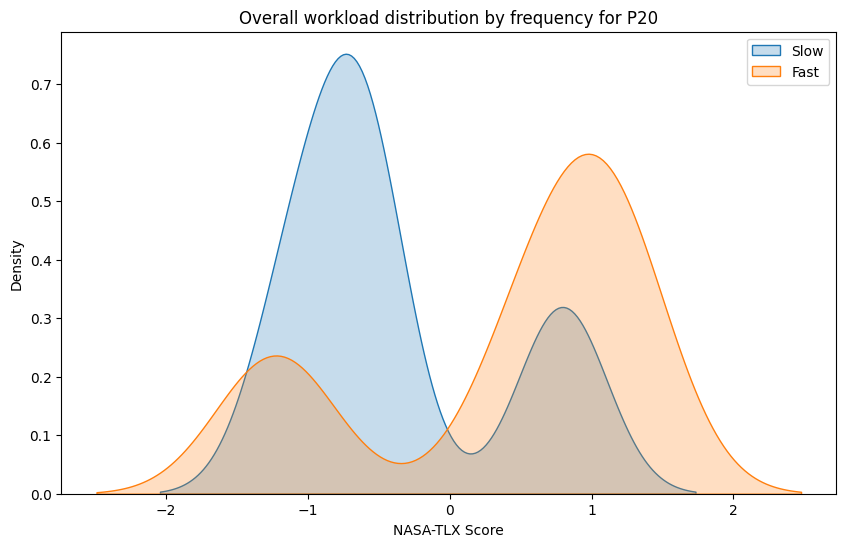

In [59]:
# Frequency
for pid in participant_ids:
    p_df_slow = df_slow.query(f"participant_id == {pid}")
    p_df_fast = df_fast.query(f"participant_id == {pid}")
    
    plt.figure(figsize=(10, 6))
    sns.kdeplot(p_df_slow['NASA_TLX_minmax_Score'], fill=True, label='Slow', bw_adjust=0.5)
    sns.kdeplot(p_df_fast['NASA_TLX_minmax_Score'], fill=True, label='Fast', bw_adjust=0.5)
    plt.title(f'Overall workload distribution by frequency for P{pid}')
    plt.xlabel('NASA-TLX Score')
    plt.ylabel('Density')
    plt.legend()
    plt.show()

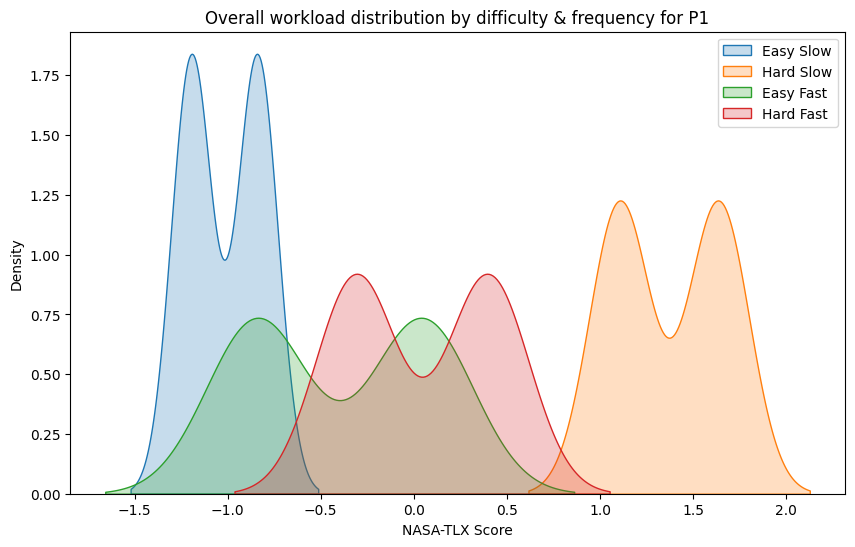

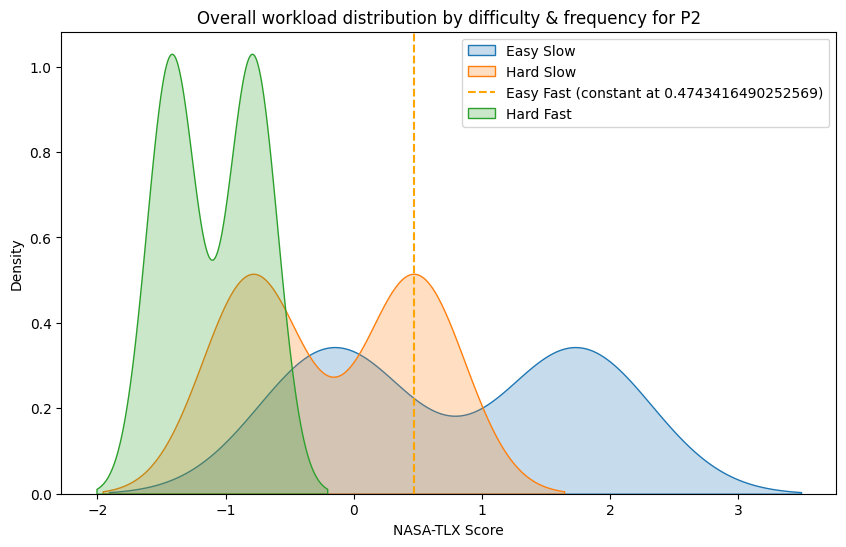

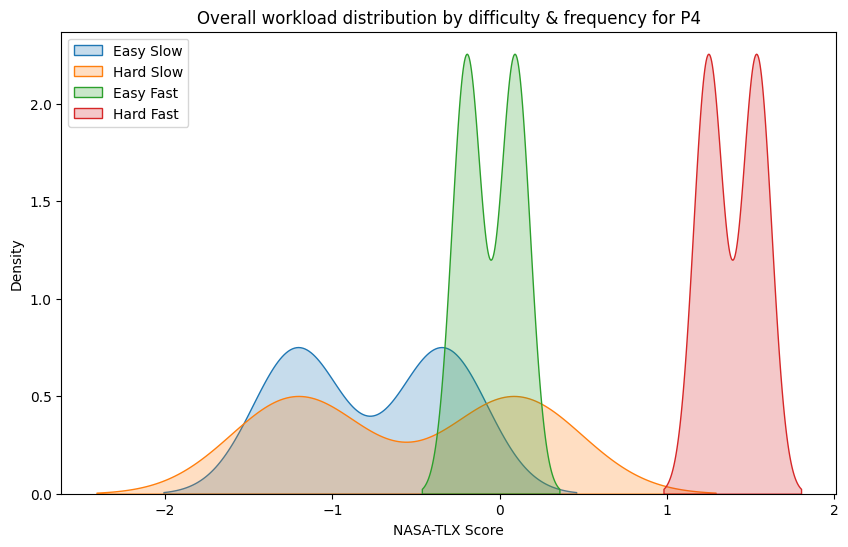

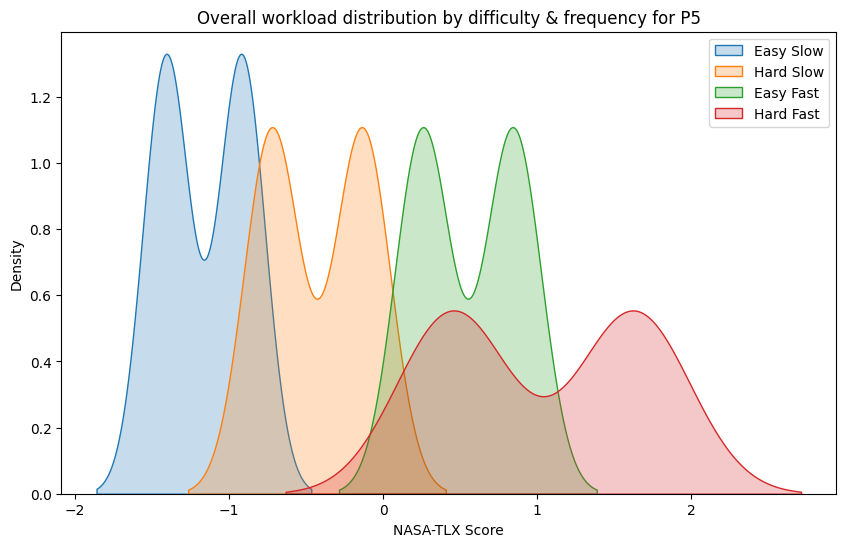

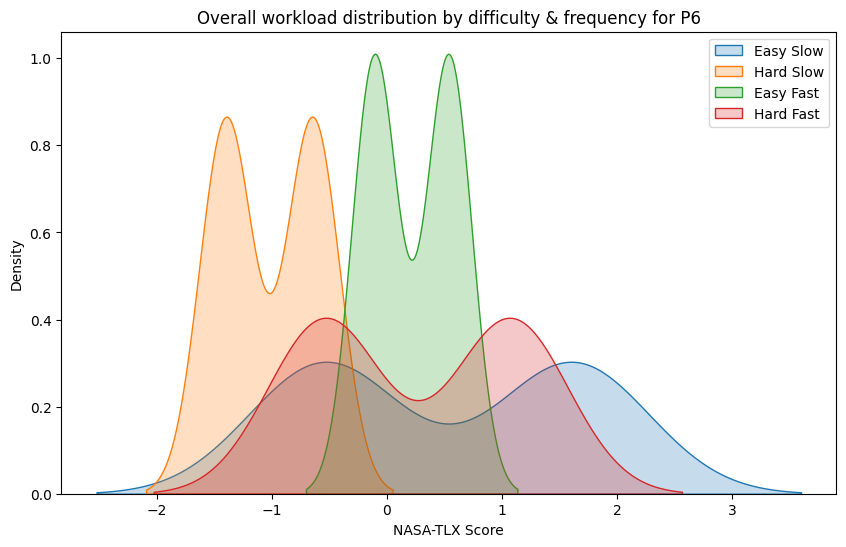

...

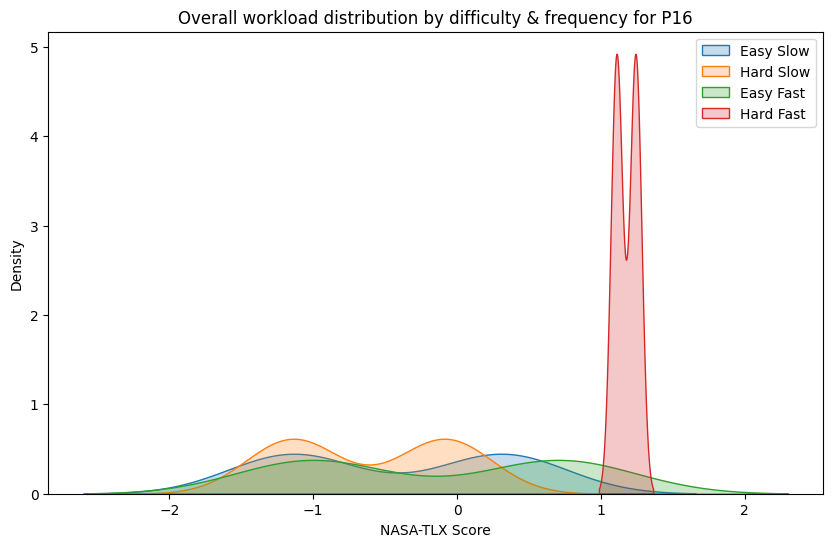

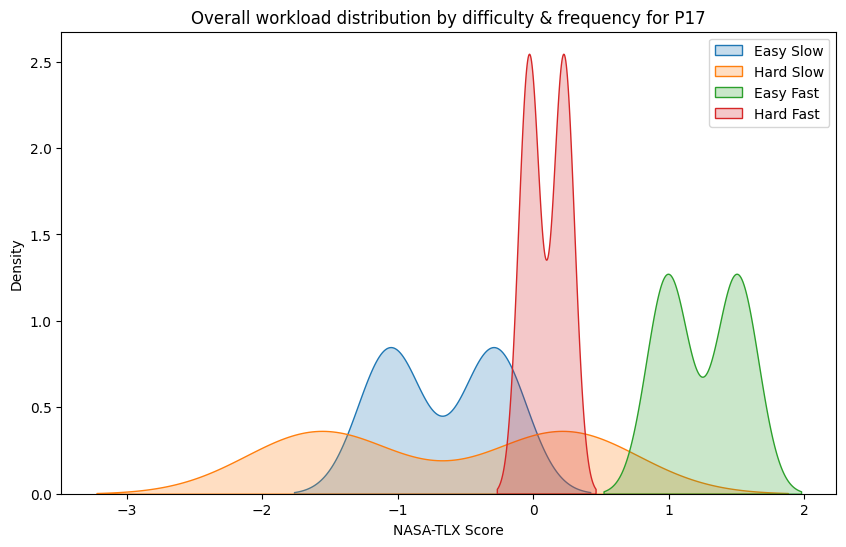

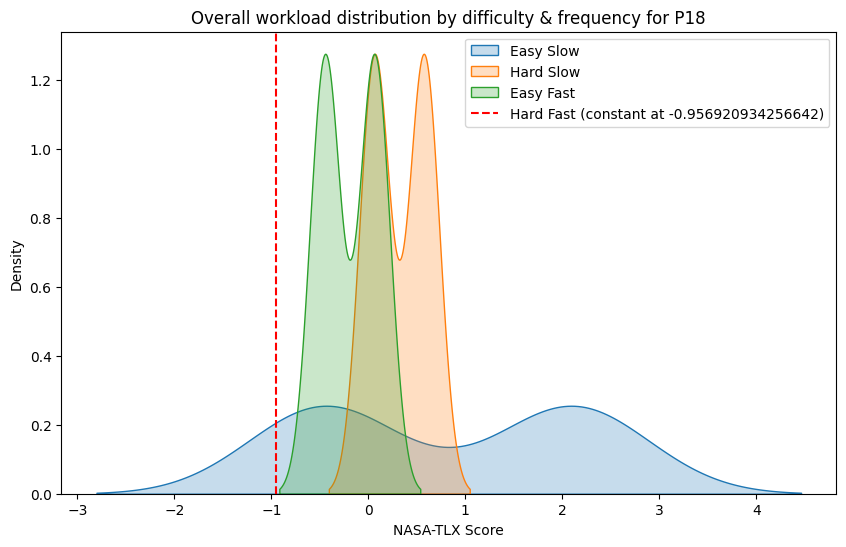

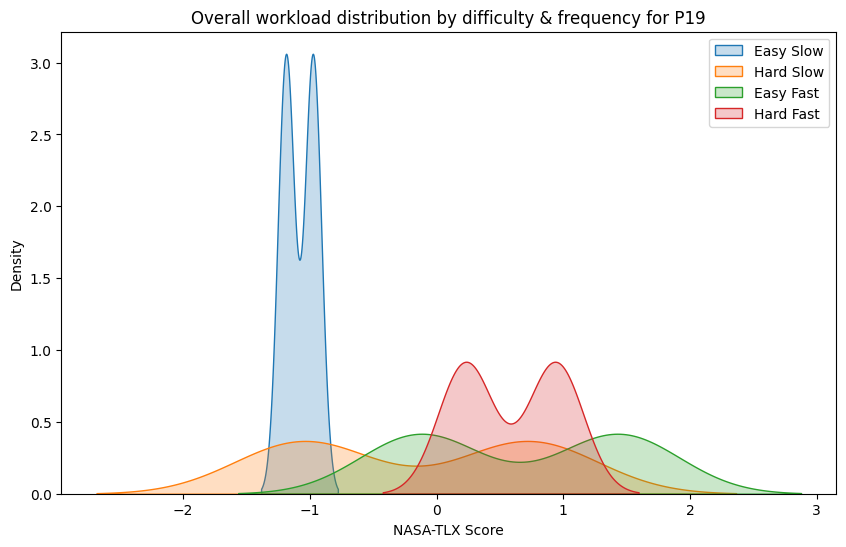

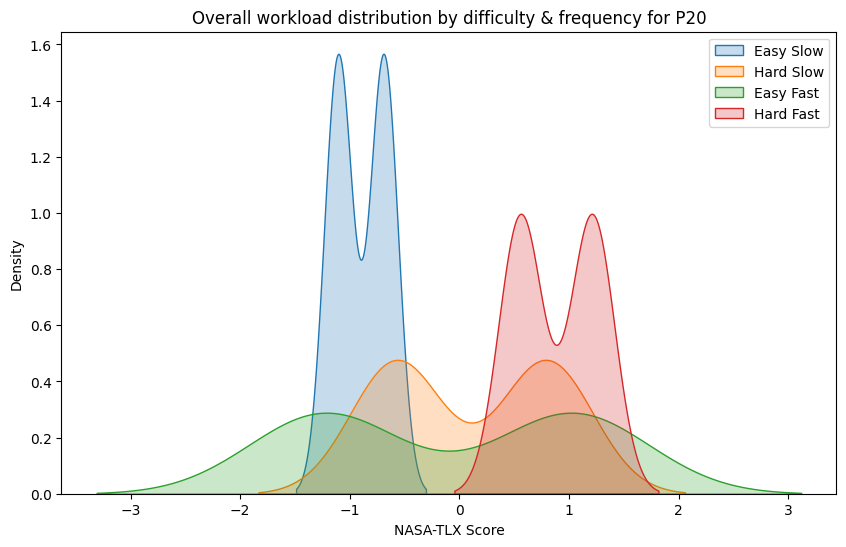

In [60]:
# Difficulty+frequency
for pid in participant_ids:
    p_df_easy_slow = df_easy_slow.query(f"participant_id == {pid}")
    p_df_hard_slow = df_hard_slow.query(f"participant_id == {pid}")
    p_df_easy_fast = df_easy_fast.query(f"participant_id == {pid}")
    p_df_hard_fast = df_hard_fast.query(f"participant_id == {pid}")

    plt.figure(figsize=(10, 6))

    # Easy Slow
    if p_df_easy_slow['NASA_TLX_minmax_Score'].var() == 0:
        unique_value_easy_slow = p_df_easy_slow['NASA_TLX_minmax_Score'].iloc[0]
        plt.axvline(unique_value_easy_slow, color='blue', linestyle='--', label=f'Easy Slow (constant at {unique_value_easy_slow})')
    else:
        sns.kdeplot(p_df_easy_slow['NASA_TLX_minmax_Score'], fill=True, label='Easy Slow', bw_adjust=0.5)

    # Hard Slow
    if p_df_hard_slow['NASA_TLX_minmax_Score'].var() == 0:
        unique_value_hard_slow = p_df_hard_slow['NASA_TLX_minmax_Score'].iloc[0]
        plt.axvline(unique_value_hard_slow, color='green', linestyle='--', label=f'Hard Slow (constant at {unique_value_hard_slow})')
    else:
        sns.kdeplot(p_df_hard_slow['NASA_TLX_minmax_Score'], fill=True, label='Hard Slow', bw_adjust=0.5)

    # Easy Fast
    if p_df_easy_fast['NASA_TLX_minmax_Score'].var() == 0:
        unique_value_easy_fast = p_df_easy_fast['NASA_TLX_minmax_Score'].iloc[0]
        plt.axvline(unique_value_easy_fast, color='orange', linestyle='--', label=f'Easy Fast (constant at {unique_value_easy_fast})')
    else:
        sns.kdeplot(p_df_easy_fast['NASA_TLX_minmax_Score'], fill=True, label='Easy Fast', bw_adjust=0.5)

    # Hard Fast
    if p_df_hard_fast['NASA_TLX_minmax_Score'].var() == 0:
        unique_value_hard_fast = p_df_hard_fast['NASA_TLX_minmax_Score'].iloc[0]
        plt.axvline(unique_value_hard_fast, color='red', linestyle='--', label=f'Hard Fast (constant at {unique_value_hard_fast})')
    else:
        sns.kdeplot(p_df_hard_fast['NASA_TLX_minmax_Score'], fill=True, label='Hard Fast', bw_adjust=0.5)

    plt.title(f'Overall workload distribution by difficulty & frequency for P{pid}')
    plt.xlabel('NASA-TLX Score')
    plt.ylabel('Density')
    plt.legend()
    plt.show()


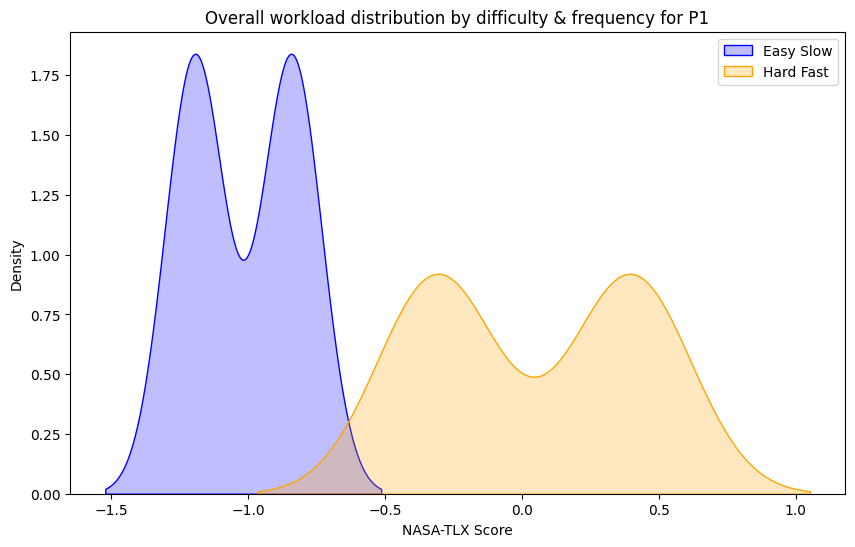

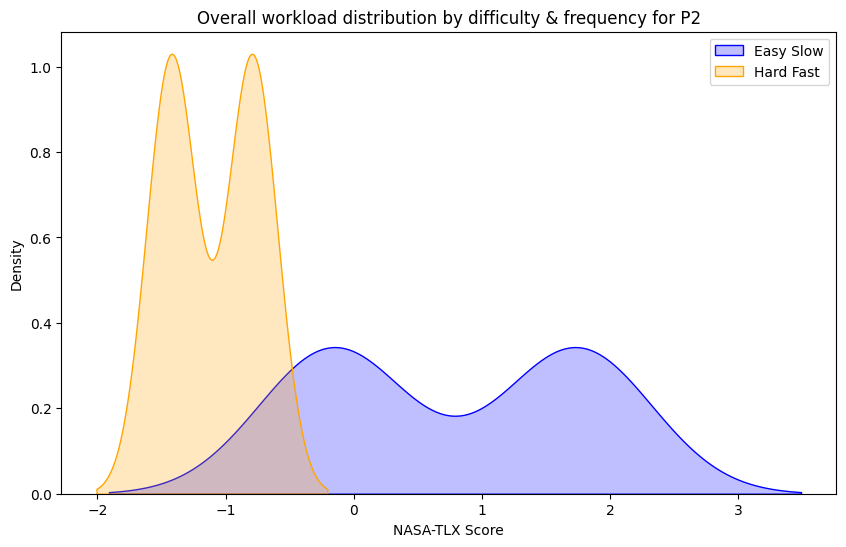

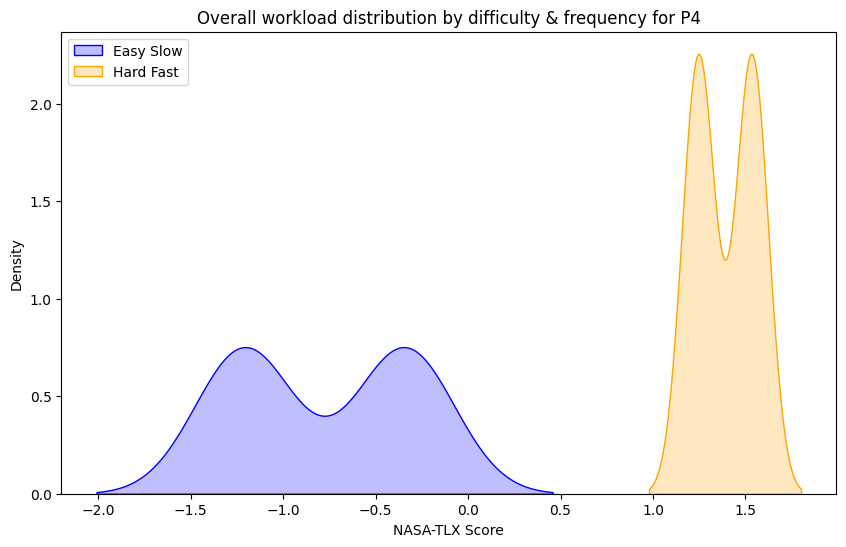

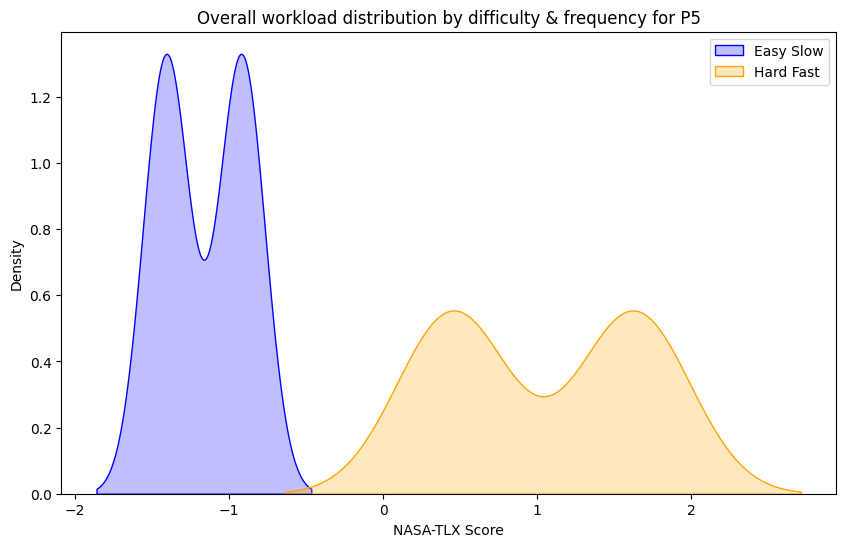

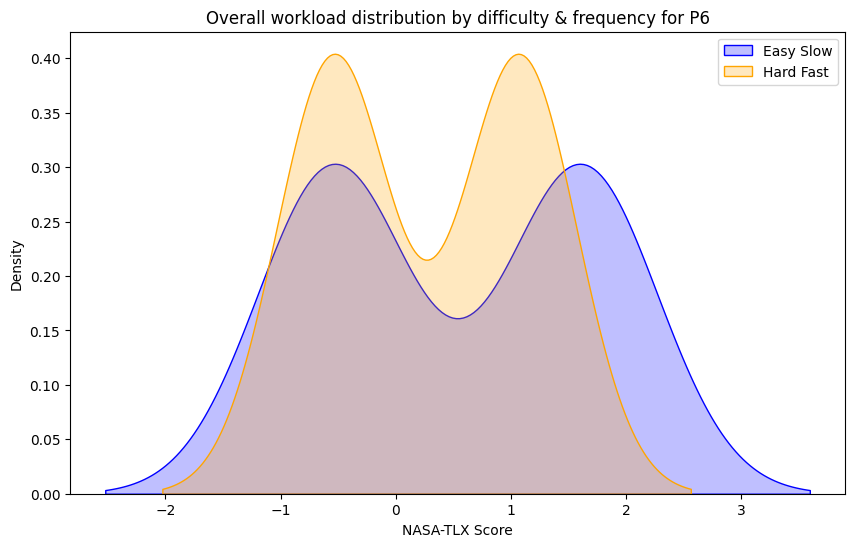

...

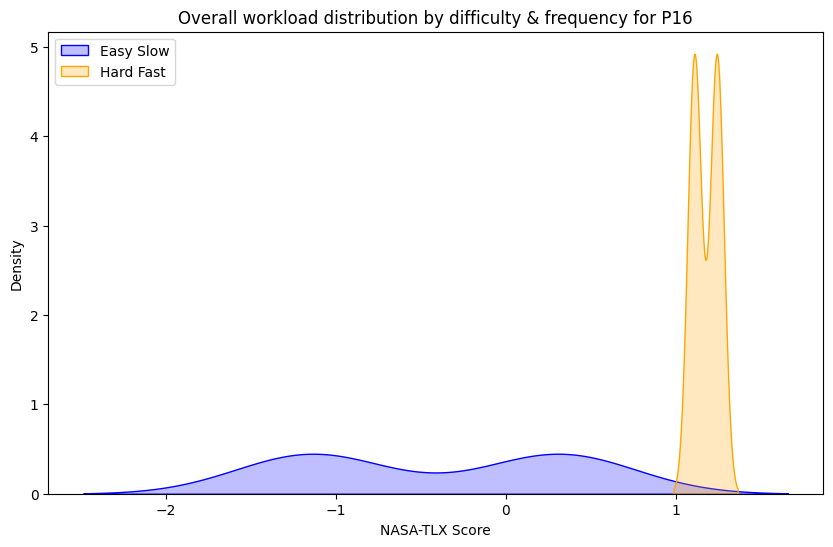

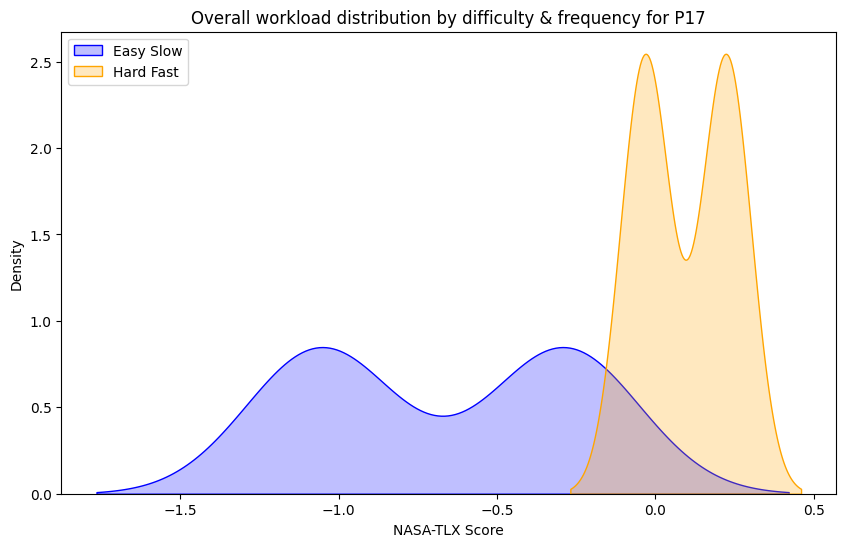

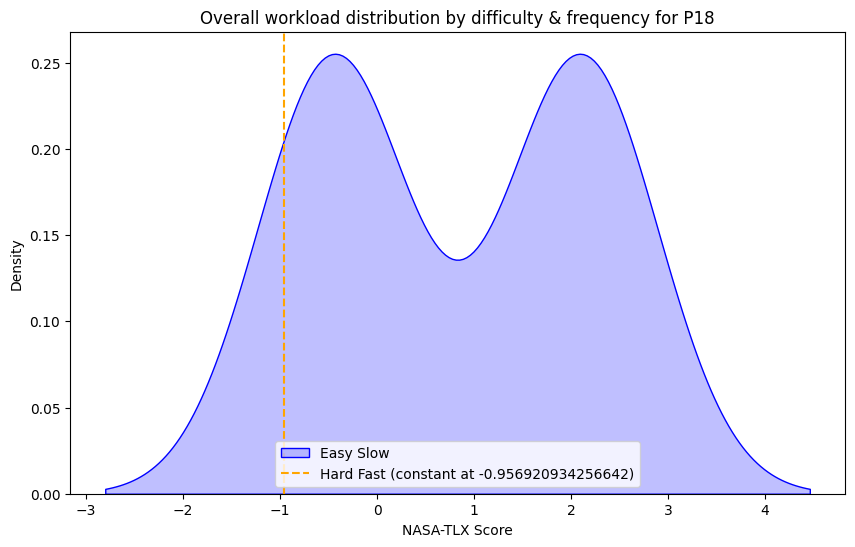

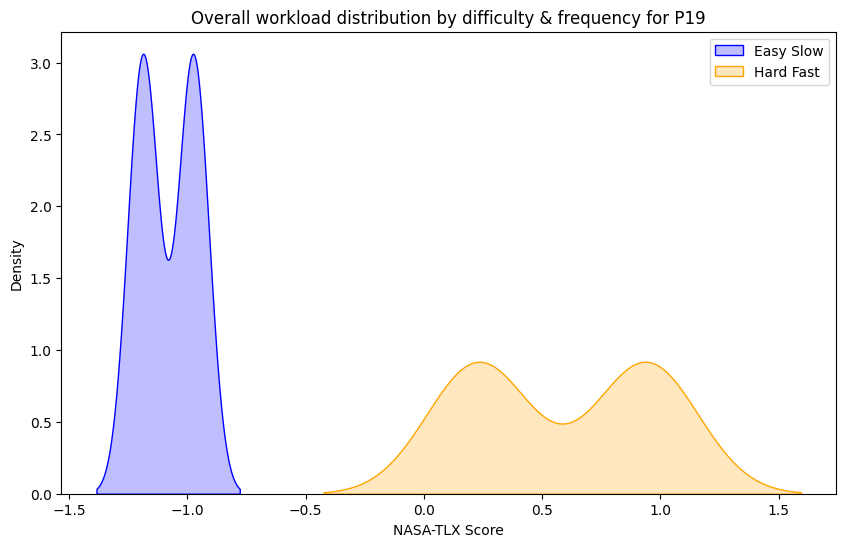

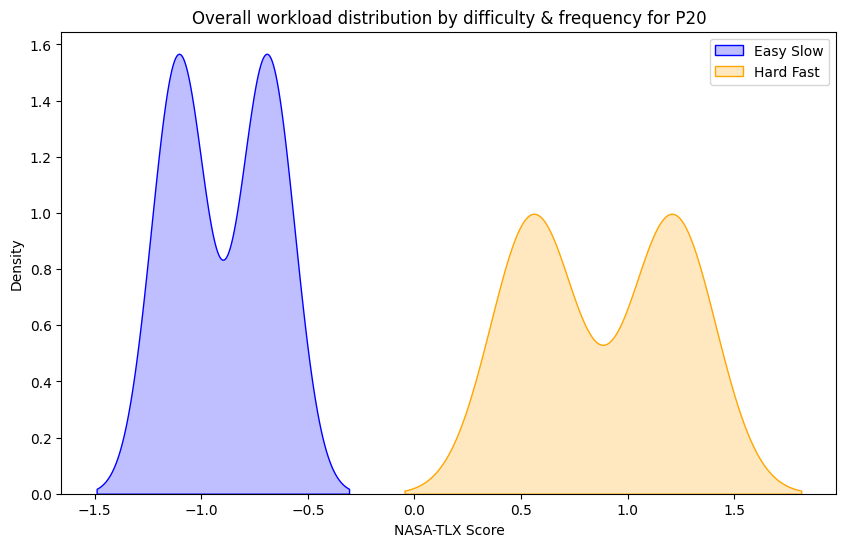

In [61]:
# Extreme conditions
for pid in participant_ids:
    p_df_easy_slow = df_easy_slow.query(f"participant_id == {pid}")
    p_df_hard_fast = df_hard_fast.query(f"participant_id == {pid}")

    plt.figure(figsize=(10, 6))

    # Check variance for Easy Slow condition
    if p_df_easy_slow['NASA_TLX_minmax_Score'].var() == 0:
        unique_value_easy_slow = p_df_easy_slow['NASA_TLX_minmax_Score'].iloc[0]
        plt.axvline(unique_value_easy_slow, color='blue', linestyle='--', label=f'Easy Slow (constant at {unique_value_easy_slow})')
    else:
        sns.kdeplot(p_df_easy_slow['NASA_TLX_minmax_Score'], color='blue', fill=True, label='Easy Slow', bw_adjust=0.5)
    
    # Check variance for Hard Fast condition
    if p_df_hard_fast['NASA_TLX_minmax_Score'].var() == 0:
        unique_value_hard_fast = p_df_hard_fast['NASA_TLX_minmax_Score'].iloc[0]
        plt.axvline(unique_value_hard_fast, color='orange', linestyle='--', label=f'Hard Fast (constant at {unique_value_hard_fast})')
    else:
        sns.kdeplot(p_df_hard_fast['NASA_TLX_minmax_Score'], color='orange', fill=True, label='Hard Fast', bw_adjust=0.5)

    plt.title(f'Overall workload distribution by difficulty & frequency for P{pid}')
    plt.xlabel('NASA-TLX Score')
    plt.ylabel('Density')
    plt.legend()
    plt.show()

##### Difficulty
- Generally positively related to workload
- Negatively related in 5 participant: P02, P06, P10, P13, P16, P17, P18

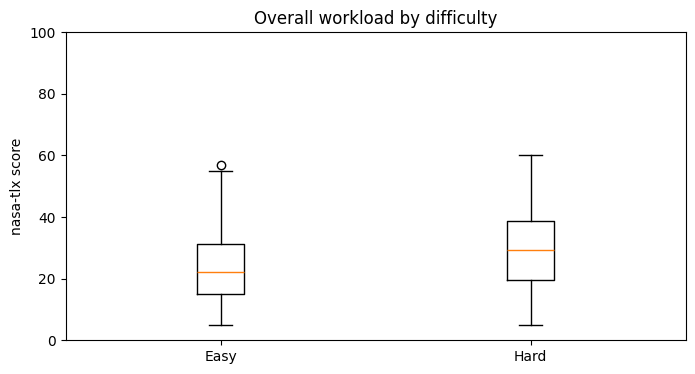

Easy: 24.15 (~12.94)
Hard: 28.98 (~13.13)


In [62]:
# Overall workload
mean_easy = round(np.mean(df_easy['NASA_TLX_Score']), 2)
mean_hard = round(np.mean(df_hard['NASA_TLX_Score']), 2)
std_easy = round(np.std(df_easy['NASA_TLX_Score']), 2)
std_hard = round(np.std(df_hard['NASA_TLX_Score']), 2)

plt.figure(figsize=(8, 4))
plt.boxplot([df_easy['NASA_TLX_Score'], df_hard['NASA_TLX_Score']], whis = 1.5)
plt.title(f'Overall workload by difficulty')
plt.xticks([1, 2], ['Easy', 'Hard'])
plt.ylabel('nasa-tlx score')
plt.ylim(0, 100)
plt.show()

print(f"Easy: {np.mean(mean_easy)} (~{std_easy})")
print(f"Hard: {np.mean(mean_hard)} (~{std_hard})")

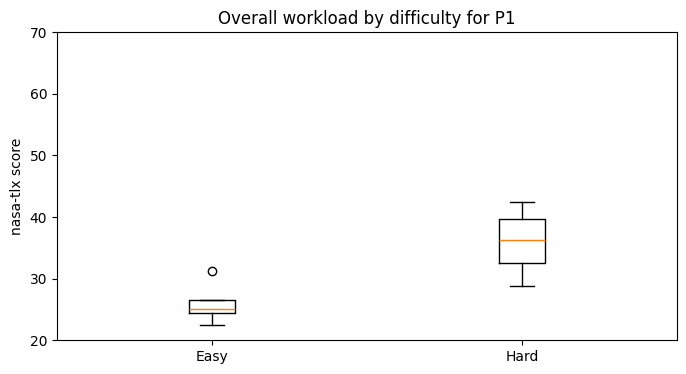

Easy: 25.94 (~3.23)
Hard: 35.94 (~5.18)


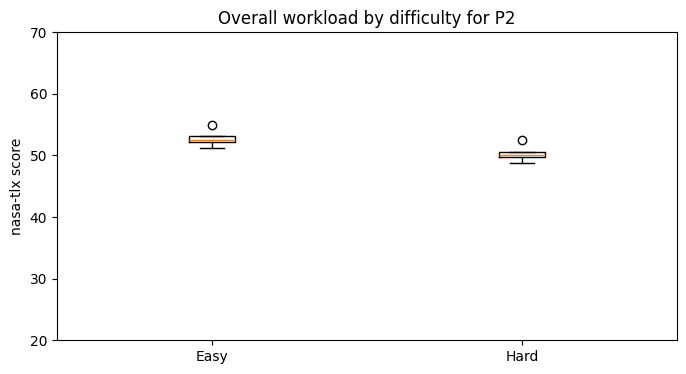

Easy: 52.81 (~1.36)
Hard: 50.31 (~1.36)


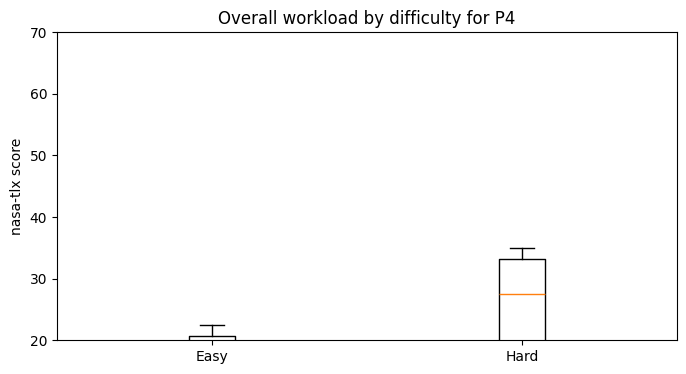

Easy: 18.12 (~4.19)
Hard: 25.31 (~9.37)


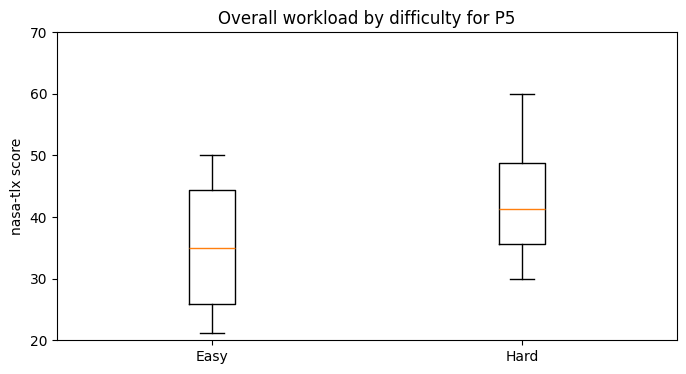

Easy: 35.31 (~11.47)
Hard: 43.12 (~11.09)


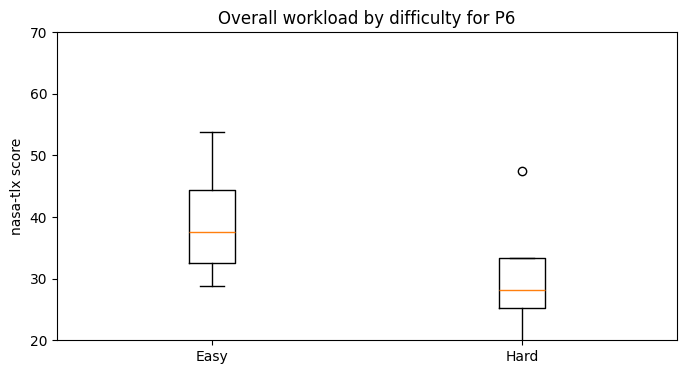

Easy: 39.38 (~9.42)
Hard: 30.62 (~10.48)


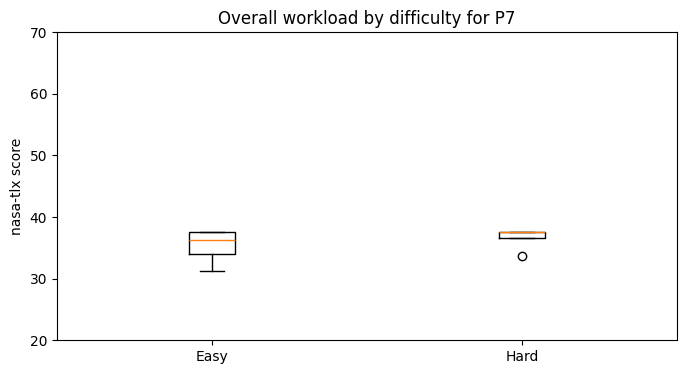

Easy: 35.31 (~2.56)
Hard: 36.56 (~1.62)


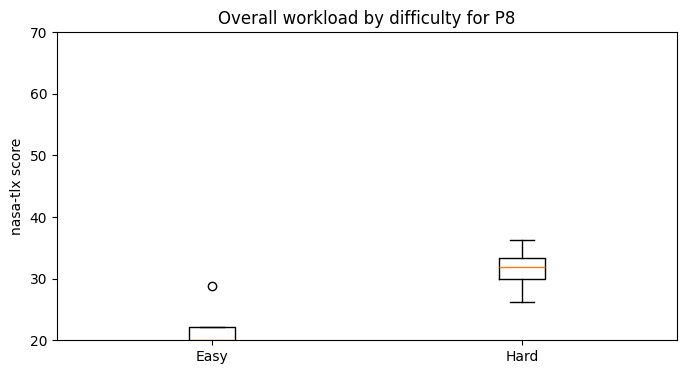

Easy: 20.94 (~4.95)
Hard: 31.56 (~3.58)


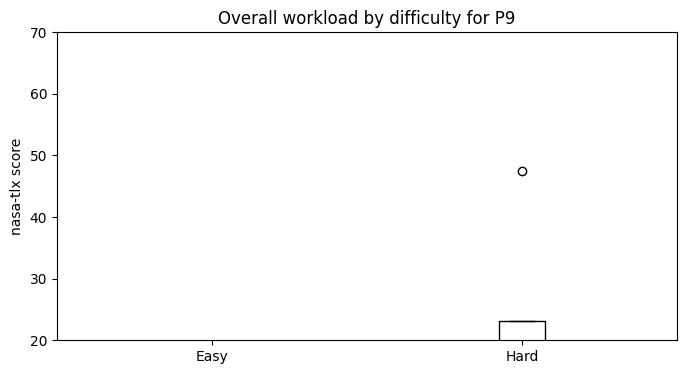

Easy: 15.0 (~3.85)
Hard: 21.25 (~15.33)


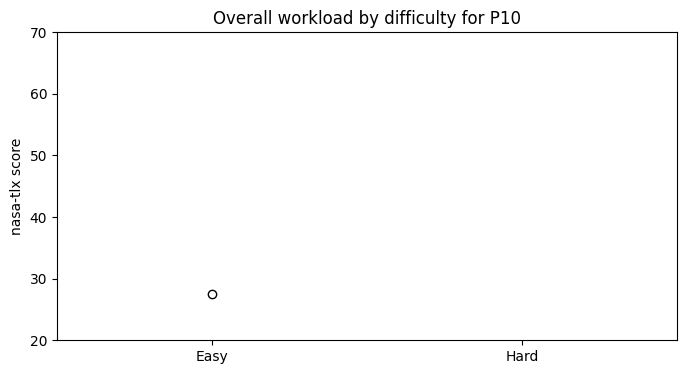

Easy: 11.25 (~9.4)
Hard: 6.56 (~1.04)


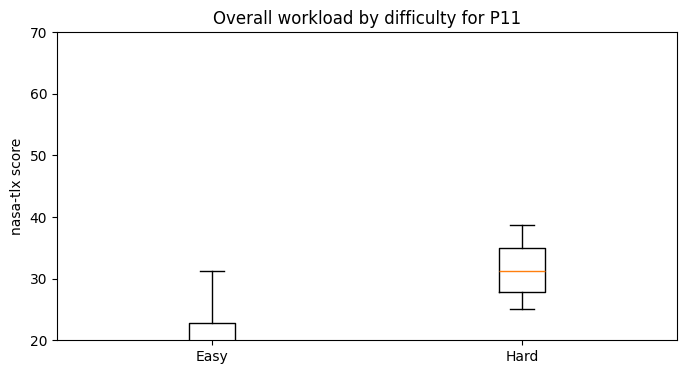

Easy: 21.25 (~5.93)
Hard: 31.56 (~5.18)


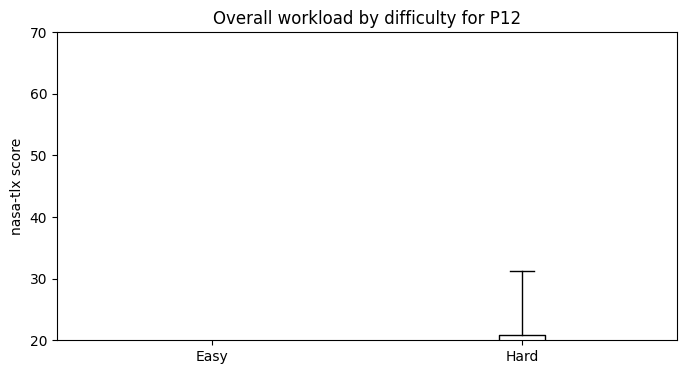

Easy: 14.38 (~4.38)
Hard: 18.75 (~7.45)


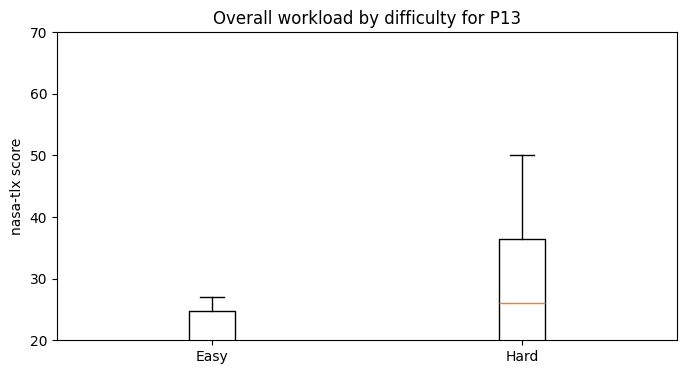

Easy: 19.0 (~6.67)
Hard: 30.0 (~12.73)


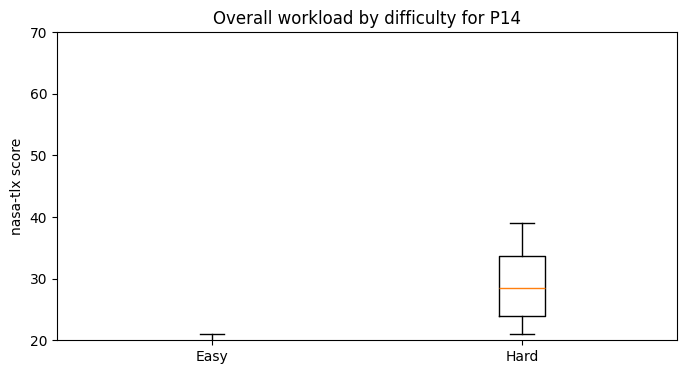

Easy: 14.5 (~4.15)
Hard: 29.25 (~6.87)


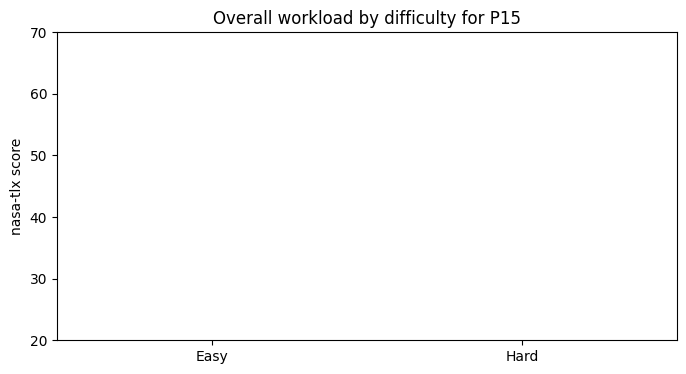

Easy: 10.5 (~1.5)
Hard: 11.0 (~2.74)


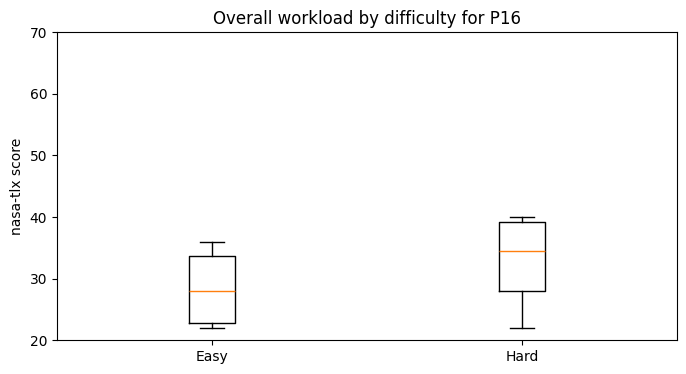

Easy: 28.5 (~6.1)
Hard: 32.75 (~7.33)


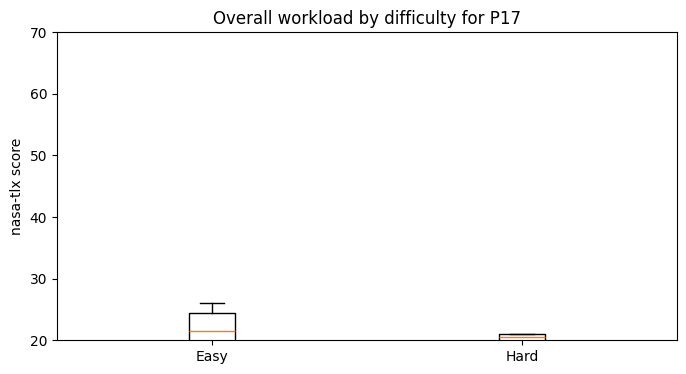

Easy: 21.25 (~3.96)
Hard: 19.0 (~2.92)


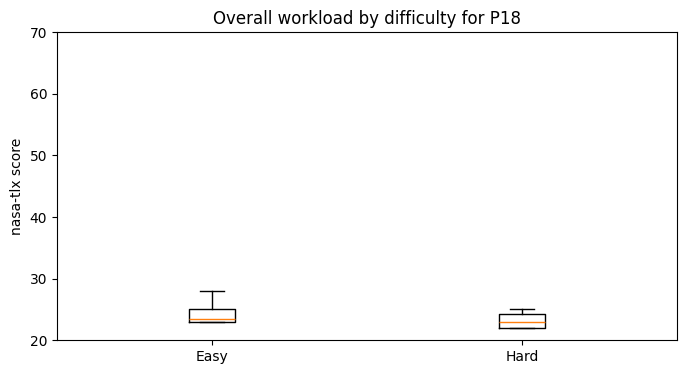

Easy: 24.5 (~2.06)
Hard: 23.25 (~1.3)


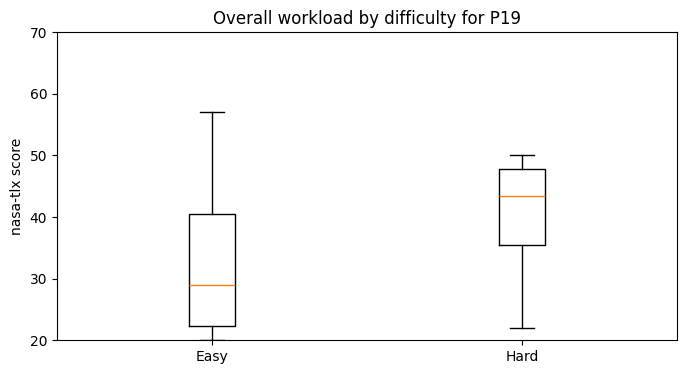

Easy: 33.75 (~14.55)
Hard: 39.75 (~10.87)


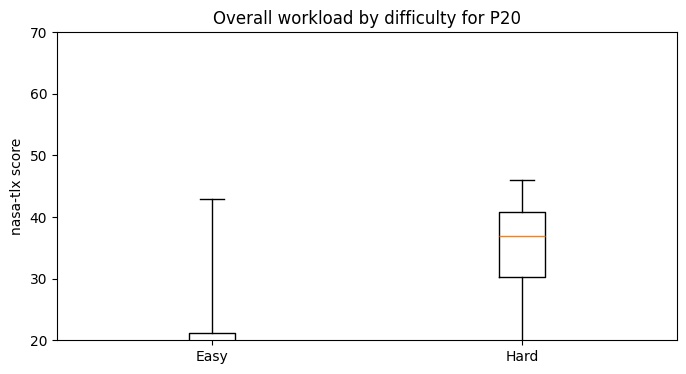

Easy: 17.25 (~15.24)
Hard: 34.0 (~11.11)


In [63]:
# Overall workload per participant
for pid in participant_ids:
    p_df_easy = df_easy.query(f"participant_id == {pid}")
    p_df_hard = df_hard.query(f"participant_id == {pid}")
    mean_easy = round(np.mean(p_df_easy['NASA_TLX_Score']), 2)
    mean_hard = round(np.mean(p_df_hard['NASA_TLX_Score']), 2)
    std_easy = round(np.std(p_df_easy['NASA_TLX_Score']), 2)
    std_hard = round(np.std(p_df_hard['NASA_TLX_Score']), 2)

    plt.figure(figsize=(8, 4))
    plt.boxplot([p_df_easy['NASA_TLX_Score'], p_df_hard['NASA_TLX_Score']], whis = 1.5)
    plt.title(f'Overall workload by difficulty for P{pid}')
    plt.xticks([1, 2], ['Easy', 'Hard'])
    plt.ylabel('nasa-tlx score')
    plt.ylim(20, 70)
    plt.show()

    print(f"Easy: {np.mean(mean_easy)} (~{std_easy})")
    print(f"Hard: {np.mean(mean_hard)} (~{std_hard})")

##### Frequency
- Generally positively related to workload
- Negatively related in 5 participants: P02, P06, P13, P15, P18

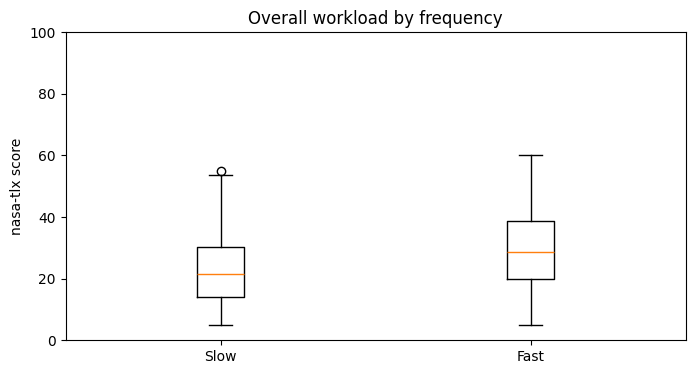

slow: 23.6 (~12.46)
Fast: 29.53 (~13.37)


In [64]:
# Overall workload
mean_slow = round(np.mean(df_slow['NASA_TLX_Score']), 2)
mean_fast = round(np.mean(df_fast['NASA_TLX_Score']), 2)
std_slow = round(np.std(df_slow['NASA_TLX_Score']), 2)
std_fast = round(np.std(df_fast['NASA_TLX_Score']), 2)

plt.figure(figsize=(8, 4))
plt.boxplot([df_slow['NASA_TLX_Score'], df_fast['NASA_TLX_Score']], whis = 1.5)
plt.title(f'Overall workload by frequency')
plt.xticks([1, 2], ['Slow', 'Fast'])
plt.ylabel('nasa-tlx score')
plt.ylim(0, 100)
plt.show()

print(f"slow: {np.mean(mean_slow)} (~{std_slow})")
print(f"Fast: {np.mean(mean_fast)} (~{std_fast})")

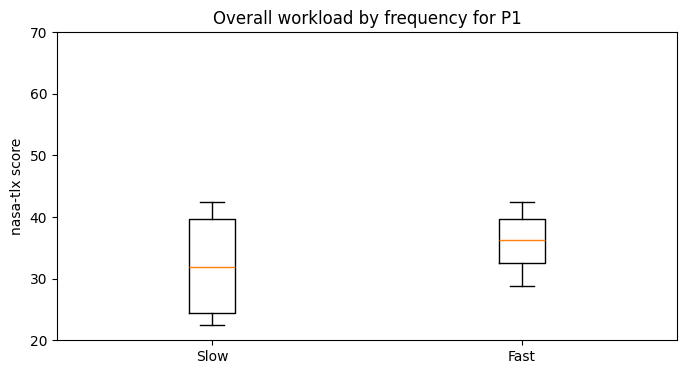

Easy: 32.19 (~8.59)
Hard: 35.94 (~5.18)


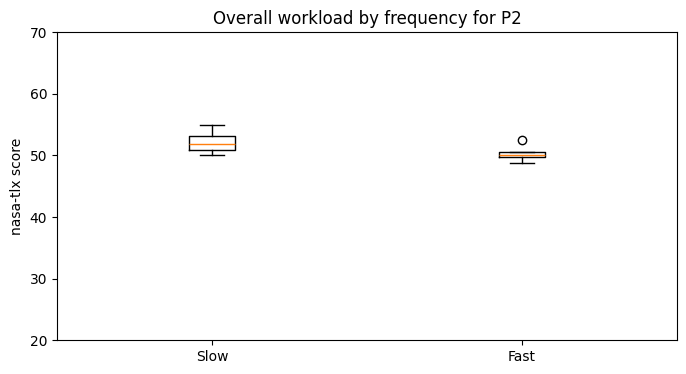

Easy: 52.19 (~1.85)
Hard: 50.31 (~1.36)


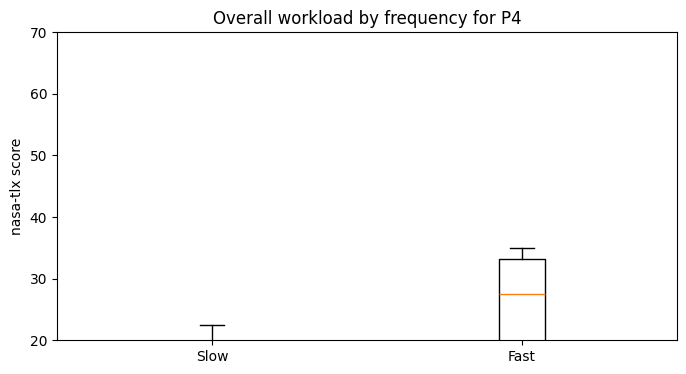

Easy: 15.94 (~4.87)
Hard: 25.31 (~9.37)


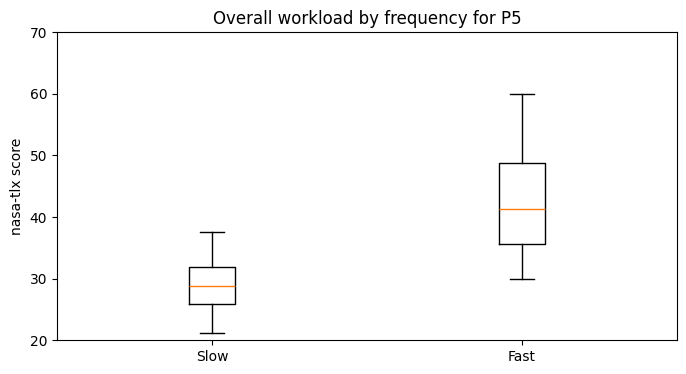

Easy: 29.06 (~5.82)
Hard: 43.12 (~11.09)


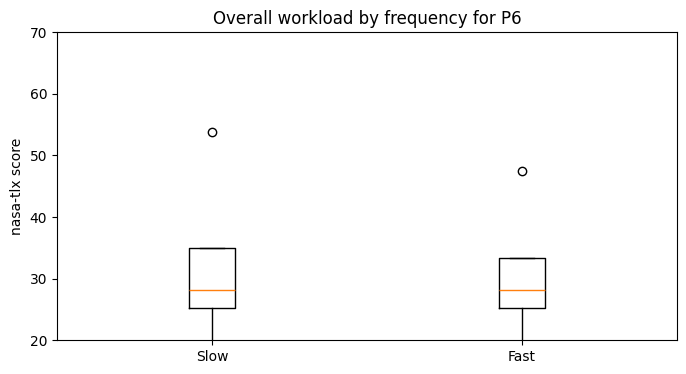

Easy: 32.19 (~13.03)
Hard: 30.62 (~10.48)


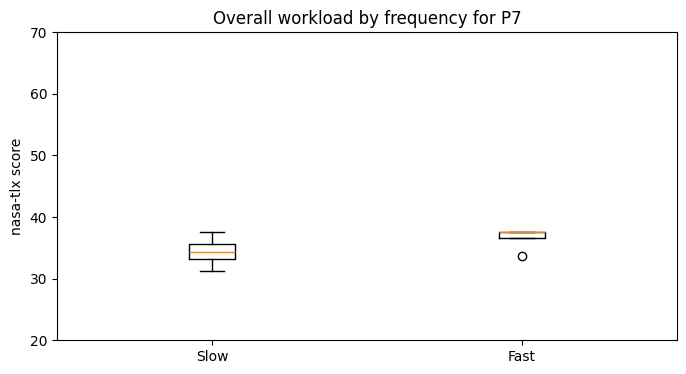

Easy: 34.38 (~2.25)
Hard: 36.56 (~1.62)


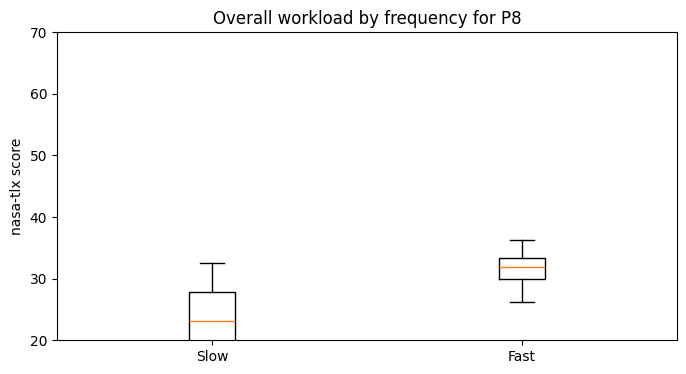

Easy: 23.44 (~6.58)
Hard: 31.56 (~3.58)


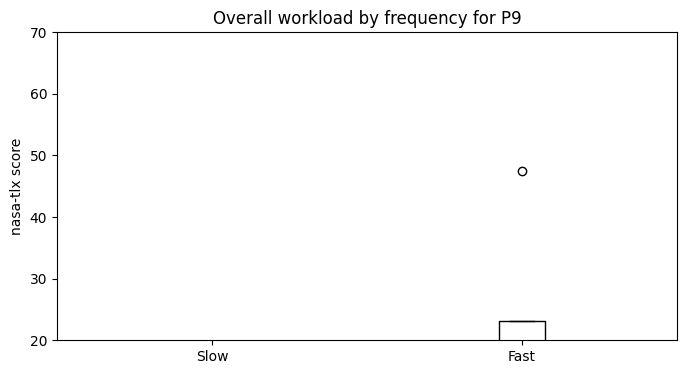

Easy: 13.75 (~3.19)
Hard: 21.25 (~15.33)


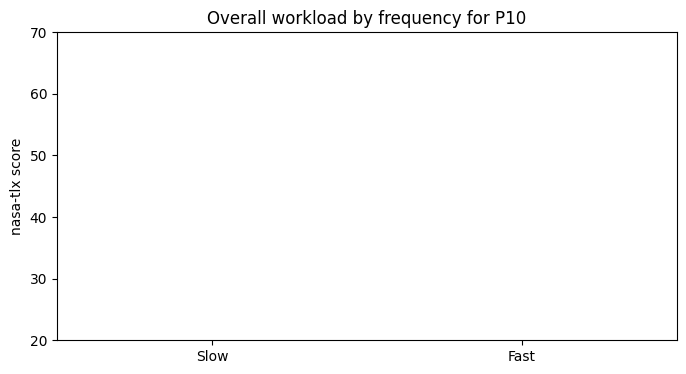

Easy: 6.25 (~0.88)
Hard: 6.56 (~1.04)


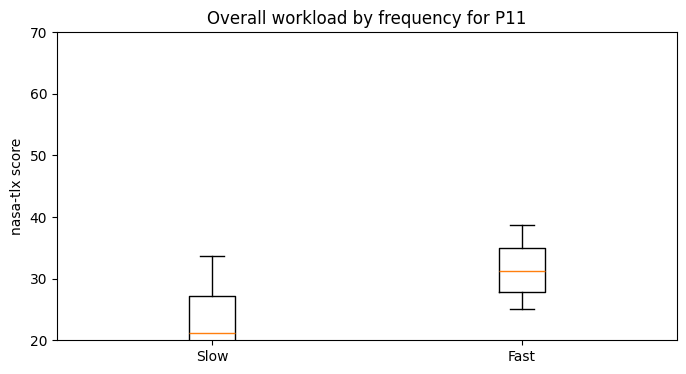

Easy: 23.12 (~6.99)
Hard: 31.56 (~5.18)


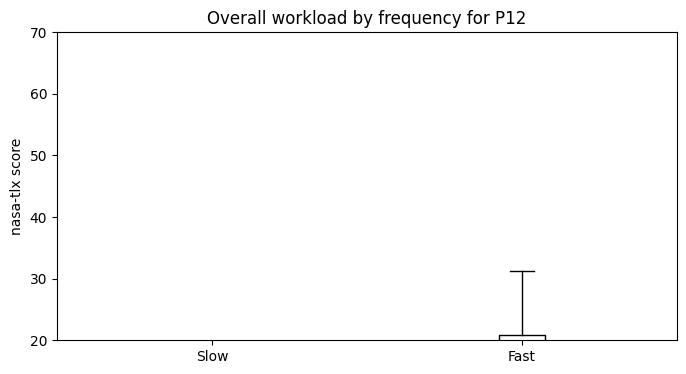

Easy: 13.12 (~3.59)
Hard: 18.75 (~7.45)


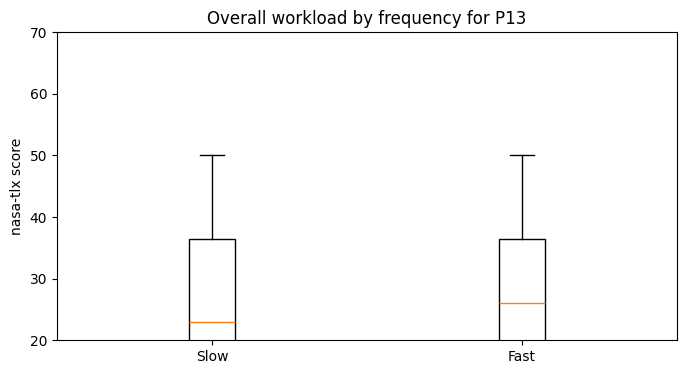

Easy: 26.75 (~15.64)
Hard: 30.0 (~12.73)


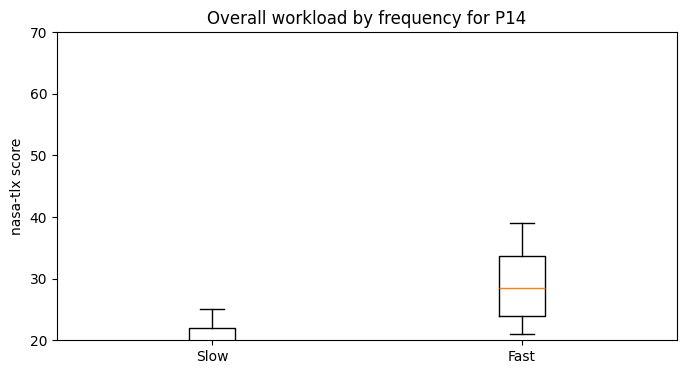

Easy: 17.0 (~6.2)
Hard: 29.25 (~6.87)


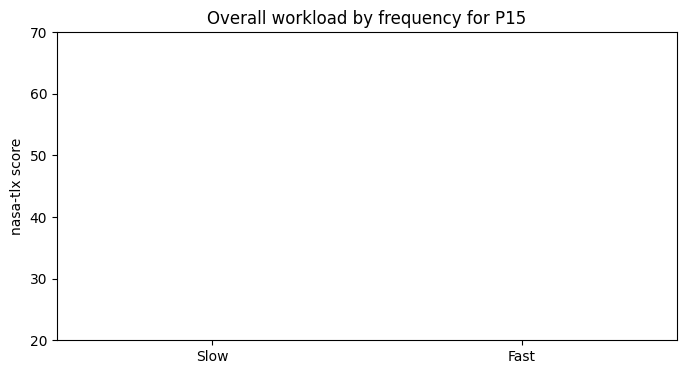

Easy: 12.75 (~1.3)
Hard: 11.0 (~2.74)


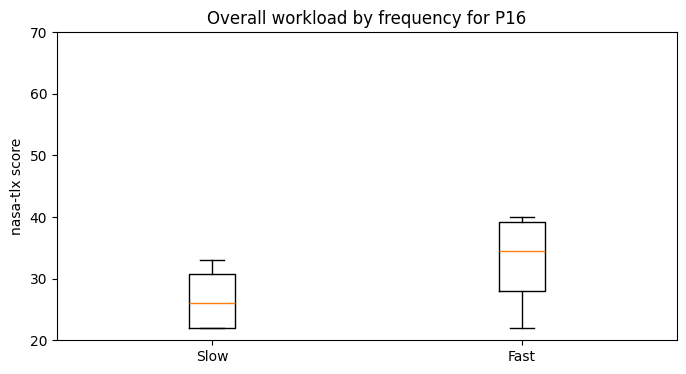

Easy: 26.75 (~4.87)
Hard: 32.75 (~7.33)


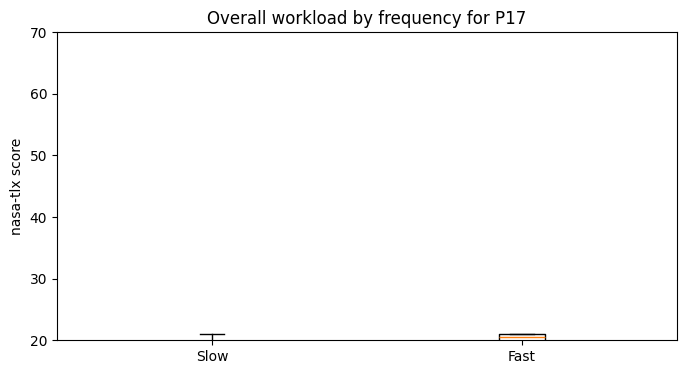

Easy: 17.5 (~2.69)
Hard: 19.0 (~2.92)


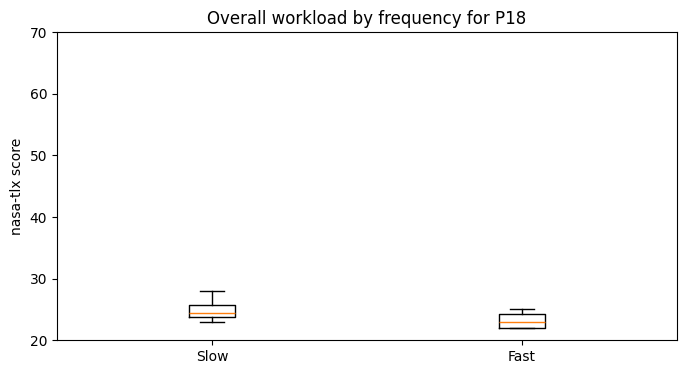

Easy: 25.0 (~1.87)
Hard: 23.25 (~1.3)


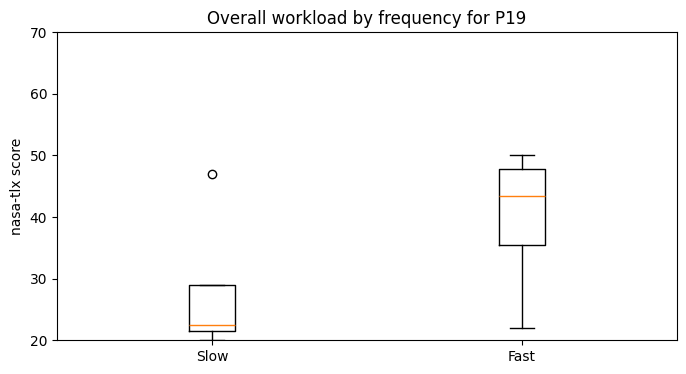

Easy: 28.0 (~11.02)
Hard: 39.75 (~10.87)


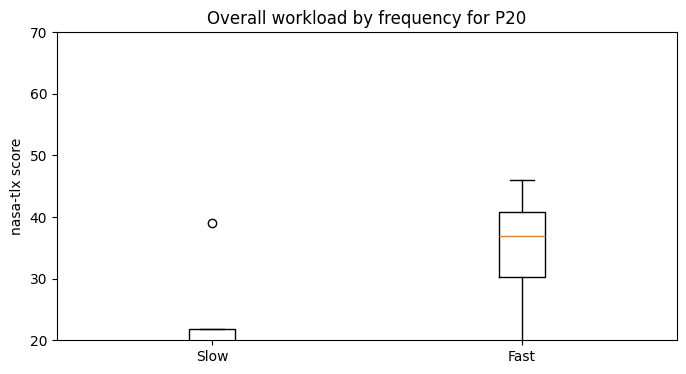

Easy: 19.0 (~12.02)
Hard: 34.0 (~11.11)


In [65]:
# Overall workload per participant
for pid in participant_ids:
    p_df_slow = df_slow.query(f"participant_id == {pid}")
    p_df_fast = df_hard.query(f"participant_id == {pid}")
    mean_slow = round(np.mean(p_df_slow['NASA_TLX_Score']), 2)
    mean_fast = round(np.mean(p_df_fast['NASA_TLX_Score']), 2)
    std_slow = round(np.std(p_df_slow['NASA_TLX_Score']), 2)
    std_fast = round(np.std(p_df_fast['NASA_TLX_Score']), 2)

    plt.figure(figsize=(8, 4))
    plt.boxplot([p_df_slow['NASA_TLX_Score'], p_df_fast['NASA_TLX_Score']], whis = 1.5)
    plt.title(f'Overall workload by frequency for P{pid}')
    plt.xticks([1, 2], ['Slow', 'Fast'])
    plt.ylabel('nasa-tlx score')
    plt.ylim(20, 70)
    plt.show()

    print(f"Easy: {np.mean(mean_slow)} (~{std_slow})")
    print(f"Hard: {np.mean(mean_fast)} (~{std_fast})")

##### Difficulty & Frequency
- Generally larger difference is due to frequency
- P13 has a weird lower workload for hard-fast condition

In [12]:
# Define dfs
df_easy = df_dim[df_dim['block_type'].isin(easy_block)]
df_hard = df_dim[df_dim['block_type'].isin(hard_block)]

df_slow = df_dim[df_dim['block_type'].isin(slow_block)]
df_fast = df_dim[df_dim['block_type'].isin(fast_block)]

df_easy_slow = df_dim[df_dim['block_type'].isin(easy_slow_block)]
df_easy_fast = df_dim[df_dim['block_type'].isin(easy_fast_block)]
df_hard_slow = df_dim[df_dim['block_type'].isin(hard_slow_block)]
df_hard_fast = df_dim[df_dim['block_type'].isin(hard_fast_block)]

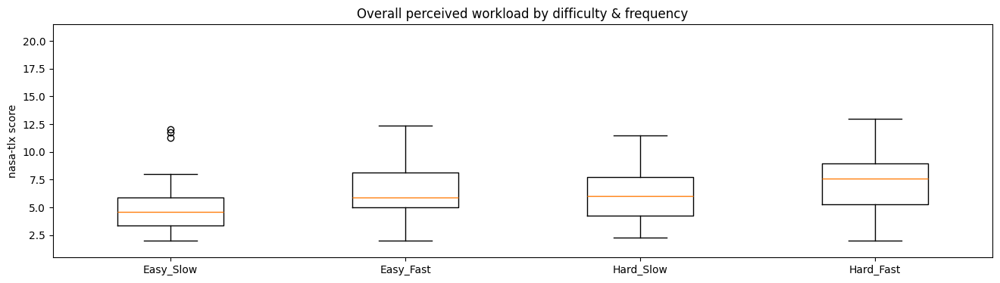

Easy_Slow: 5.13 (~2.43)
Easy_Fast: 6.53 (~2.56)
Hard_Slow: 6.31 (~2.42)
Hard_Fast: 7.28 (~2.74)


In [15]:
# Overall workload
mean_easy_slow = round(np.mean(df_easy_slow['NASA_TLX_Score']), 2)
mean_easy_fast = round(np.mean(df_easy_fast['NASA_TLX_Score']), 2)
std_easy_slow = round(np.std(df_easy_slow['NASA_TLX_Score']), 2)
std_easy_fast = round(np.std(df_easy_fast['NASA_TLX_Score']), 2)
mean_hard_slow = round(np.mean(df_hard_slow['NASA_TLX_Score']), 2)
mean_hard_fast = round(np.mean(df_hard_fast['NASA_TLX_Score']), 2)
std_hard_slow = round(np.std(df_hard_slow['NASA_TLX_Score']), 2)
std_hard_fast = round(np.std(df_hard_fast['NASA_TLX_Score']), 2)

plt.figure(figsize=(16, 4))
plt.boxplot([df_easy_slow['NASA_TLX_Score'], df_easy_fast['NASA_TLX_Score'], df_hard_slow['NASA_TLX_Score'], df_hard_fast['NASA_TLX_Score']], whis = 1.5)
plt.title(f'Overall perceived workload by difficulty & frequency')
plt.xticks([1, 2, 3, 4], ['Easy_Slow', 'Easy_Fast', 'Hard_Slow', 'Hard_Fast'])
plt.ylabel('nasa-tlx score')
plt.ylim(0.5, 21.5)
plt.show()

print(f"Easy_Slow: {np.mean(mean_easy_slow)} (~{std_easy_slow})")
print(f"Easy_Fast: {np.mean(mean_easy_fast)} (~{std_easy_fast})")
print(f"Hard_Slow: {np.mean(mean_hard_slow)} (~{std_hard_slow})")
print(f"Hard_Fast: {np.mean(mean_hard_fast)} (~{std_hard_fast})")

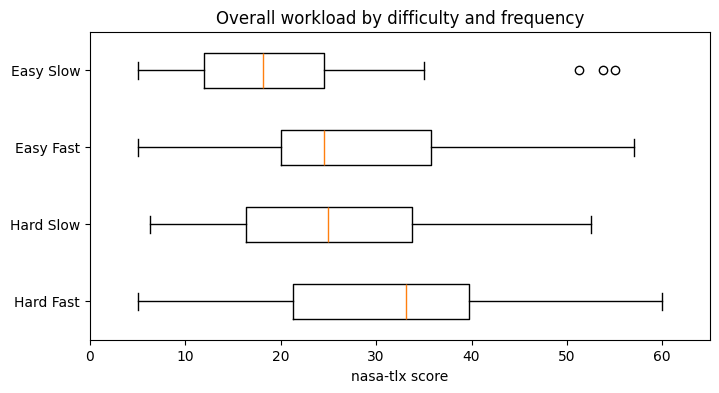

Easy_Slow: 20.65 (~12.13)
Easy_Fast: 27.66 (~12.78)
Hard_Slow: 26.55 (~12.08)
Hard_Fast: 31.41 (~13.68)


In [67]:
# Overall workload
mean_easy_slow = round(np.mean(df_easy_slow['NASA_TLX_Score']), 2)
mean_easy_fast = round(np.mean(df_easy_fast['NASA_TLX_Score']), 2)
std_easy_slow = round(np.std(df_easy_slow['NASA_TLX_Score']), 2)
std_easy_fast = round(np.std(df_easy_fast['NASA_TLX_Score']), 2)
mean_hard_slow = round(np.mean(df_hard_slow['NASA_TLX_Score']), 2)
mean_hard_fast = round(np.mean(df_hard_fast['NASA_TLX_Score']), 2)
std_hard_slow = round(np.std(df_hard_slow['NASA_TLX_Score']), 2)
std_hard_fast = round(np.std(df_hard_fast['NASA_TLX_Score']), 2)

plt.figure(figsize=(8, 4))
plt.boxplot([df_hard_fast['NASA_TLX_Score'], df_hard_slow['NASA_TLX_Score'], df_easy_fast['NASA_TLX_Score'], df_easy_slow['NASA_TLX_Score']], whis = 1.5, vert=False)
plt.title(f'Overall workload by difficulty and frequency')
plt.yticks([1, 2, 3, 4], ['Hard Fast', 'Hard Slow', 'Easy Fast', 'Easy Slow'])
plt.xlabel('nasa-tlx score')
plt.xlim(0, 65)
plt.show()

print(f"Easy_Slow: {np.mean(mean_easy_slow)} (~{std_easy_slow})")
print(f"Easy_Fast: {np.mean(mean_easy_fast)} (~{std_easy_fast})")
print(f"Hard_Slow: {np.mean(mean_hard_slow)} (~{std_hard_slow})")
print(f"Hard_Fast: {np.mean(mean_hard_fast)} (~{std_hard_fast})")

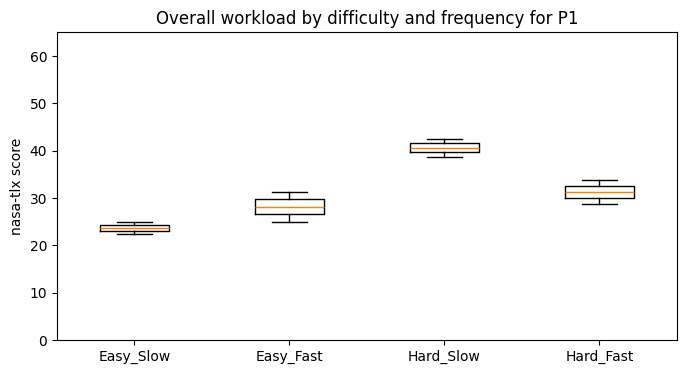

Easy_Slow: 23.75 (~1.25)
Easy_Fast: 28.12 (~3.12)
Hard_Slow: 40.62 (~1.88)
Hard_Fast: 31.25 (~2.5)


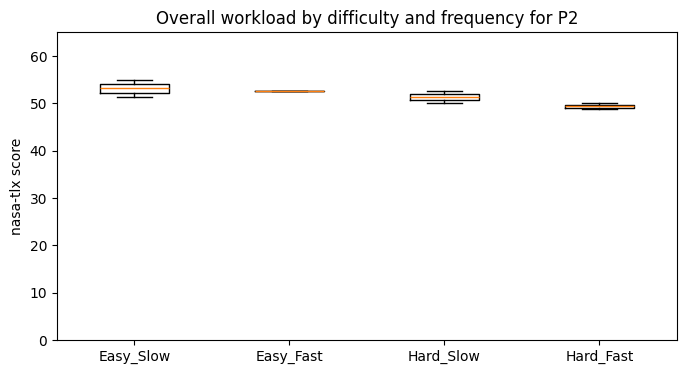

Easy_Slow: 53.12 (~1.88)
Easy_Fast: 52.5 (~0.0)
Hard_Slow: 51.25 (~1.25)
Hard_Fast: 49.38 (~0.62)


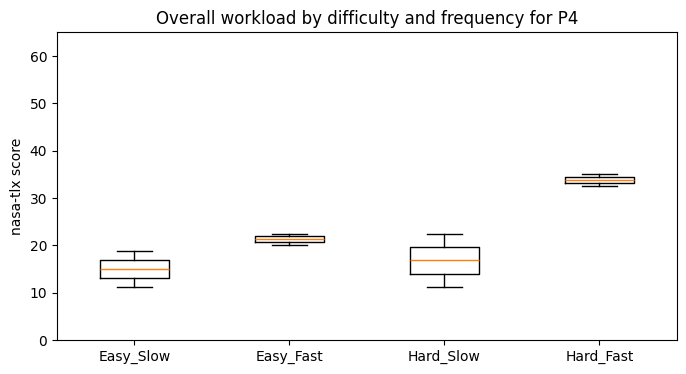

Easy_Slow: 15.0 (~3.75)
Easy_Fast: 21.25 (~1.25)
Hard_Slow: 16.88 (~5.62)
Hard_Fast: 33.75 (~1.25)


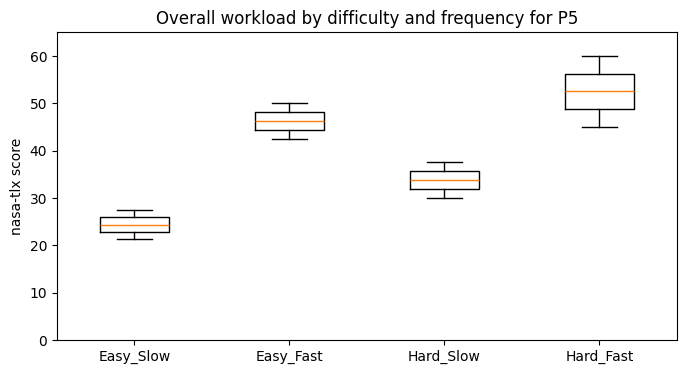

Easy_Slow: 24.38 (~3.12)
Easy_Fast: 46.25 (~3.75)
Hard_Slow: 33.75 (~3.75)
Hard_Fast: 52.5 (~7.5)


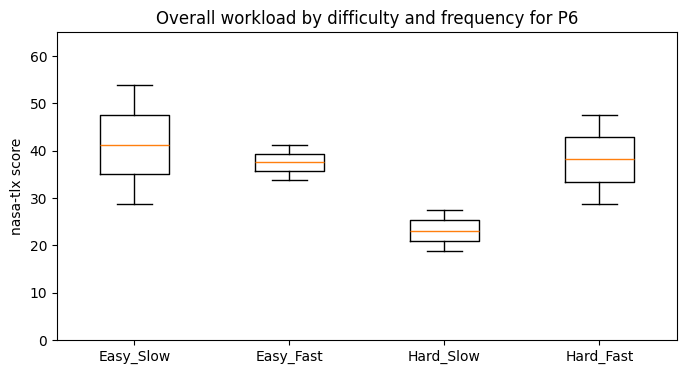

Easy_Slow: 41.25 (~12.5)
Easy_Fast: 37.5 (~3.75)
Hard_Slow: 23.12 (~4.38)
Hard_Fast: 38.12 (~9.38)


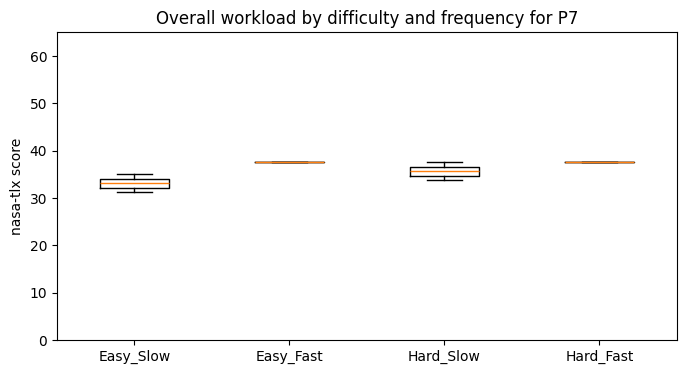

Easy_Slow: 33.12 (~1.88)
Easy_Fast: 37.5 (~0.0)
Hard_Slow: 35.62 (~1.88)
Hard_Fast: 37.5 (~0.0)


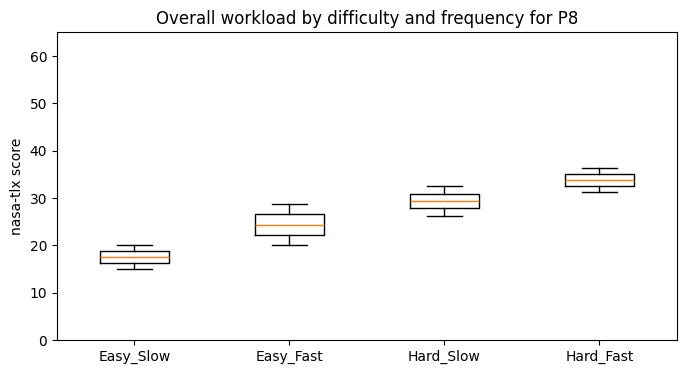

Easy_Slow: 17.5 (~2.5)
Easy_Fast: 24.38 (~4.38)
Hard_Slow: 29.38 (~3.12)
Hard_Fast: 33.75 (~2.5)


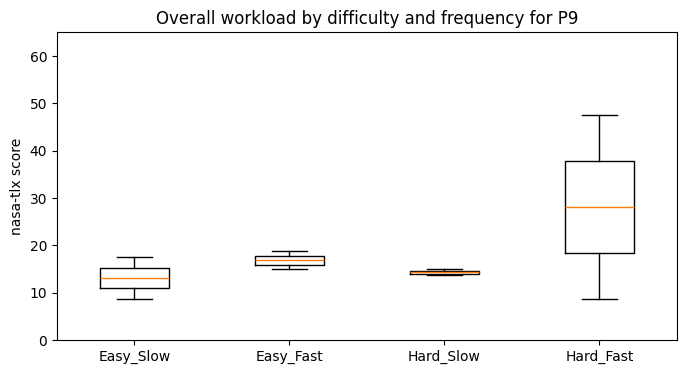

Easy_Slow: 13.12 (~4.38)
Easy_Fast: 16.88 (~1.88)
Hard_Slow: 14.38 (~0.62)
Hard_Fast: 28.12 (~19.38)


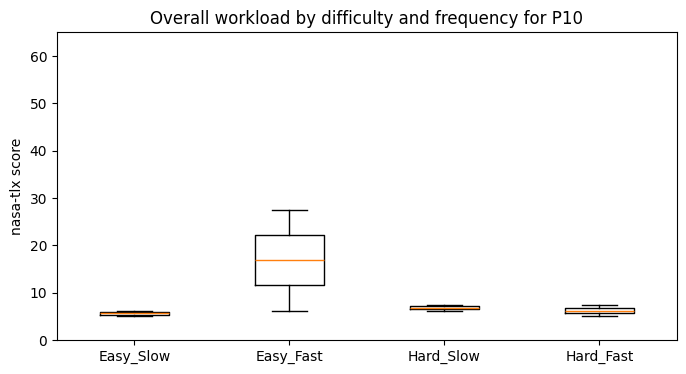

Easy_Slow: 5.62 (~0.62)
Easy_Fast: 16.88 (~10.62)
Hard_Slow: 6.88 (~0.62)
Hard_Fast: 6.25 (~1.25)


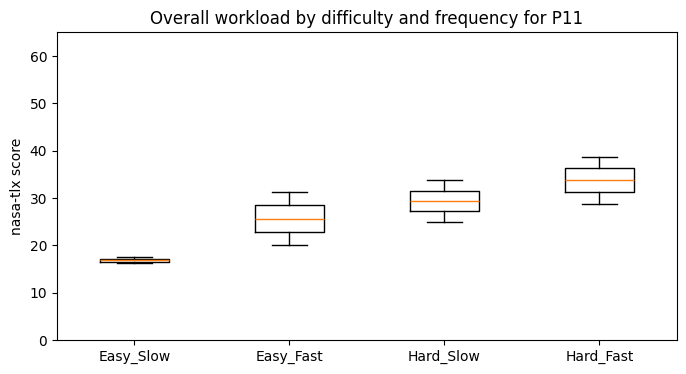

Easy_Slow: 16.88 (~0.62)
Easy_Fast: 25.62 (~5.62)
Hard_Slow: 29.38 (~4.38)
Hard_Fast: 33.75 (~5.0)


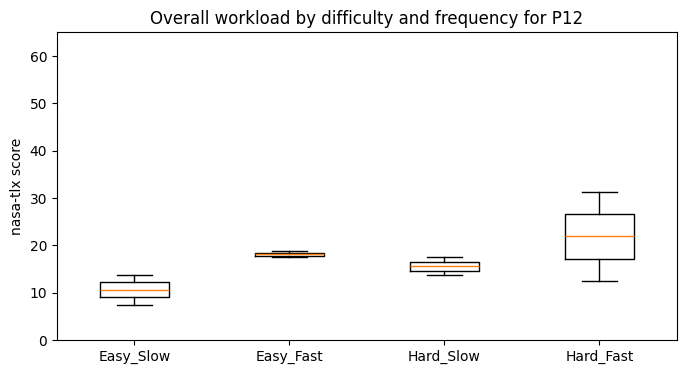

Easy_Slow: 10.62 (~3.12)
Easy_Fast: 18.12 (~0.62)
Hard_Slow: 15.62 (~1.88)
Hard_Fast: 21.88 (~9.38)


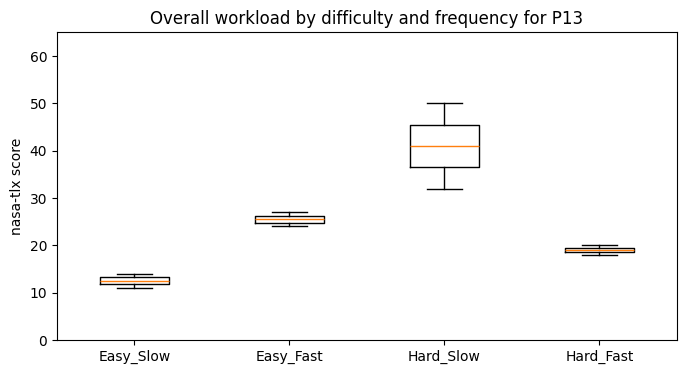

Easy_Slow: 12.5 (~1.5)
Easy_Fast: 25.5 (~1.5)
Hard_Slow: 41.0 (~9.0)
Hard_Fast: 19.0 (~1.0)


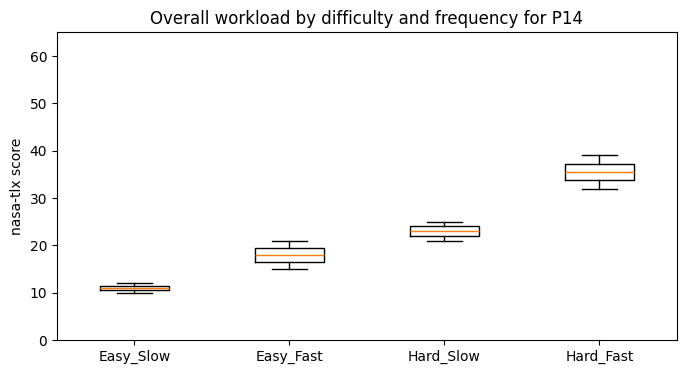

Easy_Slow: 11.0 (~1.0)
Easy_Fast: 18.0 (~3.0)
Hard_Slow: 23.0 (~2.0)
Hard_Fast: 35.5 (~3.5)


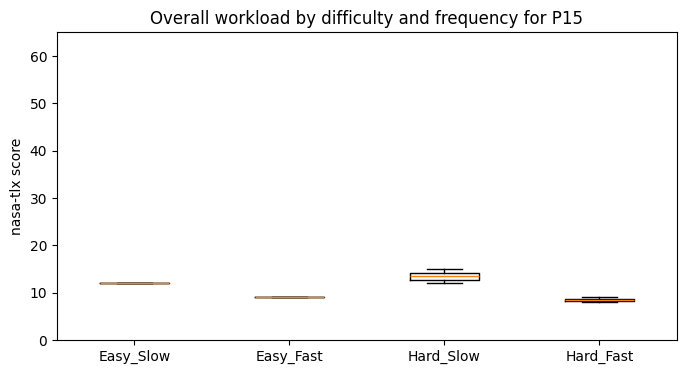

Easy_Slow: 12.0 (~0.0)
Easy_Fast: 9.0 (~0.0)
Hard_Slow: 13.5 (~1.5)
Hard_Fast: 8.5 (~0.5)


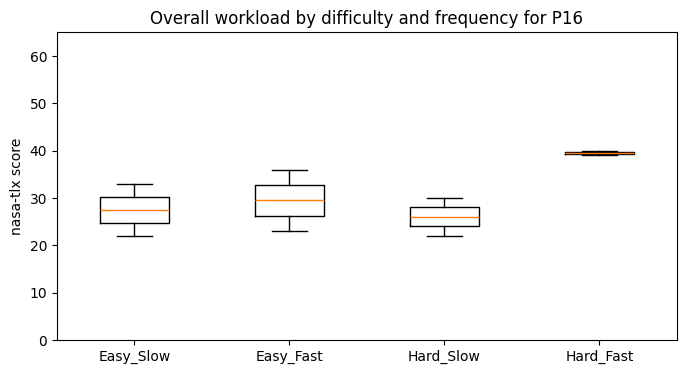

Easy_Slow: 27.5 (~5.5)
Easy_Fast: 29.5 (~6.5)
Hard_Slow: 26.0 (~4.0)
Hard_Fast: 39.5 (~0.5)


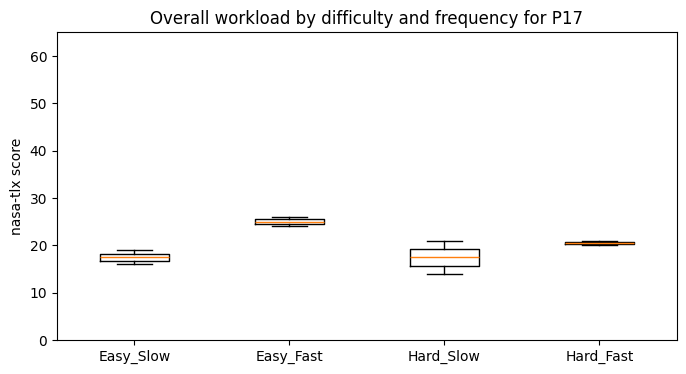

Easy_Slow: 17.5 (~1.5)
Easy_Fast: 25.0 (~1.0)
Hard_Slow: 17.5 (~3.5)
Hard_Fast: 20.5 (~0.5)


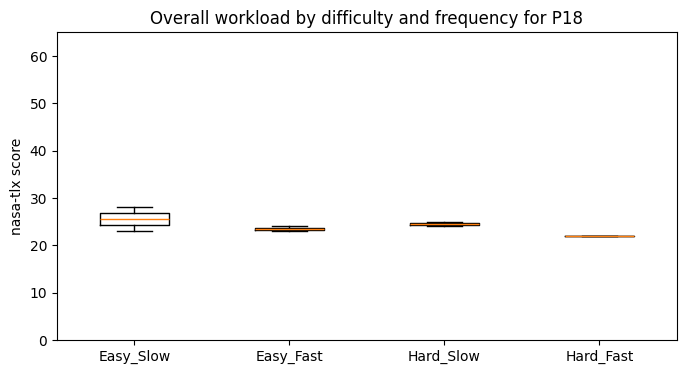

Easy_Slow: 25.5 (~2.5)
Easy_Fast: 23.5 (~0.5)
Hard_Slow: 24.5 (~0.5)
Hard_Fast: 22.0 (~0.0)


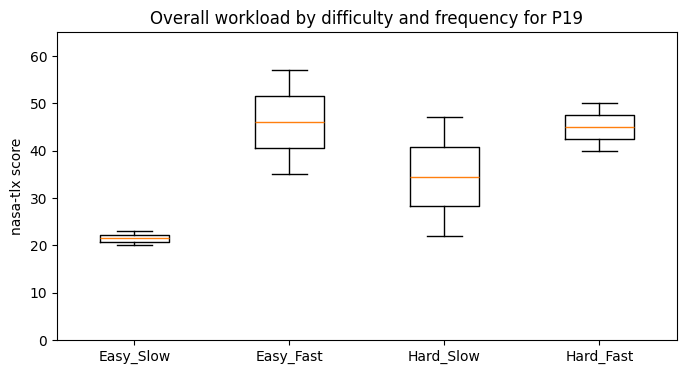

Easy_Slow: 21.5 (~1.5)
Easy_Fast: 46.0 (~11.0)
Hard_Slow: 34.5 (~12.5)
Hard_Fast: 45.0 (~5.0)


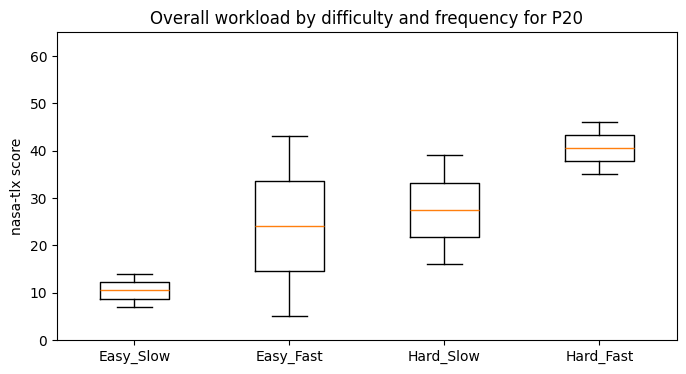

Easy_Slow: 10.5 (~3.5)
Easy_Fast: 24.0 (~19.0)
Hard_Slow: 27.5 (~11.5)
Hard_Fast: 40.5 (~5.5)


In [68]:
# Overall workload per participant
for pid in participant_ids:
    p_df_easy_slow = df_easy_slow.query(f"participant_id == {pid}")
    p_df_easy_fast = df_easy_fast.query(f"participant_id == {pid}")
    p_df_hard_slow = df_hard_slow.query(f"participant_id == {pid}")
    p_df_hard_fast = df_hard_fast.query(f"participant_id == {pid}")

    mean_easy_slow = round(np.mean(p_df_easy_slow['NASA_TLX_Score']), 2)
    mean_easy_fast = round(np.mean(p_df_easy_fast['NASA_TLX_Score']), 2)
    std_easy_slow = round(np.std(p_df_easy_slow['NASA_TLX_Score']), 2)
    std_easy_fast = round(np.std(p_df_easy_fast['NASA_TLX_Score']), 2)
    mean_hard_slow = round(np.mean(p_df_hard_slow['NASA_TLX_Score']), 2)
    mean_hard_fast = round(np.mean(p_df_hard_fast['NASA_TLX_Score']), 2)
    std_hard_slow = round(np.std(p_df_hard_slow['NASA_TLX_Score']), 2)
    std_hard_fast = round(np.std(p_df_hard_fast['NASA_TLX_Score']), 2)

    plt.figure(figsize=(8, 4))
    plt.boxplot([p_df_easy_slow['NASA_TLX_Score'], p_df_easy_fast['NASA_TLX_Score'], p_df_hard_slow['NASA_TLX_Score'], p_df_hard_fast['NASA_TLX_Score']], whis = 1.5)
    plt.title(f'Overall workload by difficulty and frequency for P{pid}')
    plt.xticks([1, 2, 3, 4], ['Easy_Slow', 'Easy_Fast', 'Hard_Slow', 'Hard_Fast'])
    plt.ylabel('nasa-tlx score')
    plt.ylim(0, 65)
    plt.show()

    print(f"Easy_Slow: {np.mean(mean_easy_slow)} (~{std_easy_slow})")
    print(f"Easy_Fast: {np.mean(mean_easy_fast)} (~{std_easy_fast})")
    print(f"Hard_Slow: {np.mean(mean_hard_slow)} (~{std_hard_slow})")
    print(f"Hard_Fast: {np.mean(mean_hard_fast)} (~{std_hard_fast})")

##### Difficulty & Frequency
- Generally larger difference is due to frequency
- P13 has a weird lower workload for hard-fast condition

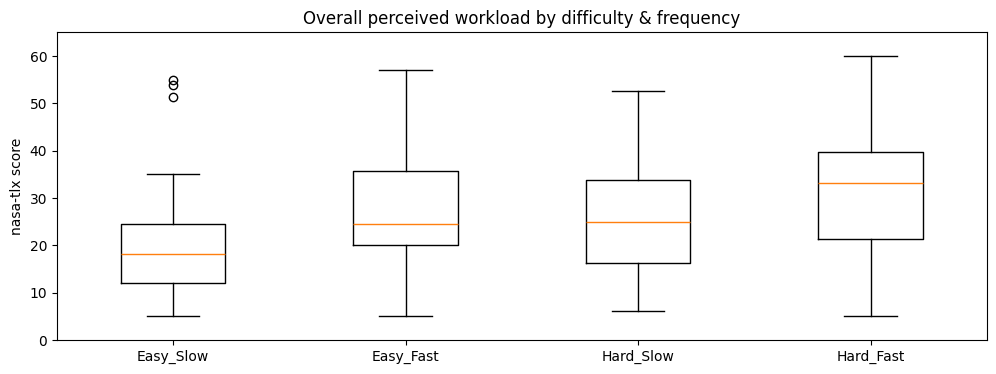

Easy_Slow: 20.65 (~12.13)
Easy_Fast: 27.66 (~12.78)
Hard_Slow: 26.55 (~12.08)
Hard_Fast: 31.41 (~13.68)


In [ ]:
# Overall workload
mean_easy_slow = round(np.mean(df_easy_slow['NASA_TLX_Score']), 2)
mean_easy_fast = round(np.mean(df_easy_fast['NASA_TLX_Score']), 2)
std_easy_slow = round(np.std(df_easy_slow['NASA_TLX_Score']), 2)
std_easy_fast = round(np.std(df_easy_fast['NASA_TLX_Score']), 2)
mean_hard_slow = round(np.mean(df_hard_slow['NASA_TLX_Score']), 2)
mean_hard_fast = round(np.mean(df_hard_fast['NASA_TLX_Score']), 2)
std_hard_slow = round(np.std(df_hard_slow['NASA_TLX_Score']), 2)
std_hard_fast = round(np.std(df_hard_fast['NASA_TLX_Score']), 2)

plt.figure(figsize=(12, 4))
plt.boxplot([df_easy_slow['NASA_TLX_Score'], df_easy_fast['NASA_TLX_Score'], df_hard_slow['NASA_TLX_Score'], df_hard_fast['NASA_TLX_Score']], whis = 1.5)
plt.title(f'Overall perceived workload by difficulty & frequency')
plt.xticks([1, 2, 3, 4], ['Easy_Slow', 'Easy_Fast', 'Hard_Slow', 'Hard_Fast'])
plt.ylabel('nasa-tlx score')
plt.ylim(0, 65)
plt.show()

print(f"Easy_Slow: {np.mean(mean_easy_slow)} (~{std_easy_slow})")
print(f"Easy_Fast: {np.mean(mean_easy_fast)} (~{std_easy_fast})")
print(f"Hard_Slow: {np.mean(mean_hard_slow)} (~{std_hard_slow})")
print(f"Hard_Fast: {np.mean(mean_hard_fast)} (~{std_hard_fast})")